<table class="table table-bordered">
    <tr>
        <th style="text-align:center;"><h1>Data Wrangling</h1><h2>Assignment 2 </h2><h3>Diploma in Data Science</h3></th>
    </tr>
</table>

In [ ]:
# import the pacakges
import numpy as np
import pandas as pd
import seaborn as sns
import scipy.stats as stats
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from scipy.signal import find_peaks
from feature_engine.outliers import Winsorizer
from feature_engine.transformation import YeoJohnsonTransformer
from feature_engine.transformation import LogTransformer
from feature_engine.transformation import BoxCoxTransformer
from sklearn.pipeline import Pipeline
import feature_engine.imputation as mdi
from feature_engine.encoding import OneHotEncoder, MeanEncoder
from feature_engine.discretisation import EqualWidthDiscretiser
from feature_engine.discretisation import EqualFrequencyDiscretiser
from sklearn.preprocessing import RobustScaler, StandardScaler, PolynomialFeatures
from sklearn.preprocessing import MinMaxScaler
from sklearn.decomposition import PCA


### Step 1: Load and Explore the Data

In [2]:
# I chose files which are related to predicting salary but i may not use all of them
data_salary = pd.read_csv("./Datasets/CSV/salary.csv")
data_batting = pd.read_csv("./Datasets/CSV/batting.csv")
data_fielding = pd.read_csv("./Datasets/CSV/fielding.csv")
data_player_award = pd.read_csv("./Datasets/CSV/player_award.csv")
data_all_star = pd.read_csv("./Datasets/CSV/all_star.csv")
data_pitching = pd.read_csv("./Datasets/CSV/pitching.csv")
data_batting_postseason = pd.read_csv("./Datasets/CSV/batting_postseason.csv")
data_fielding_postseason = pd.read_csv("./Datasets/CSV/fielding_postseason.csv")
data_pitching_postseason = pd.read_csv("./Datasets/CSV/pitching_postseason.csv")

In [3]:
# show all columns
pd.set_option('display.max_columns', None)

In [4]:
data_salary.head()

,year,team_id,league_id,player_id,salary
0,1985,ATL,NL,barkele01,870000
1,1985,ATL,NL,bedrost01,550000
2,1985,ATL,NL,benedbr01,545000
3,1985,ATL,NL,campri01,633333
4,1985,ATL,NL,ceronri01,625000


In [5]:
data_salary.shape

(25575, 5)

In [6]:
data_salary.dtypes

year          int64
team_id      object
league_id    object
player_id    object
salary        int64
dtype: object

In [7]:
data_salary.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25575 entries, 0 to 25574
Data columns (total 5 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   year       25575 non-null  int64 
 1   team_id    25575 non-null  object
 2   league_id  25575 non-null  object
 3   player_id  25575 non-null  object
 4   salary     25575 non-null  int64 
dtypes: int64(2), object(3)
memory usage: 999.2+ KB


In [8]:
data_salary.describe()

,year,salary
count,25575.000000,2.557500e+04
mean,2000.374389,2.008563e+06
std,8.610604,3.315706e+06
min,1985.000000,0.000000e+00
25%,1993.000000,2.750000e+05
50%,2000.000000,5.500000e+05
75%,2008.000000,2.250000e+06
max,2015.000000,3.300000e+07


In [9]:
data_salary.isnull().sum()

year         0
team_id      0
league_id    0
player_id    0
salary       0
dtype: int64

In [10]:
data_salary['year'].agg(['min', 'max'])

min    1985
max    2015
Name: year, dtype: int64

Text(0.5, 1.0, 'Cardinality')

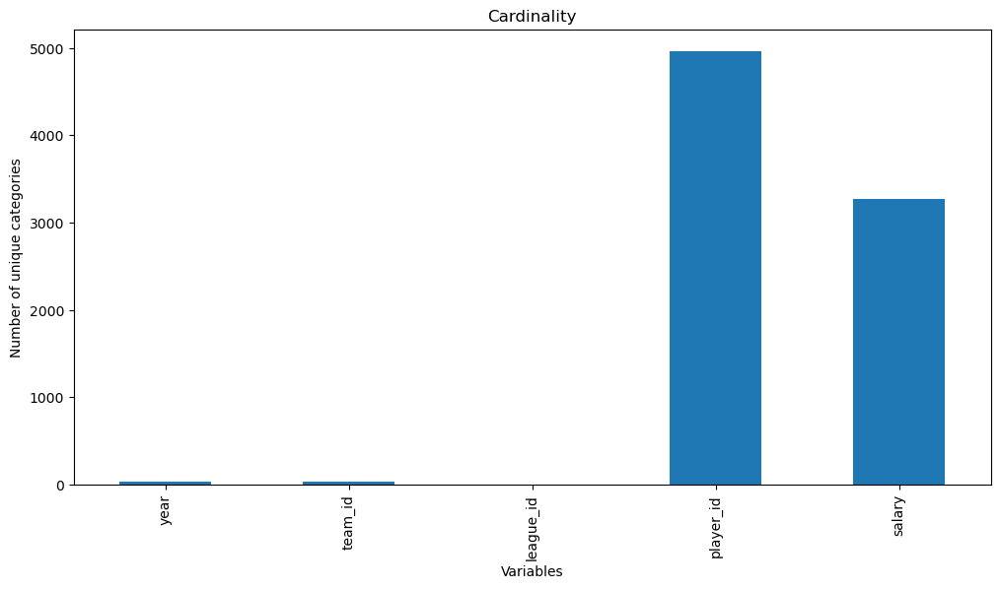

In [11]:
data_salary.nunique().plot.bar(figsize=(12,6))

plt.ylabel('Number of unique categories')
plt.xlabel('Variables')
plt.title('Cardinality')

In [12]:
data_salary[data_salary.duplicated()]

,year,team_id,league_id,player_id,salary


In [13]:
data_batting.head()

,player_id,year,stint,team_id,league_id,g,ab,r,h,double,triple,hr,rbi,sb,cs,bb,so,ibb,hbp,sh,sf,g_idp
0,abercda01,1871,1,TRO,NaN,1,4.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN
1,addybo01,1871,1,RC1,NaN,25,118.0,30.0,32.0,6.0,0.0,0.0,13.0,8.0,1.0,4.0,0.0,NaN,NaN,NaN,NaN,NaN
2,allisar01,1871,1,CL1,NaN,29,137.0,28.0,40.0,4.0,5.0,0.0,19.0,3.0,1.0,2.0,5.0,NaN,NaN,NaN,NaN,NaN
3,allisdo01,1871,1,WS3,NaN,27,133.0,28.0,44.0,10.0,2.0,2.0,27.0,1.0,1.0,0.0,2.0,NaN,NaN,NaN,NaN,NaN
4,ansonca01,1871,1,RC1,NaN,25,120.0,29.0,39.0,11.0,3.0,0.0,16.0,6.0,2.0,2.0,1.0,NaN,NaN,NaN,NaN,NaN


In [14]:
data_batting.shape

(101332, 22)

In [15]:
data_batting.dtypes

player_id     object
year           int64
stint          int64
team_id       object
league_id     object
g              int64
ab           float64
r            float64
h            float64
double       float64
triple       float64
hr           float64
rbi          float64
sb           float64
cs           float64
bb           float64
so           float64
ibb          float64
hbp          float64
sh           float64
sf           float64
g_idp        float64
dtype: object

In [16]:
data_batting.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 101332 entries, 0 to 101331
Data columns (total 22 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   player_id  101332 non-null  object 
 1   year       101332 non-null  int64  
 2   stint      101332 non-null  int64  
 3   team_id    101332 non-null  object 
 4   league_id  100595 non-null  object 
 5   g          101332 non-null  int64  
 6   ab         96183 non-null   float64
 7   r          96183 non-null   float64
 8   h          96183 non-null   float64
 9   double     96183 non-null   float64
 10  triple     96183 non-null   float64
 11  hr         96183 non-null   float64
 12  rbi        95759 non-null   float64
 13  sb         94883 non-null   float64
 14  cs         72729 non-null   float64
 15  bb         96183 non-null   float64
 16  so         88345 non-null   float64
 17  ibb        59620 non-null   float64
 18  hbp        93373 non-null   float64
 19  sh         89845 non-nu

In [17]:
data_batting.describe()

,year,stint,g,ab,r,h,double,triple,hr,rbi,sb,cs,bb,so,ibb,hbp,sh,sf,g_idp
count,101332.000000,101332.000000,101332.000000,96183.000000,96183.000000,96183.000000,96183.000000,96183.000000,96183.000000,95759.000000,94883.000000,72729.000000,96183.000000,88345.000000,59620.000000,93373.000000,89845.000000,60151.000000,70075.000000
mean,1963.506533,1.077567,51.400111,149.970327,19.887038,39.261647,6.637067,1.373361,2.949305,17.965163,3.158184,1.324025,13.811484,21.629849,1.213234,1.113395,2.457900,1.150122,3.210032
std,38.628278,0.283676,47.145273,186.557072,28.671365,53.310941,9.801563,2.710547,6.409662,26.756514,7.922994,2.838196,21.092775,28.432978,2.894918,2.320660,4.347818,2.023981,4.835881
min,1871.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,1933.000000,1.000000,13.000000,7.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,1972.000000,1.000000,34.000000,57.000000,5.000000,11.000000,1.000000,0.000000,0.000000,4.000000,0.000000,0.000000,3.000000,10.000000,0.000000,0.000000,1.000000,0.000000,1.000000
75%,1997.000000,1.000000,80.250000,251.000000,30.000000,63.000000,10.000000,2.000000,3.000000,27.000000,2.000000,1.000000,20.000000,30.000000,1.000000,1.000000,3.000000,2.000000,5.000000
max,2015.000000,5.000000,165.000000,716.000000,192.000000,262.000000,67.000000,36.000000,73.000000,191.000000,138.000000,42.000000,232.000000,223.000000,120.000000,51.000000,67.000000,19.000000,36.000000


In [18]:
data_batting.isnull().sum()

player_id        0
year             0
stint            0
team_id          0
league_id      737
g                0
ab            5149
r             5149
h             5149
double        5149
triple        5149
hr            5149
rbi           5573
sb            6449
cs           28603
bb            5149
so           12987
ibb          41712
hbp           7959
sh           11487
sf           41181
g_idp        31257
dtype: int64

In [19]:
data_batting['year'].agg(['min', 'max'])

min    1871
max    2015
Name: year, dtype: int64

Text(0.5, 1.0, 'Quantifying missing data')

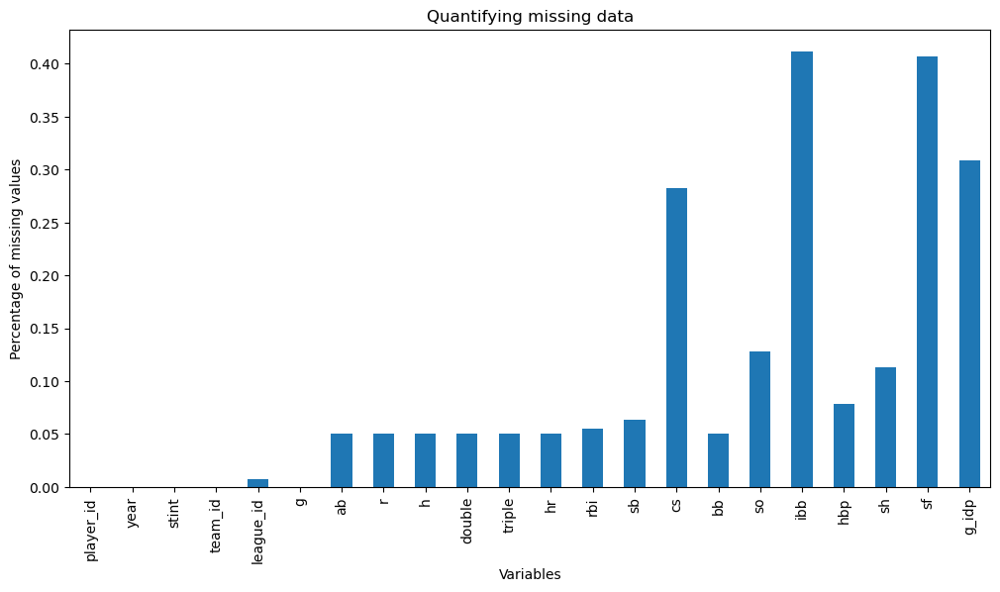

In [20]:
data_batting.isnull().mean().plot.bar(figsize=(12,6))
plt.ylabel('Percentage of missing values')
plt.xlabel('Variables')
plt.title('Quantifying missing data')

Text(0.5, 1.0, 'Cardinality')

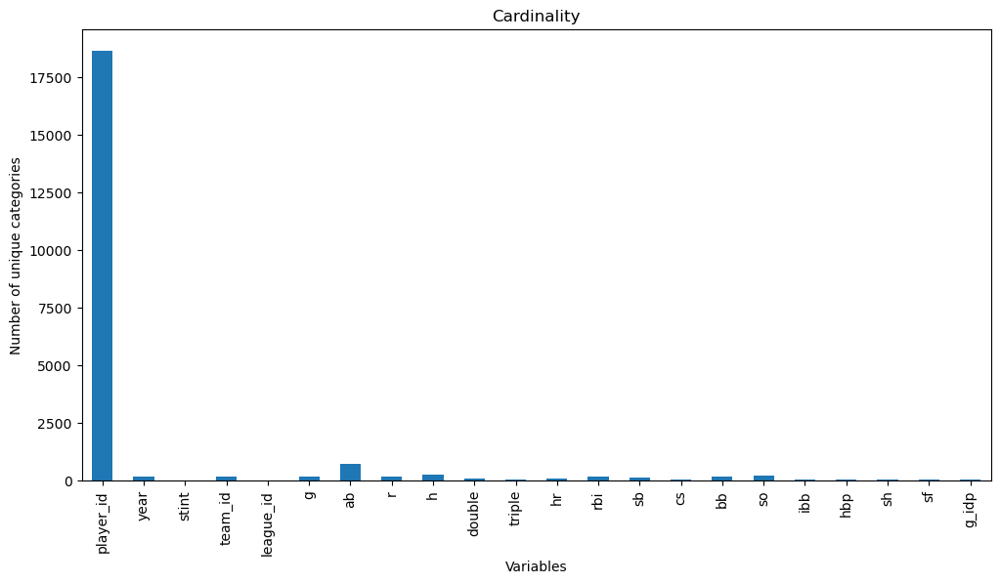

In [21]:
data_batting.nunique().plot.bar(figsize=(12,6))

plt.ylabel('Number of unique categories')
plt.xlabel('Variables')
plt.title('Cardinality')

In [22]:
data_batting[data_batting.duplicated()]

,player_id,year,stint,team_id,league_id,g,ab,r,h,double,triple,hr,rbi,sb,cs,bb,so,ibb,hbp,sh,sf,g_idp


In [23]:
data_fielding.head()

,player_id,year,stint,team_id,league_id,pos,g,gs,inn_outs,po,a,e,dp,pb,wp,sb,cs,zr
0,abercda01,1871,1,TRO,NaN,SS,1,NaN,NaN,1.0,3.0,2.0,0.0,NaN,NaN,NaN,NaN,NaN
1,addybo01,1871,1,RC1,NaN,2B,22,NaN,NaN,67.0,72.0,42.0,5.0,NaN,NaN,NaN,NaN,NaN
2,addybo01,1871,1,RC1,NaN,SS,3,NaN,NaN,8.0,14.0,7.0,0.0,NaN,NaN,NaN,NaN,NaN
3,allisar01,1871,1,CL1,NaN,2B,2,NaN,NaN,1.0,4.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN
4,allisar01,1871,1,CL1,NaN,OF,29,NaN,NaN,51.0,3.0,7.0,1.0,NaN,NaN,NaN,NaN,NaN


In [24]:
data_fielding.shape

(170526, 18)

In [25]:
data_fielding.dtypes

player_id     object
year           int64
stint          int64
team_id       object
league_id     object
pos           object
g              int64
gs           float64
inn_outs     float64
po           float64
a            float64
e            float64
dp           float64
pb           float64
wp           float64
sb           float64
cs           float64
zr           float64
dtype: object

In [26]:
data_fielding.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170526 entries, 0 to 170525
Data columns (total 18 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   player_id  170526 non-null  object 
 1   year       170526 non-null  int64  
 2   stint      170526 non-null  int64  
 3   team_id    170526 non-null  object 
 4   league_id  169023 non-null  object 
 5   pos        170526 non-null  object 
 6   g          170526 non-null  int64  
 7   gs         75849 non-null   float64
 8   inn_outs   102313 non-null  float64
 9   po         156409 non-null  float64
 10  a          156408 non-null  float64
 11  e          156407 non-null  float64
 12  dp         156408 non-null  float64
 13  pb         11116 non-null   float64
 14  wp         4189 non-null    float64
 15  sb         6024 non-null    float64
 16  cs         6024 non-null    float64
 17  zr         4189 non-null    float64
dtypes: float64(11), int64(3), object(4)
memory usage: 23.4+ MB


In [27]:
data_fielding.describe()

,year,stint,g,gs,inn_outs,po,a,e,dp,pb,wp,sb,cs,zr
count,170526.000000,170526.000000,170526.000000,75849.000000,102313.000000,156409.000000,156408.000000,156407.000000,156408.000000,11116.000000,4189.000000,6024.000000,6024.000000,4189.000000
mean,1966.517123,1.077818,33.651854,26.930823,708.231134,79.463496,30.826198,3.512093,6.349017,5.167326,11.772977,24.909031,12.066899,0.703032
std,38.550401,0.283581,41.117359,40.790139,1061.423810,176.463601,75.011893,7.534450,18.388112,9.116445,12.249974,25.816811,13.222888,1.394882
min,1871.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,1941.000000,1.000000,4.000000,1.000000,54.000000,2.000000,1.000000,0.000000,0.000000,0.000000,2.000000,4.000000,1.000000,0.000000
50%,1977.000000,1.000000,16.000000,7.000000,220.000000,10.000000,5.000000,1.000000,1.000000,2.000000,8.000000,17.000000,8.000000,0.000000
75%,1998.000000,1.000000,45.000000,32.000000,754.000000,72.000000,22.000000,3.000000,3.000000,6.000000,19.000000,39.000000,19.000000,1.000000
max,2015.000000,5.000000,165.000000,164.000000,4469.000000,1846.000000,641.000000,119.000000,194.000000,105.000000,69.000000,155.000000,89.000000,15.000000


In [28]:
data_fielding.isnull().sum()

player_id         0
year              0
stint             0
team_id           0
league_id      1503
pos               0
g                 0
gs            94677
inn_outs      68213
po            14117
a             14118
e             14119
dp            14118
pb           159410
wp           166337
sb           164502
cs           164502
zr           166337
dtype: int64

In [29]:
data_fielding['pos'].value_counts()/len(data_fielding)

pos
P     0.258852
OF    0.164661
3B    0.081243
1B    0.078979
2B    0.074387
LF    0.070288
SS    0.067544
C     0.065187
RF    0.063116
CF    0.046134
DH    0.029608
Name: count, dtype: float64

In [30]:
data_fielding['year'].agg(['min', 'max'])

min    1871
max    2015
Name: year, dtype: int64

Text(0.5, 1.0, 'Quantifying missing data')

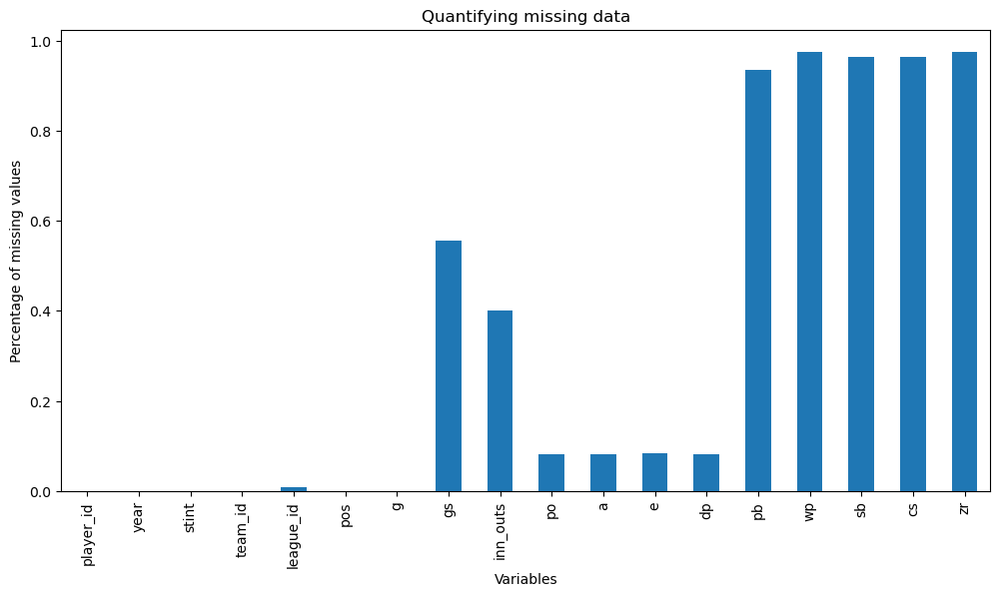

In [31]:
data_fielding.isnull().mean().plot.bar(figsize=(12,6))
plt.ylabel('Percentage of missing values')
plt.xlabel('Variables')
plt.title('Quantifying missing data')

Text(0.5, 1.0, 'Cardinality')

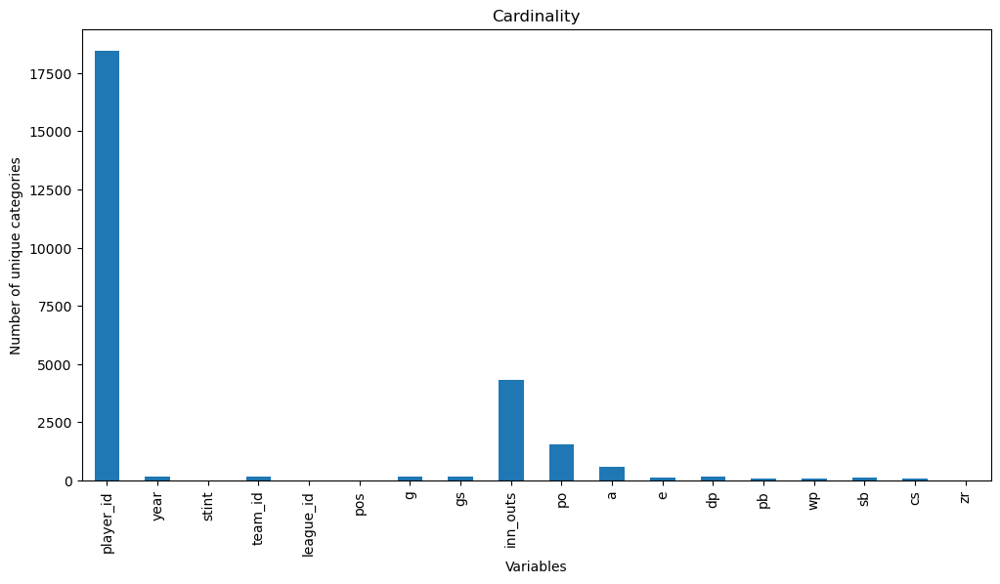

In [32]:
data_fielding.nunique().plot.bar(figsize=(12,6))

plt.ylabel('Number of unique categories')
plt.xlabel('Variables')
plt.title('Cardinality')

In [33]:
data_fielding[data_fielding.duplicated()]

,player_id,year,stint,team_id,league_id,pos,g,gs,inn_outs,po,a,e,dp,pb,wp,sb,cs,zr


In [34]:
data_player_award.head()

,player_id,award_id,year,league_id,tie,notes
0,bondto01,Pitching Triple Crown,1877,NL,NaN,NaN
1,hinespa01,Triple Crown,1878,NL,NaN,NaN
2,heckegu01,Pitching Triple Crown,1884,AA,NaN,NaN
3,radboch01,Pitching Triple Crown,1884,NL,NaN,NaN
4,oneilti01,Triple Crown,1887,AA,NaN,NaN


In [35]:
data_player_award.shape

(6078, 6)

In [36]:
data_player_award.dtypes

player_id    object
award_id     object
year          int64
league_id    object
tie          object
notes        object
dtype: object

In [37]:
data_player_award.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6078 entries, 0 to 6077
Data columns (total 6 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   player_id  6078 non-null   object
 1   award_id   6078 non-null   object
 2   year       6078 non-null   int64 
 3   league_id  6078 non-null   object
 4   tie        45 non-null     object
 5   notes      4648 non-null   object
dtypes: int64(1), object(5)
memory usage: 285.0+ KB


In [38]:
data_player_award.describe()

,year
count,6078.000000
mean,1968.459033
std,30.567689
min,1877.000000
25%,1942.000000
50%,1974.000000
75%,1995.000000
max,2015.000000


In [39]:
data_player_award.isnull().sum()

player_id       0
award_id        0
year            0
league_id       0
tie          6033
notes        1430
dtype: int64

In [40]:
data_player_award['year'].agg(['min', 'max'])

min    1877
max    2015
Name: year, dtype: int64

Text(0.5, 1.0, 'Quantifying missing data')

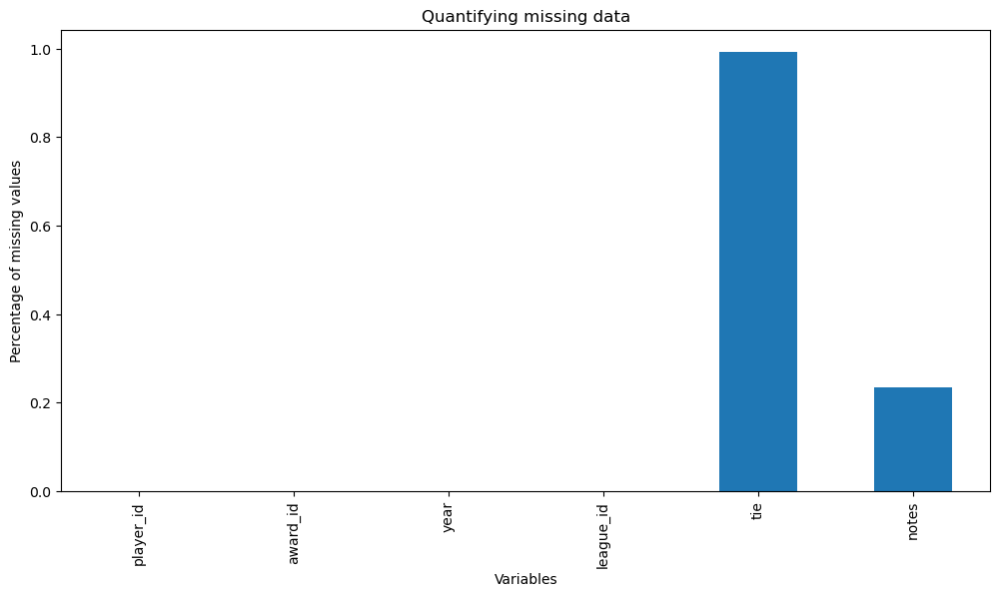

In [41]:
data_player_award.isnull().mean().plot.bar(figsize=(12,6))
plt.ylabel('Percentage of missing values')
plt.xlabel('Variables')
plt.title('Quantifying missing data')

Text(0.5, 1.0, 'Cardinality')

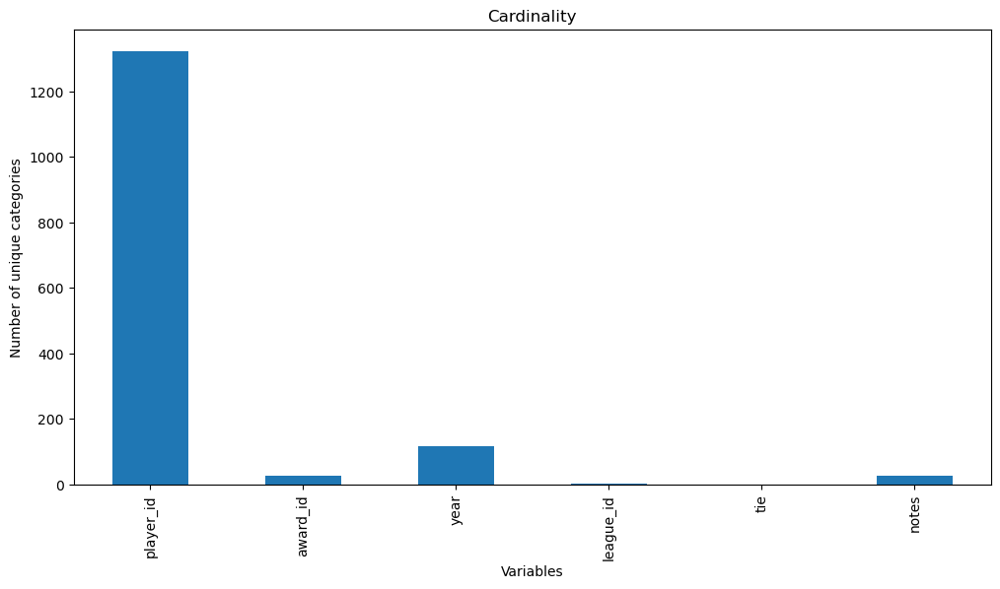

In [42]:
data_player_award.nunique().plot.bar(figsize=(12,6))

plt.ylabel('Number of unique categories')
plt.xlabel('Variables')
plt.title('Cardinality')

In [43]:
data_player_award[data_player_award.duplicated()]

,player_id,award_id,year,league_id,tie,notes


In [44]:
data_all_star.head()

,player_id,year,game_num,game_id,team_id,league_id,gp,starting_pos
0,gomezle01,1933,0,ALS193307060,NYA,AL,1.0,1.0
1,ferreri01,1933,0,ALS193307060,BOS,AL,1.0,2.0
2,gehrilo01,1933,0,ALS193307060,NYA,AL,1.0,3.0
3,gehrich01,1933,0,ALS193307060,DET,AL,1.0,4.0
4,dykesji01,1933,0,ALS193307060,CHA,AL,1.0,5.0


In [45]:
data_all_star.shape

(5069, 8)

In [46]:
data_all_star.dtypes

player_id        object
year              int64
game_num          int64
game_id          object
team_id          object
league_id        object
gp              float64
starting_pos    float64
dtype: object

In [47]:
data_all_star.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5069 entries, 0 to 5068
Data columns (total 8 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   player_id     5069 non-null   object 
 1   year          5069 non-null   int64  
 2   game_num      5069 non-null   int64  
 3   game_id       5020 non-null   object 
 4   team_id       5069 non-null   object 
 5   league_id     5069 non-null   object 
 6   gp            5050 non-null   float64
 7   starting_pos  1580 non-null   float64
dtypes: float64(2), int64(2), object(4)
memory usage: 316.9+ KB


In [48]:
data_all_star.describe()

,year,game_num,gp,starting_pos
count,5069.000000,5069.000000,5050.000000,1580.000000
mean,1976.433024,0.136911,0.778218,5.037975
std,23.693503,0.461412,0.415486,2.653486
min,1933.000000,0.000000,0.000000,0.000000
25%,1958.000000,0.000000,1.000000,3.000000
50%,1976.000000,0.000000,1.000000,5.000000
75%,1998.000000,0.000000,1.000000,7.000000
max,2015.000000,2.000000,1.000000,10.000000


In [49]:
data_all_star.isnull().sum()

player_id          0
year               0
game_num           0
game_id           49
team_id            0
league_id          0
gp                19
starting_pos    3489
dtype: int64

In [50]:
data_all_star['year'].agg(['min', 'max'])

min    1933
max    2015
Name: year, dtype: int64

Text(0.5, 1.0, 'Quantifying missing data')

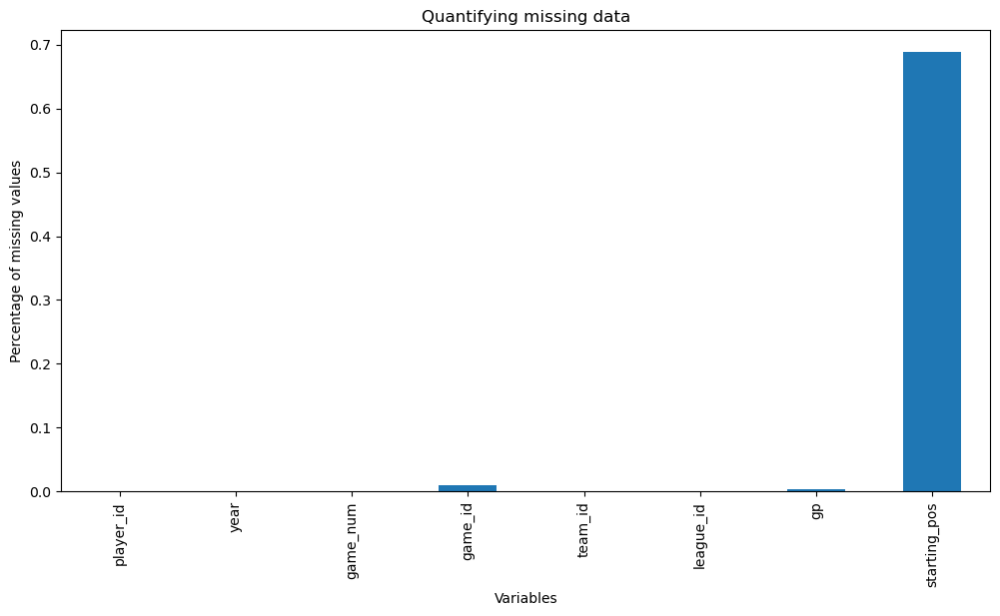

In [51]:
data_all_star.isnull().mean().plot.bar(figsize=(12,6))
plt.ylabel('Percentage of missing values')
plt.xlabel('Variables')
plt.title('Quantifying missing data')

Text(0.5, 1.0, 'Cardinality')

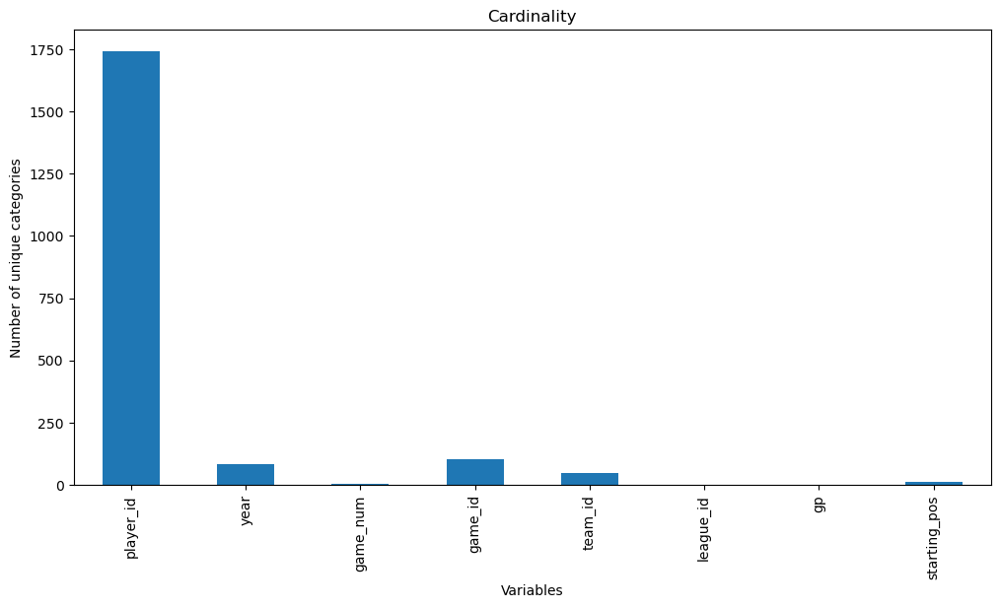

In [52]:
data_all_star.nunique().plot.bar(figsize=(12,6))

plt.ylabel('Number of unique categories')
plt.xlabel('Variables')
plt.title('Cardinality')

In [53]:
data_all_star[data_all_star.duplicated()]

,player_id,year,game_num,game_id,team_id,league_id,gp,starting_pos


In [54]:
data_pitching.head()

,player_id,year,stint,team_id,league_id,w,l,g,gs,cg,sho,sv,ipouts,h,er,hr,bb,so,baopp,era,ibb,wp,hbp,bk,bfp,gf,r,sh,sf,g_idp
0,bechtge01,1871,1,PH1,NaN,1,2,3,3,2,0,0,78.0,43,23,0,11,1,NaN,7.96,NaN,NaN,NaN,0,NaN,NaN,42,NaN,NaN,NaN
1,brainas01,1871,1,WS3,NaN,12,15,30,30,30,0,0,792.0,361,132,4,37,13,NaN,4.50,NaN,NaN,NaN,0,NaN,NaN,292,NaN,NaN,NaN
2,fergubo01,1871,1,NY2,NaN,0,0,1,0,0,0,0,3.0,8,3,0,0,0,NaN,27.00,NaN,NaN,NaN,0,NaN,NaN,9,NaN,NaN,NaN
3,fishech01,1871,1,RC1,NaN,4,16,24,24,22,1,0,639.0,295,103,3,31,15,NaN,4.35,NaN,NaN,NaN,0,NaN,NaN,257,NaN,NaN,NaN
4,fleetfr01,1871,1,NY2,NaN,0,1,1,1,1,0,0,27.0,20,10,0,3,0,NaN,10.00,NaN,NaN,NaN,0,NaN,NaN,21,NaN,NaN,NaN


In [55]:
data_pitching.shape

(44139, 30)

In [56]:
data_pitching.dtypes

player_id     object
year           int64
stint          int64
team_id       object
league_id     object
w              int64
l              int64
g              int64
gs             int64
cg             int64
sho            int64
sv             int64
ipouts       float64
h              int64
er             int64
hr             int64
bb             int64
so             int64
baopp        float64
era          float64
ibb          float64
wp           float64
hbp          float64
bk             int64
bfp          float64
gf           float64
r              int64
sh           float64
sf           float64
g_idp        float64
dtype: object

In [57]:
data_pitching.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 44139 entries, 0 to 44138
Data columns (total 30 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   player_id  44139 non-null  object 
 1   year       44139 non-null  int64  
 2   stint      44139 non-null  int64  
 3   team_id    44139 non-null  object 
 4   league_id  44008 non-null  object 
 5   w          44139 non-null  int64  
 6   l          44139 non-null  int64  
 7   g          44139 non-null  int64  
 8   gs         44139 non-null  int64  
 9   cg         44139 non-null  int64  
 10  sho        44139 non-null  int64  
 11  sv         44139 non-null  int64  
 12  ipouts     44138 non-null  float64
 13  h          44139 non-null  int64  
 14  er         44139 non-null  int64  
 15  hr         44139 non-null  int64  
 16  bb         44139 non-null  int64  
 17  so         44139 non-null  int64  
 18  baopp      42614 non-null  float64
 19  era        44049 non-null  float64
 20  ibb   

In [58]:
data_pitching.describe()

,year,stint,w,l,g,gs,cg,sho,sv,ipouts,h,er,hr,bb,so,baopp,era,ibb,wp,hbp,bk,bfp,gf,r,sh,sf,g_idp
count,44139.000000,44139.00000,44139.000000,44139.000000,44139.000000,44139.000000,44139.000000,44139.00000,44139.000000,44138.000000,44139.000000,44139.000000,44139.000000,44139.000000,44139.000000,42614.000000,44049.000000,29564.000000,44006.000000,43580.000000,44139.000000,43900.000000,44006.000000,44139.000000,11239.000000,11239.000000,745.000000
mean,1967.786493,1.07925,4.748794,4.748771,23.667142,9.552550,3.207979,0.45615,1.503976,255.673886,85.539817,36.321122,6.427219,30.121752,46.485784,0.320915,5.070029,2.447064,2.534836,2.271111,0.303881,345.551572,6.355611,43.332291,2.207759,1.908088,4.844295
std,37.352599,0.28443,5.837989,5.007080,18.462900,12.312479,7.134955,1.11821,4.971535,258.428826,84.947747,33.536040,6.979393,28.289118,49.324516,0.717192,5.334445,2.792671,3.438515,3.008115,0.759298,350.259188,10.003279,43.437952,2.751917,2.143002,5.524863
min,1871.000000,1.00000,0.000000,0.000000,1.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,1940.000000,1.00000,0.000000,1.000000,7.000000,0.000000,0.000000,0.00000,0.000000,50.000000,18.000000,9.000000,1.000000,8.000000,8.000000,0.236000,3.150000,0.000000,0.000000,0.000000,0.000000,64.000000,0.000000,11.000000,0.000000,0.000000,1.000000
50%,1977.000000,1.00000,2.000000,3.000000,22.000000,3.000000,0.000000,0.00000,0.000000,169.000000,56.000000,25.000000,4.000000,22.000000,31.000000,0.260000,4.130000,2.000000,1.000000,1.000000,0.000000,229.000000,3.000000,29.000000,1.000000,1.000000,3.000000
75%,2000.000000,1.00000,7.000000,8.000000,35.000000,18.000000,3.000000,0.00000,1.000000,397.000000,135.000000,58.000000,9.000000,46.000000,68.000000,0.298000,5.500000,4.000000,4.000000,3.000000,0.000000,540.000000,8.000000,68.000000,3.000000,3.000000,7.000000
max,2015.000000,4.00000,59.000000,48.000000,106.000000,75.000000,75.000000,16.00000,62.000000,2040.000000,772.000000,291.000000,50.000000,289.000000,513.000000,9.990000,189.000000,23.000000,63.000000,41.000000,16.000000,2906.000000,84.000000,519.000000,21.000000,14.000000,36.000000


In [59]:
data_pitching.isnull().sum()

player_id        0
year             0
stint            0
team_id          0
league_id      131
w                0
l                0
g                0
gs               0
cg               0
sho              0
sv               0
ipouts           1
h                0
er               0
hr               0
bb               0
so               0
baopp         1525
era             90
ibb          14575
wp             133
hbp            559
bk               0
bfp            239
gf             133
r                0
sh           32900
sf           32900
g_idp        43394
dtype: int64

In [60]:
data_pitching['year'].agg(['min', 'max'])

min    1871
max    2015
Name: year, dtype: int64

Text(0.5, 1.0, 'Quantifying missing data')

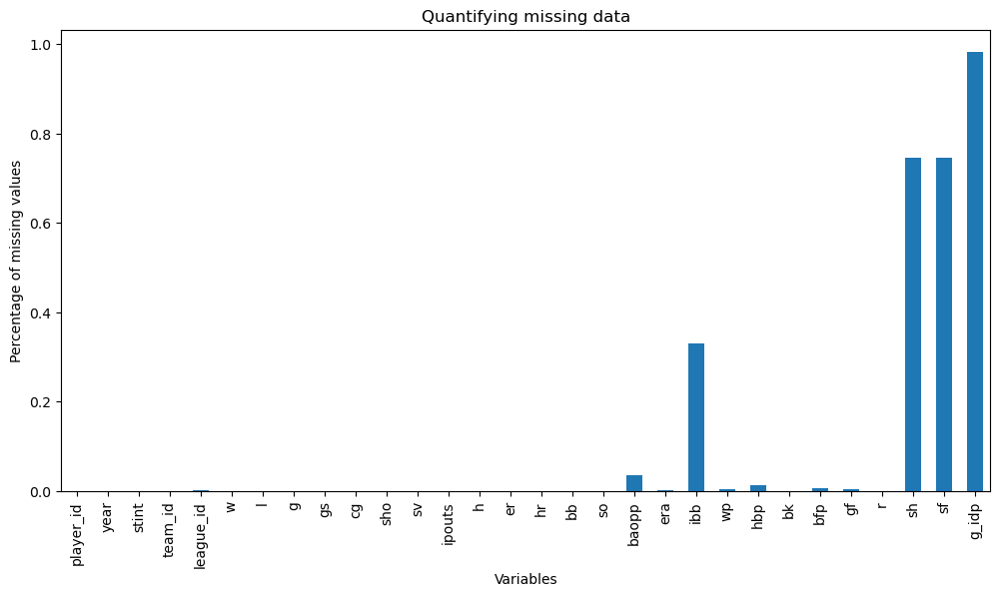

In [61]:
data_pitching.isnull().mean().plot.bar(figsize=(12,6))
plt.ylabel('Percentage of missing values')
plt.xlabel('Variables')
plt.title('Quantifying missing data')

Text(0.5, 1.0, 'Cardinality')

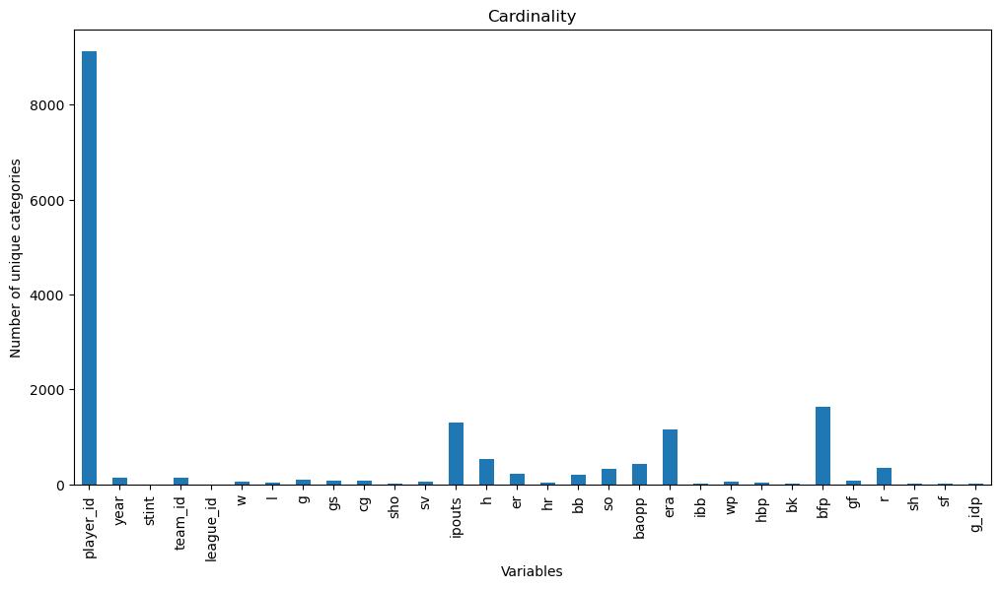

In [62]:
data_pitching.nunique().plot.bar(figsize=(12,6))

plt.ylabel('Number of unique categories')
plt.xlabel('Variables')
plt.title('Cardinality')

In [63]:
data_pitching[data_pitching.duplicated()]

,player_id,year,stint,team_id,league_id,w,l,g,gs,cg,sho,sv,ipouts,h,er,hr,bb,so,baopp,era,ibb,wp,hbp,bk,bfp,gf,r,sh,sf,g_idp


In [64]:
data_batting_postseason.head()

,year,round,player_id,team_id,league_id,g,ab,r,h,double,triple,hr,rbi,sb,cs,bb,so,ibb,hbp,sh,sf,g_idp
0,1884,WS,becanbu01,NY4,AA,1,2,0,1,0,0,0,0,0,NaN,0,0,0.0,NaN,NaN,NaN,NaN
1,1884,WS,bradyst01,NY4,AA,3,10,1,0,0,0,0,0,0,NaN,0,1,0.0,NaN,NaN,NaN,NaN
2,1884,WS,esterdu01,NY4,AA,3,10,0,3,1,0,0,0,1,NaN,0,3,0.0,NaN,NaN,NaN,NaN
3,1884,WS,forstto01,NY4,AA,1,3,0,0,0,0,0,0,0,NaN,0,1,0.0,NaN,NaN,NaN,NaN
4,1884,WS,keefeti01,NY4,AA,2,5,0,1,0,0,0,0,0,NaN,0,4,0.0,NaN,NaN,NaN,NaN


In [65]:
data_batting_postseason.shape

(11690, 22)

In [66]:
data_batting_postseason.dtypes

year           int64
round         object
player_id     object
team_id       object
league_id     object
g              int64
ab             int64
r              int64
h              int64
double         int64
triple         int64
hr             int64
rbi            int64
sb             int64
cs           float64
bb             int64
so             int64
ibb          float64
hbp          float64
sh           float64
sf           float64
g_idp        float64
dtype: object

In [67]:
data_batting_postseason.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11690 entries, 0 to 11689
Data columns (total 22 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   year       11690 non-null  int64  
 1   round      11690 non-null  object 
 2   player_id  11690 non-null  object 
 3   team_id    11690 non-null  object 
 4   league_id  11690 non-null  object 
 5   g          11690 non-null  int64  
 6   ab         11690 non-null  int64  
 7   r          11690 non-null  int64  
 8   h          11690 non-null  int64  
 9   double     11690 non-null  int64  
 10  triple     11690 non-null  int64  
 11  hr         11690 non-null  int64  
 12  rbi        11690 non-null  int64  
 13  sb         11690 non-null  int64  
 14  cs         11489 non-null  float64
 15  bb         11690 non-null  int64  
 16  so         11690 non-null  int64  
 17  ibb        10651 non-null  float64
 18  hbp        10453 non-null  float64
 19  sh         10446 non-null  float64
 20  sf    

In [68]:
data_batting_postseason.describe()

,year,g,ab,r,h,double,triple,hr,rbi,sb,cs,bb,so,ibb,hbp,sh,sf,g_idp
count,11690.000000,11690.000000,11690.000000,11690.000000,11690.000000,11690.000000,11690.000000,11690.000000,11690.000000,11690.000000,11489.000000,11690.000000,11690.000000,10651.000000,10453.000000,10446.000000,10442.000000,10485.000000
mean,1983.041660,3.277844,8.840890,1.054149,2.150984,0.375192,0.055518,0.218392,0.977844,0.169718,0.079380,0.832678,1.670830,0.096517,0.072611,0.126843,0.058609,0.175203
std,30.878498,1.930691,8.981517,1.591499,2.704839,0.739625,0.251774,0.562878,1.647508,0.608723,0.313297,1.358261,2.000072,0.378132,0.288822,0.401163,0.253721,0.450651
min,1884.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,1971.000000,2.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,1995.000000,3.000000,5.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,2006.000000,5.000000,16.000000,2.000000,4.000000,1.000000,0.000000,0.000000,1.000000,0.000000,0.000000,1.000000,3.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,2015.000000,15.000000,66.000000,13.000000,21.000000,6.000000,4.000000,6.000000,13.000000,15.000000,5.000000,13.000000,13.000000,7.000000,4.000000,5.000000,3.000000,5.000000


In [69]:
data_batting_postseason.isnull().sum()

year            0
round           0
player_id       0
team_id         0
league_id       0
g               0
ab              0
r               0
h               0
double          0
triple          0
hr              0
rbi             0
sb              0
cs            201
bb              0
so              0
ibb          1039
hbp          1237
sh           1244
sf           1248
g_idp        1205
dtype: int64

In [70]:
data_batting_postseason['year'].agg(['min', 'max'])

min    1884
max    2015
Name: year, dtype: int64

Text(0.5, 1.0, 'Quantifying missing data')

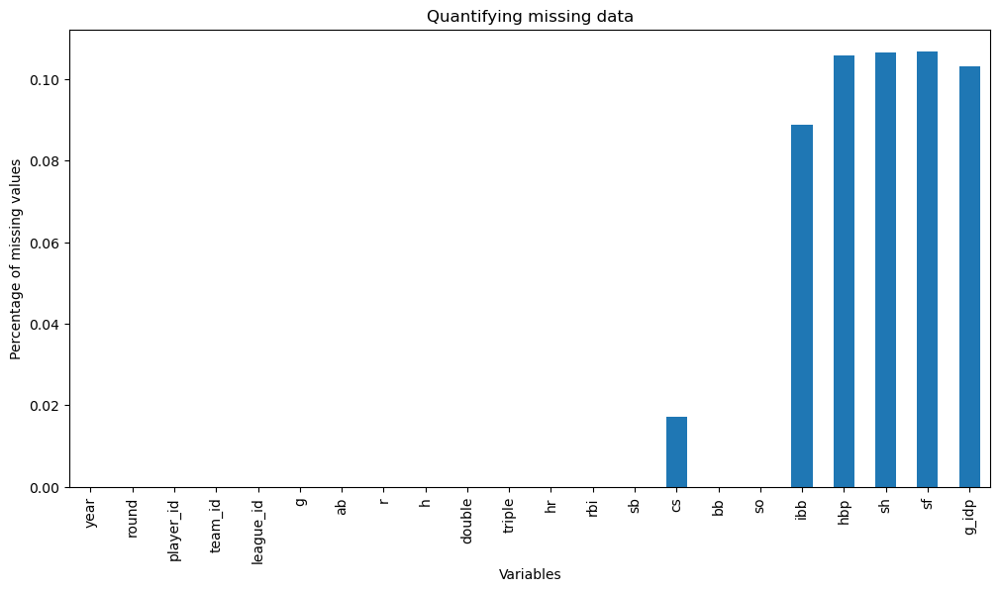

In [71]:
data_batting_postseason.isnull().mean().plot.bar(figsize=(12,6))
plt.ylabel('Percentage of missing values')
plt.xlabel('Variables')
plt.title('Quantifying missing data')

Text(0.5, 1.0, 'Cardinality')

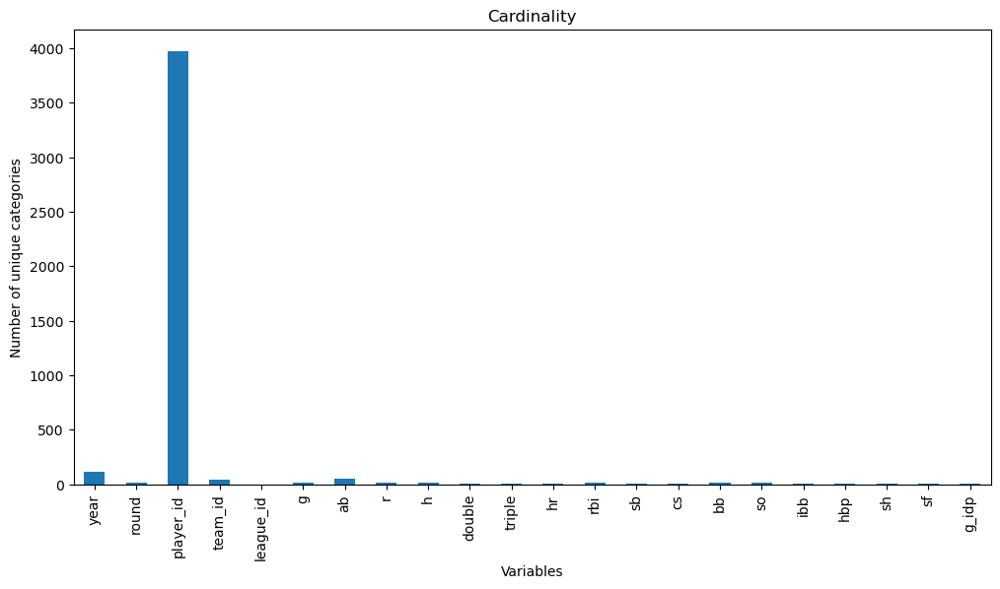

In [72]:
data_batting_postseason.nunique().plot.bar(figsize=(12,6))

plt.ylabel('Number of unique categories')
plt.xlabel('Variables')
plt.title('Cardinality')

In [73]:
data_batting_postseason[data_batting_postseason.duplicated()]

,year,round,player_id,team_id,league_id,g,ab,r,h,double,triple,hr,rbi,sb,cs,bb,so,ibb,hbp,sh,sf,g_idp


In [74]:
data_fielding_postseason.head()

,player_id,year,team_id,league_id,round,pos,g,gs,inn_outs,po,a,e,dp,tp,pb,sb,cs
0,colliji01,1903,BOS,AL,WS,3B,8,8.0,213.0,9,18,1,1,0,NaN,NaN,NaN
1,crigelo01,1903,BOS,AL,WS,C,8,8.0,213.0,54,7,3,2,0,0.0,9.0,3.0
2,dinnebi01,1903,BOS,AL,WS,P,4,4.0,105.0,2,9,0,0,0,NaN,6.0,1.0
3,doughpa01,1903,BOS,AL,WS,LF,8,8.0,213.0,13,3,1,1,0,NaN,NaN,NaN
4,ferriho01,1903,BOS,AL,WS,2B,8,8.0,213.0,18,23,2,2,0,NaN,NaN,NaN


In [75]:
data_fielding_postseason.shape

(12311, 17)

In [76]:
data_fielding_postseason.dtypes

player_id     object
year           int64
team_id       object
league_id     object
round         object
pos           object
g              int64
gs           float64
inn_outs     float64
po             int64
a              int64
e              int64
dp             int64
tp             int64
pb           float64
sb           float64
cs           float64
dtype: object

In [77]:
data_fielding_postseason.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12311 entries, 0 to 12310
Data columns (total 17 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   player_id  12311 non-null  object 
 1   year       12311 non-null  int64  
 2   team_id    12311 non-null  object 
 3   league_id  12311 non-null  object 
 4   round      12311 non-null  object 
 5   pos        12311 non-null  object 
 6   g          12311 non-null  int64  
 7   gs         11924 non-null  float64
 8   inn_outs   11990 non-null  float64
 9   po         12311 non-null  int64  
 10  a          12311 non-null  int64  
 11  e          12311 non-null  int64  
 12  dp         12311 non-null  int64  
 13  tp         12311 non-null  int64  
 14  pb         1351 non-null   float64
 15  sb         5555 non-null   float64
 16  cs         5555 non-null   float64
dtypes: float64(5), int64(7), object(5)
memory usage: 1.6+ MB


In [78]:
data_fielding_postseason.describe()

,year,g,gs,inn_outs,po,a,e,dp,tp,pb,sb,cs
count,12311.000000,12311.000000,11924.000000,11990.000000,12311.000000,12311.000000,12311.000000,12311.000000,12311.000000,1351.000000,5555.000000,5555.000000
mean,1986.404922,2.963935,2.170748,58.023353,6.443506,2.458208,0.189505,0.532776,0.000081,0.143597,0.580378,0.314851
std,27.247863,1.844349,2.237781,57.560177,11.287227,4.628965,0.525923,1.267366,0.009013,0.421762,1.278113,0.777604
min,1903.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,1975.000000,1.000000,0.000000,10.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,1996.000000,3.000000,1.000000,30.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,2006.000000,4.000000,4.000000,105.000000,8.000000,2.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000
max,2015.000000,11.000000,8.000000,222.000000,91.000000,33.000000,8.000000,13.000000,1.000000,3.000000,16.000000,10.000000


In [79]:
data_fielding_postseason.isnull().sum()

player_id        0
year             0
team_id          0
league_id        0
round            0
pos              0
g                0
gs             387
inn_outs       321
po               0
a                0
e                0
dp               0
tp               0
pb           10960
sb            6756
cs            6756
dtype: int64

In [80]:
data_fielding_postseason['year'].agg(['min', 'max'])

min    1903
max    2015
Name: year, dtype: int64

Text(0.5, 1.0, 'Quantifying missing data')

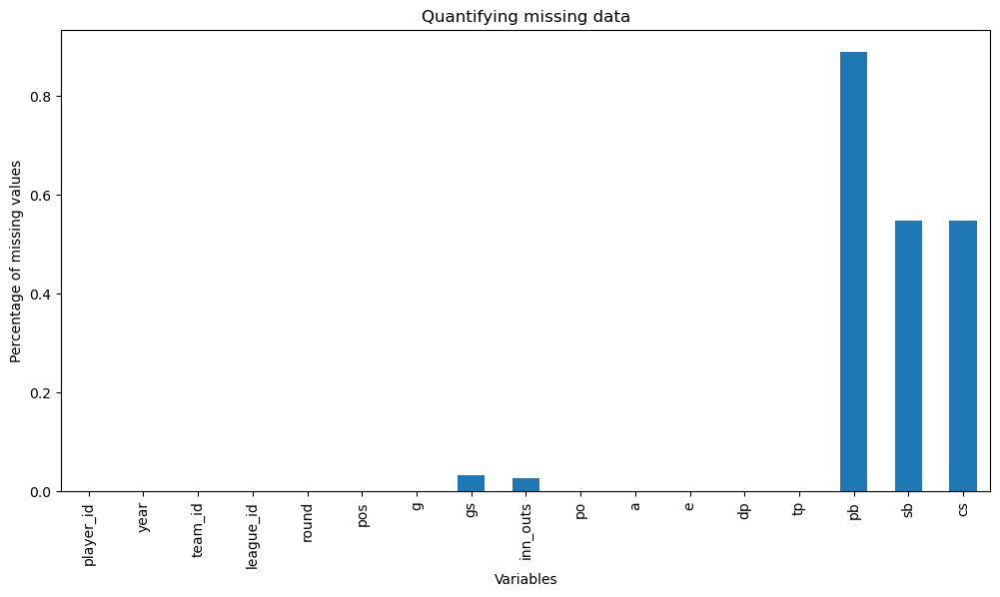

In [81]:
data_fielding_postseason.isnull().mean().plot.bar(figsize=(12,6))
plt.ylabel('Percentage of missing values')
plt.xlabel('Variables')
plt.title('Quantifying missing data')

Text(0.5, 1.0, 'Cardinality')

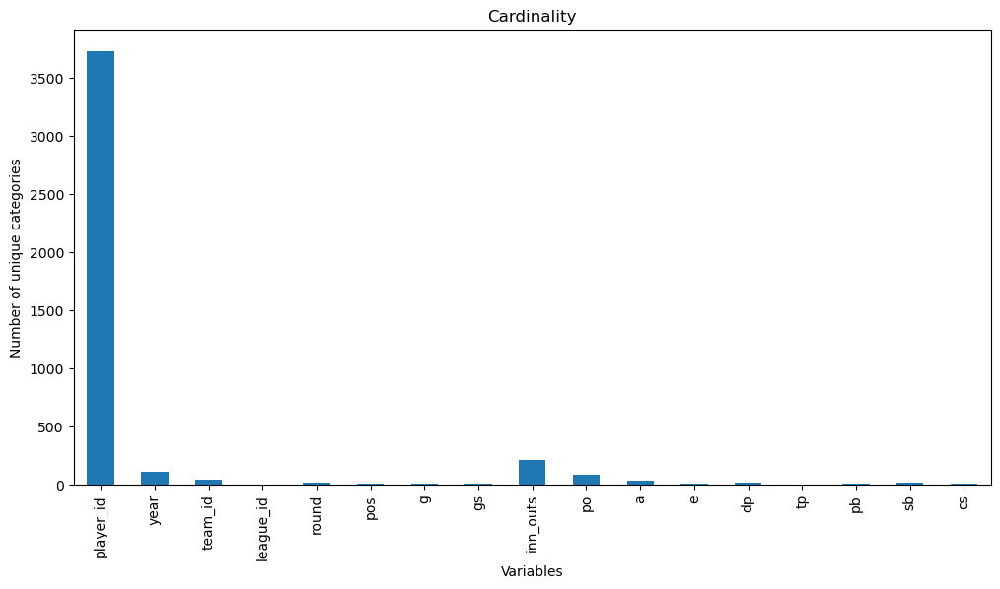

In [82]:
data_fielding_postseason.nunique().plot.bar(figsize=(12,6))

plt.ylabel('Number of unique categories')
plt.xlabel('Variables')
plt.title('Cardinality')

In [83]:
data_fielding_postseason[data_fielding_postseason.duplicated()]

,player_id,year,team_id,league_id,round,pos,g,gs,inn_outs,po,a,e,dp,tp,pb,sb,cs


In [84]:
data_pitching_postseason.head()

,player_id,year,round,team_id,league_id,w,l,g,gs,cg,sho,sv,ipouts,h,er,hr,bb,so,baopp,era,ibb,wp,hbp,bk,bfp,gf,r,sh,sf,g_idp
0,becanbu01,1884,WS,NY4,AA,0,1,1,1,1,0,0,18,9,7,0,2,1,NaN,10.50,NaN,NaN,NaN,NaN,NaN,0,12,NaN,NaN,NaN
1,keefeti01,1884,WS,NY4,AA,0,2,2,2,2,0,0,45,10,6,1,3,12,NaN,3.60,NaN,NaN,NaN,NaN,NaN,0,9,NaN,NaN,NaN
2,radboch01,1884,WS,PRO,NL,3,0,3,3,3,1,0,66,11,0,0,0,17,NaN,0.00,NaN,NaN,NaN,NaN,NaN,0,3,NaN,NaN,NaN
3,clarkjo01,1885,WS,CHN,NL,0,1,2,2,2,0,0,48,15,2,0,1,15,NaN,1.13,NaN,NaN,NaN,NaN,NaN,0,14,NaN,NaN,NaN
4,mccorji01,1885,WS,CHN,NL,3,2,5,5,5,0,0,108,27,8,0,6,19,NaN,2.00,NaN,NaN,NaN,NaN,NaN,0,22,NaN,NaN,NaN


In [85]:
data_pitching_postseason.shape

(5109, 30)

In [86]:
data_pitching_postseason.dtypes

player_id     object
year           int64
round         object
team_id       object
league_id     object
w              int64
l              int64
g              int64
gs             int64
cg             int64
sho            int64
sv             int64
ipouts         int64
h              int64
er             int64
hr             int64
bb             int64
so             int64
baopp         object
era          float64
ibb          float64
wp           float64
hbp          float64
bk           float64
bfp          float64
gf             int64
r              int64
sh           float64
sf           float64
g_idp        float64
dtype: object

In [87]:
data_pitching_postseason.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5109 entries, 0 to 5108
Data columns (total 30 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   player_id  5109 non-null   object 
 1   year       5109 non-null   int64  
 2   round      5109 non-null   object 
 3   team_id    5109 non-null   object 
 4   league_id  5109 non-null   object 
 5   w          5109 non-null   int64  
 6   l          5109 non-null   int64  
 7   g          5109 non-null   int64  
 8   gs         5109 non-null   int64  
 9   cg         5109 non-null   int64  
 10  sho        5109 non-null   int64  
 11  sv         5109 non-null   int64  
 12  ipouts     5109 non-null   int64  
 13  h          5109 non-null   int64  
 14  er         5109 non-null   int64  
 15  hr         5109 non-null   int64  
 16  bb         5109 non-null   int64  
 17  so         5109 non-null   int64  
 18  baopp      5041 non-null   object 
 19  era        4841 non-null   float64
 20  ibb     

In [88]:
data_pitching_postseason.describe()

,year,w,l,g,gs,cg,sho,sv,ipouts,h,er,hr,bb,so,era,ibb,wp,hbp,bk,bfp,gf,r,sh,sf,g_idp
count,5109.000000,5109.000000,5109.000000,5109.000000,5109.000000,5109.000000,5109.000000,5109.000000,5109.000000,5109.000000,5109.000000,5109.000000,5109.000000,5109.000000,4841.00,5059.000000,5059.000000,5059.000000,4884.000000,5059.000000,5109.000000,5109.000000,4398.000000,4398.000000,5059.000000
mean,1987.565473,0.299667,0.299667,1.911529,0.601683,0.128597,0.027794,0.109219,16.149149,4.921707,2.111176,0.496966,1.905265,3.838520,inf,0.213679,0.146867,0.160901,0.013514,22.026092,0.473087,2.413192,0.290359,0.132788,0.382882
std,27.590228,0.561805,0.533933,1.011292,0.811819,0.480739,0.172533,0.420001,15.375949,4.783624,2.361216,0.800255,2.061797,3.892692,NaN,0.498319,0.415658,0.418301,0.115471,18.749470,0.838524,2.791809,0.634862,0.378057,0.693607
min,1884.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,1977.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,6.000000,2.000000,0.000000,0.000000,0.000000,1.000000,0.00,0.000000,0.000000,0.000000,0.000000,8.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,1998.000000,0.000000,0.000000,2.000000,0.000000,0.000000,0.000000,0.000000,12.000000,4.000000,1.000000,0.000000,1.000000,3.000000,2.57,0.000000,0.000000,0.000000,0.000000,17.000000,0.000000,2.000000,0.000000,0.000000,0.000000
75%,2007.000000,1.000000,1.000000,2.000000,1.000000,0.000000,0.000000,0.000000,21.000000,7.000000,3.000000,1.000000,3.000000,5.000000,6.00,0.000000,0.000000,0.000000,0.000000,29.000000,1.000000,4.000000,0.000000,0.000000,1.000000
max,2015.000000,4.000000,4.000000,8.000000,8.000000,8.000000,3.000000,4.000000,213.000000,64.000000,26.000000,5.000000,32.000000,35.000000,inf,4.000000,5.000000,3.000000,1.000000,178.000000,6.000000,36.000000,7.000000,4.000000,6.000000


In [89]:
data_pitching_postseason.isnull().sum()

player_id      0
year           0
round          0
team_id        0
league_id      0
w              0
l              0
g              0
gs             0
cg             0
sho            0
sv             0
ipouts         0
h              0
er             0
hr             0
bb             0
so             0
baopp         68
era          268
ibb           50
wp            50
hbp           50
bk           225
bfp           50
gf             0
r              0
sh           711
sf           711
g_idp         50
dtype: int64

In [90]:
data_pitching_postseason['year'].agg(['min', 'max'])

min    1884
max    2015
Name: year, dtype: int64

Text(0.5, 1.0, 'Quantifying missing data')

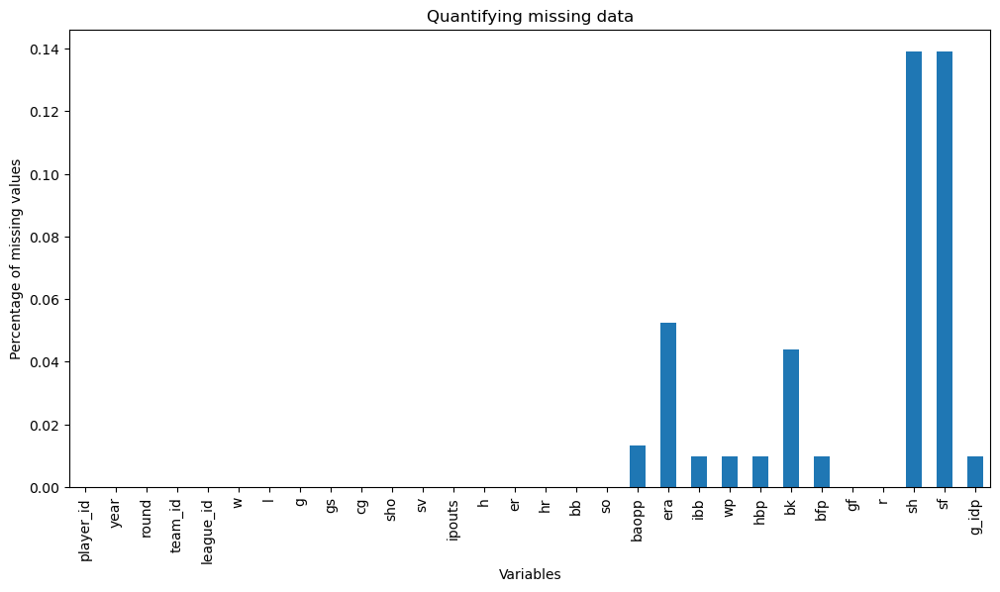

In [91]:
data_pitching_postseason.isnull().mean().plot.bar(figsize=(12,6))
plt.ylabel('Percentage of missing values')
plt.xlabel('Variables')
plt.title('Quantifying missing data')

Text(0.5, 1.0, 'Cardinality')

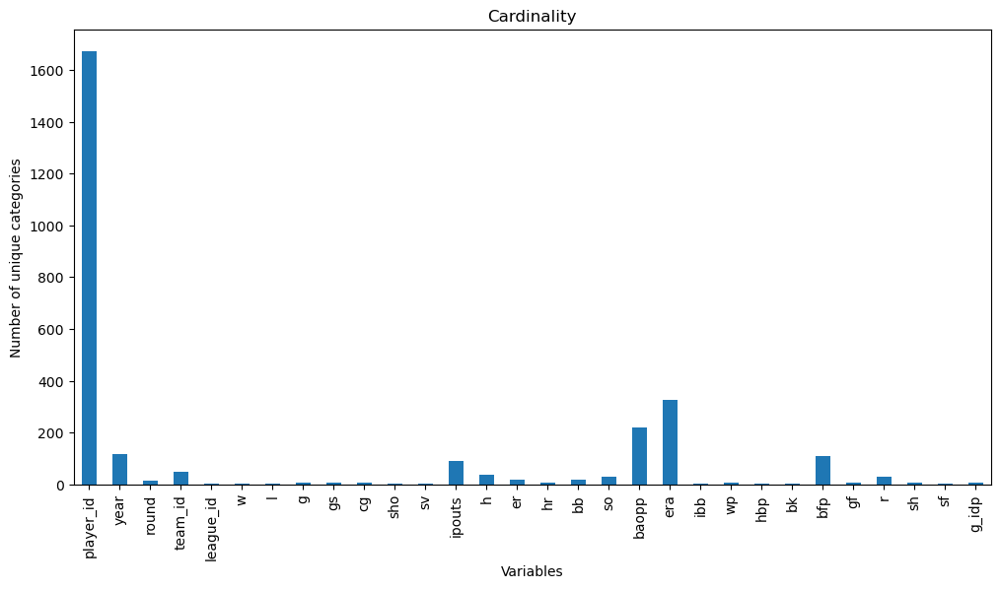

In [92]:
data_pitching_postseason.nunique().plot.bar(figsize=(12,6))

plt.ylabel('Number of unique categories')
plt.xlabel('Variables')
plt.title('Cardinality')

In [93]:
data_pitching_postseason[data_pitching_postseason.duplicated()]

,player_id,year,round,team_id,league_id,w,l,g,gs,cg,sho,sv,ipouts,h,er,hr,bb,so,baopp,era,ibb,wp,hbp,bk,bfp,gf,r,sh,sf,g_idp


### Step 2: Data Wrangling on multiple tables 

In [94]:
data_salary

,year,team_id,league_id,player_id,salary
0,1985,ATL,NL,barkele01,870000
1,1985,ATL,NL,bedrost01,550000
2,1985,ATL,NL,benedbr01,545000
3,1985,ATL,NL,campri01,633333
4,1985,ATL,NL,ceronri01,625000
...,...,...,...,...,...
25570,2015,WAS,NL,treinbl01,512800
25571,2015,WAS,NL,ugglada01,507500
25572,2015,WAS,NL,werthja01,21000000
25573,2015,WAS,NL,zimmejo02,16500000


In [95]:
data_batting

,player_id,year,stint,team_id,league_id,g,ab,r,h,double,triple,hr,rbi,sb,cs,bb,so,ibb,hbp,sh,sf,g_idp
0,abercda01,1871,1,TRO,NaN,1,4.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN
1,addybo01,1871,1,RC1,NaN,25,118.0,30.0,32.0,6.0,0.0,0.0,13.0,8.0,1.0,4.0,0.0,NaN,NaN,NaN,NaN,NaN
2,allisar01,1871,1,CL1,NaN,29,137.0,28.0,40.0,4.0,5.0,0.0,19.0,3.0,1.0,2.0,5.0,NaN,NaN,NaN,NaN,NaN
3,allisdo01,1871,1,WS3,NaN,27,133.0,28.0,44.0,10.0,2.0,2.0,27.0,1.0,1.0,0.0,2.0,NaN,NaN,NaN,NaN,NaN
4,ansonca01,1871,1,RC1,NaN,25,120.0,29.0,39.0,11.0,3.0,0.0,16.0,6.0,2.0,2.0,1.0,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
101327,zitoba01,2015,1,OAK,AL,3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
101328,zobribe01,2015,1,OAK,AL,67,235.0,39.0,63.0,20.0,2.0,6.0,33.0,1.0,1.0,33.0,26.0,2.0,0.0,0.0,3.0,5.0
101329,zobribe01,2015,2,KCA,AL,59,232.0,37.0,66.0,16.0,1.0,7.0,23.0,2.0,3.0,29.0,30.0,1.0,1.0,0.0,2.0,3.0
101330,zuninmi01,2015,1,SEA,AL,112,350.0,28.0,61.0,11.0,0.0,11.0,28.0,0.0,1.0,21.0,132.0,0.0,5.0,8.0,2.0,6.0


In [96]:
# stint is not insightful in predicting player salary
data_batting = data_batting.drop(columns=['stint'])

In [97]:
# to enhance readability and know which columns come from which table
data_batting = data_batting.rename(columns=lambda x: x + '_batting' if x not in ['player_id', 'year', 'league_id', 'team_id'] else x)

In [98]:
# merge on common columns
merged_data = data_salary.merge(data_batting, on=['player_id', 'year','league_id','team_id'], how='left')

In [99]:
merged_data.shape

(25584, 22)

In [100]:
merged_data

,year,team_id,league_id,player_id,salary,g_batting,ab_batting,r_batting,h_batting,double_batting,triple_batting,hr_batting,rbi_batting,sb_batting,cs_batting,bb_batting,so_batting,ibb_batting,hbp_batting,sh_batting,sf_batting,g_idp_batting
0,1985,ATL,NL,barkele01,870000,20.0,17.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,7.0,0.0,0.0,0.0,0.0,0.0
1,1985,ATL,NL,bedrost01,550000,37.0,64.0,3.0,5.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,22.0,0.0,0.0,6.0,0.0,0.0
2,1985,ATL,NL,benedbr01,545000,70.0,208.0,12.0,42.0,6.0,0.0,0.0,20.0,0.0,1.0,22.0,12.0,1.0,1.0,4.0,2.0,8.0
3,1985,ATL,NL,campri01,633333,66.0,13.0,1.0,3.0,0.0,0.0,1.0,2.0,0.0,0.0,1.0,5.0,0.0,0.0,1.0,0.0,0.0
4,1985,ATL,NL,ceronri01,625000,96.0,282.0,15.0,61.0,9.0,0.0,3.0,25.0,0.0,3.0,29.0,25.0,1.0,1.0,0.0,4.0,15.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
25579,2015,WAS,NL,treinbl01,512800,60.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,2.0,0.0,0.0
25580,2015,WAS,NL,ugglada01,507500,67.0,120.0,12.0,22.0,4.0,2.0,2.0,16.0,0.0,1.0,19.0,40.0,0.0,1.0,0.0,1.0,3.0
25581,2015,WAS,NL,werthja01,21000000,88.0,331.0,51.0,73.0,16.0,1.0,12.0,42.0,0.0,1.0,38.0,84.0,0.0,3.0,0.0,6.0,8.0
25582,2015,WAS,NL,zimmejo02,16500000,33.0,63.0,4.0,10.0,1.0,0.0,0.0,3.0,0.0,0.0,0.0,18.0,0.0,0.0,6.0,0.0,0.0


In [101]:
data_fielding

,player_id,year,stint,team_id,league_id,pos,g,gs,inn_outs,po,a,e,dp,pb,wp,sb,cs,zr
0,abercda01,1871,1,TRO,NaN,SS,1,NaN,NaN,1.0,3.0,2.0,0.0,NaN,NaN,NaN,NaN,NaN
1,addybo01,1871,1,RC1,NaN,2B,22,NaN,NaN,67.0,72.0,42.0,5.0,NaN,NaN,NaN,NaN,NaN
2,addybo01,1871,1,RC1,NaN,SS,3,NaN,NaN,8.0,14.0,7.0,0.0,NaN,NaN,NaN,NaN,NaN
3,allisar01,1871,1,CL1,NaN,2B,2,NaN,NaN,1.0,4.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN
4,allisar01,1871,1,CL1,NaN,OF,29,NaN,NaN,51.0,3.0,7.0,1.0,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
170521,younger03,2015,1,ATL,NL,OF,22,NaN,NaN,45.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN
170522,younger03,2015,2,NYN,NL,OF,7,NaN,NaN,5.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN
170523,zimmery01,2015,1,WAS,NL,OF,1,NaN,NaN,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN
170524,zobribe01,2015,1,OAK,AL,OF,29,NaN,NaN,39.0,0.0,3.0,0.0,NaN,NaN,NaN,NaN,NaN


In [102]:
# stint is not insightful in predicting player salary
data_fielding = data_fielding.drop(columns=['stint'])

In [103]:
# to enhance readability and know which columns come from which table
data_fielding = data_fielding.rename(columns=lambda x: x + '_fielding' if x not in ['player_id', 'year', 'league_id', 'team_id'] else x)

In [104]:
# merge on common columns
merged_data = merged_data.merge(data_fielding, on=['player_id', 'year','league_id','team_id'], how='inner')

In [105]:
merged_data.shape

(46883, 35)

In [106]:
merged_data

,year,team_id,league_id,player_id,salary,g_batting,ab_batting,r_batting,h_batting,double_batting,triple_batting,hr_batting,rbi_batting,sb_batting,cs_batting,bb_batting,so_batting,ibb_batting,hbp_batting,sh_batting,sf_batting,g_idp_batting,pos_fielding,g_fielding,gs_fielding,inn_outs_fielding,po_fielding,a_fielding,e_fielding,dp_fielding,pb_fielding,wp_fielding,sb_fielding,cs_fielding,zr_fielding
0,1985,ATL,NL,barkele01,870000,20.0,17.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,7.0,0.0,0.0,0.0,0.0,0.0,P,20,18.0,221.0,2.0,9.0,1.0,0.0,NaN,NaN,NaN,NaN,NaN
1,1985,ATL,NL,bedrost01,550000,37.0,64.0,3.0,5.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,22.0,0.0,0.0,6.0,0.0,0.0,P,37,37.0,620.0,13.0,23.0,4.0,3.0,NaN,NaN,NaN,NaN,NaN
2,1985,ATL,NL,benedbr01,545000,70.0,208.0,12.0,42.0,6.0,0.0,0.0,20.0,0.0,1.0,22.0,12.0,1.0,1.0,4.0,2.0,8.0,C,70,67.0,1698.0,314.0,35.0,4.0,1.0,1.0,9.0,65.0,24.0,1.0
3,1985,ATL,NL,campri01,633333,66.0,13.0,1.0,3.0,0.0,0.0,1.0,2.0,0.0,0.0,1.0,5.0,0.0,0.0,1.0,0.0,0.0,P,66,2.0,383.0,7.0,13.0,4.0,3.0,NaN,NaN,NaN,NaN,NaN
4,1985,ATL,NL,ceronri01,625000,96.0,282.0,15.0,61.0,9.0,0.0,3.0,25.0,0.0,3.0,29.0,25.0,1.0,1.0,0.0,4.0,15.0,C,91,76.0,2097.0,384.0,48.0,6.0,4.0,6.0,20.0,69.0,29.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
46878,2015,WAS,NL,werthja01,21000000,88.0,331.0,51.0,73.0,16.0,1.0,12.0,42.0,0.0,1.0,38.0,84.0,0.0,3.0,0.0,6.0,8.0,OF,86,NaN,NaN,113.0,3.0,2.0,0.0,NaN,NaN,NaN,NaN,NaN
46879,2015,WAS,NL,zimmejo02,16500000,33.0,63.0,4.0,10.0,1.0,0.0,0.0,3.0,0.0,0.0,0.0,18.0,0.0,0.0,6.0,0.0,0.0,P,33,NaN,NaN,16.0,29.0,2.0,1.0,NaN,NaN,NaN,NaN,NaN
46880,2015,WAS,NL,zimmery01,14000000,95.0,346.0,43.0,86.0,25.0,1.0,16.0,73.0,1.0,0.0,33.0,79.0,0.0,1.0,0.0,10.0,13.0,1B,93,NaN,NaN,726.0,49.0,4.0,63.0,NaN,NaN,NaN,NaN,NaN
46881,2015,WAS,NL,zimmery01,14000000,95.0,346.0,43.0,86.0,25.0,1.0,16.0,73.0,1.0,0.0,33.0,79.0,0.0,1.0,0.0,10.0,13.0,LF,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [107]:
data_pitching

,player_id,year,stint,team_id,league_id,w,l,g,gs,cg,sho,sv,ipouts,h,er,hr,bb,so,baopp,era,ibb,wp,hbp,bk,bfp,gf,r,sh,sf,g_idp
0,bechtge01,1871,1,PH1,NaN,1,2,3,3,2,0,0,78.0,43,23,0,11,1,NaN,7.96,NaN,NaN,NaN,0,NaN,NaN,42,NaN,NaN,NaN
1,brainas01,1871,1,WS3,NaN,12,15,30,30,30,0,0,792.0,361,132,4,37,13,NaN,4.50,NaN,NaN,NaN,0,NaN,NaN,292,NaN,NaN,NaN
2,fergubo01,1871,1,NY2,NaN,0,0,1,0,0,0,0,3.0,8,3,0,0,0,NaN,27.00,NaN,NaN,NaN,0,NaN,NaN,9,NaN,NaN,NaN
3,fishech01,1871,1,RC1,NaN,4,16,24,24,22,1,0,639.0,295,103,3,31,15,NaN,4.35,NaN,NaN,NaN,0,NaN,NaN,257,NaN,NaN,NaN
4,fleetfr01,1871,1,NY2,NaN,0,1,1,1,1,0,0,27.0,20,10,0,3,0,NaN,10.00,NaN,NaN,NaN,0,NaN,NaN,21,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
44134,youngch03,2015,1,KCA,AL,11,6,34,18,0,0,0,370.0,91,42,16,43,83,0.202,3.06,0.0,5.0,0.0,0,500.0,3.0,44,4.0,2.0,NaN
44135,zieglbr01,2015,1,ARI,NL,0,3,66,0,0,0,30,204.0,48,14,3,17,36,0.197,1.85,3.0,2.0,1.0,0,263.0,46.0,17,1.0,0.0,NaN
44136,zimmejo02,2015,1,WAS,NL,13,10,33,33,0,0,0,605.0,204,82,24,39,164,0.264,3.66,3.0,2.0,8.0,1,831.0,0.0,89,8.0,2.0,NaN
44137,zitoba01,2015,1,OAK,AL,0,0,3,2,0,0,0,21.0,12,8,4,6,2,0.387,10.29,0.0,0.0,0.0,0,37.0,1.0,8,0.0,0.0,NaN


In [108]:
# stint is not insightful in predicting player salary
data_pitching = data_pitching.drop(columns=['stint'])

In [109]:
# to enhance readability and know which columns come from which table
data_pitching = data_pitching.rename(columns=lambda x: x + '_pitching' if x not in ['player_id', 'year', 'league_id', 'team_id'] else x)

In [110]:
# merge on common columns
merged_data = merged_data.merge(data_pitching, on=['player_id', 'year','league_id','team_id'], how='inner')

In [111]:
merged_data.shape

(12248, 60)

In [112]:
merged_data

,year,team_id,league_id,player_id,salary,g_batting,ab_batting,r_batting,h_batting,double_batting,triple_batting,hr_batting,rbi_batting,sb_batting,cs_batting,bb_batting,so_batting,ibb_batting,hbp_batting,sh_batting,sf_batting,g_idp_batting,pos_fielding,g_fielding,gs_fielding,inn_outs_fielding,po_fielding,a_fielding,e_fielding,dp_fielding,pb_fielding,wp_fielding,sb_fielding,cs_fielding,zr_fielding,w_pitching,l_pitching,g_pitching,gs_pitching,cg_pitching,sho_pitching,sv_pitching,ipouts_pitching,h_pitching,er_pitching,hr_pitching,bb_pitching,so_pitching,baopp_pitching,era_pitching,ibb_pitching,wp_pitching,hbp_pitching,bk_pitching,bfp_pitching,gf_pitching,r_pitching,sh_pitching,sf_pitching,g_idp_pitching
0,1985,ATL,NL,barkele01,870000,20.0,17.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,7.0,0.0,0.0,0.0,0.0,0.0,P,20,18.0,221.0,2.0,9.0,1.0,0.0,NaN,NaN,NaN,NaN,NaN,2,9,20,18,0,0,0,221.0,84,52,10,37,47,0.280,6.35,1.0,3.0,1.0,0,335.0,1.0,55,NaN,NaN,NaN
1,1985,ATL,NL,bedrost01,550000,37.0,64.0,3.0,5.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,22.0,0.0,0.0,6.0,0.0,0.0,P,37,37.0,620.0,13.0,23.0,4.0,3.0,NaN,NaN,NaN,NaN,NaN,7,15,37,37,0,0,0,620.0,198,88,17,111,134,0.250,3.83,6.0,6.0,5.0,0,907.0,0.0,101,NaN,NaN,NaN
2,1985,ATL,NL,campri01,633333,66.0,13.0,1.0,3.0,0.0,0.0,1.0,2.0,0.0,0.0,1.0,5.0,0.0,0.0,1.0,0.0,0.0,P,66,2.0,383.0,7.0,13.0,4.0,3.0,NaN,NaN,NaN,NaN,NaN,4,6,66,2,0,0,3,383.0,130,56,8,61,49,0.260,3.95,11.0,4.0,5.0,0,569.0,23.0,72,NaN,NaN,NaN
3,1985,ATL,NL,dedmoje01,150000,60.0,9.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,3.0,0.0,0.0,1.0,0.0,0.0,P,60,0.0,258.0,9.0,27.0,2.0,4.0,NaN,NaN,NaN,NaN,NaN,6,3,60,0,0,0,0,258.0,84,39,5,49,41,0.260,4.08,14.0,2.0,1.0,1,377.0,15.0,52,NaN,NaN,NaN
4,1985,ATL,NL,forstte01,483333,46.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,P,46,0.0,178.0,2.0,7.0,1.0,0.0,NaN,NaN,NaN,NaN,NaN,2,3,46,0,0,0,1,178.0,49,15,7,28,37,0.220,2.28,4.0,1.0,0.0,0,253.0,19.0,22,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12243,2015,WAS,NL,storedr01,5700000,58.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,P,58,NaN,NaN,3.0,7.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,2,2,58,0,0,0,29,165.0,45,21,4,16,67,0.220,3.44,2.0,2.0,5.0,0,228.0,35.0,23,1.0,1.0,NaN
12244,2015,WAS,NL,strasst01,7400000,23.0,38.0,1.0,5.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,17.0,0.0,0.0,6.0,0.0,0.0,P,23,NaN,NaN,3.0,9.0,2.0,0.0,NaN,NaN,NaN,NaN,NaN,11,7,23,23,0,0,0,382.0,115,49,14,26,155,0.236,3.46,0.0,4.0,3.0,0,523.0,0.0,56,5.0,1.0,NaN
12245,2015,WAS,NL,thornma01,3500000,60.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,P,60,NaN,NaN,2.0,8.0,0.0,1.0,NaN,NaN,NaN,NaN,NaN,2,1,60,0,0,0,0,124.0,33,10,2,11,23,0.212,2.18,3.0,1.0,1.0,0,171.0,12.0,12,2.0,1.0,NaN
12246,2015,WAS,NL,treinbl01,512800,60.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,2.0,0.0,0.0,P,60,NaN,NaN,4.0,12.0,3.0,2.0,NaN,NaN,NaN,NaN,NaN,2,5,60,0,0,0,0,203.0,62,29,4,32,65,0.254,3.86,6.0,4.0,2.0,0,280.0,17.0,32,1.0,1.0,NaN


In [113]:
# merge on common columns
merged_data = merged_data.merge(data_all_star, on=['player_id', 'year','league_id','team_id'], how='left')
merged_data.shape 

(12248, 64)

In [114]:
merged_data

,year,team_id,league_id,player_id,salary,g_batting,ab_batting,r_batting,h_batting,double_batting,triple_batting,hr_batting,rbi_batting,sb_batting,cs_batting,bb_batting,so_batting,ibb_batting,hbp_batting,sh_batting,sf_batting,g_idp_batting,pos_fielding,g_fielding,gs_fielding,inn_outs_fielding,po_fielding,a_fielding,e_fielding,dp_fielding,pb_fielding,wp_fielding,sb_fielding,cs_fielding,zr_fielding,w_pitching,l_pitching,g_pitching,gs_pitching,cg_pitching,sho_pitching,sv_pitching,ipouts_pitching,h_pitching,er_pitching,hr_pitching,bb_pitching,so_pitching,baopp_pitching,era_pitching,ibb_pitching,wp_pitching,hbp_pitching,bk_pitching,bfp_pitching,gf_pitching,r_pitching,sh_pitching,sf_pitching,g_idp_pitching,game_num,game_id,gp,starting_pos
0,1985,ATL,NL,barkele01,870000,20.0,17.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,7.0,0.0,0.0,0.0,0.0,0.0,P,20,18.0,221.0,2.0,9.0,1.0,0.0,NaN,NaN,NaN,NaN,NaN,2,9,20,18,0,0,0,221.0,84,52,10,37,47,0.280,6.35,1.0,3.0,1.0,0,335.0,1.0,55,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1985,ATL,NL,bedrost01,550000,37.0,64.0,3.0,5.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,22.0,0.0,0.0,6.0,0.0,0.0,P,37,37.0,620.0,13.0,23.0,4.0,3.0,NaN,NaN,NaN,NaN,NaN,7,15,37,37,0,0,0,620.0,198,88,17,111,134,0.250,3.83,6.0,6.0,5.0,0,907.0,0.0,101,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1985,ATL,NL,campri01,633333,66.0,13.0,1.0,3.0,0.0,0.0,1.0,2.0,0.0,0.0,1.0,5.0,0.0,0.0,1.0,0.0,0.0,P,66,2.0,383.0,7.0,13.0,4.0,3.0,NaN,NaN,NaN,NaN,NaN,4,6,66,2,0,0,3,383.0,130,56,8,61,49,0.260,3.95,11.0,4.0,5.0,0,569.0,23.0,72,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1985,ATL,NL,dedmoje01,150000,60.0,9.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,3.0,0.0,0.0,1.0,0.0,0.0,P,60,0.0,258.0,9.0,27.0,2.0,4.0,NaN,NaN,NaN,NaN,NaN,6,3,60,0,0,0,0,258.0,84,39,5,49,41,0.260,4.08,14.0,2.0,1.0,1,377.0,15.0,52,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,1985,ATL,NL,forstte01,483333,46.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,P,46,0.0,178.0,2.0,7.0,1.0,0.0,NaN,NaN,NaN,NaN,NaN,2,3,46,0,0,0,1,178.0,49,15,7,28,37,0.220,2.28,4.0,1.0,0.0,0,253.0,19.0,22,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12243,2015,WAS,NL,storedr01,5700000,58.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,P,58,NaN,NaN,3.0,7.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,2,2,58,0,0,0,29,165.0,45,21,4,16,67,0.220,3.44,2.0,2.0,5.0,0,228.0,35.0,23,1.0,1.0,NaN,NaN,NaN,NaN,NaN
12244,2015,WAS,NL,strasst01,7400000,23.0,38.0,1.0,5.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,17.0,0.0,0.0,6.0,0.0,0.0,P,23,NaN,NaN,3.0,9.0,2.0,0.0,NaN,NaN,NaN,NaN,NaN,11,7,23,23,0,0,0,382.0,115,49,14,26,155,0.236,3.46,0.0,4.0,3.0,0,523.0,0.0,56,5.0,1.0,NaN,NaN,NaN,NaN,NaN
12245,2015,WAS,NL,thornma01,3500000,60.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,P,60,NaN,NaN,2.0,8.0,0.0,1.0,NaN,NaN,NaN,NaN,NaN,2,1,60,0,0,0,0,124.0,33,10,2,11,23,0.212,2.18,3.0,1.0,1.0,0,171.0,12.0,12,2.0,1.0,NaN,NaN,NaN,NaN,NaN
12246,2015,WAS,NL,treinbl01,512800,60.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,2.0,0.0,0.0,P,60,NaN,NaN,4.0,12.0,3.0,2.0,NaN,NaN,NaN,NaN,NaN,2,5,60,0,0,0,0,203.0,62,29,4,32,65,0.254,3.86,6.0,4.0,2.0,0,280.0,17.0,32,1.0,1.0,NaN,NaN,NaN,NaN,NaN


In [115]:
# merge on common columns
merged_data = merged_data.merge(data_player_award, on=['player_id', 'year','league_id'], how='left')
merged_data.shape

(12440, 67)

In [116]:
merged_data

,year,team_id,league_id,player_id,salary,g_batting,ab_batting,r_batting,h_batting,double_batting,triple_batting,hr_batting,rbi_batting,sb_batting,cs_batting,bb_batting,so_batting,ibb_batting,hbp_batting,sh_batting,sf_batting,g_idp_batting,pos_fielding,g_fielding,gs_fielding,inn_outs_fielding,po_fielding,a_fielding,e_fielding,dp_fielding,pb_fielding,wp_fielding,sb_fielding,cs_fielding,zr_fielding,w_pitching,l_pitching,g_pitching,gs_pitching,cg_pitching,sho_pitching,sv_pitching,ipouts_pitching,h_pitching,er_pitching,hr_pitching,bb_pitching,so_pitching,baopp_pitching,era_pitching,ibb_pitching,wp_pitching,hbp_pitching,bk_pitching,bfp_pitching,gf_pitching,r_pitching,sh_pitching,sf_pitching,g_idp_pitching,game_num,game_id,gp,starting_pos,award_id,tie,notes
0,1985,ATL,NL,barkele01,870000,20.0,17.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,7.0,0.0,0.0,0.0,0.0,0.0,P,20,18.0,221.0,2.0,9.0,1.0,0.0,NaN,NaN,NaN,NaN,NaN,2,9,20,18,0,0,0,221.0,84,52,10,37,47,0.280,6.35,1.0,3.0,1.0,0,335.0,1.0,55,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1985,ATL,NL,bedrost01,550000,37.0,64.0,3.0,5.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,22.0,0.0,0.0,6.0,0.0,0.0,P,37,37.0,620.0,13.0,23.0,4.0,3.0,NaN,NaN,NaN,NaN,NaN,7,15,37,37,0,0,0,620.0,198,88,17,111,134,0.250,3.83,6.0,6.0,5.0,0,907.0,0.0,101,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1985,ATL,NL,campri01,633333,66.0,13.0,1.0,3.0,0.0,0.0,1.0,2.0,0.0,0.0,1.0,5.0,0.0,0.0,1.0,0.0,0.0,P,66,2.0,383.0,7.0,13.0,4.0,3.0,NaN,NaN,NaN,NaN,NaN,4,6,66,2,0,0,3,383.0,130,56,8,61,49,0.260,3.95,11.0,4.0,5.0,0,569.0,23.0,72,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1985,ATL,NL,dedmoje01,150000,60.0,9.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,3.0,0.0,0.0,1.0,0.0,0.0,P,60,0.0,258.0,9.0,27.0,2.0,4.0,NaN,NaN,NaN,NaN,NaN,6,3,60,0,0,0,0,258.0,84,39,5,49,41,0.260,4.08,14.0,2.0,1.0,1,377.0,15.0,52,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,1985,ATL,NL,forstte01,483333,46.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,P,46,0.0,178.0,2.0,7.0,1.0,0.0,NaN,NaN,NaN,NaN,NaN,2,3,46,0,0,0,1,178.0,49,15,7,28,37,0.220,2.28,4.0,1.0,0.0,0,253.0,19.0,22,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12435,2015,WAS,NL,storedr01,5700000,58.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,P,58,NaN,NaN,3.0,7.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,2,2,58,0,0,0,29,165.0,45,21,4,16,67,0.220,3.44,2.0,2.0,5.0,0,228.0,35.0,23,1.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
12436,2015,WAS,NL,strasst01,7400000,23.0,38.0,1.0,5.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,17.0,0.0,0.0,6.0,0.0,0.0,P,23,NaN,NaN,3.0,9.0,2.0,0.0,NaN,NaN,NaN,NaN,NaN,11,7,23,23,0,0,0,382.0,115,49,14,26,155,0.236,3.46,0.0,4.0,3.0,0,523.0,0.0,56,5.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
12437,2015,WAS,NL,thornma01,3500000,60.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,P,60,NaN,NaN,2.0,8.0,0.0,1.0,NaN,NaN,NaN,NaN,NaN,2,1,60,0,0,0,0,124.0,33,10,2,11,23,0.212,2.18,3.0,1.0,1.0,0,171.0,12.0,12,2.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
12438,2015,WAS,NL,treinbl01,512800,60.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,2.0,0.0,0.0,P,60,NaN,NaN,4.0,12.0,3.0,2.0,NaN,NaN,NaN,NaN,NaN,2,5,60,0,0,0,0,203.0,62,29,4,32,65,0.254,3.86,6.0,4.0,2.0,0,280.0,17.0,32,1.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [117]:
merged_data.dtypes

year              int64
team_id          object
league_id        object
player_id        object
salary            int64
                 ...   
gp              float64
starting_pos    float64
award_id         object
tie              object
notes            object
Length: 67, dtype: object

In [118]:
merged_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12440 entries, 0 to 12439
Data columns (total 67 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   year               12440 non-null  int64  
 1   team_id            12440 non-null  object 
 2   league_id          12440 non-null  object 
 3   player_id          12440 non-null  object 
 4   salary             12440 non-null  int64  
 5   g_batting          12440 non-null  float64
 6   ab_batting         10530 non-null  float64
 7   r_batting          10530 non-null  float64
 8   h_batting          10530 non-null  float64
 9   double_batting     10530 non-null  float64
 10  triple_batting     10530 non-null  float64
 11  hr_batting         10530 non-null  float64
 12  rbi_batting        10530 non-null  float64
 13  sb_batting         10530 non-null  float64
 14  cs_batting         10530 non-null  float64
 15  bb_batting         10530 non-null  float64
 16  so_batting         105

In [119]:
# convert year to datetime object
merged_data['year'] = pd.to_datetime(merged_data['year'], format='%Y').dt.year

In [120]:
merged_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12440 entries, 0 to 12439
Data columns (total 67 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   year               12440 non-null  int32  
 1   team_id            12440 non-null  object 
 2   league_id          12440 non-null  object 
 3   player_id          12440 non-null  object 
 4   salary             12440 non-null  int64  
 5   g_batting          12440 non-null  float64
 6   ab_batting         10530 non-null  float64
 7   r_batting          10530 non-null  float64
 8   h_batting          10530 non-null  float64
 9   double_batting     10530 non-null  float64
 10  triple_batting     10530 non-null  float64
 11  hr_batting         10530 non-null  float64
 12  rbi_batting        10530 non-null  float64
 13  sb_batting         10530 non-null  float64
 14  cs_batting         10530 non-null  float64
 15  bb_batting         10530 non-null  float64
 16  so_batting         105

In [121]:
merged_data.describe()

,year,salary,g_batting,ab_batting,r_batting,h_batting,double_batting,triple_batting,hr_batting,rbi_batting,sb_batting,cs_batting,bb_batting,so_batting,ibb_batting,hbp_batting,sh_batting,sf_batting,g_idp_batting,g_fielding,gs_fielding,inn_outs_fielding,po_fielding,a_fielding,e_fielding,dp_fielding,pb_fielding,wp_fielding,sb_fielding,cs_fielding,zr_fielding,w_pitching,l_pitching,g_pitching,gs_pitching,cg_pitching,sho_pitching,sv_pitching,ipouts_pitching,h_pitching,er_pitching,hr_pitching,bb_pitching,so_pitching,baopp_pitching,era_pitching,ibb_pitching,wp_pitching,hbp_pitching,bk_pitching,bfp_pitching,gf_pitching,r_pitching,sh_pitching,sf_pitching,g_idp_pitching,game_num,gp,starting_pos
count,12440.000000,1.244000e+04,12440.000000,10530.000000,10530.000000,10530.000000,10530.000000,10530.000000,10530.000000,10530.000000,10530.000000,10530.000000,10530.000000,10530.000000,10530.000000,10530.000000,10530.000000,10530.000000,10530.000000,12440.000000,5740.000000,11814.000000,12286.000000,12286.000000,12286.000000,12286.000000,27.000000,8.000000,27.000000,27.000000,8.00000,12440.000000,12440.000000,12440.000000,12440.000000,12440.000000,12440.000000,12440.000000,12440.000000,12440.000000,12440.000000,12440.000000,12440.000000,12440.000000,11929.000000,12423.000000,12440.000000,12440.000000,12440.000000,12440.000000,12440.000000,12440.000000,12440.000000,6655.000000,6655.000000,431.000000,891.0,878.000000,98.000000
mean,2000.730386,1.855826e+06,38.577331,30.505033,2.875878,6.305888,1.122697,0.106363,0.417189,2.670655,0.291928,0.161728,2.175214,7.892498,0.132574,0.162773,1.665337,0.177778,0.572365,33.565193,11.227003,286.287709,8.030848,12.657741,0.842992,1.104346,2.888889,12.500000,19.777778,8.962963,0.25000,5.076206,4.775563,32.479823,9.963746,0.714309,0.231592,2.913666,260.571463,85.753939,39.175965,9.241238,30.981752,63.935450,0.248892,4.846179,2.538344,3.008762,2.829421,0.457556,371.313666,9.008039,42.886093,2.959429,2.470173,6.241299,0.0,0.725513,1.051020
std,8.697790,3.026819e+06,25.753888,72.404328,8.953669,18.626612,3.689582,0.491245,2.016747,8.632490,1.668016,0.801128,7.246430,14.814003,0.778726,0.712360,3.012095,0.702302,1.883222,21.498249,14.534870,268.402986,23.409263,16.488295,1.289264,3.037015,3.004270,10.717142,16.980381,8.192311,0.46291,5.137750,4.123792,21.212864,12.812464,1.861959,0.701301,8.528796,210.680927,68.824417,31.108334,8.157097,23.728251,55.465532,0.087886,4.457704,2.563569,3.077320,3.005342,0.996157,293.615447,14.123493,33.967129,3.132507,2.366541,6.139636,0.0,0.446510,0.525091
min,1985.000000,6.000000e+04,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000
25%,1994.000000,2.750000e+05,21.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,18.000000,0.000000,114.000000,1.000000,4.000000,0.000000,0.000000,1.000000,6.750000,7.500000,2.500000,0.00000,1.000000,1.000000,16.000000,0.000000,0.000000,0.000000,0.000000,96.000000,33.000000,15.000000,3.000000,13.000000,22.000000,0.227000,3.210000,1.000000,1.000000,1.000000,0.000000,142.000000,0.000000,17.000000,1.000000,1.000000,1.000000,0.0,0.000000,1.000000
50%,2001.000000,5.253500e+05,33.000000,3.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,31.000000,4.000000,211.000000,4.000000,9.000000,0.000000,0.000000,2.000000,13.500000,14.000000,7.000000,0.00000,3.000000,4.000000,31.000000,1.000000,0.000000,0.000000,0.000000,202.000000,6

In [122]:
# check for duplicates
merged_data[merged_data.duplicated()]

,year,team_id,league_id,player_id,salary,g_batting,ab_batting,r_batting,h_batting,double_batting,triple_batting,hr_batting,rbi_batting,sb_batting,cs_batting,bb_batting,so_batting,ibb_batting,hbp_batting,sh_batting,sf_batting,g_idp_batting,pos_fielding,g_fielding,gs_fielding,inn_outs_fielding,po_fielding,a_fielding,e_fielding,dp_fielding,pb_fielding,wp_fielding,sb_fielding,cs_fielding,zr_fielding,w_pitching,l_pitching,g_pitching,gs_pitching,cg_pitching,sho_pitching,sv_pitching,ipouts_pitching,h_pitching,er_pitching,hr_pitching,bb_pitching,so_pitching,baopp_pitching,era_pitching,ibb_pitching,wp_pitching,hbp_pitching,bk_pitching,bfp_pitching,gf_pitching,r_pitching,sh_pitching,sf_pitching,g_idp_pitching,game_num,game_id,gp,starting_pos,award_id,tie,notes
5806,2000,ARI,NL,holmeda01,1916667,4.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,P,4,NaN,6.0,1.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,0,0,4,0,0,0,1,7.0,5,3,0,1,2,0.455,11.57,0.0,0.0,0.0,0,13.0,1.0,3,0.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5807,2000,ARI,NL,holmeda01,1916667,4.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,P,4,NaN,6.0,1.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,0,0,4,0,0,0,0,12.0,7,3,1,0,3,0.389,6.75,0.0,0.0,1.0,0,19.0,2.0,3,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5808,2000,ARI,NL,holmeda01,1916667,4.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,P,4,NaN,12.0,1.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,0,0,4,0,0,0,1,7.0,5,3,0,1,2,0.455,11.57,0.0,0.0,0.0,0,13.0,1.0,3,0.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5809,2000,ARI,NL,holmeda01,1916667,4.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,P,4,NaN,12.0,1.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,0,0,4,0,0,0,0,12.0,7,3,1,0,3,0.389,6.75,0.0,0.0,1.0,0,19.0,2.0,3,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [123]:
# drop duplicates and show shape after dropping duplicates
merged_data.drop_duplicates(inplace=True)
merged_data.shape

(12436, 67)

In [124]:
# find number of missing values for each column in merged_data
merged_data.isnull().sum()

year                0
team_id             0
league_id           0
player_id           0
salary              0
                ...  
gp              11558
starting_pos    12338
award_id        11945
tie             12421
notes           12242
Length: 67, dtype: int64

Text(0.5, 1.0, 'Quantifying missing data')

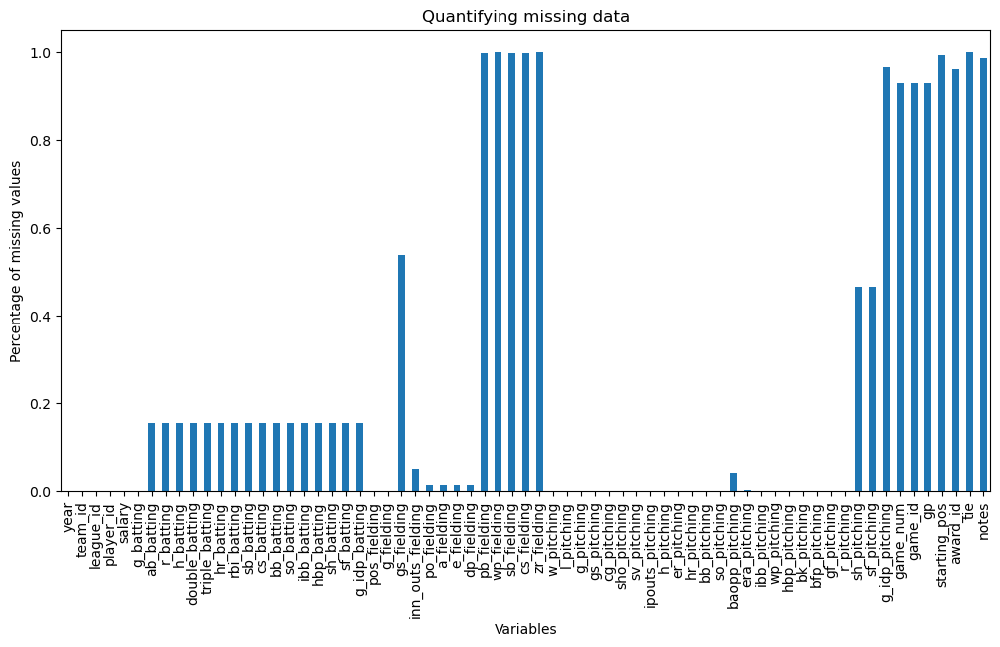

In [125]:
# visualise percentage of missing values for merged_data
merged_data.isnull().mean().plot.bar(figsize=(12,6))
plt.ylabel('Percentage of missing values')
plt.xlabel('Variables')
plt.title('Quantifying missing data')

Text(0.5, 1.0, 'Cardinality')

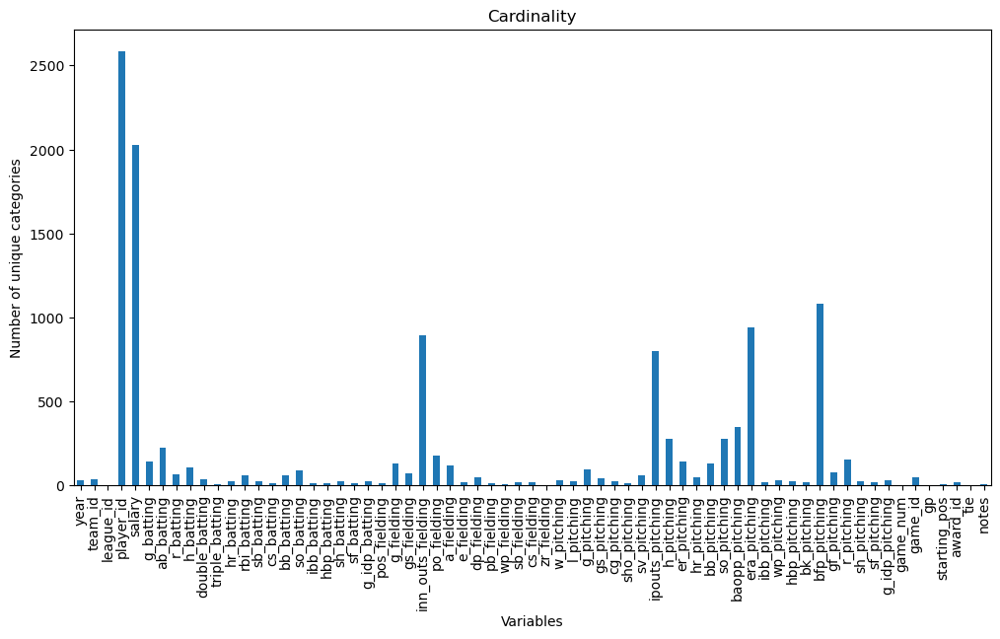

In [126]:
# visualise cardinality of merged_data
merged_data.nunique().plot.bar(figsize=(12,6))

plt.ylabel('Number of unique categories')
plt.xlabel('Variables')
plt.title('Cardinality')

In [127]:
# identify date range of merged_data
merged_data['year'].agg(['min', 'max'])

min    1985
max    2015
Name: year, dtype: int64

In [128]:
#show categorical columns
cat_cols = [c for c in merged_data.columns if merged_data[c].dtypes=='O']
print(merged_data[cat_cols].isnull().mean().sort_values())

team_id         0.000000
league_id       0.000000
player_id       0.000000
pos_fielding    0.000000
game_id         0.928353
award_id        0.960518
notes           0.984400
tie             0.998794
dtype: float64


In [129]:
# find cardinality for team_id
merged_data['team_id'].nunique()

35

In [130]:
# find percentage of how much each category takes up for merged_data for team_id
merged_data['team_id'].value_counts()/len(merged_data)

team_id
SLN    0.042297
BOS    0.038678
TEX    0.035944
CHN    0.035864
LAN    0.035864
CLE    0.035783
PIT    0.035783
OAK    0.035703
NYN    0.035703
SDN    0.035622
PHI    0.035622
NYA    0.034899
CIN    0.034899
KCA    0.034657
CHA    0.034095
ATL    0.034014
DET    0.033532
TOR    0.033451
BAL    0.033130
SFN    0.032888
MIN    0.032486
HOU    0.032165
SEA    0.031039
COL    0.025249
FLO    0.023319
MON    0.022435
MIL    0.020505
ARI    0.020103
TBA    0.019942
ML4    0.014555
CAL    0.013188
WAS    0.012464
LAA    0.011579
ANA    0.008443
MIA    0.004101
Name: count, dtype: float64

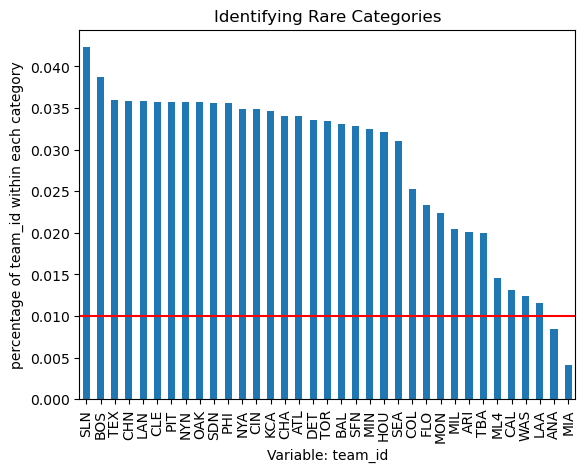

In [ ]:
# label_freq = merged_data['team_id'].value_counts() / len(merged_data)

# fig = label_freq.sort_values(ascending=False).plot.bar()

# # add a line to signal 1 % frequency limit
# # under which we will consider a category as rare
# fig.axhline(y=0.01, color='red')

# # add axis labels and title
# fig.set_ylabel('percentage of team_id within each category')
# fig.set_xlabel('Variable: team_id')
# fig.set_title('Identifying Rare Categories')
# plt.show()

In [132]:
# find cardinality for player_id
merged_data['player_id'].nunique()

2586

In [133]:
# find cardinality for player_id
merged_data['league_id'].nunique()

2

In [134]:
# find percentage of how much each category takes up for merged_data for league_id
merged_data['league_id'].value_counts()/len(merged_data)

league_id
NL    0.516404
AL    0.483596
Name: count, dtype: float64

In [135]:
# find cardinality for pos_fielding
merged_data['pos_fielding'].nunique()

11

In [136]:
# find percentage of how much each category takes up for merged_data for pos_fielding
merged_data['pos_fielding'].value_counts()/len(merged_data)

pos_fielding
P     0.943390
OF    0.010132
RF    0.007961
LF    0.007720
1B    0.006513
3B    0.006513
2B    0.004664
SS    0.004181
CF    0.003779
DH    0.002975
C     0.002171
Name: count, dtype: float64

In [137]:
# find cardinality for award_id
merged_data['award_id'].nunique()

15

In [138]:
# find percentage of how much each category takes up for merged_data for award_id
merged_data['award_id'].value_counts()/len(merged_data)

award_id
TSN All-Star                   0.006996
Cy Young Award                 0.004986
Gold Glove                     0.004905
Rolaids Relief Man Award       0.004664
TSN Pitcher of the Year        0.004583
TSN Fireman of the Year        0.002895
Silver Slugger                 0.002573
TSN Reliever of the Year       0.001608
Rookie of the Year             0.001287
Babe Ruth Award                0.001126
NLCS MVP                       0.001126
ALCS MVP                       0.000965
Pitching Triple Crown          0.000724
Comeback Player of the Year    0.000724
Most Valuable Player           0.000322
Name: count, dtype: float64

In [139]:
#show categorical columns
cat_cols = [c for c in merged_data.columns if merged_data[c].dtypes=='O']
print(merged_data[cat_cols].isnull().mean().sort_values())

team_id         0.000000
league_id       0.000000
player_id       0.000000
pos_fielding    0.000000
game_id         0.928353
award_id        0.960518
notes           0.984400
tie             0.998794
dtype: float64


In [140]:
#show numerical columns
num_cols = [c for c in merged_data.columns if merged_data[c].dtypes!='O']
print(merged_data[num_cols].isnull().mean().sort_values())


year                 0.000000
l_pitching           0.000000
g_pitching           0.000000
gs_pitching          0.000000
cg_pitching          0.000000
sho_pitching         0.000000
sv_pitching          0.000000
ipouts_pitching      0.000000
h_pitching           0.000000
er_pitching          0.000000
hr_pitching          0.000000
bb_pitching          0.000000
so_pitching          0.000000
ibb_pitching         0.000000
wp_pitching          0.000000
hbp_pitching         0.000000
bk_pitching          0.000000
bfp_pitching         0.000000
w_pitching           0.000000
gf_pitching          0.000000
r_pitching           0.000000
g_fielding           0.000000
salary               0.000000
g_batting            0.000000
era_pitching         0.001367
po_fielding          0.012383
a_fielding           0.012383
e_fielding           0.012383
dp_fielding          0.012383
baopp_pitching       0.041090
inn_outs_fielding    0.050338
hr_batting           0.153586
triple_batting       0.153586
double_bat

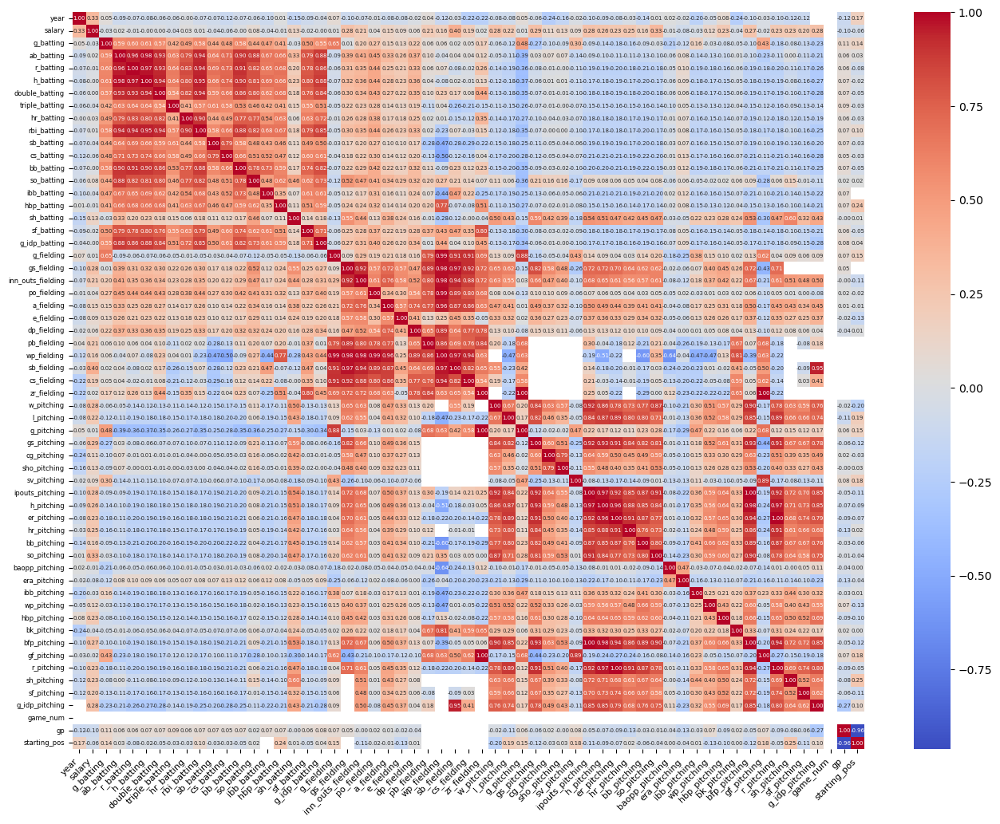

In [141]:
#show correlation
correlation_matrix = merged_data[num_cols].corr()

plt.figure(figsize=(16, 12))
heatmap = sns.heatmap(correlation_matrix, cmap='coolwarm', annot=True, fmt='.2f', annot_kws={"size": 5})

heatmap.set_xticklabels(heatmap.get_xticklabels(), rotation=45, horizontalalignment='right', fontsize=8)
heatmap.set_yticklabels(heatmap.get_yticklabels(), fontsize=6)

plt.show()

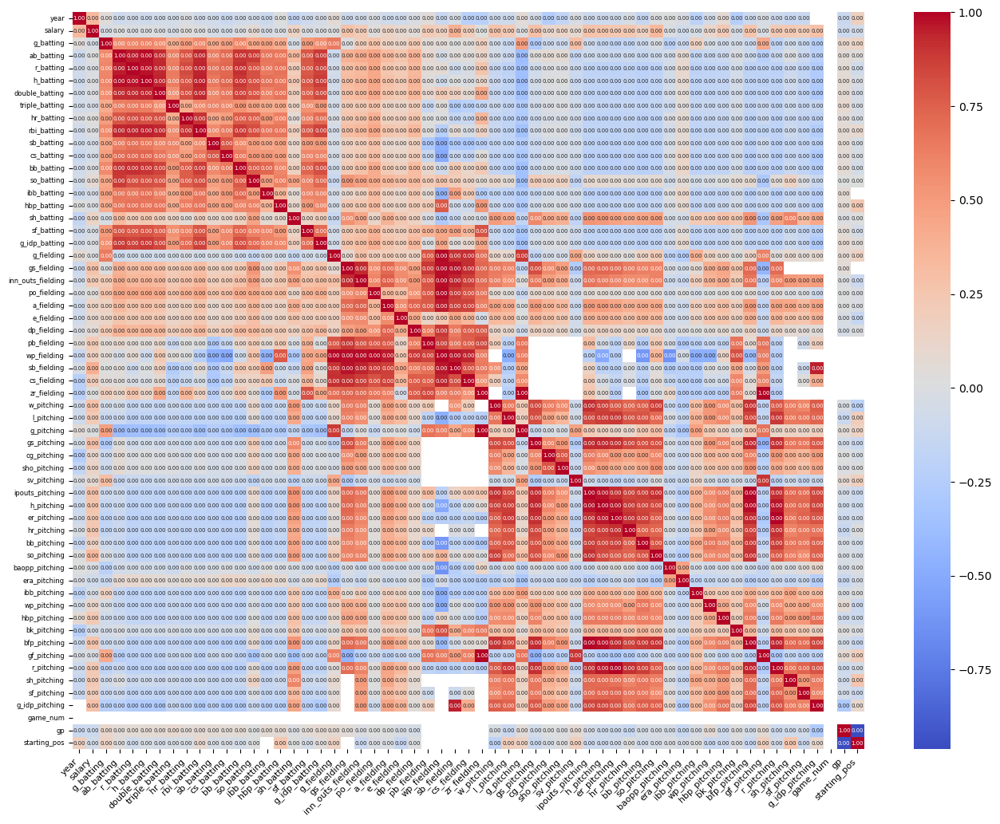

In [142]:
#show correlation
correlation_matrix = merged_data[num_cols].corr()

# create a mask to show only correlation values of 1 to show columns with high correlation more easily
mask = np.isclose(correlation_matrix, 1.0)

plt.figure(figsize=(16, 12))
heatmap = sns.heatmap(correlation_matrix, cmap='coolwarm', annot=mask, fmt='.2f', annot_kws={"size": 5})

heatmap.set_xticklabels(heatmap.get_xticklabels(), rotation=45, horizontalalignment='right', fontsize=8)
heatmap.set_yticklabels(heatmap.get_yticklabels(), fontsize=6)

plt.show()


In [143]:
# This is to find out how many columns has no missing values
# calculate the percentage of missing values for each column
missing_percentage = merged_data.isnull().mean()

# sort the values in ascending order
sorted_missing_percentage = missing_percentage.sort_values(ascending=True)

# filter columns with a percentage of missing values above a specified threshold
threshold = 0  
filtered_columns = sorted_missing_percentage[sorted_missing_percentage <= threshold]
num_filtered_columns = len(filtered_columns)

print(filtered_columns)
print(f'number of columns with no missing values: {num_filtered_columns}')

year               0.0
g_pitching         0.0
gs_pitching        0.0
cg_pitching        0.0
g_fielding         0.0
pos_fielding       0.0
sho_pitching       0.0
sv_pitching        0.0
ipouts_pitching    0.0
h_pitching         0.0
er_pitching        0.0
hr_pitching        0.0
bb_pitching        0.0
l_pitching         0.0
so_pitching        0.0
ibb_pitching       0.0
wp_pitching        0.0
hbp_pitching       0.0
bk_pitching        0.0
bfp_pitching       0.0
gf_pitching        0.0
r_pitching         0.0
g_batting          0.0
salary             0.0
player_id          0.0
league_id          0.0
team_id            0.0
w_pitching         0.0
dtype: float64
number of columns with no missing values: 28


In [144]:
# This is to find out how many columns has missing values
# calculate the percentage of missing values for each column
missing_percentage = merged_data.isnull().mean()

# sort the values in ascending order
sorted_missing_percentage = missing_percentage.sort_values(ascending=True)

# filter columns with a percentage of missing values above a specified threshold
threshold = 0  
filtered_columns = sorted_missing_percentage[sorted_missing_percentage > threshold]
num_filtered_columns = len(filtered_columns)

print(filtered_columns)
print(f'number of columns with missing values: {num_filtered_columns}')

era_pitching         0.001367
dp_fielding          0.012383
e_fielding           0.012383
a_fielding           0.012383
po_fielding          0.012383
baopp_pitching       0.041090
inn_outs_fielding    0.050338
ibb_batting          0.153586
cs_batting           0.153586
bb_batting           0.153586
so_batting           0.153586
hr_batting           0.153586
hbp_batting          0.153586
sh_batting           0.153586
g_idp_batting        0.153586
sb_batting           0.153586
triple_batting       0.153586
double_batting       0.153586
h_batting            0.153586
r_batting            0.153586
ab_batting           0.153586
sf_batting           0.153586
rbi_batting          0.153586
sf_pitching          0.465182
sh_pitching          0.465182
gs_fielding          0.538437
game_num             0.928353
game_id              0.928353
gp                   0.929399
award_id             0.960518
g_idp_pitching       0.965343
notes                0.984400
starting_pos         0.992120
sb_fieldin

In [145]:
merged_data.dtypes

year              int32
team_id          object
league_id        object
player_id        object
salary            int64
                 ...   
gp              float64
starting_pos    float64
award_id         object
tie              object
notes            object
Length: 67, dtype: object

In [146]:
cat_cols = [c for c in merged_data.columns if merged_data[c].dtypes=='O']
print(merged_data[cat_cols].isnull().mean().sort_values())

team_id         0.000000
league_id       0.000000
player_id       0.000000
pos_fielding    0.000000
game_id         0.928353
award_id        0.960518
notes           0.984400
tie             0.998794
dtype: float64


In [147]:
num_cols = [c for c in merged_data.columns if merged_data[c].dtypes!='O']
print(merged_data[num_cols].isnull().mean().sort_values())

year                 0.000000
l_pitching           0.000000
g_pitching           0.000000
gs_pitching          0.000000
cg_pitching          0.000000
sho_pitching         0.000000
sv_pitching          0.000000
ipouts_pitching      0.000000
h_pitching           0.000000
er_pitching          0.000000
hr_pitching          0.000000
bb_pitching          0.000000
so_pitching          0.000000
ibb_pitching         0.000000
wp_pitching          0.000000
hbp_pitching         0.000000
bk_pitching          0.000000
bfp_pitching         0.000000
w_pitching           0.000000
gf_pitching          0.000000
r_pitching           0.000000
g_fielding           0.000000
salary               0.000000
g_batting            0.000000
era_pitching         0.001367
po_fielding          0.012383
a_fielding           0.012383
e_fielding           0.012383
dp_fielding          0.012383
baopp_pitching       0.041090
inn_outs_fielding    0.050338
hr_batting           0.153586
triple_batting       0.153586
double_bat

In [148]:
merged_data[num_cols].describe()

,year,salary,g_batting,ab_batting,r_batting,h_batting,double_batting,triple_batting,hr_batting,rbi_batting,sb_batting,cs_batting,bb_batting,so_batting,ibb_batting,hbp_batting,sh_batting,sf_batting,g_idp_batting,g_fielding,gs_fielding,inn_outs_fielding,po_fielding,a_fielding,e_fielding,dp_fielding,pb_fielding,wp_fielding,sb_fielding,cs_fielding,zr_fielding,w_pitching,l_pitching,g_pitching,gs_pitching,cg_pitching,sho_pitching,sv_pitching,ipouts_pitching,h_pitching,er_pitching,hr_pitching,bb_pitching,so_pitching,baopp_pitching,era_pitching,ibb_pitching,wp_pitching,hbp_pitching,bk_pitching,bfp_pitching,gf_pitching,r_pitching,sh_pitching,sf_pitching,g_idp_pitching,game_num,gp,starting_pos
count,12436.000000,1.243600e+04,12436.000000,10526.000000,10526.000000,10526.000000,10526.000000,10526.000000,10526.000000,10526.000000,10526.000000,10526.000000,10526.000000,10526.000000,10526.000000,10526.000000,10526.000000,10526.000000,10526.000000,12436.000000,5740.000000,11810.000000,12282.000000,12282.000000,12282.000000,12282.000000,27.000000,8.000000,27.000000,27.000000,8.00000,12436.000000,12436.000000,12436.000000,12436.000000,12436.000000,12436.000000,12436.000000,12436.000000,12436.000000,12436.000000,12436.000000,12436.000000,12436.000000,11925.000000,12419.000000,12436.000000,12436.000000,12436.000000,12436.000000,12436.000000,12436.000000,12436.000000,6651.000000,6651.000000,431.000000,891.0,878.000000,98.000000
mean,2000.730621,1.855807e+06,38.588453,30.516625,2.876971,6.308284,1.123124,0.106403,0.417348,2.671670,0.292039,0.161790,2.176040,7.895497,0.132624,0.162835,1.665970,0.177845,0.572582,33.574702,11.227003,286.381626,8.033138,12.661863,0.843267,1.104706,2.888889,12.500000,19.777778,8.962963,0.25000,5.077839,4.777099,32.488984,9.966951,0.714538,0.231666,2.914442,260.652219,85.779592,39.187601,9.244050,30.991557,63.955211,0.248834,4.844789,2.539161,3.009730,2.830170,0.457703,371.427951,9.010454,42.898922,2.961209,2.471358,6.241299,0.0,0.725513,1.051020
std,8.699179,3.027306e+06,25.750561,72.415643,8.955194,18.629746,3.690219,0.491334,2.017114,8.633973,1.668324,0.801274,7.247683,14.816018,0.778869,0.712488,3.012493,0.702427,1.883547,21.495165,14.534870,268.399905,23.412731,16.489397,1.289384,3.037444,3.004270,10.717142,16.980381,8.192311,0.46291,5.137769,4.123565,21.210124,12.813278,1.862214,0.701401,8.530053,210.666669,68.820615,31.106568,8.156897,23.725766,55.463504,0.087841,4.457540,2.563577,3.077341,3.005521,0.996284,293.593487,14.125119,33.965057,3.132608,2.366727,6.139636,0.0,0.446510,0.525091
min,1985.000000,6.000000e+04,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000
25%,1994.000000,2.750000e+05,21.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,18.000000,0.000000,114.000000,1.000000,4.000000,0.000000,0.000000,1.000000,6.750000,7.500000,2.500000,0.00000,1.000000,1.000000,16.000000,0.000000,0.000000,0.000000,0.000000,96.000000,33.000000,15.000000,3.000000,13.000000,22.000000,0.227000,3.210000,1.000000,1.000000,1.000000,0.000000,142.000000,0.000000,17.000000,1.000000,1.000000,1.000000,0.0,0.000000,1.000000
50%,2001.000000,5.250500e+05,33.000000,3.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,31.000000,4.000000,212.000000,4.000000,9.000000,0.000000,0.000000,2.000000,13.500000,14.000000,7.000000,0.00000,3.000000,4.000000,31.000000,1.000000,0.000000,0.000000,0.000000,202.000000,6

### Step 3: Data Cleansing and Transformation

In [149]:
# calculate the number of null values in each column
null_values = merged_data.isnull().sum()

# filter to show only columns with null values
null_values_with_nulls = null_values[null_values > 0]

print(null_values_with_nulls.sort_values(ascending=True))


era_pitching            17
a_fielding             154
dp_fielding            154
e_fielding             154
po_fielding            154
baopp_pitching         511
inn_outs_fielding      626
g_idp_batting         1910
sf_batting            1910
sh_batting            1910
hbp_batting           1910
ab_batting            1910
so_batting            1910
r_batting             1910
h_batting             1910
ibb_batting           1910
triple_batting        1910
hr_batting            1910
double_batting        1910
sb_batting            1910
cs_batting            1910
bb_batting            1910
rbi_batting           1910
sh_pitching           5785
sf_pitching           5785
gs_fielding           6696
game_id              11545
game_num             11545
gp                   11558
award_id             11945
g_idp_pitching       12005
notes                12242
starting_pos         12338
sb_fielding          12409
pb_fielding          12409
cs_fielding          12409
tie                  12421
w

In [150]:
# drop rows with missing values for era_pitching
merged_data = merged_data.dropna(subset=['era_pitching'])

In [151]:
# calculate the number of null values in each column
null_values = merged_data.isnull().sum()

# filter to show only columns with null values
null_values_with_nulls = null_values[null_values > 0]

print(null_values_with_nulls.sort_values(ascending=True))

po_fielding            151
dp_fielding            151
e_fielding             151
a_fielding             151
baopp_pitching         496
inn_outs_fielding      621
g_idp_batting         1910
sf_batting            1910
sh_batting            1910
hbp_batting           1910
ibb_batting           1910
ab_batting            1910
bb_batting            1910
r_batting             1910
so_batting            1910
h_batting             1910
triple_batting        1910
double_batting        1910
rbi_batting           1910
sb_batting            1910
cs_batting            1910
hr_batting            1910
sh_pitching           5780
sf_pitching           5780
gs_fielding           6682
game_id              11528
game_num             11528
gp                   11541
award_id             11928
g_idp_pitching       11988
notes                12225
starting_pos         12321
cs_fielding          12393
pb_fielding          12393
sb_fielding          12393
tie                  12404
wp_fielding          12411
z

In [152]:
merged_data.shape

(12419, 67)

In [153]:
# Select only the columns 'g_pitching' and 'zr_fielding'
selected_columns = merged_data[['g_pitching', 'zr_fielding']]

selected_columns.head()

,g_pitching,zr_fielding
0,20,NaN
1,37,NaN
2,66,NaN
3,60,NaN
4,46,NaN


In [154]:
# print number of missing data for both variables
missing_data_counts = selected_columns.isnull().sum()
print(missing_data_counts)


g_pitching         0
zr_fielding    12411
dtype: int64


c:\Users\user\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


Text(29.140624999999993, 0.5, 'zr_fielding')

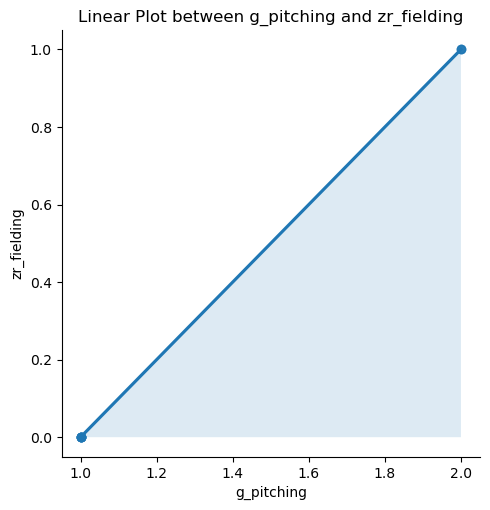

In [155]:
sns.lmplot(x='g_pitching', y='zr_fielding', data=merged_data)
plt.title('Linear Plot between g_pitching and zr_fielding')
plt.xlabel('g_pitching')
plt.ylabel('zr_fielding')

In [156]:
# Select only the columns 'gf_pitching' and 'zr_fielding'
selected_columns = merged_data[['gf_pitching', 'zr_fielding']]

selected_columns.head()

,gf_pitching,zr_fielding
0,1.0,NaN
1,0.0,NaN
2,23.0,NaN
3,15.0,NaN
4,19.0,NaN


In [157]:
# print number of missing data for both variables
missing_data_counts = selected_columns.isnull().sum()
print(missing_data_counts)


gf_pitching        0
zr_fielding    12411
dtype: int64


c:\Users\user\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


Text(29.140624999999993, 0.5, 'zr_fielding')

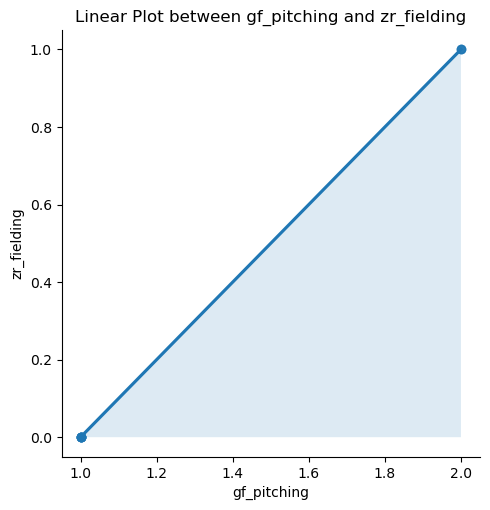

In [158]:
sns.lmplot(x='gf_pitching', y='zr_fielding', data=merged_data)
plt.title('Linear Plot between gf_pitching and zr_fielding')
plt.xlabel('gf_pitching')
plt.ylabel('zr_fielding')

In [159]:
# This is to find out columns with a lot of missing values
# calculate the percentage of missing values for each column
missing_percentage = merged_data.isnull().mean()

# sort the values in ascending order
sorted_missing_percentage = missing_percentage.sort_values(ascending=False)

# filter columns with a percentage of missing values above a specified threshold
threshold = 0  
filtered_columns = sorted_missing_percentage[sorted_missing_percentage > threshold]
num_filtered_columns = len(filtered_columns)

print(filtered_columns)
print(f'number of columns with missing values: {num_filtered_columns}')

zr_fielding          0.999356
wp_fielding          0.999356
tie                  0.998792
cs_fielding          0.997906
pb_fielding          0.997906
sb_fielding          0.997906
starting_pos         0.992109
notes                0.984379
g_idp_pitching       0.965295
award_id             0.960464
gp                   0.929302
game_num             0.928255
game_id              0.928255
gs_fielding          0.538047
sf_pitching          0.465416
sh_pitching          0.465416
sf_batting           0.153797
ab_batting           0.153797
r_batting            0.153797
double_batting       0.153797
h_batting            0.153797
sh_batting           0.153797
hbp_batting          0.153797
ibb_batting          0.153797
so_batting           0.153797
bb_batting           0.153797
cs_batting           0.153797
sb_batting           0.153797
rbi_batting          0.153797
hr_batting           0.153797
triple_batting       0.153797
g_idp_batting        0.153797
inn_outs_fielding    0.050004
baopp_pitc

In [160]:
merged_data.isnull().sum()

year                0
team_id             0
league_id           0
player_id           0
salary              0
                ...  
gp              11541
starting_pos    12321
award_id        11928
tie             12404
notes           12225
Length: 67, dtype: int64

In [161]:
# create a boolean column indicating if player is selected for allstar game or not
merged_data['selected_for_allstar'] = merged_data['game_num'].notnull()

C:\Users\user\AppData\Local\Temp\ipykernel_6888\2709483347.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  merged_data['selected_for_allstar'] = merged_data['game_num'].notnull()


In [162]:
merged_data

,year,team_id,league_id,player_id,salary,g_batting,ab_batting,r_batting,h_batting,double_batting,triple_batting,hr_batting,rbi_batting,sb_batting,cs_batting,bb_batting,so_batting,ibb_batting,hbp_batting,sh_batting,sf_batting,g_idp_batting,pos_fielding,g_fielding,gs_fielding,inn_outs_fielding,po_fielding,a_fielding,e_fielding,dp_fielding,pb_fielding,wp_fielding,sb_fielding,cs_fielding,zr_fielding,w_pitching,l_pitching,g_pitching,gs_pitching,cg_pitching,sho_pitching,sv_pitching,ipouts_pitching,h_pitching,er_pitching,hr_pitching,bb_pitching,so_pitching,baopp_pitching,era_pitching,ibb_pitching,wp_pitching,hbp_pitching,bk_pitching,bfp_pitching,gf_pitching,r_pitching,sh_pitching,sf_pitching,g_idp_pitching,game_num,game_id,gp,starting_pos,award_id,tie,notes,selected_for_allstar
0,1985,ATL,NL,barkele01,870000,20.0,17.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,7.0,0.0,0.0,0.0,0.0,0.0,P,20,18.0,221.0,2.0,9.0,1.0,0.0,NaN,NaN,NaN,NaN,NaN,2,9,20,18,0,0,0,221.0,84,52,10,37,47,0.280,6.35,1.0,3.0,1.0,0,335.0,1.0,55,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False
1,1985,ATL,NL,bedrost01,550000,37.0,64.0,3.0,5.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,22.0,0.0,0.0,6.0,0.0,0.0,P,37,37.0,620.0,13.0,23.0,4.0,3.0,NaN,NaN,NaN,NaN,NaN,7,15,37,37,0,0,0,620.0,198,88,17,111,134,0.250,3.83,6.0,6.0,5.0,0,907.0,0.0,101,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False
2,1985,ATL,NL,campri01,633333,66.0,13.0,1.0,3.0,0.0,0.0,1.0,2.0,0.0,0.0,1.0,5.0,0.0,0.0,1.0,0.0,0.0,P,66,2.0,383.0,7.0,13.0,4.0,3.0,NaN,NaN,NaN,NaN,NaN,4,6,66,2,0,0,3,383.0,130,56,8,61,49,0.260,3.95,11.0,4.0,5.0,0,569.0,23.0,72,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False
3,1985,ATL,NL,dedmoje01,150000,60.0,9.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,3.0,0.0,0.0,1.0,0.0,0.0,P,60,0.0,258.0,9.0,27.0,2.0,4.0,NaN,NaN,NaN,NaN,NaN,6,3,60,0,0,0,0,258.0,84,39,5,49,41,0.260,4.08,14.0,2.0,1.0,1,377.0,15.0,52,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False
4,1985,ATL,NL,forstte01,483333,46.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,P,46,0.0,178.0,2.0,7.0,1.0,0.0,NaN,NaN,NaN,NaN,NaN,2,3,46,0,0,0,1,178.0,49,15,7,28,37,0.220,2.28,4.0,1.0,0.0,0,253.0,19.0,22,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12435,2015,WAS,NL,storedr01,5700000,58.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,P,58,NaN,NaN,3.0,7.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,2,2,58,0,0,0,29,165.0,45,21,4,16,67,0.220,3.44,2.0,2.0,5.0,0,228.0,35.0,23,1.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False
12436,2015,WAS,NL,strasst01,7400000,23.0,38.0,1.0,5.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,17.0,0.0,0.0,6.0,0.0,0.0,P,23,NaN,NaN,3.0,9.0,2.0,0.0,NaN,NaN,NaN,NaN,NaN,11,7,23,23,0,0,0,382.0,115,49,14,26,155,0.236,3.46,0.0,4.0,3.0,0,523.0,0.0,56,5.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False
12437,2015,WAS,NL,thornma01,3500000,60.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,P,60,NaN,NaN,2.0,8.0,0.0,1.0,NaN,NaN,NaN,NaN,NaN,2,1,60,0,0,0,0,124.0,33,10,2,11,23,0.212,2.18,3.0,1.0,1.0,0,171.0,12.0,12,2.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False
12438,2015,WAS,NL,treinbl01,512800,60.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,2.0,0.0,0.0,P,60,NaN,NaN,4.0,12.0,3.0,2.0,NaN,NaN,NaN,NaN,NaN,2,5,60,0,0,0,0,203.0,62,29,4,32,65,0.254,3.86,6.0,4.0,2.0,0,280.0,17.0,32,1.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False


In [163]:
# Group by player_id, year, league_id and team_id and count the number of unique roles
role_counts = data_fielding.groupby(['player_id', 'year','league_id','team_id'])['pos_fielding'].nunique().reset_index()
role_counts.columns = ['player_id', 'year','league_id','team_id', 'number_of_roles']

# merge the role counts back into the original dataFrame
merged_data = merged_data.merge(role_counts, on=['player_id', 'year','league_id','team_id'], how='left')

In [164]:
merged_data['pos_fielding'].value_counts()/len(merged_data)

pos_fielding
P     0.944037
OF    0.010065
RF    0.007891
LF    0.007650
1B    0.006442
3B    0.006442
2B    0.004590
SS    0.004107
CF    0.003704
DH    0.002979
C     0.002094
Name: count, dtype: float64

In [165]:
# filter merged_data to only pitchers
merged_data = merged_data[merged_data['pos_fielding'] == 'P']

In [166]:
# show that the filter was successful
merged_data['pos_fielding'].value_counts()/len(merged_data)

pos_fielding
P    1.0
Name: count, dtype: float64

In [167]:
merged_data.shape

(11724, 69)

In [168]:
merged_data

,year,team_id,league_id,player_id,salary,g_batting,ab_batting,r_batting,h_batting,double_batting,triple_batting,hr_batting,rbi_batting,sb_batting,cs_batting,bb_batting,so_batting,ibb_batting,hbp_batting,sh_batting,sf_batting,g_idp_batting,pos_fielding,g_fielding,gs_fielding,inn_outs_fielding,po_fielding,a_fielding,e_fielding,dp_fielding,pb_fielding,wp_fielding,sb_fielding,cs_fielding,zr_fielding,w_pitching,l_pitching,g_pitching,gs_pitching,cg_pitching,sho_pitching,sv_pitching,ipouts_pitching,h_pitching,er_pitching,hr_pitching,bb_pitching,so_pitching,baopp_pitching,era_pitching,ibb_pitching,wp_pitching,hbp_pitching,bk_pitching,bfp_pitching,gf_pitching,r_pitching,sh_pitching,sf_pitching,g_idp_pitching,game_num,game_id,gp,starting_pos,award_id,tie,notes,selected_for_allstar,number_of_roles
0,1985,ATL,NL,barkele01,870000,20.0,17.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,7.0,0.0,0.0,0.0,0.0,0.0,P,20,18.0,221.0,2.0,9.0,1.0,0.0,NaN,NaN,NaN,NaN,NaN,2,9,20,18,0,0,0,221.0,84,52,10,37,47,0.280,6.35,1.0,3.0,1.0,0,335.0,1.0,55,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False,1
1,1985,ATL,NL,bedrost01,550000,37.0,64.0,3.0,5.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,22.0,0.0,0.0,6.0,0.0,0.0,P,37,37.0,620.0,13.0,23.0,4.0,3.0,NaN,NaN,NaN,NaN,NaN,7,15,37,37,0,0,0,620.0,198,88,17,111,134,0.250,3.83,6.0,6.0,5.0,0,907.0,0.0,101,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False,1
2,1985,ATL,NL,campri01,633333,66.0,13.0,1.0,3.0,0.0,0.0,1.0,2.0,0.0,0.0,1.0,5.0,0.0,0.0,1.0,0.0,0.0,P,66,2.0,383.0,7.0,13.0,4.0,3.0,NaN,NaN,NaN,NaN,NaN,4,6,66,2,0,0,3,383.0,130,56,8,61,49,0.260,3.95,11.0,4.0,5.0,0,569.0,23.0,72,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False,1
3,1985,ATL,NL,dedmoje01,150000,60.0,9.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,3.0,0.0,0.0,1.0,0.0,0.0,P,60,0.0,258.0,9.0,27.0,2.0,4.0,NaN,NaN,NaN,NaN,NaN,6,3,60,0,0,0,0,258.0,84,39,5,49,41,0.260,4.08,14.0,2.0,1.0,1,377.0,15.0,52,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False,1
4,1985,ATL,NL,forstte01,483333,46.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,P,46,0.0,178.0,2.0,7.0,1.0,0.0,NaN,NaN,NaN,NaN,NaN,2,3,46,0,0,0,1,178.0,49,15,7,28,37,0.220,2.28,4.0,1.0,0.0,0,253.0,19.0,22,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12414,2015,WAS,NL,storedr01,5700000,58.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,P,58,NaN,NaN,3.0,7.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,2,2,58,0,0,0,29,165.0,45,21,4,16,67,0.220,3.44,2.0,2.0,5.0,0,228.0,35.0,23,1.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False,1
12415,2015,WAS,NL,strasst01,7400000,23.0,38.0,1.0,5.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,17.0,0.0,0.0,6.0,0.0,0.0,P,23,NaN,NaN,3.0,9.0,2.0,0.0,NaN,NaN,NaN,NaN,NaN,11,7,23,23,0,0,0,382.0,115,49,14,26,155,0.236,3.46,0.0,4.0,3.0,0,523.0,0.0,56,5.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False,1
12416,2015,WAS,NL,thornma01,3500000,60.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,P,60,NaN,NaN,2.0,8.0,0.0,1.0,NaN,NaN,NaN,NaN,NaN,2,1,60,0,0,0,0,124.0,33,10,2,11,23,0.212,2.18,3.0,1.0,1.0,0,171.0,12.0,12,2.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False,1
12417,2015,WAS,NL,treinbl01,512800,60.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,2.0,0.0,0.0,P,60,NaN,NaN,4.0,12.0,3.0,2.0,NaN,NaN,NaN,NaN,NaN,2,5,60,0,0,0,0,203.0,62,29,4,32,65,0.254,3.86,6.0,4.0,2.0,0,280.0,17.0,32,1.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False,1


In [169]:
# This is to find out columns with a lot of missing values
# calculate the percentage of missing values for each column
missing_percentage = merged_data.isnull().mean()

# sort the values in ascending order
sorted_missing_percentage = missing_percentage.sort_values(ascending=False)

# filter columns with a percentage of missing values above a specified threshold
threshold = 0  
filtered_columns = sorted_missing_percentage[sorted_missing_percentage > threshold]
num_filtered_columns = len(filtered_columns)

print(filtered_columns)
print(f'number of columns with missing values: {num_filtered_columns}')

zr_fielding          1.000000
pb_fielding          1.000000
cs_fielding          1.000000
sb_fielding          1.000000
wp_fielding          1.000000
tie                  0.998721
starting_pos         0.991641
notes                0.983623
g_idp_pitching       0.966991
award_id             0.958802
gp                   0.926134
game_id              0.925026
game_num             0.925026
gs_fielding          0.537018
sh_pitching          0.463494
sf_pitching          0.463494
sf_batting           0.162914
ab_batting           0.162914
h_batting            0.162914
g_idp_batting        0.162914
r_batting            0.162914
sh_batting           0.162914
cs_batting           0.162914
double_batting       0.162914
triple_batting       0.162914
hr_batting           0.162914
rbi_batting          0.162914
sb_batting           0.162914
bb_batting           0.162914
so_batting           0.162914
ibb_batting          0.162914
hbp_batting          0.162914
baopp_pitching       0.040515
inn_outs_f

In [170]:
# drop columns which has many missing values and categorical columns which are not as useful in predicting salary
merged_data = merged_data.drop(columns=['player_id','zr_fielding','pos_fielding','wp_fielding','pb_fielding','sb_fielding','cs_fielding'\
                                        ,'g_idp_pitching','tie','notes','game_num','gp','starting_pos','game_id'])

In [171]:
merged_data.shape

(11724, 55)

In [172]:
merged_data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 11724 entries, 0 to 12418
Data columns (total 55 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   year                  11724 non-null  int32  
 1   team_id               11724 non-null  object 
 2   league_id             11724 non-null  object 
 3   salary                11724 non-null  int64  
 4   g_batting             11724 non-null  float64
 5   ab_batting            9814 non-null   float64
 6   r_batting             9814 non-null   float64
 7   h_batting             9814 non-null   float64
 8   double_batting        9814 non-null   float64
 9   triple_batting        9814 non-null   float64
 10  hr_batting            9814 non-null   float64
 11  rbi_batting           9814 non-null   float64
 12  sb_batting            9814 non-null   float64
 13  cs_batting            9814 non-null   float64
 14  bb_batting            9814 non-null   float64
 15  so_batting            98

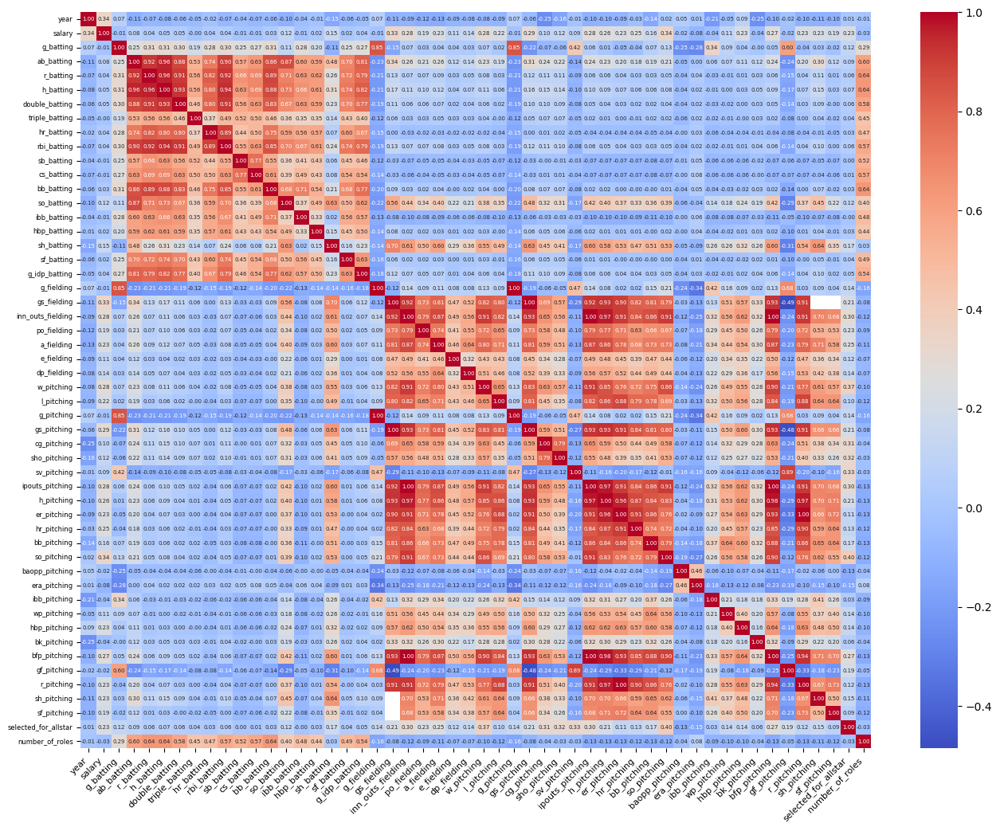

In [173]:
#show correlation
num_cols = [c for c in merged_data.columns if merged_data[c].dtypes!='O']
correlation_matrix = merged_data[num_cols].corr()

plt.figure(figsize=(16, 12))
heatmap = sns.heatmap(correlation_matrix, cmap='coolwarm', annot=True, fmt='.2f', annot_kws={"size": 5})

heatmap.set_xticklabels(heatmap.get_xticklabels(), rotation=45, horizontalalignment='right', fontsize=8)
heatmap.set_yticklabels(heatmap.get_yticklabels(), fontsize=6)

plt.show()

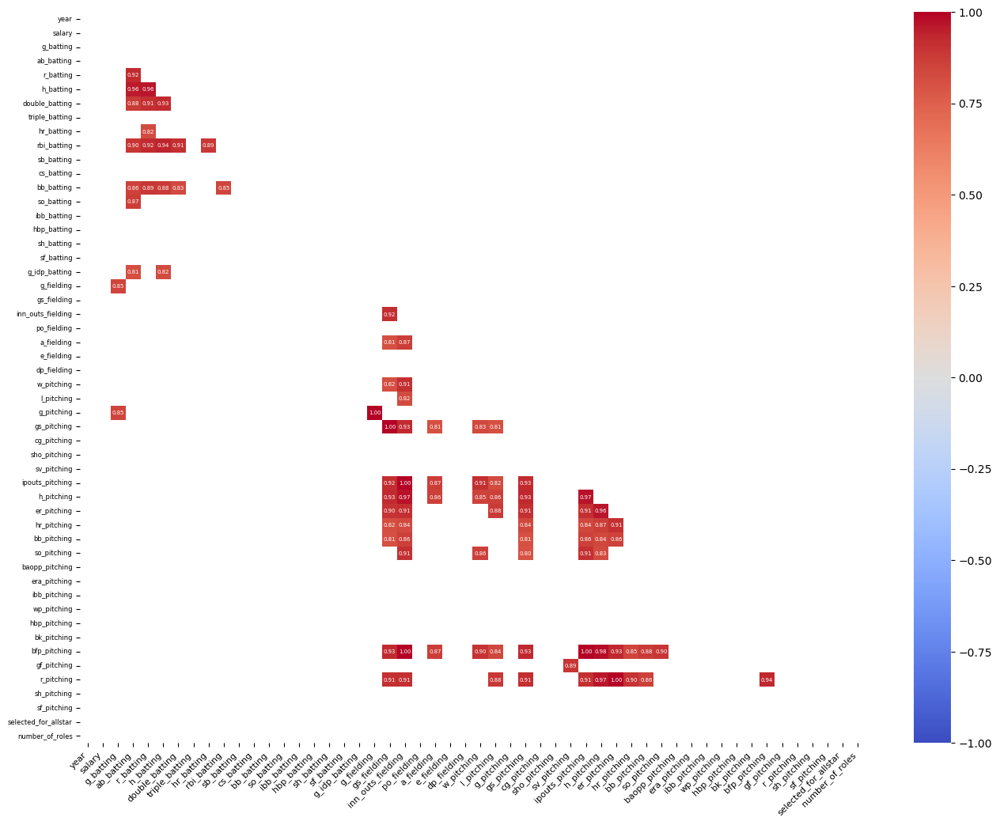

In [174]:
# plot correlation plot to show correlations above 0.8
# calculate the correlation matrix
num_cols = [c for c in merged_data.columns if merged_data[c].dtypes != 'O']
correlation_matrix = merged_data[num_cols].corr()

# create a mask for the upper triangle
mask = np.triu(np.ones_like(correlation_matrix, dtype=bool))

# apply the mask to filter correlations
filtered_corr_matrix = correlation_matrix.copy()
filtered_corr_matrix[mask] = np.nan

# create a mask for correlations less than 0.8 and greater than -0.8
mask_corr = np.abs(correlation_matrix) < 0.8

# combine masks
combined_mask = mask | mask_corr

# apply the combined mask to filtered correlation matrix
final_corr_matrix = correlation_matrix.copy()
final_corr_matrix[combined_mask] = np.nan

# plot the heatmap with the filtered correlations
plt.figure(figsize=(16, 12))
heatmap = sns.heatmap(final_corr_matrix, cmap='coolwarm', annot=True, fmt='.2f', annot_kws={"size": 5}, vmin=-1, vmax=1, center=0, mask=mask)

heatmap.set_xticklabels(heatmap.get_xticklabels(), rotation=45, horizontalalignment='right', fontsize=8)
heatmap.set_yticklabels(heatmap.get_yticklabels(), fontsize=6)

plt.show()


### Exploring columns with high correlation, adding and dropping columns

c:\Users\user\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


Text(33.51562499999999, 0.5, 'g_pitching')

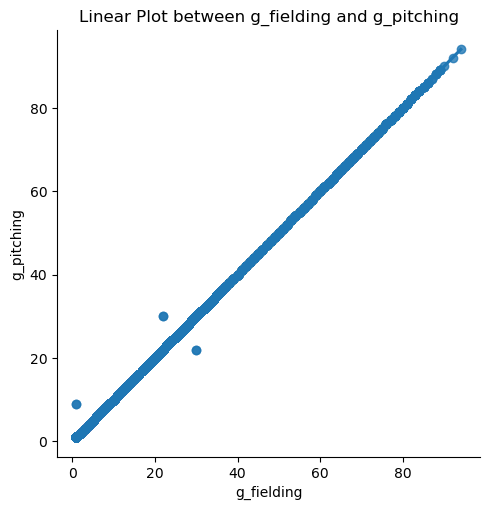

In [175]:
sns.lmplot(x='g_fielding', y='g_pitching', data=merged_data)
plt.title('Linear Plot between g_fielding and g_pitching')
plt.xlabel('g_fielding')
plt.ylabel('g_pitching')

c:\Users\user\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


Text(33.51562499999999, 0.5, 'gs_pitching')

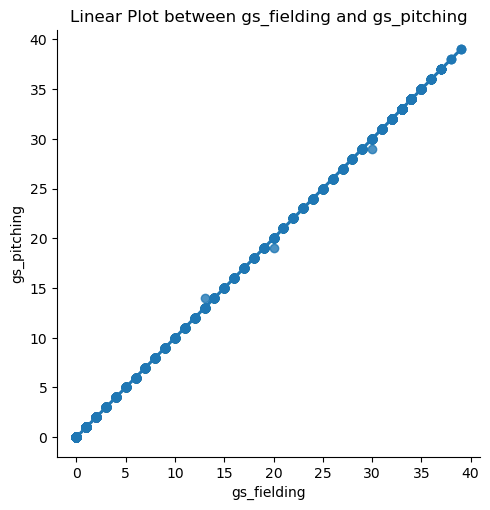

In [176]:
sns.lmplot(x='gs_fielding', y='gs_pitching', data=merged_data)
plt.title('Linear Plot between gs_fielding and gs_pitching')
plt.xlabel('gs_fielding')
plt.ylabel('gs_pitching')

c:\Users\user\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


Text(24.640625000000007, 0.5, 'inn_outs_fielding')

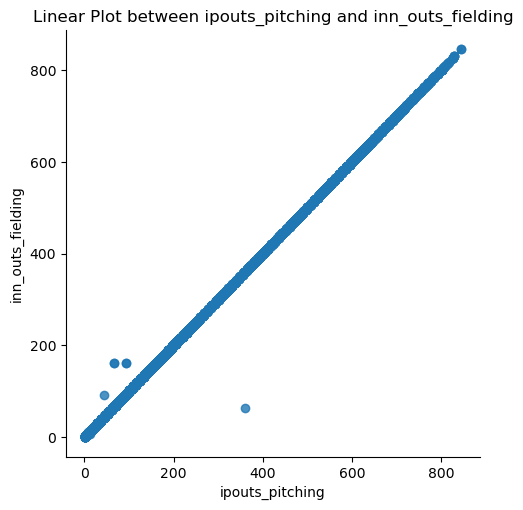

In [177]:
sns.lmplot(x='ipouts_pitching', y='inn_outs_fielding', data=merged_data)
plt.title('Linear Plot between ipouts_pitching and inn_outs_fielding')
plt.xlabel('ipouts_pitching')
plt.ylabel('inn_outs_fielding')

c:\Users\user\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


Text(24.640625000000007, 0.5, 'inn_outs_fielding')

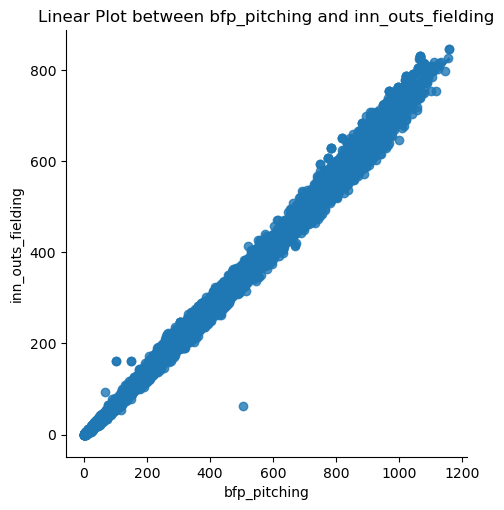

In [178]:
sns.lmplot(x='bfp_pitching', y='inn_outs_fielding', data=merged_data)
plt.title('Linear Plot between bfp_pitching and inn_outs_fielding')
plt.xlabel('bfp_pitching')
plt.ylabel('inn_outs_fielding')

c:\Users\user\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


Text(24.640625000000007, 0.5, 'ipouts_pitching')

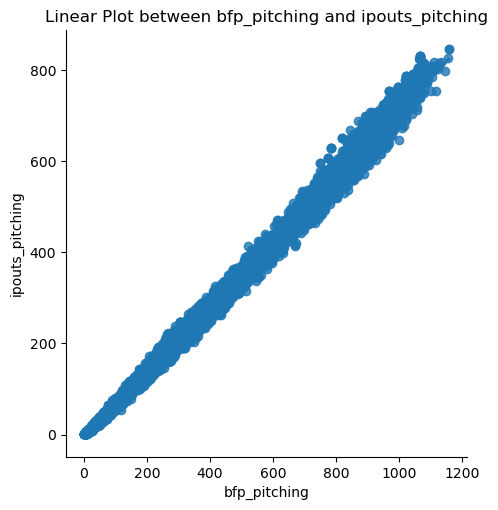

In [179]:
sns.lmplot(x='bfp_pitching', y='ipouts_pitching', data=merged_data)
plt.title('Linear Plot between bfp_pitching and ipouts_pitching')
plt.xlabel('bfp_pitching')
plt.ylabel('ipouts_pitching')

c:\Users\user\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


Text(24.640624999999993, 0.5, 'er_pitching')

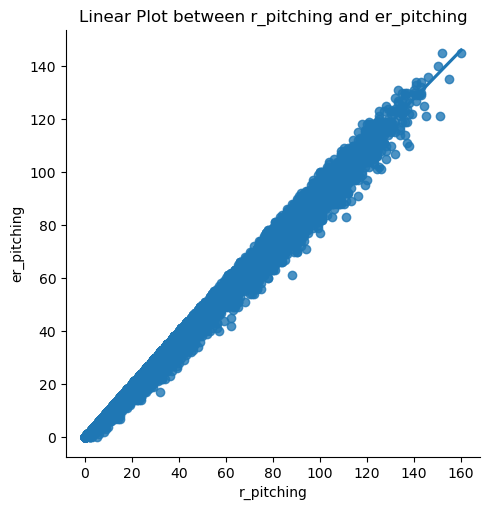

In [180]:
sns.lmplot(x='r_pitching', y='er_pitching', data=merged_data)
plt.title('Linear Plot between r_pitching and er_pitching')
plt.xlabel('r_pitching')
plt.ylabel('er_pitching')

In [181]:
#drop columns with correlation of 1
#g_pitching and gs_pitching has no null values
#gs_fielding has null values making the column that is going to be created below have an inaccurate dataset representation
merged_data = merged_data.drop(columns=['gs_fielding',\
                                        'g_fielding',\
                                            'inn_outs_fielding',\
                                                'bfp_pitching',
                                                'r_pitching'])

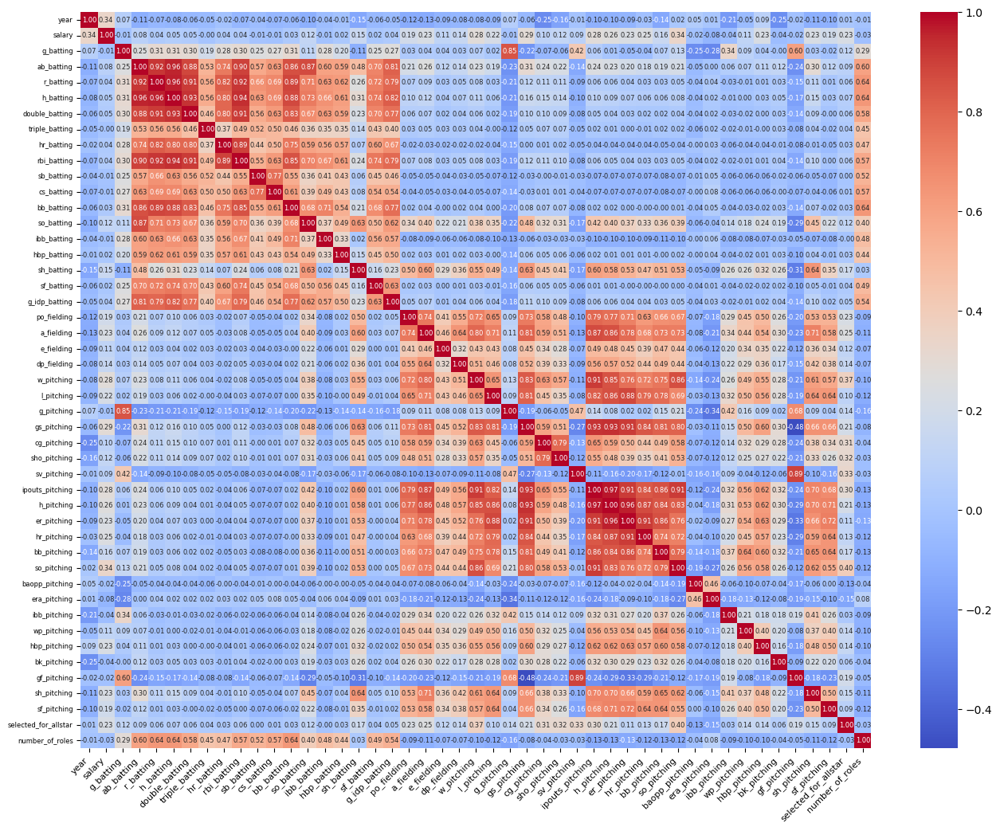

In [182]:
#show correlation
num_cols = [c for c in merged_data.columns if merged_data[c].dtypes!='O']
correlation_matrix = merged_data[num_cols].corr()

plt.figure(figsize=(16, 12))
heatmap = sns.heatmap(correlation_matrix, cmap='coolwarm', annot=True, fmt='.2f', annot_kws={"size": 6})

heatmap.set_xticklabels(heatmap.get_xticklabels(), rotation=45, horizontalalignment='right', fontsize=8)
heatmap.set_yticklabels(heatmap.get_yticklabels(), fontsize=6)

plt.show()

In [183]:
#both gs_pitching and g_pitching has no null values, making the percentage of the pitcher starting more accurate
merged_data['game_start_percentage_pitching'] = (merged_data['gs_pitching']/merged_data['g_pitching'])*100

In [184]:
merged_data.head()

,year,team_id,league_id,salary,g_batting,ab_batting,r_batting,h_batting,double_batting,triple_batting,hr_batting,rbi_batting,sb_batting,cs_batting,bb_batting,so_batting,ibb_batting,hbp_batting,sh_batting,sf_batting,g_idp_batting,po_fielding,a_fielding,e_fielding,dp_fielding,w_pitching,l_pitching,g_pitching,gs_pitching,cg_pitching,sho_pitching,sv_pitching,ipouts_pitching,h_pitching,er_pitching,hr_pitching,bb_pitching,so_pitching,baopp_pitching,era_pitching,ibb_pitching,wp_pitching,hbp_pitching,bk_pitching,gf_pitching,sh_pitching,sf_pitching,award_id,selected_for_allstar,number_of_roles,game_start_percentage_pitching
0,1985,ATL,NL,870000,20.0,17.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,7.0,0.0,0.0,0.0,0.0,0.0,2.0,9.0,1.0,0.0,2,9,20,18,0,0,0,221.0,84,52,10,37,47,0.28,6.35,1.0,3.0,1.0,0,1.0,NaN,NaN,NaN,False,1,90.000000
1,1985,ATL,NL,550000,37.0,64.0,3.0,5.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,22.0,0.0,0.0,6.0,0.0,0.0,13.0,23.0,4.0,3.0,7,15,37,37,0,0,0,620.0,198,88,17,111,134,0.25,3.83,6.0,6.0,5.0,0,0.0,NaN,NaN,NaN,False,1,100.000000
2,1985,ATL,NL,633333,66.0,13.0,1.0,3.0,0.0,0.0,1.0,2.0,0.0,0.0,1.0,5.0,0.0,0.0,1.0,0.0,0.0,7.0,13.0,4.0,3.0,4,6,66,2,0,0,3,383.0,130,56,8,61,49,0.26,3.95,11.0,4.0,5.0,0,23.0,NaN,NaN,NaN,False,1,3.030303
3,1985,ATL,NL,150000,60.0,9.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,3.0,0.0,0.0,1.0,0.0,0.0,9.0,27.0,2.0,4.0,6,3,60,0,0,0,0,258.0,84,39,5,49,41,0.26,4.08,14.0,2.0,1.0,1,15.0,NaN,NaN,NaN,False,1,0.000000
4,1985,ATL,NL,483333,46.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,2.0,7.0,1.0,0.0,2,3,46,0,0,0,1,178.0,49,15,7,28,37,0.22,2.28,4.0,1.0,0.0,0,19.0,NaN,NaN,NaN,False,1,0.000000


In [185]:
merged_data.shape

(11724, 51)

In [186]:
merged_data.head()

,year,team_id,league_id,salary,g_batting,ab_batting,r_batting,h_batting,double_batting,triple_batting,hr_batting,rbi_batting,sb_batting,cs_batting,bb_batting,so_batting,ibb_batting,hbp_batting,sh_batting,sf_batting,g_idp_batting,po_fielding,a_fielding,e_fielding,dp_fielding,w_pitching,l_pitching,g_pitching,gs_pitching,cg_pitching,sho_pitching,sv_pitching,ipouts_pitching,h_pitching,er_pitching,hr_pitching,bb_pitching,so_pitching,baopp_pitching,era_pitching,ibb_pitching,wp_pitching,hbp_pitching,bk_pitching,gf_pitching,sh_pitching,sf_pitching,award_id,selected_for_allstar,number_of_roles,game_start_percentage_pitching
0,1985,ATL,NL,870000,20.0,17.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,7.0,0.0,0.0,0.0,0.0,0.0,2.0,9.0,1.0,0.0,2,9,20,18,0,0,0,221.0,84,52,10,37,47,0.28,6.35,1.0,3.0,1.0,0,1.0,NaN,NaN,NaN,False,1,90.000000
1,1985,ATL,NL,550000,37.0,64.0,3.0,5.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,22.0,0.0,0.0,6.0,0.0,0.0,13.0,23.0,4.0,3.0,7,15,37,37,0,0,0,620.0,198,88,17,111,134,0.25,3.83,6.0,6.0,5.0,0,0.0,NaN,NaN,NaN,False,1,100.000000
2,1985,ATL,NL,633333,66.0,13.0,1.0,3.0,0.0,0.0,1.0,2.0,0.0,0.0,1.0,5.0,0.0,0.0,1.0,0.0,0.0,7.0,13.0,4.0,3.0,4,6,66,2,0,0,3,383.0,130,56,8,61,49,0.26,3.95,11.0,4.0,5.0,0,23.0,NaN,NaN,NaN,False,1,3.030303
3,1985,ATL,NL,150000,60.0,9.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,3.0,0.0,0.0,1.0,0.0,0.0,9.0,27.0,2.0,4.0,6,3,60,0,0,0,0,258.0,84,39,5,49,41,0.26,4.08,14.0,2.0,1.0,1,15.0,NaN,NaN,NaN,False,1,0.000000
4,1985,ATL,NL,483333,46.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,2.0,7.0,1.0,0.0,2,3,46,0,0,0,1,178.0,49,15,7,28,37,0.22,2.28,4.0,1.0,0.0,0,19.0,NaN,NaN,NaN,False,1,0.000000


In [187]:
merged_data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 11724 entries, 0 to 12418
Data columns (total 51 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   year                            11724 non-null  int32  
 1   team_id                         11724 non-null  object 
 2   league_id                       11724 non-null  object 
 3   salary                          11724 non-null  int64  
 4   g_batting                       11724 non-null  float64
 5   ab_batting                      9814 non-null   float64
 6   r_batting                       9814 non-null   float64
 7   h_batting                       9814 non-null   float64
 8   double_batting                  9814 non-null   float64
 9   triple_batting                  9814 non-null   float64
 10  hr_batting                      9814 non-null   float64
 11  rbi_batting                     9814 non-null   float64
 12  sb_batting                      9814 

In [188]:
# drop these columns since these columns have been used to create a new columns called game_start_percentage_pitching
merged_data = merged_data.drop(columns=['gs_pitching','g_pitching'])

In [189]:
merged_data.head()

,year,team_id,league_id,salary,g_batting,ab_batting,r_batting,h_batting,double_batting,triple_batting,hr_batting,rbi_batting,sb_batting,cs_batting,bb_batting,so_batting,ibb_batting,hbp_batting,sh_batting,sf_batting,g_idp_batting,po_fielding,a_fielding,e_fielding,dp_fielding,w_pitching,l_pitching,cg_pitching,sho_pitching,sv_pitching,ipouts_pitching,h_pitching,er_pitching,hr_pitching,bb_pitching,so_pitching,baopp_pitching,era_pitching,ibb_pitching,wp_pitching,hbp_pitching,bk_pitching,gf_pitching,sh_pitching,sf_pitching,award_id,selected_for_allstar,number_of_roles,game_start_percentage_pitching
0,1985,ATL,NL,870000,20.0,17.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,7.0,0.0,0.0,0.0,0.0,0.0,2.0,9.0,1.0,0.0,2,9,0,0,0,221.0,84,52,10,37,47,0.28,6.35,1.0,3.0,1.0,0,1.0,NaN,NaN,NaN,False,1,90.000000
1,1985,ATL,NL,550000,37.0,64.0,3.0,5.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,22.0,0.0,0.0,6.0,0.0,0.0,13.0,23.0,4.0,3.0,7,15,0,0,0,620.0,198,88,17,111,134,0.25,3.83,6.0,6.0,5.0,0,0.0,NaN,NaN,NaN,False,1,100.000000
2,1985,ATL,NL,633333,66.0,13.0,1.0,3.0,0.0,0.0,1.0,2.0,0.0,0.0,1.0,5.0,0.0,0.0,1.0,0.0,0.0,7.0,13.0,4.0,3.0,4,6,0,0,3,383.0,130,56,8,61,49,0.26,3.95,11.0,4.0,5.0,0,23.0,NaN,NaN,NaN,False,1,3.030303
3,1985,ATL,NL,150000,60.0,9.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,3.0,0.0,0.0,1.0,0.0,0.0,9.0,27.0,2.0,4.0,6,3,0,0,0,258.0,84,39,5,49,41,0.26,4.08,14.0,2.0,1.0,1,15.0,NaN,NaN,NaN,False,1,0.000000
4,1985,ATL,NL,483333,46.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,2.0,7.0,1.0,0.0,2,3,0,0,1,178.0,49,15,7,28,37,0.22,2.28,4.0,1.0,0.0,0,19.0,NaN,NaN,NaN,False,1,0.000000


In [190]:
merged_data.shape

(11724, 49)

In [191]:
merged_data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 11724 entries, 0 to 12418
Data columns (total 49 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   year                            11724 non-null  int32  
 1   team_id                         11724 non-null  object 
 2   league_id                       11724 non-null  object 
 3   salary                          11724 non-null  int64  
 4   g_batting                       11724 non-null  float64
 5   ab_batting                      9814 non-null   float64
 6   r_batting                       9814 non-null   float64
 7   h_batting                       9814 non-null   float64
 8   double_batting                  9814 non-null   float64
 9   triple_batting                  9814 non-null   float64
 10  hr_batting                      9814 non-null   float64
 11  rbi_batting                     9814 non-null   float64
 12  sb_batting                      9814 

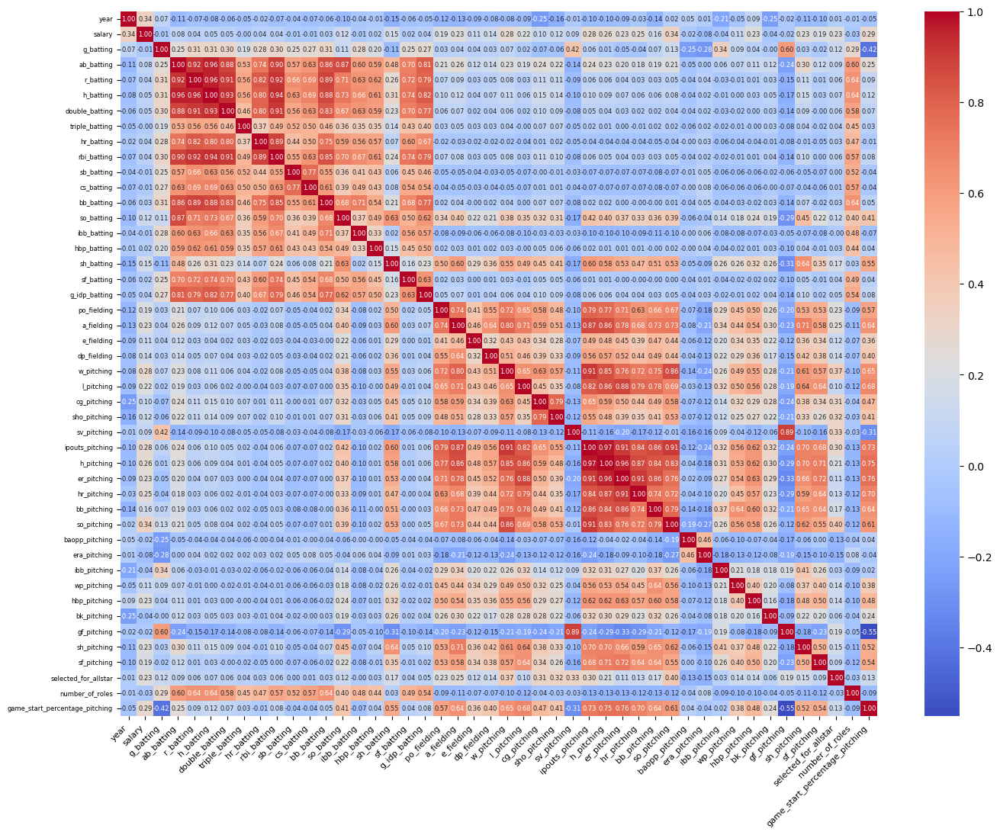

In [192]:
#show correlation
num_cols = [c for c in merged_data.columns if merged_data[c].dtypes!='O']
correlation_matrix = merged_data[num_cols].corr()

plt.figure(figsize=(16, 12))
heatmap = sns.heatmap(correlation_matrix, cmap='coolwarm', annot=True, fmt='.2f', annot_kws={"size": 6})

heatmap.set_xticklabels(heatmap.get_xticklabels(), rotation=45, horizontalalignment='right', fontsize=8)
heatmap.set_yticklabels(heatmap.get_yticklabels(), fontsize=6)

plt.show()

In [193]:
#drop highly correlated and low correlation batting columns
#even if rbi_batting has high correlation with both hr_batting and bb_batting, rbi measures a pitcher's ability 
#to score in batting which is very important.
#h_batting measures batting success and r_batting reflects scoring contributions which is also important to one's batting abaility despite the high correlation.
#hr_batting was kept as homerun indicates power-hitting and impact on runs.
#triple_batting does not have any correlation with predicting salary, thus i dropped it.
merged_data = merged_data.drop(columns=['ab_batting','double_batting','triple_batting'])

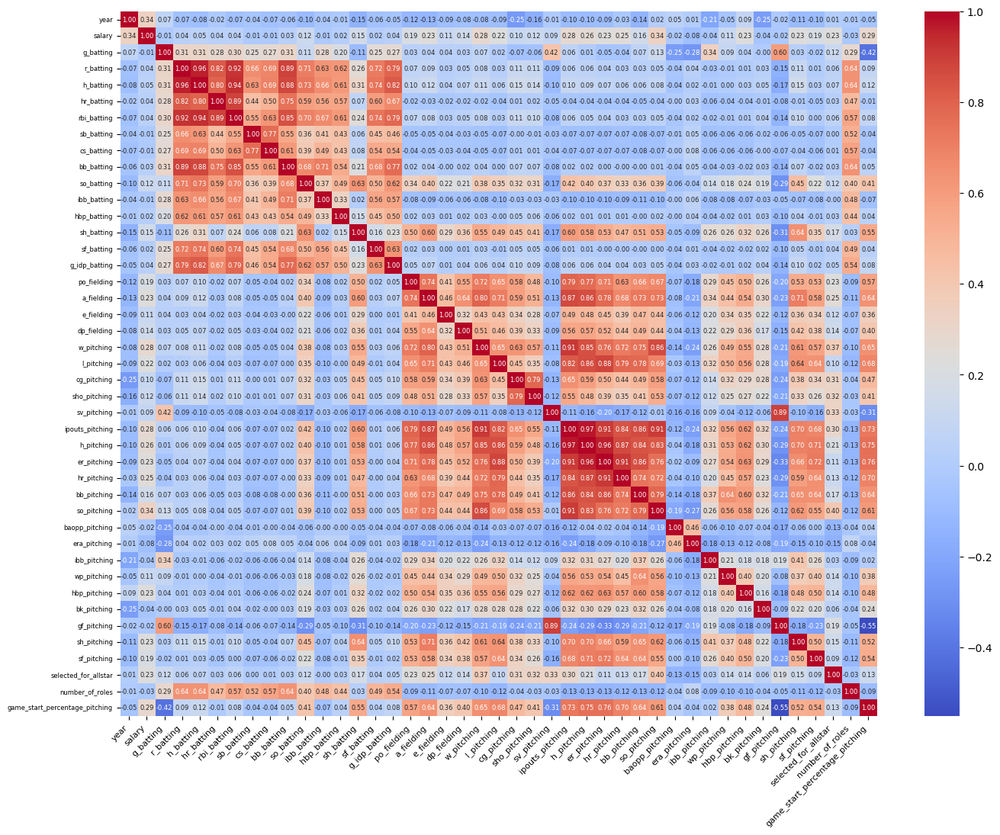

In [194]:
#show correlation
num_cols = [c for c in merged_data.columns if merged_data[c].dtypes!='O']
correlation_matrix = merged_data[num_cols].corr()

plt.figure(figsize=(16, 12))
heatmap = sns.heatmap(correlation_matrix, cmap='coolwarm', annot=True, fmt='.2f', annot_kws={"size": 6})

heatmap.set_xticklabels(heatmap.get_xticklabels(), rotation=45, horizontalalignment='right', fontsize=8)
heatmap.set_yticklabels(heatmap.get_yticklabels(), fontsize=6)

plt.show()

#### a_fielding have substantial correlation with salary even though it has high correlation with ipouts_pitching and h_pitching thus it is not dropped

In [195]:
#drop pitching columns which are highly correlated
#h_pitching is redundant if we have IPOuts and ERA.
#hr_pitching is partially redundant with er_pitching.
#gf_pitching is redundant if we retain sv_pitching.
#even though w_pitching and l_pitching has high correlation with other pitching columns like ipouts_pitching and h_pitching,
#both w_pitching and l_pitching have higher correlation with the target variable salary than the other columns, thus i chose to keep them
#ipouts_pitching,er_pitching,bb_pitching,so_pitching have higher correlation with the target variable salary 
#than the other columns, thus i chose to keep them
#ipouts_pitching directly correlates with the pitcher's workload and stamina. Essential for understanding overall pitching performance.
#er_pitching is a critical measure of a pitcher's effectiveness in preventing scoring
#bb_pitching provides insight into control and discipline.
#so_pitching demonstrates the pitcher's ability to dominate hitters.
merged_data = merged_data.drop(columns=['h_pitching','hr_pitching','gf_pitching'])

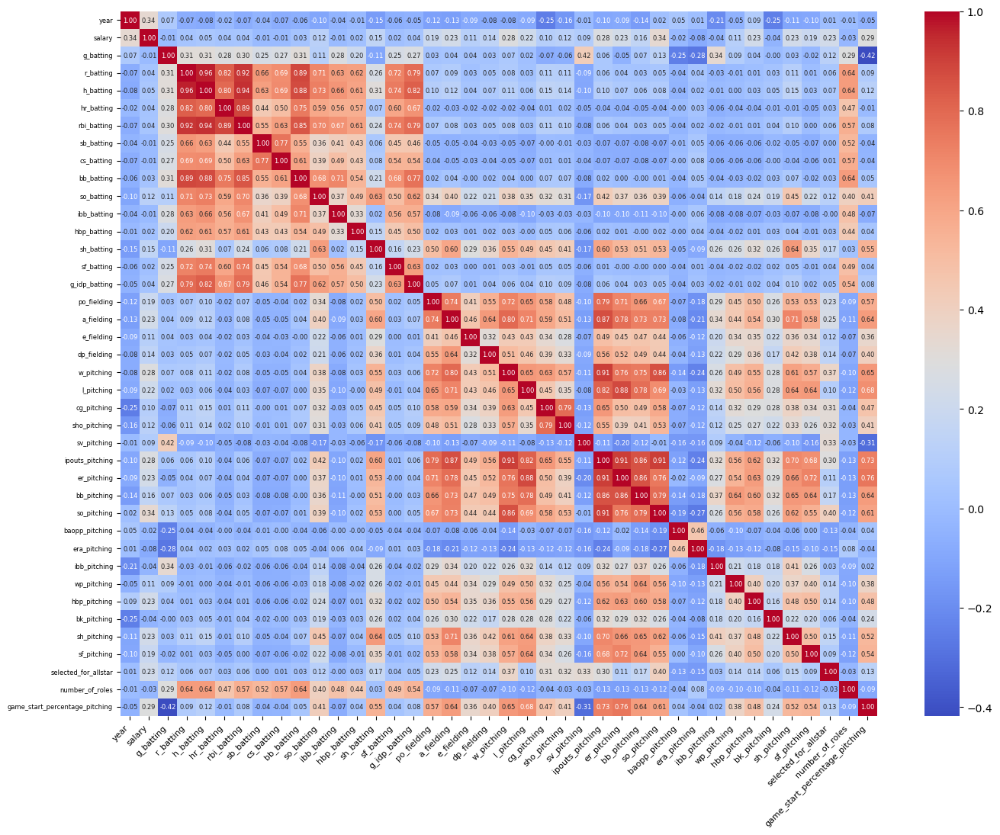

In [196]:
#show correlation
num_cols = [c for c in merged_data.columns if merged_data[c].dtypes!='O']
correlation_matrix = merged_data[num_cols].corr()

plt.figure(figsize=(16, 12))
heatmap = sns.heatmap(correlation_matrix, cmap='coolwarm', annot=True, fmt='.2f', annot_kws={"size": 6})

heatmap.set_xticklabels(heatmap.get_xticklabels(), rotation=45, horizontalalignment='right', fontsize=8)
heatmap.set_yticklabels(heatmap.get_yticklabels(), fontsize=6)

plt.show()

In [197]:
merged_data.head()

,year,team_id,league_id,salary,g_batting,r_batting,h_batting,hr_batting,rbi_batting,sb_batting,cs_batting,bb_batting,so_batting,ibb_batting,hbp_batting,sh_batting,sf_batting,g_idp_batting,po_fielding,a_fielding,e_fielding,dp_fielding,w_pitching,l_pitching,cg_pitching,sho_pitching,sv_pitching,ipouts_pitching,er_pitching,bb_pitching,so_pitching,baopp_pitching,era_pitching,ibb_pitching,wp_pitching,hbp_pitching,bk_pitching,sh_pitching,sf_pitching,award_id,selected_for_allstar,number_of_roles,game_start_percentage_pitching
0,1985,ATL,NL,870000,20.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,7.0,0.0,0.0,0.0,0.0,0.0,2.0,9.0,1.0,0.0,2,9,0,0,0,221.0,52,37,47,0.28,6.35,1.0,3.0,1.0,0,NaN,NaN,NaN,False,1,90.000000
1,1985,ATL,NL,550000,37.0,3.0,5.0,0.0,1.0,0.0,0.0,1.0,22.0,0.0,0.0,6.0,0.0,0.0,13.0,23.0,4.0,3.0,7,15,0,0,0,620.0,88,111,134,0.25,3.83,6.0,6.0,5.0,0,NaN,NaN,NaN,False,1,100.000000
2,1985,ATL,NL,633333,66.0,1.0,3.0,1.0,2.0,0.0,0.0,1.0,5.0,0.0,0.0,1.0,0.0,0.0,7.0,13.0,4.0,3.0,4,6,0,0,3,383.0,56,61,49,0.26,3.95,11.0,4.0,5.0,0,NaN,NaN,NaN,False,1,3.030303
3,1985,ATL,NL,150000,60.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,3.0,0.0,0.0,1.0,0.0,0.0,9.0,27.0,2.0,4.0,6,3,0,0,0,258.0,39,49,41,0.26,4.08,14.0,2.0,1.0,1,NaN,NaN,NaN,False,1,0.000000
4,1985,ATL,NL,483333,46.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,2.0,7.0,1.0,0.0,2,3,0,0,1,178.0,15,28,37,0.22,2.28,4.0,1.0,0.0,0,NaN,NaN,NaN,False,1,0.000000


In [198]:
merged_data.shape

(11724, 43)

In [199]:
merged_data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 11724 entries, 0 to 12418
Data columns (total 43 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   year                            11724 non-null  int32  
 1   team_id                         11724 non-null  object 
 2   league_id                       11724 non-null  object 
 3   salary                          11724 non-null  int64  
 4   g_batting                       11724 non-null  float64
 5   r_batting                       9814 non-null   float64
 6   h_batting                       9814 non-null   float64
 7   hr_batting                      9814 non-null   float64
 8   rbi_batting                     9814 non-null   float64
 9   sb_batting                      9814 non-null   float64
 10  cs_batting                      9814 non-null   float64
 11  bb_batting                      9814 non-null   float64
 12  so_batting                      9814 

In [200]:
merged_data.describe()

,year,salary,g_batting,r_batting,h_batting,hr_batting,rbi_batting,sb_batting,cs_batting,bb_batting,so_batting,ibb_batting,hbp_batting,sh_batting,sf_batting,g_idp_batting,po_fielding,a_fielding,e_fielding,dp_fielding,w_pitching,l_pitching,cg_pitching,sho_pitching,sv_pitching,ipouts_pitching,er_pitching,bb_pitching,so_pitching,baopp_pitching,era_pitching,ibb_pitching,wp_pitching,hbp_pitching,bk_pitching,sh_pitching,sf_pitching,number_of_roles,game_start_percentage_pitching
count,11724.000000,1.172400e+04,11724.000000,9814.000000,9814.000000,9814.000000,9814.000000,9814.000000,9814.000000,9814.000000,9814.000000,9814.000000,9814.000000,9814.000000,9814.000000,9814.000000,11724.000000,11724.000000,11724.000000,11724.000000,11724.000000,11724.000000,11724.000000,11724.000000,11724.000000,11724.000000,11724.000000,11724.000000,11724.000000,11249.000000,11724.000000,11724.000000,11724.000000,11724.000000,11724.000000,6290.000000,6290.000000,11724.000000,11724.000000
mean,2000.758103,1.899186e+06,35.559621,1.278684,2.954657,0.149990,1.219177,0.073670,0.043713,0.915631,5.702160,0.031893,0.069900,1.614021,0.072040,0.266762,5.784886,12.131099,0.807062,0.898243,5.332139,5.021238,0.749232,0.243176,3.047339,273.940720,41.197458,32.514244,67.269533,0.250154,4.712361,2.656175,3.160867,2.974838,0.478932,3.119078,2.604769,1.059280,41.464709
std,8.584239,3.075069e+06,21.619197,4.755028,9.933227,1.089551,4.843643,0.783748,0.392044,3.771580,10.447563,0.405935,0.407067,3.023868,0.405816,1.077910,5.894705,10.941320,1.123887,1.248717,5.132158,4.082800,1.897950,0.716943,8.703396,207.445916,30.623702,23.251813,54.853817,0.076164,3.557909,2.536050,3.075115,3.014135,1.012074,3.134800,2.361019,0.510556,45.616972
min,1985.000000,6.000000e+04,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000
25%,1994.000000,2.750000e+05,20.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,4.000000,0.000000,0.000000,1.000000,2.000000,0.000000,0.000000,0.000000,115.000000,17.000000,15.000000,26.000000,0.230000,3.277500,1.000000,1.000000,1.000000,0.000000,1.000000,1.000000,1.000000,0.000000
50%,2001.000000,5.350000e+05,32.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,4.000000,9.000000,0.000000,0.000000,4.000000,4.000000,0.000000,0.000000,0.000000,210.000000,30.000000,27.000000,54.000000,0.255000,4.170000,2.000000,2.000000,2.000000,0.000000,2.000000,2.000000,1.000000,7.827819
75%,2008.000000,2.200000e+06,50.000000,1.000000,2.000000,0.000000,1.000000,0.000000,0.000000,1.000000,7.000000,0.000000,0.000000,2.000000,0.000000,0.000000,8.000000,18.000000,1.000000,1.000000,8.000000,8.000000,0.000000,0.000000,1.000000,422.000000,66.000000,46.000000,94.000000,0.281000,5.280000,4.000000,5.000000,4.000000,1.000000,4.000000,4.000000,1.000000,100.000000
max,2015.000000,3.257100e+07,154.000000,91.000000,177.000000,33.000000,123.000000,28.000000,11.000000,97.000000,169.000000,13.000000,10.000000,20.000000,8.000000,27.000000,42.000000,71.000000,10.000000,11.000000,27.000000,21.000000,20.000000,10.000000,62.000000,845.000000,145.000000,152.000000,372.000000,0.800000,108.000000,18.000000,26.000000,21.000000,16.000000,21.000000,14.000000,10.000000,100.000000


Text(0.5, 1.0, 'Quantifying missing data')

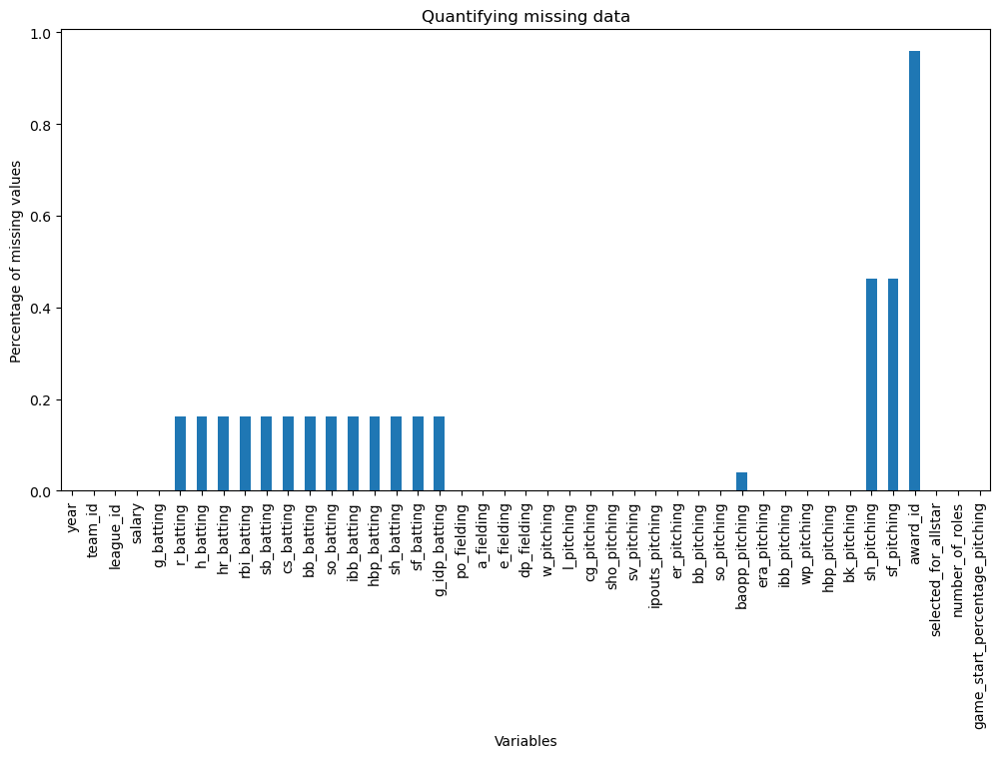

In [201]:
# visualise percentage of missing data
merged_data.isnull().mean().plot.bar(figsize=(12,6))
plt.ylabel('Percentage of missing values')
plt.xlabel('Variables')
plt.title('Quantifying missing data')

In [202]:
# identify all columns in merged_data
merged_data.columns

Index(['year', 'team_id', 'league_id', 'salary', 'g_batting', 'r_batting',
       'h_batting', 'hr_batting', 'rbi_batting', 'sb_batting', 'cs_batting',
       'bb_batting', 'so_batting', 'ibb_batting', 'hbp_batting', 'sh_batting',
       'sf_batting', 'g_idp_batting', 'po_fielding', 'a_fielding',
       'e_fielding', 'dp_fielding', 'w_pitching', 'l_pitching', 'cg_pitching',
       'sho_pitching', 'sv_pitching', 'ipouts_pitching', 'er_pitching',
       'bb_pitching', 'so_pitching', 'baopp_pitching', 'era_pitching',
       'ibb_pitching', 'wp_pitching', 'hbp_pitching', 'bk_pitching',
       'sh_pitching', 'sf_pitching', 'award_id', 'selected_for_allstar',
       'number_of_roles', 'game_start_percentage_pitching'],
      dtype='object')

### Identifying Outliers

In [203]:
def find_boundaries(df, variable):

    # distance passed as an argument, gives us the option to
    # estimate 1.5 times or 3 times the IQR to calculate
    # the boundaries.

    IQR = df[variable].quantile(0.75) - df[variable].quantile(0.25)

    lower_boundary = df[variable].quantile(0.25) - (IQR * 1.5)
    upper_boundary = df[variable].quantile(0.75) + (IQR * 1.5)

    return upper_boundary, lower_boundary


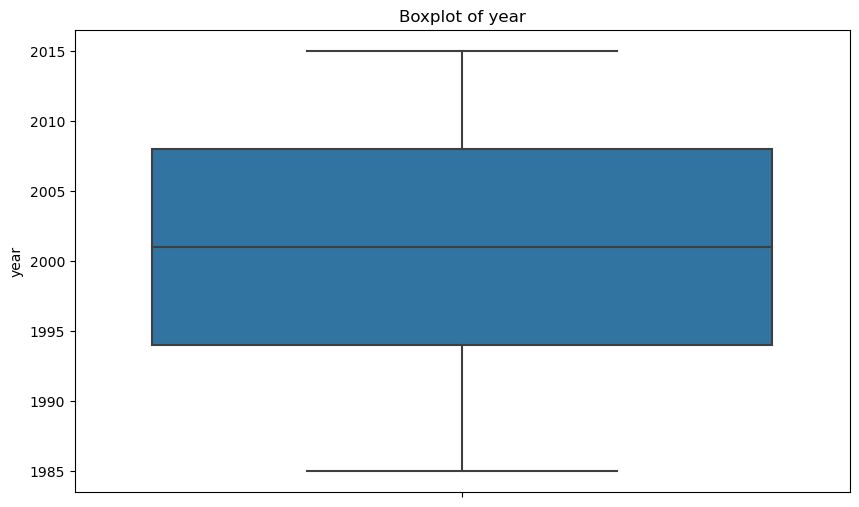

year - Upper Boundary: 2029.0, Lower Boundary: 1973.0
Number of outliers in year: 0
year - Number of unique values: 31
Outliers in year:
Series([], Name: year, dtype: int32)



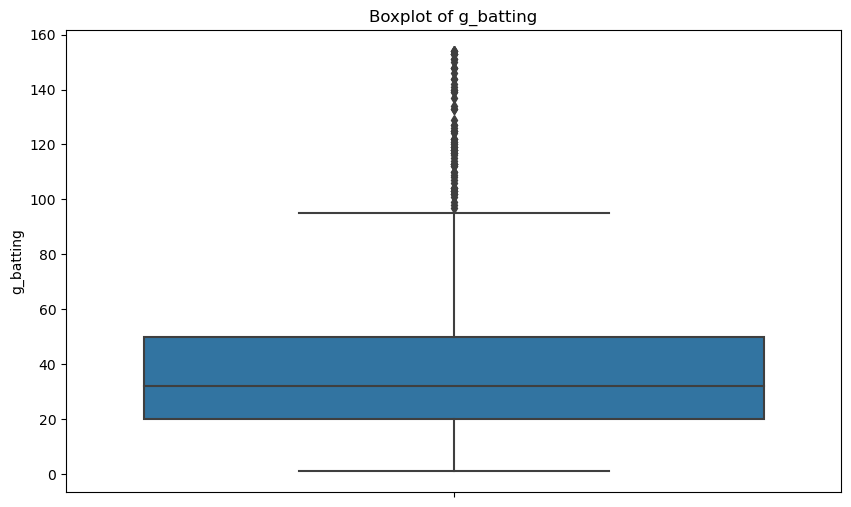

g_batting - Upper Boundary: 95.0, Lower Boundary: -25.0
Number of outliers in g_batting: 79
g_batting - Number of unique values: 137
Outliers in g_batting:
352    114.0
413    112.0
733    133.0
742    153.0
743    153.0
Name: g_batting, dtype: float64



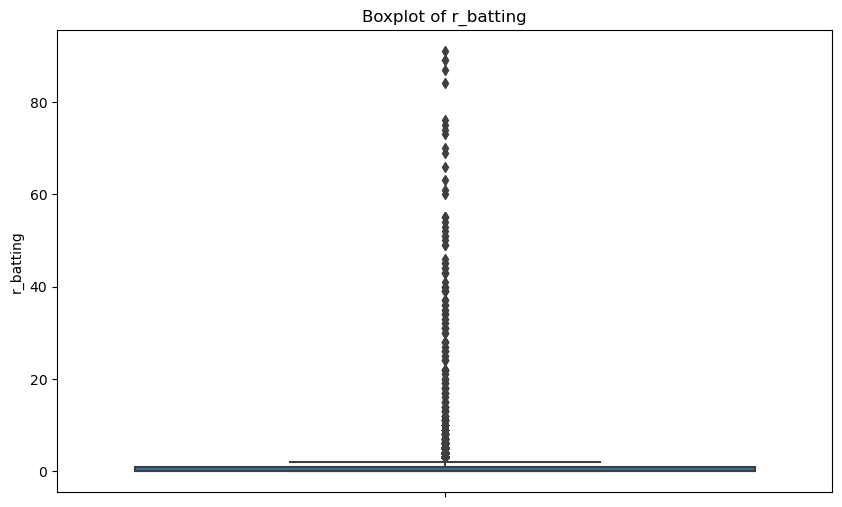

r_batting - Upper Boundary: 2.5, Lower Boundary: -1.5
Number of outliers in r_batting: 1340
r_batting - Number of unique values: 64
Outliers in r_batting:
1     3.0
6     9.0
56    4.0
58    4.0
65    3.0
Name: r_batting, dtype: float64



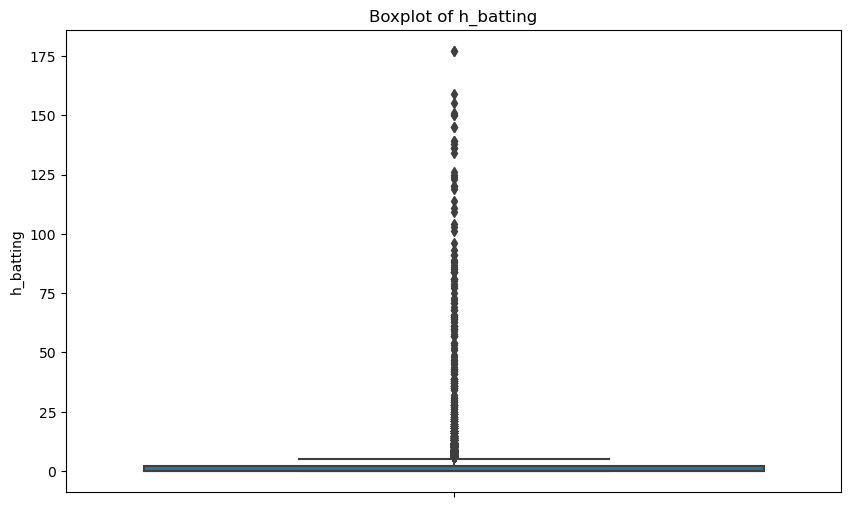

h_batting - Upper Boundary: 5.0, Lower Boundary: -3.0
Number of outliers in h_batting: 1562
h_batting - Number of unique values: 103
Outliers in h_batting:
6     14.0
49     7.0
56    10.0
58    17.0
65    11.0
Name: h_batting, dtype: float64



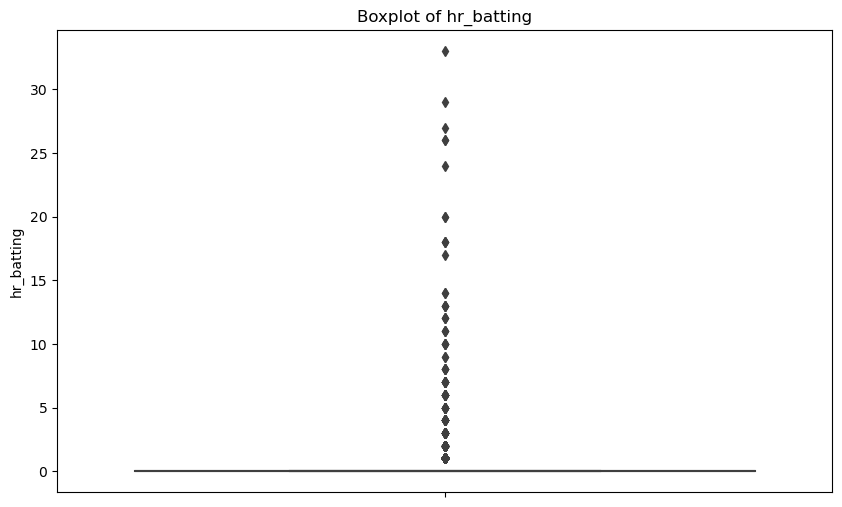

hr_batting - Upper Boundary: 0.0, Lower Boundary: 0.0
Number of outliers in hr_batting: 625
hr_batting - Number of unique values: 23
Outliers in hr_batting:
2     1.0
49    1.0
56    1.0
84    1.0
87    1.0
Name: hr_batting, dtype: float64



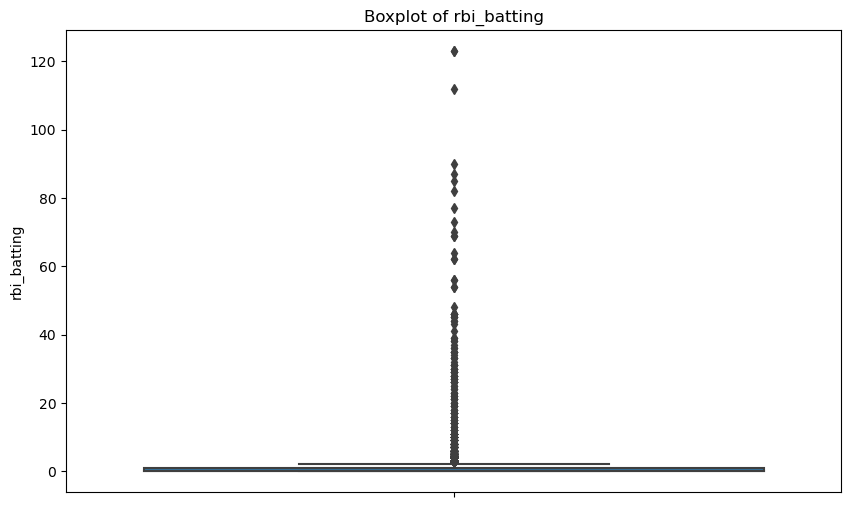

rbi_batting - Upper Boundary: 2.5, Lower Boundary: -1.5
Number of outliers in rbi_batting: 1290
rbi_batting - Number of unique values: 60
Outliers in rbi_batting:
6     8.0
56    3.0
65    4.0
67    3.0
84    5.0
Name: rbi_batting, dtype: float64



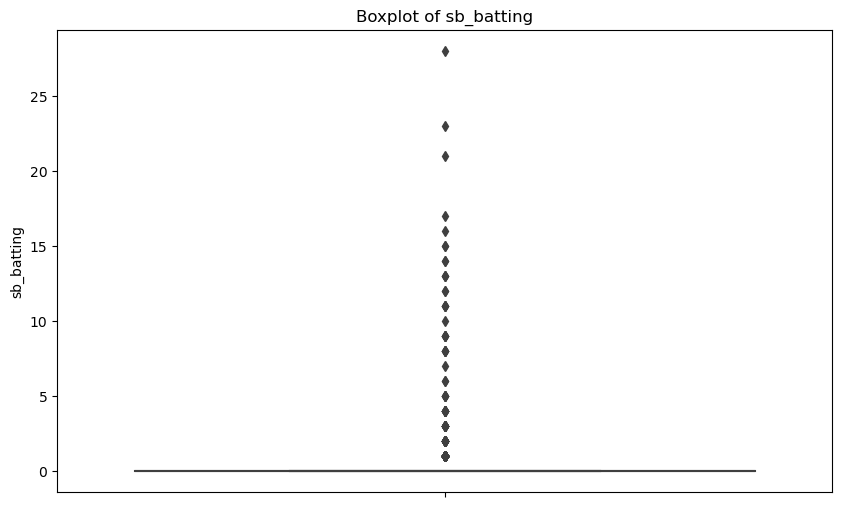

sb_batting - Upper Boundary: 0.0, Lower Boundary: 0.0
Number of outliers in sb_batting: 259
sb_batting - Number of unique values: 21
Outliers in sb_batting:
66     1.0
87     1.0
103    1.0
142    1.0
162    2.0
Name: sb_batting, dtype: float64



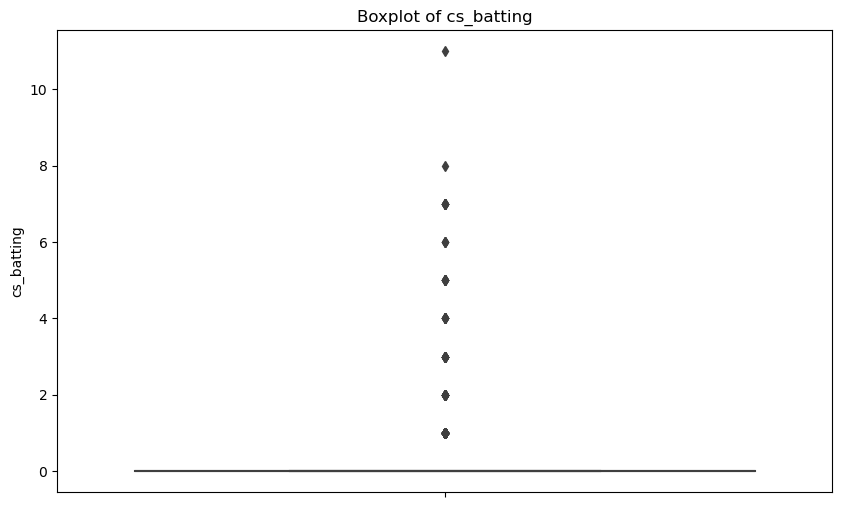

cs_batting - Upper Boundary: 0.0, Lower Boundary: 0.0
Number of outliers in cs_batting: 219
cs_batting - Number of unique values: 10
Outliers in cs_batting:
0      1.0
52     1.0
66     1.0
86     1.0
108    1.0
Name: cs_batting, dtype: float64



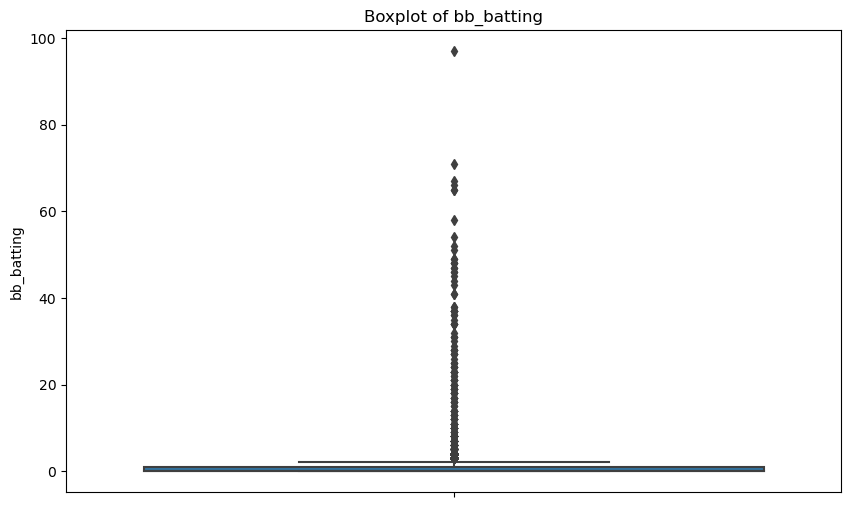

bb_batting - Upper Boundary: 2.5, Lower Boundary: -1.5
Number of outliers in bb_batting: 902
bb_batting - Number of unique values: 55
Outliers in bb_batting:
6     3.0
8     3.0
49    7.0
58    4.0
66    3.0
Name: bb_batting, dtype: float64



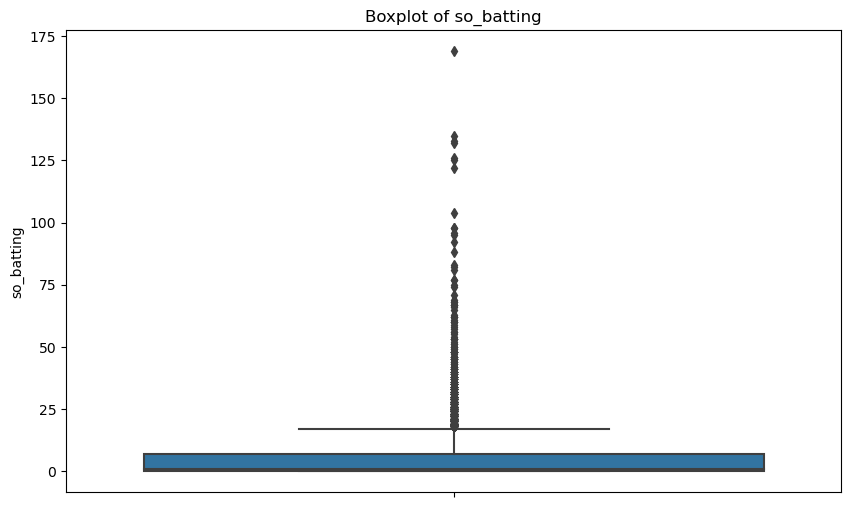

so_batting - Upper Boundary: 17.5, Lower Boundary: -10.5
Number of outliers in so_batting: 1249
so_batting - Number of unique values: 89
Outliers in so_batting:
1     22.0
6     18.0
49    25.0
50    18.0
58    29.0
Name: so_batting, dtype: float64



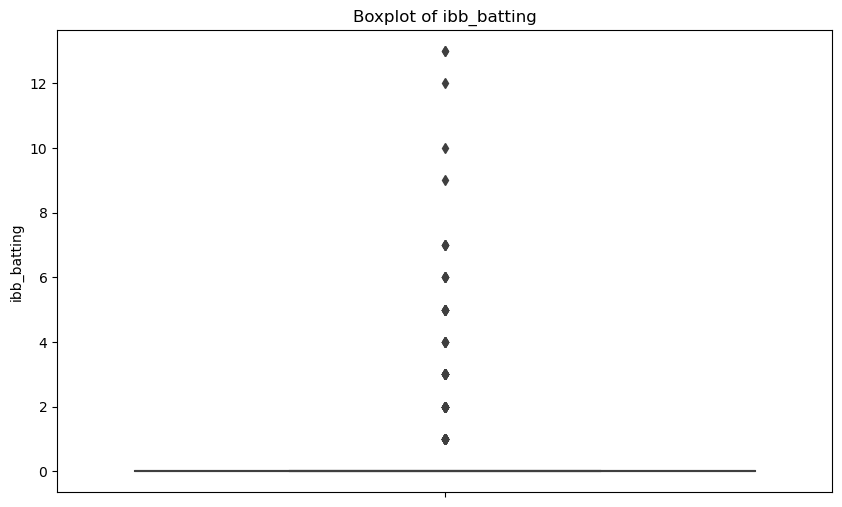

ibb_batting - Upper Boundary: 0.0, Lower Boundary: 0.0
Number of outliers in ibb_batting: 104
ibb_batting - Number of unique values: 12
Outliers in ibb_batting:
304    3.0
352    5.0
413    1.0
473    7.0
652    1.0
Name: ibb_batting, dtype: float64



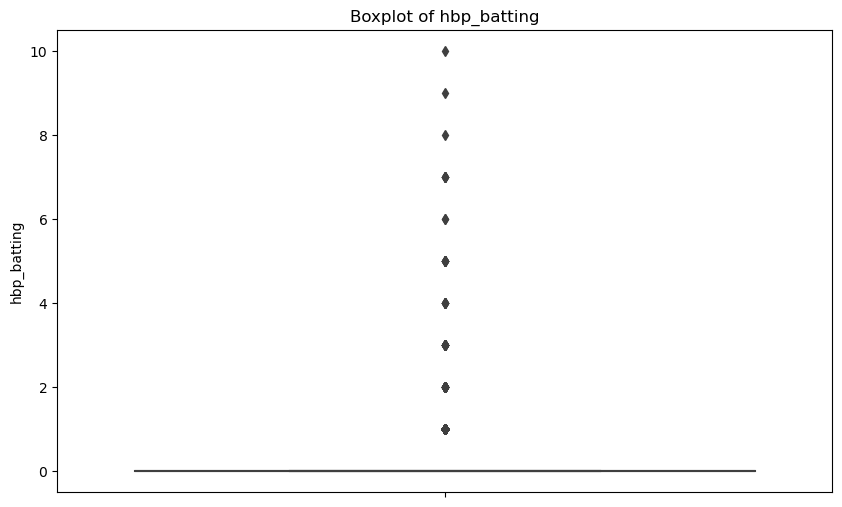

hbp_batting - Upper Boundary: 0.0, Lower Boundary: 0.0
Number of outliers in hbp_batting: 479
hbp_batting - Number of unique values: 11
Outliers in hbp_batting:
53     1.0
103    1.0
164    1.0
173    1.0
183    1.0
Name: hbp_batting, dtype: float64



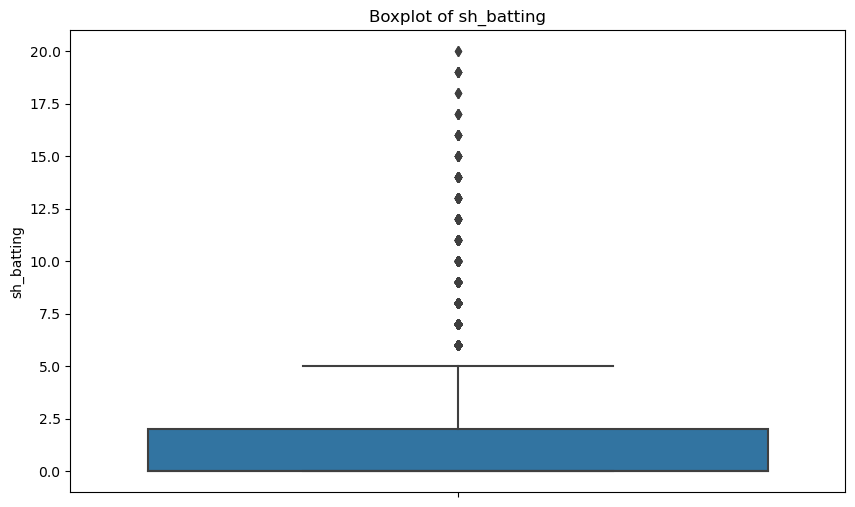

sh_batting - Upper Boundary: 5.0, Lower Boundary: -3.0
Number of outliers in sh_batting: 1181
sh_batting - Number of unique values: 21
Outliers in sh_batting:
1      6.0
6     11.0
52     6.0
53     6.0
57     9.0
Name: sh_batting, dtype: float64



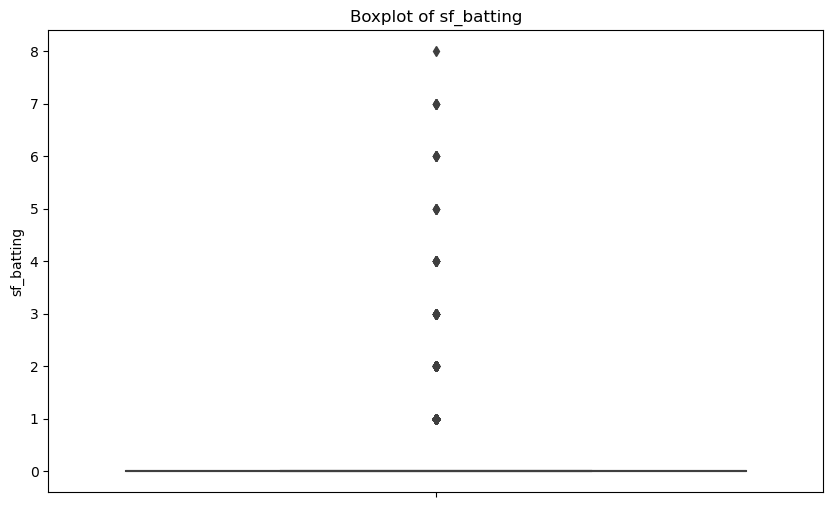

sf_batting - Upper Boundary: 0.0, Lower Boundary: 0.0
Number of outliers in sf_batting: 470
sf_batting - Number of unique values: 9
Outliers in sf_batting:
6     1.0
56    1.0
85    1.0
86    1.0
87    2.0
Name: sf_batting, dtype: float64



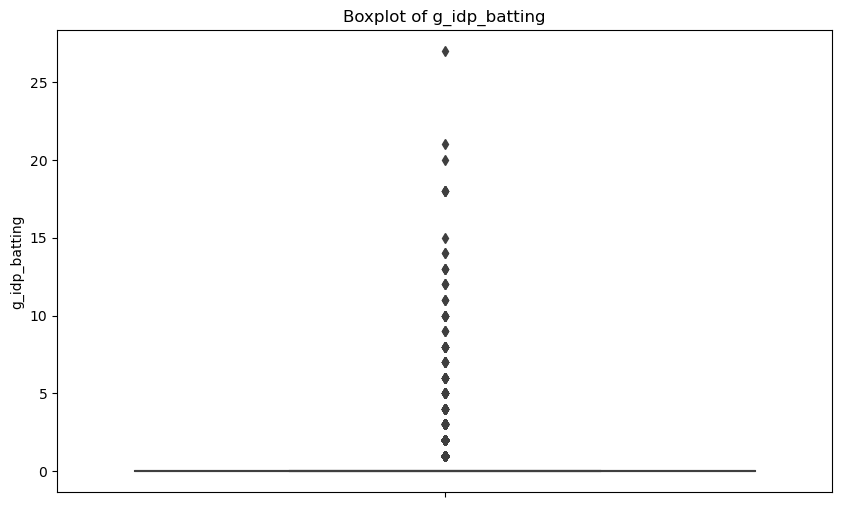

g_idp_batting - Upper Boundary: 0.0, Lower Boundary: 0.0
Number of outliers in g_idp_batting: 1372
g_idp_batting - Number of unique values: 20
Outliers in g_idp_batting:
6     2.0
7     1.0
50    1.0
52    1.0
55    1.0
Name: g_idp_batting, dtype: float64



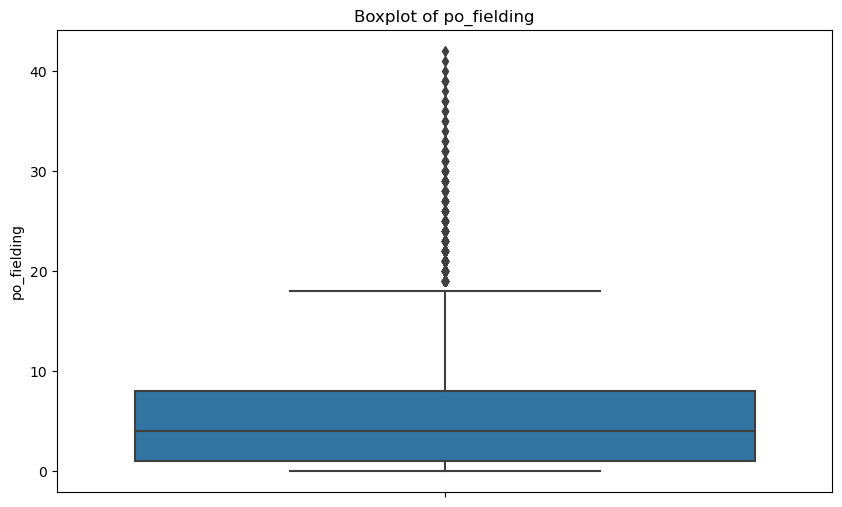

po_fielding - Upper Boundary: 18.5, Lower Boundary: -9.5
Number of outliers in po_fielding: 503
po_fielding - Number of unique values: 43
Outliers in po_fielding:
6     21.0
11    26.0
18    42.0
24    24.0
46    20.0
Name: po_fielding, dtype: float64



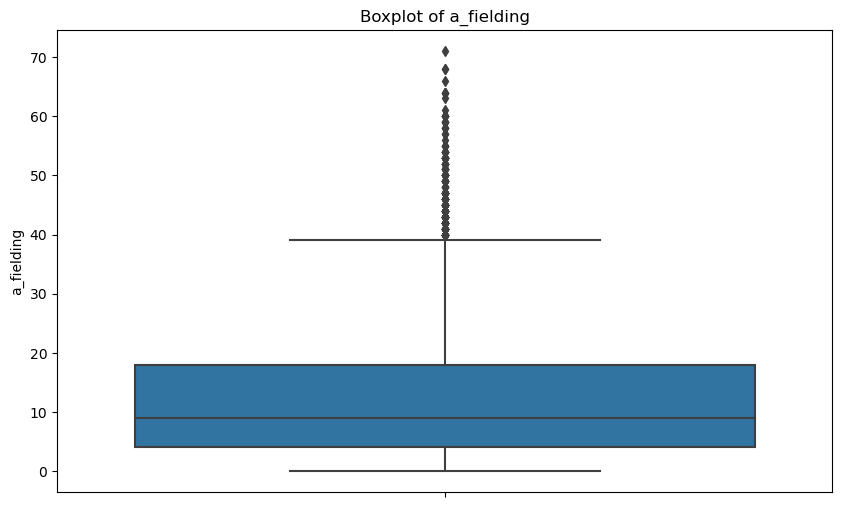

a_fielding - Upper Boundary: 39.0, Lower Boundary: -17.0
Number of outliers in a_fielding: 305
a_fielding - Number of unique values: 67
Outliers in a_fielding:
6     45.0
11    46.0
18    41.0
46    43.0
67    40.0
Name: a_fielding, dtype: float64



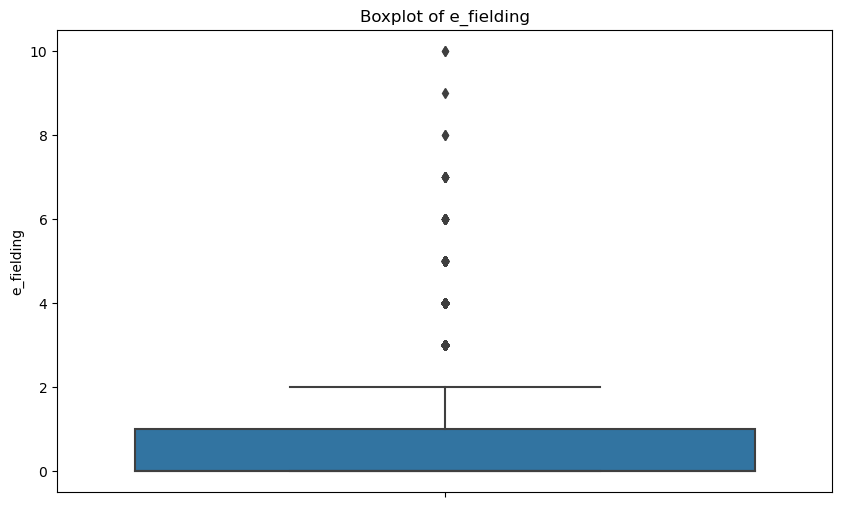

e_fielding - Upper Boundary: 2.5, Lower Boundary: -1.5
Number of outliers in e_fielding: 960
e_fielding - Number of unique values: 11
Outliers in e_fielding:
1     4.0
2     4.0
6     4.0
21    3.0
22    3.0
Name: e_fielding, dtype: float64



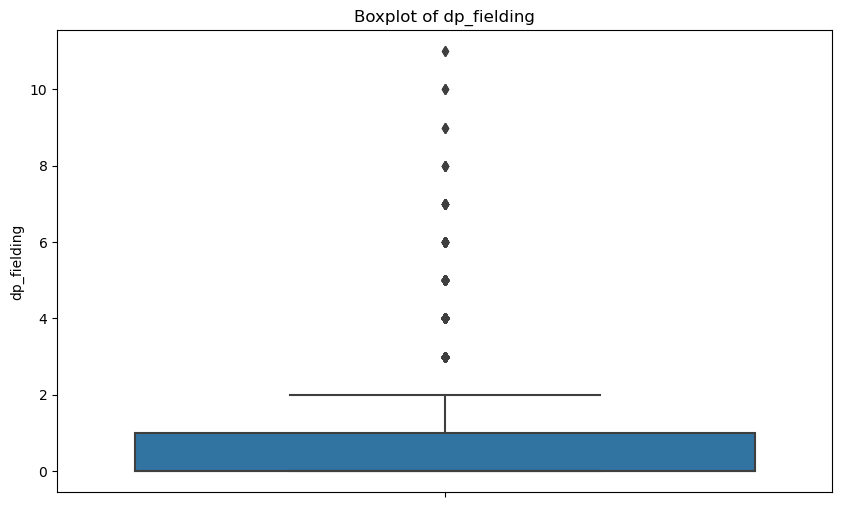

dp_fielding - Upper Boundary: 2.5, Lower Boundary: -1.5
Number of outliers in dp_fielding: 1195
dp_fielding - Number of unique values: 12
Outliers in dp_fielding:
1     3.0
2     3.0
3     4.0
6     9.0
11    6.0
Name: dp_fielding, dtype: float64



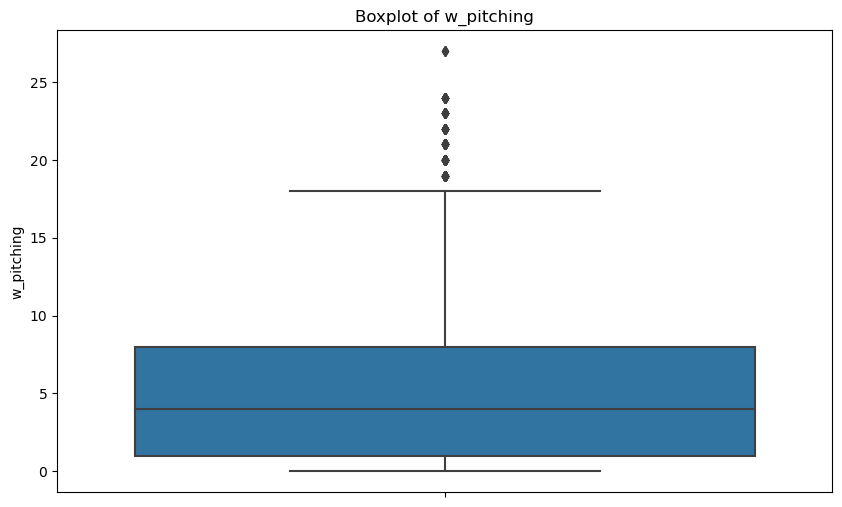

w_pitching - Upper Boundary: 18.5, Lower Boundary: -9.5
Number of outliers in w_pitching: 250
w_pitching - Number of unique values: 26
Outliers in w_pitching:
58     20
98     20
99     20
100    20
101    20
Name: w_pitching, dtype: int64



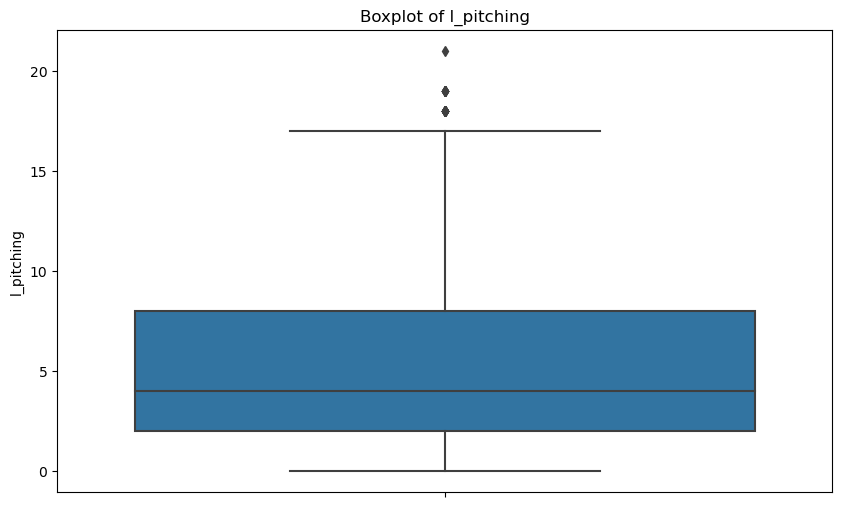

l_pitching - Upper Boundary: 17.0, Lower Boundary: -7.0
Number of outliers in l_pitching: 29
l_pitching - Number of unique values: 21
Outliers in l_pitching:
117    18
168    19
191    19
233    18
660    18
Name: l_pitching, dtype: int64



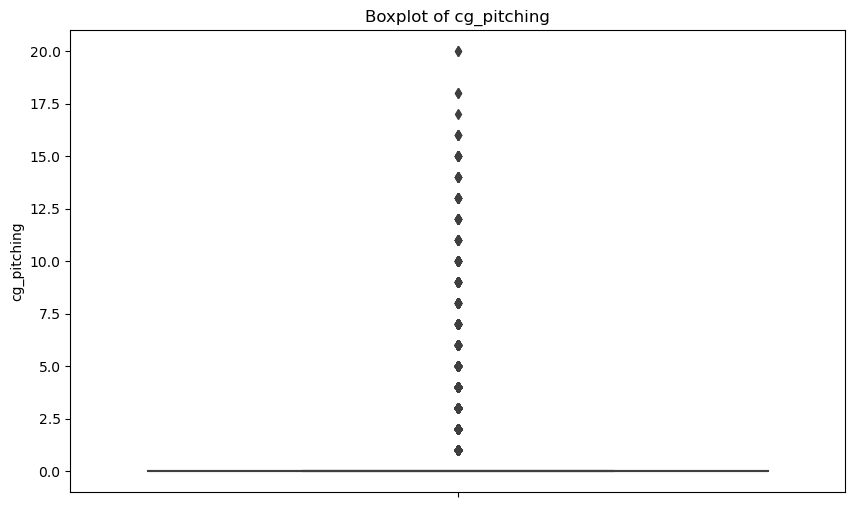

cg_pitching - Upper Boundary: 0.0, Lower Boundary: 0.0
Number of outliers in cg_pitching: 2926
cg_pitching - Number of unique values: 20
Outliers in cg_pitching:
6     6
11    9
12    8
13    1
14    3
Name: cg_pitching, dtype: int64



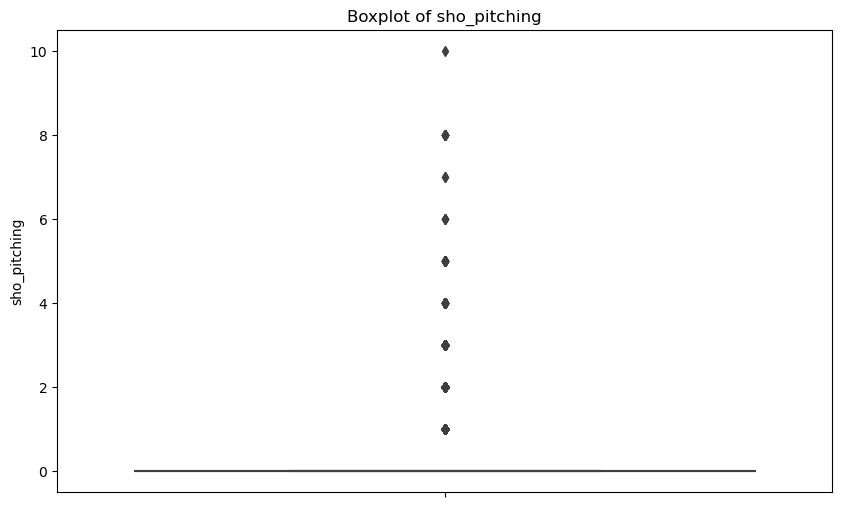

sho_pitching - Upper Boundary: 0.0, Lower Boundary: 0.0
Number of outliers in sho_pitching: 1745
sho_pitching - Number of unique values: 10
Outliers in sho_pitching:
6     1
11    2
12    1
14    1
16    1
Name: sho_pitching, dtype: int64



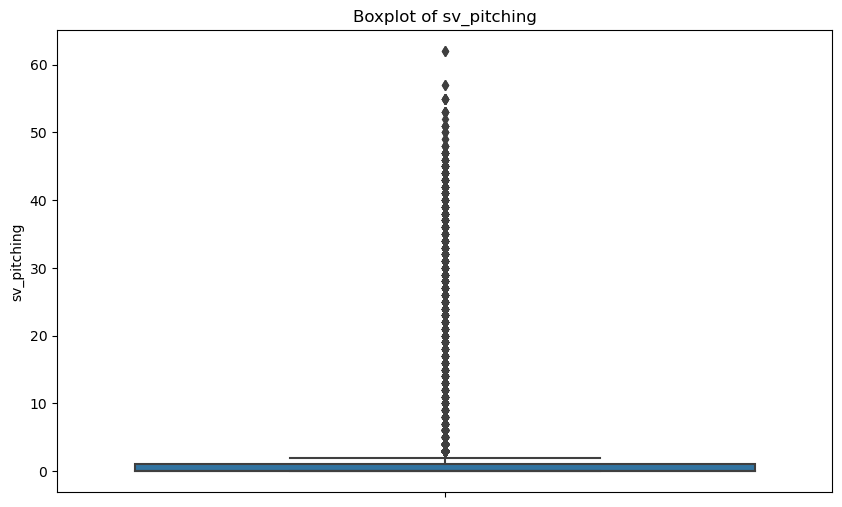

sv_pitching - Upper Boundary: 2.5, Lower Boundary: -1.5
Number of outliers in sv_pitching: 1878
sv_pitching - Number of unique values: 57
Outliers in sv_pitching:
2      3
9     23
15     4
17     9
19     3
Name: sv_pitching, dtype: int64



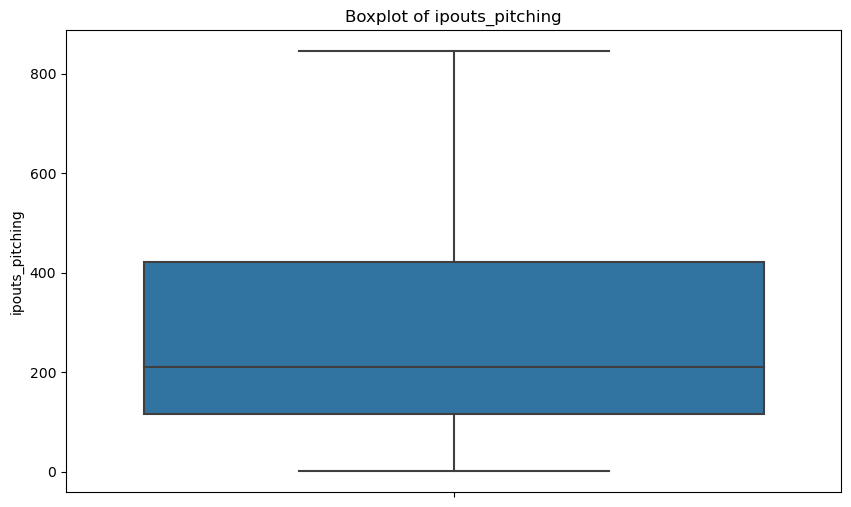

ipouts_pitching - Upper Boundary: 882.5, Lower Boundary: -345.5
Number of outliers in ipouts_pitching: 0
ipouts_pitching - Number of unique values: 799
Outliers in ipouts_pitching:
Series([], Name: ipouts_pitching, dtype: float64)



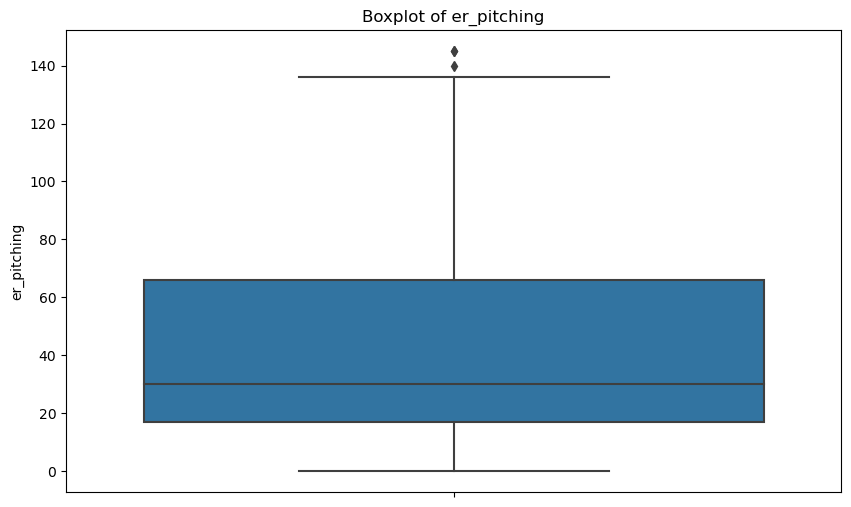

er_pitching - Upper Boundary: 139.5, Lower Boundary: -56.5
Number of outliers in er_pitching: 3
er_pitching - Number of unique values: 139
Outliers in er_pitching:
4960    145
5448    140
5947    145
Name: er_pitching, dtype: int64



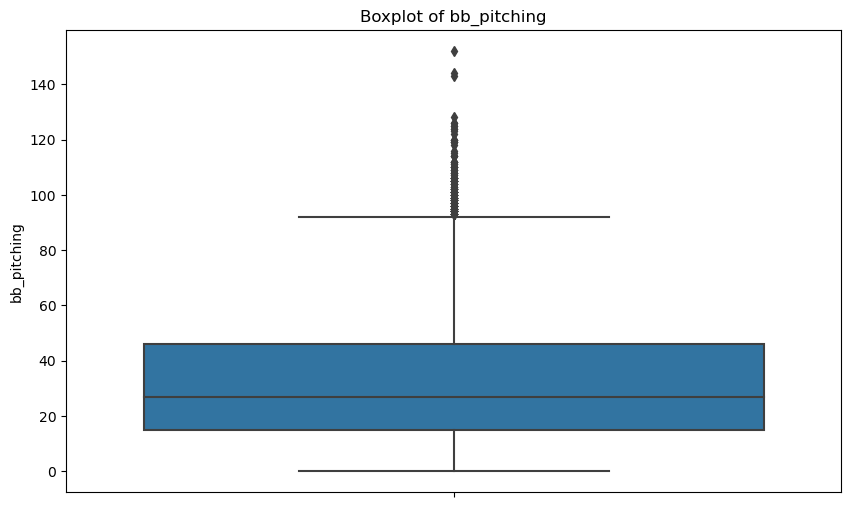

bb_pitching - Upper Boundary: 92.5, Lower Boundary: -31.5
Number of outliers in bb_pitching: 183
bb_pitching - Number of unique values: 128
Outliers in bb_pitching:
1     111
37     98
40    100
65    104
77    110
Name: bb_pitching, dtype: int64



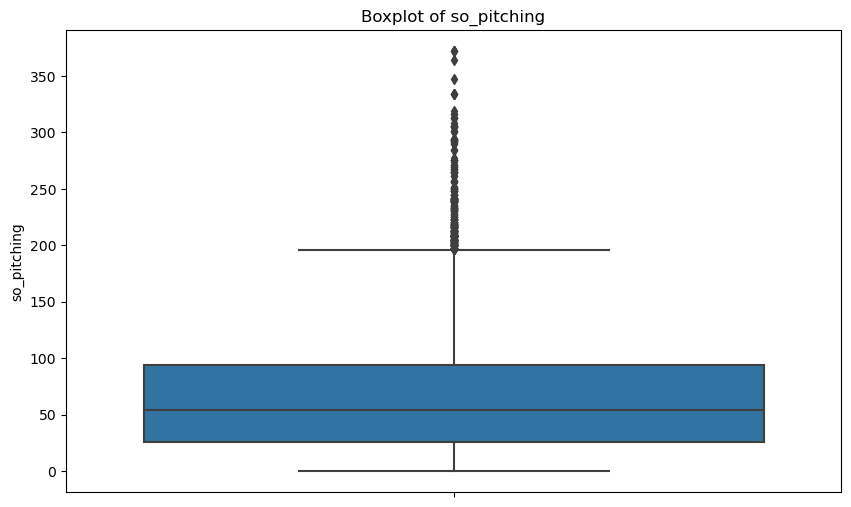

so_pitching - Upper Boundary: 196.0, Lower Boundary: -76.0
Number of outliers in so_pitching: 350
so_pitching - Number of unique values: 277
Outliers in so_pitching:
40     198
65     214
86     209
108    208
143    268
Name: so_pitching, dtype: int64



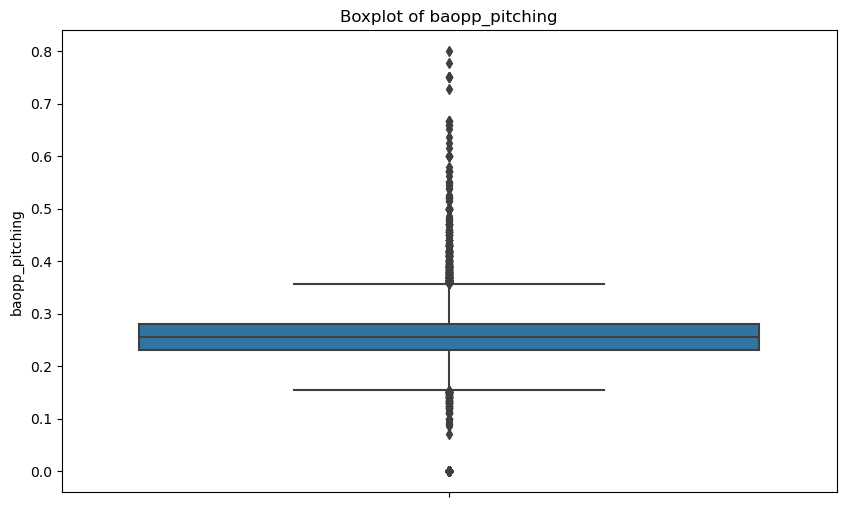

baopp_pitching - Upper Boundary: 0.35750000000000004, Lower Boundary: 0.15349999999999997
Number of outliers in baopp_pitching: 1064
baopp_pitching - Number of unique values: 342
Outliers in baopp_pitching:
95     0.14
136    0.38
175    0.46
248    0.36
304    0.00
Name: baopp_pitching, dtype: float64



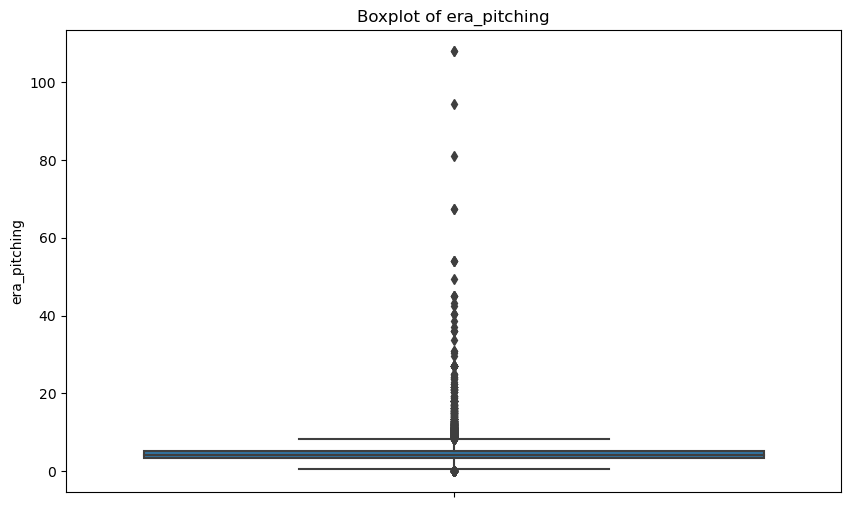

era_pitching - Upper Boundary: 8.283750000000001, Lower Boundary: 0.27374999999999927
Number of outliers in era_pitching: 810
era_pitching - Number of unique values: 937
Outliers in era_pitching:
95      0.00
106     8.31
136    10.29
175    16.20
258     9.00
Name: era_pitching, dtype: float64



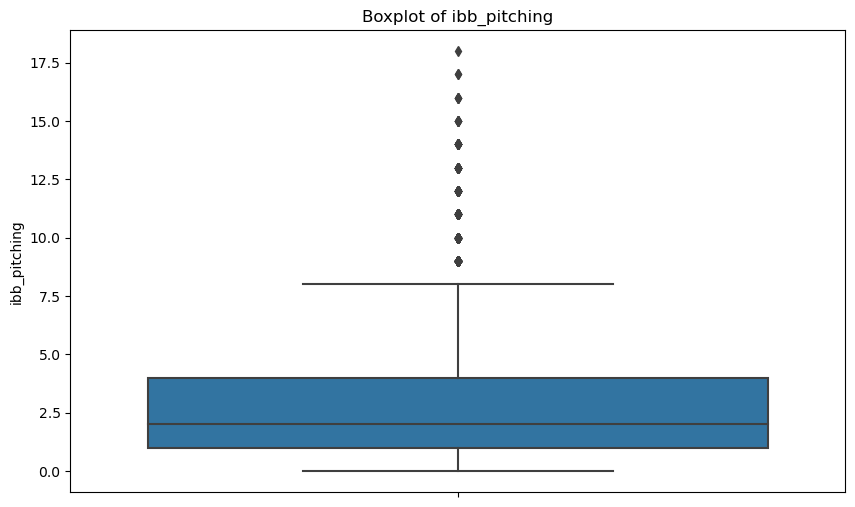

ibb_pitching - Upper Boundary: 8.5, Lower Boundary: -3.5
Number of outliers in ibb_pitching: 378
ibb_pitching - Number of unique values: 19
Outliers in ibb_pitching:
2     11.0
3     14.0
8     10.0
17    10.0
19    10.0
Name: ibb_pitching, dtype: float64



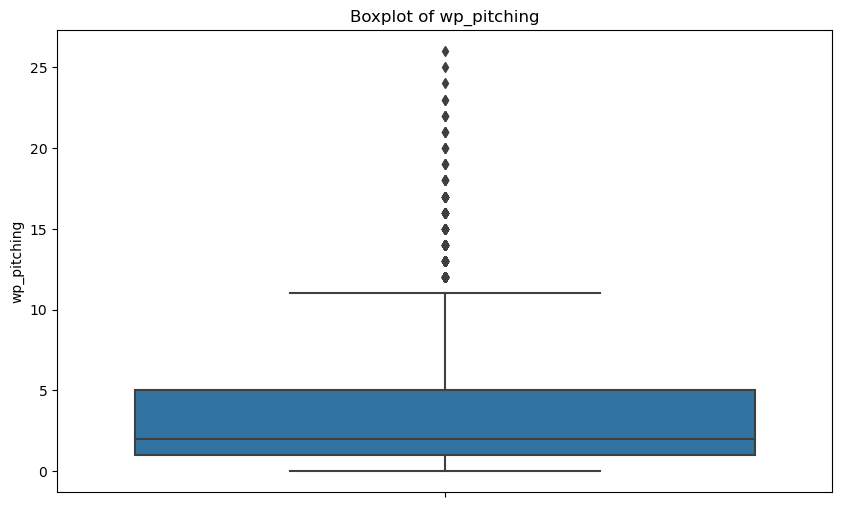

wp_pitching - Upper Boundary: 11.0, Lower Boundary: -5.0
Number of outliers in wp_pitching: 263
wp_pitching - Number of unique values: 27
Outliers in wp_pitching:
67    12.0
77    15.0
85    21.0
86    14.0
91    12.0
Name: wp_pitching, dtype: float64



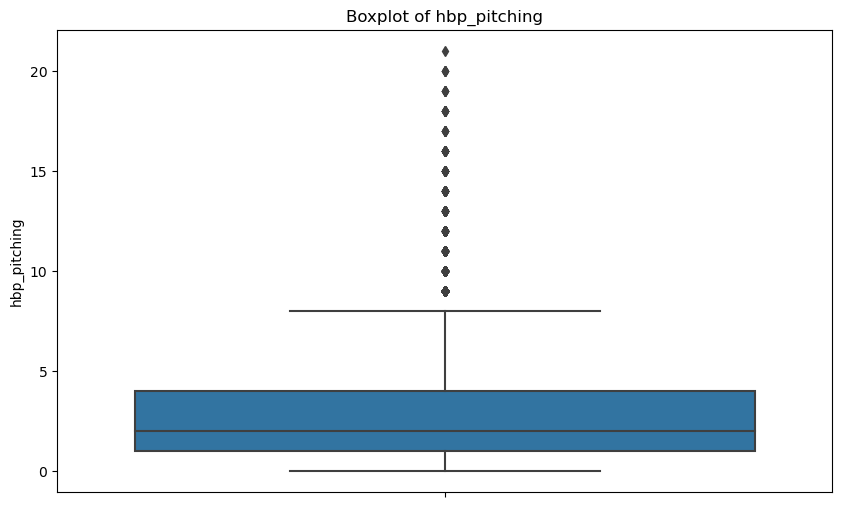

hbp_pitching - Upper Boundary: 8.5, Lower Boundary: -3.5
Number of outliers in hbp_pitching: 717
hbp_pitching - Number of unique values: 22
Outliers in hbp_pitching:
14      9.0
24      9.0
86      9.0
114    15.0
201    11.0
Name: hbp_pitching, dtype: float64



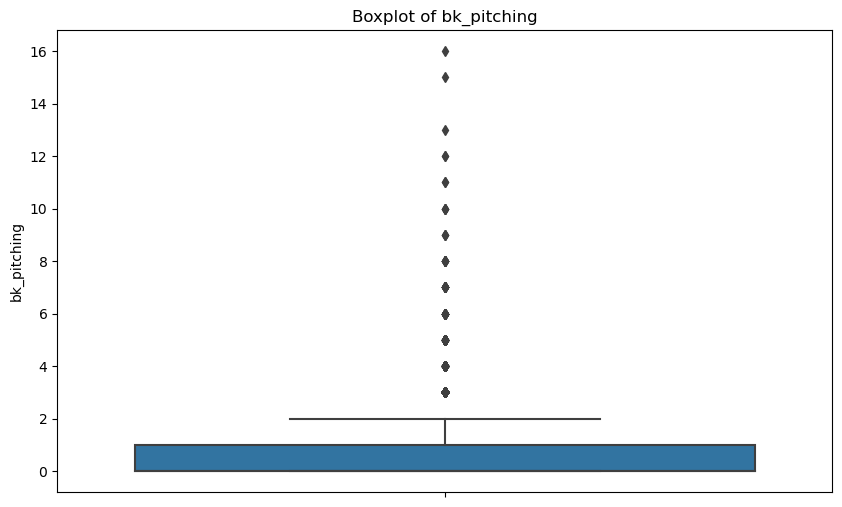

bk_pitching - Upper Boundary: 2.5, Lower Boundary: -1.5
Number of outliers in bk_pitching: 501
bk_pitching - Number of unique values: 16
Outliers in bk_pitching:
20    3
22    4
25    3
33    3
49    3
Name: bk_pitching, dtype: int64



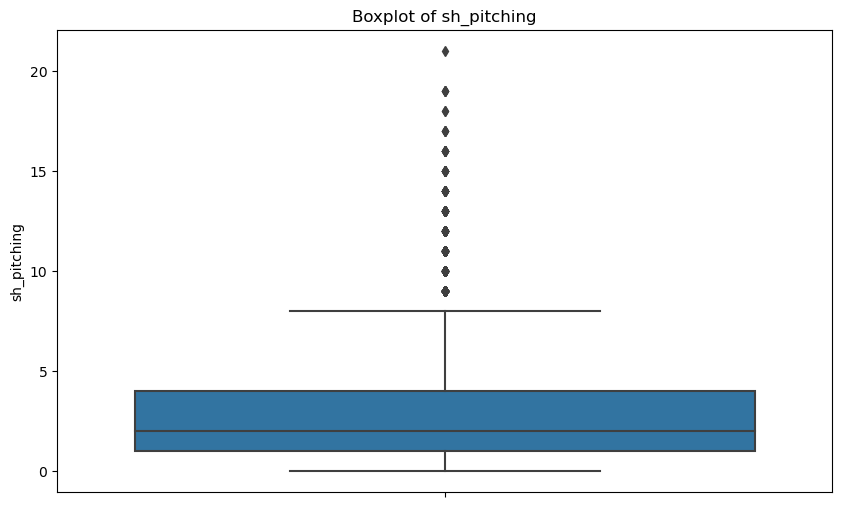

sh_pitching - Upper Boundary: 8.5, Lower Boundary: -3.5
Number of outliers in sh_pitching: 482
sh_pitching - Number of unique values: 21
Outliers in sh_pitching:
5801    14.0
5805    11.0
5811     9.0
5812     9.0
5819    10.0
Name: sh_pitching, dtype: float64



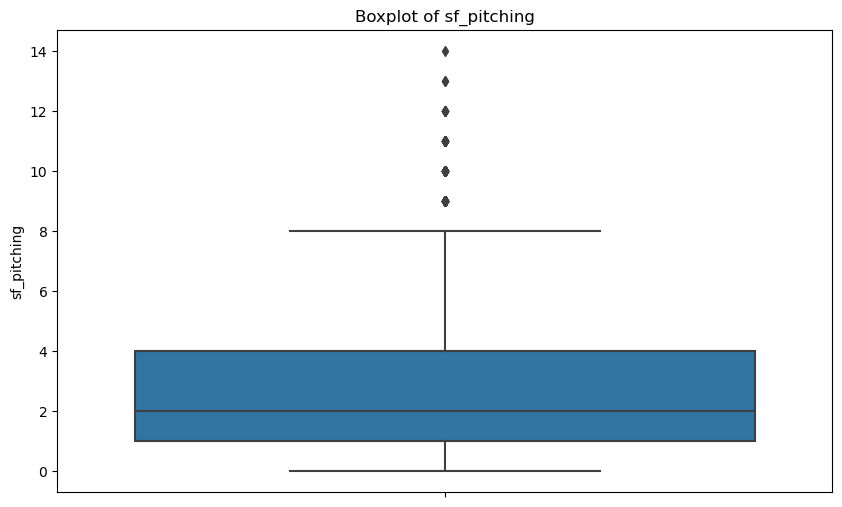

sf_pitching - Upper Boundary: 8.5, Lower Boundary: -3.5
Number of outliers in sf_pitching: 142
sf_pitching - Number of unique values: 15
Outliers in sf_pitching:
5936    12.0
5946    12.0
5947    12.0
6006     9.0
6060     9.0
Name: sf_pitching, dtype: float64



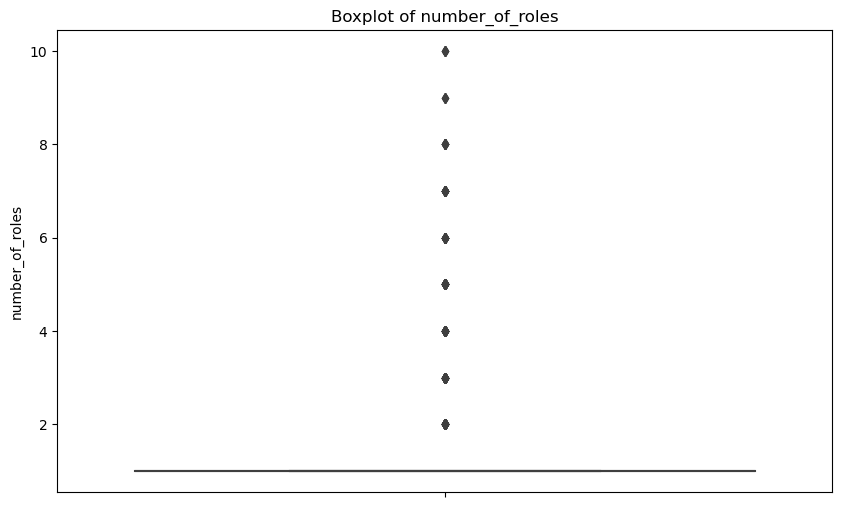

number_of_roles - Upper Boundary: 1.0, Lower Boundary: 1.0
Number of outliers in number_of_roles: 212
number_of_roles - Number of unique values: 10
Outliers in number_of_roles:
11     2
223    2
230    3
304    2
352    7
Name: number_of_roles, dtype: int64



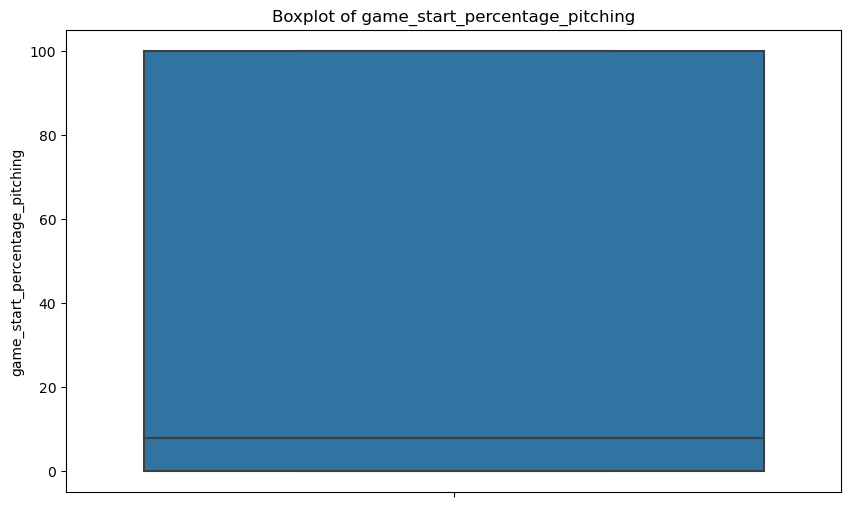

game_start_percentage_pitching - Upper Boundary: 250.0, Lower Boundary: -150.0
Number of outliers in game_start_percentage_pitching: 0
game_start_percentage_pitching - Number of unique values: 613
Outliers in game_start_percentage_pitching:
Series([], Name: game_start_percentage_pitching, dtype: float64)

{'column': 'year', 'num_outliers': 0, 'unique_values': 31}
{'column': 'g_batting', 'num_outliers': 79, 'unique_values': 137}
{'column': 'r_batting', 'num_outliers': 1340, 'unique_values': 64}
{'column': 'h_batting', 'num_outliers': 1562, 'unique_values': 103}
{'column': 'hr_batting', 'num_outliers': 625, 'unique_values': 23}
{'column': 'rbi_batting', 'num_outliers': 1290, 'unique_values': 60}
{'column': 'sb_batting', 'num_outliers': 259, 'unique_values': 21}
{'column': 'cs_batting', 'num_outliers': 219, 'unique_values': 10}
{'column': 'bb_batting', 'num_outliers': 902, 'unique_values': 55}
{'column': 'so_batting', 'num_outliers': 1249, 'unique_values': 89}
{'column': 'ibb_batting', 'n

In [204]:
numeric_columns = merged_data.select_dtypes(include=[np.number]).columns
outliers_info_list = []
cols_with_outliers = []

# loop through each numeric column except 'salary'
for column in numeric_columns:
    if column == 'salary':
        continue  
    
    # plot boxplot
    plt.figure(figsize=(10, 6))
    sns.boxplot(y=merged_data[column])
    plt.title(f'Boxplot of {column}')
    plt.ylabel(column)
    plt.show()
    
    # calculate boundaries
    upper_boundary, lower_boundary = find_boundaries(merged_data, column)
    print(f'{column} - Upper Boundary: {upper_boundary}, Lower Boundary: {lower_boundary}')
    
    # detect outliers
    outliers = np.where(merged_data[column] > upper_boundary, True,
                        np.where(merged_data[column] < lower_boundary, True, False))
    
    # print number of outliers
    num_outliers = outliers.sum()
    print(f'Number of outliers in {column}: {num_outliers}')
    
    unique_values = merged_data[column].nunique()
    print(f'{column} - Number of unique values: {unique_values}')    
    
    # print outlier values
    outliers_df = merged_data.loc[outliers, column]
    print(f'Outliers in {column}:')
    print(outliers_df.head())
    print()
    
    # store information in dictionary
    column_info = {
        'column': column,
        'num_outliers': num_outliers,
        'unique_values': unique_values
    }
    outliers_info_list.append(column_info)
    
    # add column name to cols_with_outliers list if it has outliers
    if num_outliers > 0:
        cols_with_outliers.append(column)

# display the list of dictionaries
for info in outliers_info_list:
    print(info)

In [205]:
# create a list storing dictionaries of each column with number of outliers and number of unique values in ascending order
outliers_info_list_sorted_uniquevalues = sorted(outliers_info_list, key=lambda x: x['unique_values'])
for info in outliers_info_list_sorted_uniquevalues:
    print(info)

{'column': 'sf_batting', 'num_outliers': 470, 'unique_values': 9}
{'column': 'cs_batting', 'num_outliers': 219, 'unique_values': 10}
{'column': 'sho_pitching', 'num_outliers': 1745, 'unique_values': 10}
{'column': 'number_of_roles', 'num_outliers': 212, 'unique_values': 10}
{'column': 'hbp_batting', 'num_outliers': 479, 'unique_values': 11}
{'column': 'e_fielding', 'num_outliers': 960, 'unique_values': 11}
{'column': 'ibb_batting', 'num_outliers': 104, 'unique_values': 12}
{'column': 'dp_fielding', 'num_outliers': 1195, 'unique_values': 12}
{'column': 'sf_pitching', 'num_outliers': 142, 'unique_values': 15}
{'column': 'bk_pitching', 'num_outliers': 501, 'unique_values': 16}
{'column': 'ibb_pitching', 'num_outliers': 378, 'unique_values': 19}
{'column': 'g_idp_batting', 'num_outliers': 1372, 'unique_values': 20}
{'column': 'cg_pitching', 'num_outliers': 2926, 'unique_values': 20}
{'column': 'sb_batting', 'num_outliers': 259, 'unique_values': 21}
{'column': 'sh_batting', 'num_outliers': 

In [206]:
# create a list storing dictionaries of each column with number of unique values and number of outliers in ascending order
outliers_info_list_sorted_numoutliers = sorted(outliers_info_list, key=lambda x: x['num_outliers'])
for info in outliers_info_list_sorted_numoutliers:
    print(info)

{'column': 'year', 'num_outliers': 0, 'unique_values': 31}
{'column': 'ipouts_pitching', 'num_outliers': 0, 'unique_values': 799}
{'column': 'game_start_percentage_pitching', 'num_outliers': 0, 'unique_values': 613}
{'column': 'er_pitching', 'num_outliers': 3, 'unique_values': 139}
{'column': 'l_pitching', 'num_outliers': 29, 'unique_values': 21}
{'column': 'g_batting', 'num_outliers': 79, 'unique_values': 137}
{'column': 'ibb_batting', 'num_outliers': 104, 'unique_values': 12}
{'column': 'sf_pitching', 'num_outliers': 142, 'unique_values': 15}
{'column': 'bb_pitching', 'num_outliers': 183, 'unique_values': 128}
{'column': 'number_of_roles', 'num_outliers': 212, 'unique_values': 10}
{'column': 'cs_batting', 'num_outliers': 219, 'unique_values': 10}
{'column': 'w_pitching', 'num_outliers': 250, 'unique_values': 26}
{'column': 'sb_batting', 'num_outliers': 259, 'unique_values': 21}
{'column': 'wp_pitching', 'num_outliers': 263, 'unique_values': 27}
{'column': 'a_fielding', 'num_outliers'

In [207]:
print(cols_with_outliers)
print(len(cols_with_outliers))

['g_batting', 'r_batting', 'h_batting', 'hr_batting', 'rbi_batting', 'sb_batting', 'cs_batting', 'bb_batting', 'so_batting', 'ibb_batting', 'hbp_batting', 'sh_batting', 'sf_batting', 'g_idp_batting', 'po_fielding', 'a_fielding', 'e_fielding', 'dp_fielding', 'w_pitching', 'l_pitching', 'cg_pitching', 'sho_pitching', 'sv_pitching', 'er_pitching', 'bb_pitching', 'so_pitching', 'baopp_pitching', 'era_pitching', 'ibb_pitching', 'wp_pitching', 'hbp_pitching', 'bk_pitching', 'sh_pitching', 'sf_pitching', 'number_of_roles']
35


### Further Exploration of Target Variable: salary

In [208]:
#missing points due to years not present in subset
def find_and_plot_peaks(x, state):

    # find local maxima
    peaks, _ = find_peaks(x)
    valleys, _ = find_peaks(1/x)
    
    means = []
    
    # plot the peaks
    plt.figure(figsize=(10, 3))
    plt.plot(x.index, x.values)
    plt.plot(x.index[peaks], x.values[peaks], "o", color = 'green')
    plt.plot(x.index[valleys], x.values[valleys], "o", color = 'red')
    plt.title(state)
    
#     for a, b in zip(x.index[peaks], x.index[valleys]):
#         means.append(abs(a-b))
#         print(a,b)
    lst = np.sort(np.concatenate((peaks, valleys)))
    for i in range(0, len(lst)-1):
        means.append(abs(x.index[lst[i]] - x.index[lst[i+1]]))
    plt.show()
    return state, np.mean(means)

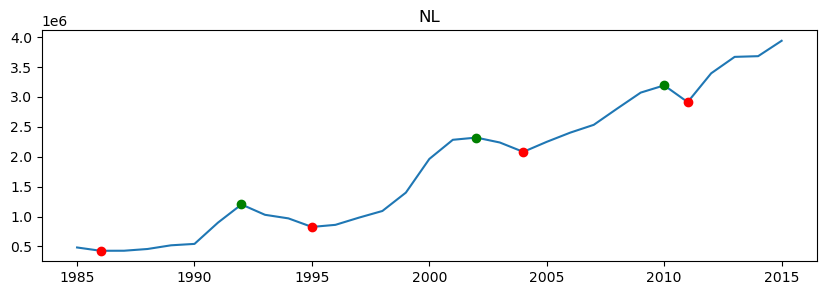

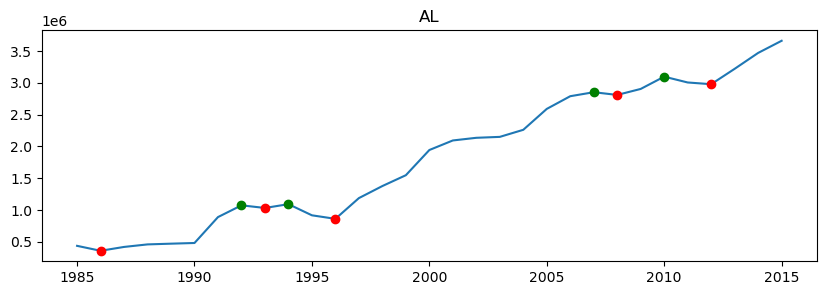

In [209]:
# plot time series for league_id
league_mean_dict = {}
for league in merged_data['league_id'].unique():
    
    tmp = merged_data[merged_data['league_id']==league].groupby('year')['salary'].mean()
    
    s, m = find_and_plot_peaks(tmp, league)
    league_mean_dict[s] = m

In [210]:
league_mean_dict

{'NL': 4.166666666666667, 'AL': 3.25}

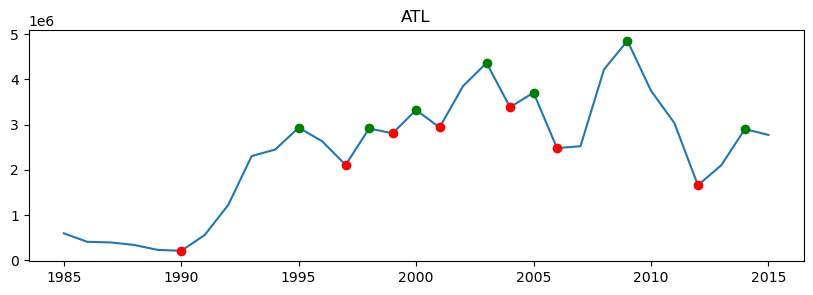

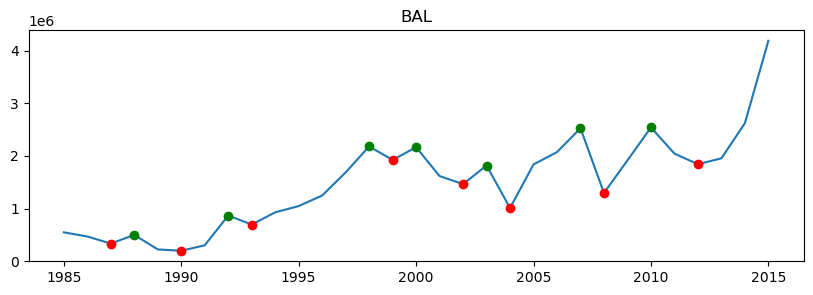

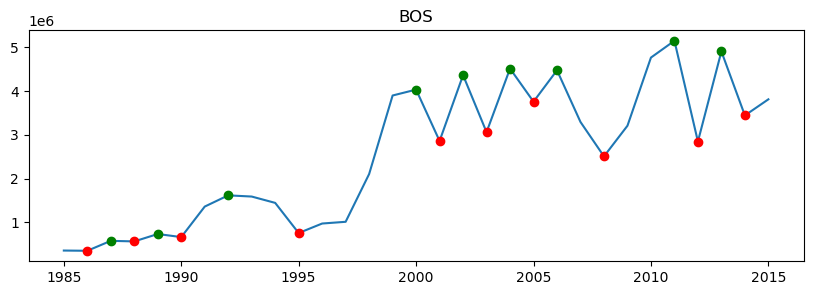

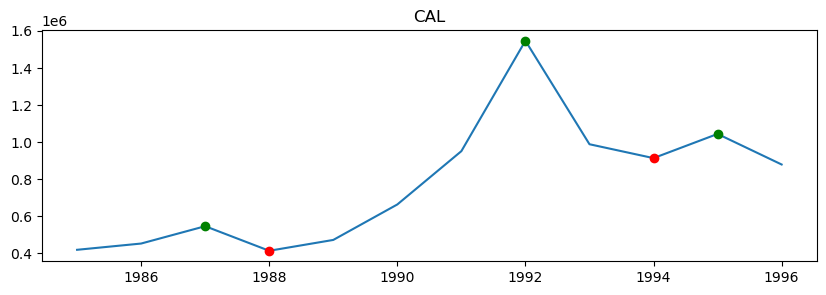

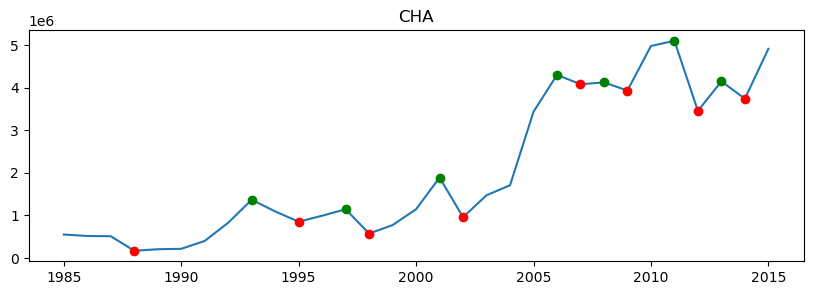

...

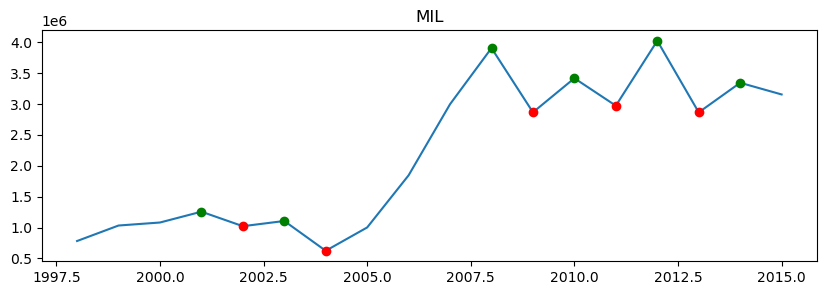

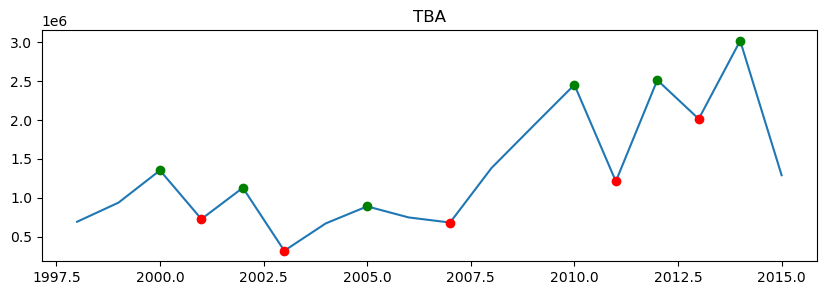

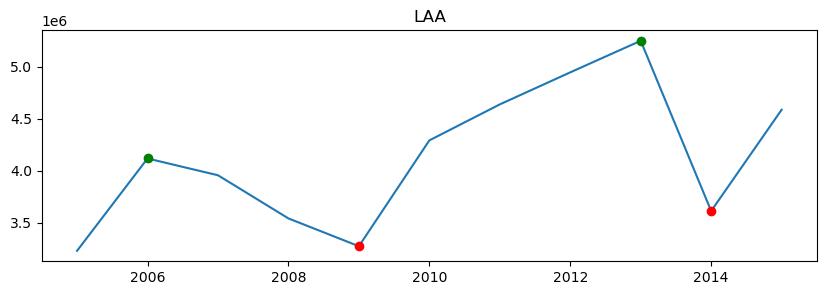

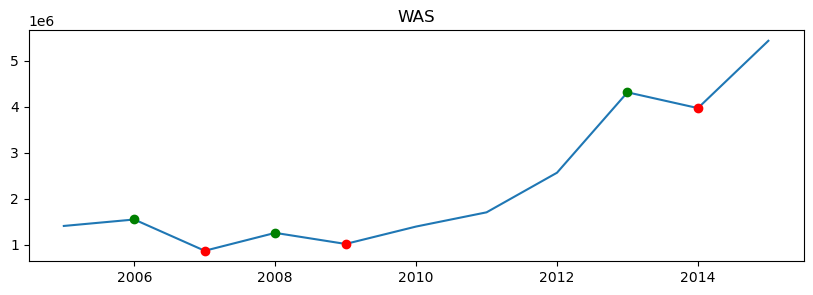

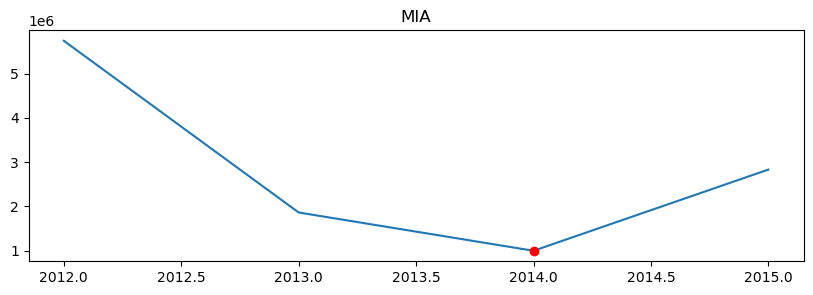

c:\Users\user\anaconda3\Lib\site-packages\numpy\core\fromnumeric.py:3464: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
c:\Users\user\anaconda3\Lib\site-packages\numpy\core\_methods.py:192: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


In [211]:
# plot time series for team_id
team_mean_dict = {}
for team in merged_data['team_id'].unique():
    
    tmp = merged_data[merged_data['team_id']==team].groupby('year')['salary'].mean()
    
    s, m = find_and_plot_peaks(tmp, team)
    team_mean_dict[s] = m

In [212]:
team_mean_dict

{'ATL': 1.8461538461538463,
 'BAL': 1.7857142857142858,
 'BOS': 1.5555555555555556,
 'CAL': 2.0,
 'CHA': 1.8571428571428572,
 'CHN': 1.8666666666666667,
 'CIN': 2.375,
 'CLE': 2.8,
 'DET': 2.6,
 'HOU': 1.6470588235294117,
 'KCA': 1.7692307692307692,
 'LAN': 1.6470588235294117,
 'MIN': 1.9230769230769231,
 'ML4': 2.0,
 'MON': 1.5454545454545454,
 'NYA': 2.076923076923077,
 'NYN': 1.6153846153846154,
 'OAK': 2.25,
 'PHI': 2.076923076923077,
 'PIT': 1.8666666666666667,
 'SDN': 1.5625,
 'SEA': 1.7857142857142858,
 'SFN': 1.5,
 'SLN': 1.9285714285714286,
 'TEX': 2.3636363636363638,
 'TOR': 1.6470588235294117,
 'COL': 1.8,
 'FLO': 1.75,
 'ANA': 2.0,
 'ARI': 3.0,
 'MIL': 1.3,
 'TBA': 1.4,
 'LAA': 2.6666666666666665,
 'WAS': 1.6,
 'MIA': nan}

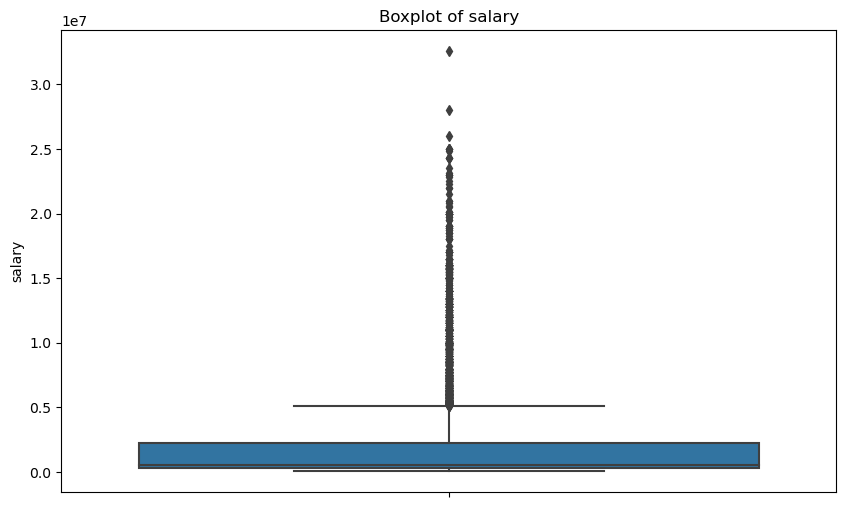

salary - Upper Boundary: 5087500.0, Lower Boundary: -2612500.0
number of outliers: 1184


2507    5166667
2637    5875000
2638    5875000
2639    5875000
2640    5875000
Name: salary, dtype: int64

In [213]:
# plot boxplot for taregt variable salary
plt.figure(figsize=(10, 6))
sns.boxplot(y=merged_data['salary'])
plt.title('Boxplot of salary')
plt.ylabel('salary')
plt.show()
upper_boundary, lower_boundary = find_boundaries(merged_data, 'salary')
print(f'salary - Upper Boundary: {upper_boundary}, Lower Boundary: {lower_boundary}')
outliers = np.where(merged_data['salary'] > upper_boundary, True,
                    np.where(merged_data['salary'] < lower_boundary, True, False))

print(f"number of outliers: {outliers.sum()}")
outliers_df = merged_data.loc[outliers, 'salary']
outliers_df.head()

In [214]:
cols_with_outliers.append('salary')
print(len(cols_with_outliers))

36


In [215]:
cols_with_outliers

['g_batting',
 'r_batting',
 'h_batting',
 'hr_batting',
 'rbi_batting',
 'sb_batting',
 'cs_batting',
 'bb_batting',
 'so_batting',
 'ibb_batting',
 'hbp_batting',
 'sh_batting',
 'sf_batting',
 'g_idp_batting',
 'po_fielding',
 'a_fielding',
 'e_fielding',
 'dp_fielding',
 'w_pitching',
 'l_pitching',
 'cg_pitching',
 'sho_pitching',
 'sv_pitching',
 'er_pitching',
 'bb_pitching',
 'so_pitching',
 'baopp_pitching',
 'era_pitching',
 'ibb_pitching',
 'wp_pitching',
 'hbp_pitching',
 'bk_pitching',
 'sh_pitching',
 'sf_pitching',
 'number_of_roles',
 'salary']

In [216]:
outlier_cols = merged_data[cols_with_outliers]
outlier_cols.head()

,g_batting,r_batting,h_batting,hr_batting,rbi_batting,sb_batting,cs_batting,bb_batting,so_batting,ibb_batting,hbp_batting,sh_batting,sf_batting,g_idp_batting,po_fielding,a_fielding,e_fielding,dp_fielding,w_pitching,l_pitching,cg_pitching,sho_pitching,sv_pitching,er_pitching,bb_pitching,so_pitching,baopp_pitching,era_pitching,ibb_pitching,wp_pitching,hbp_pitching,bk_pitching,sh_pitching,sf_pitching,number_of_roles,salary
0,20.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,7.0,0.0,0.0,0.0,0.0,0.0,2.0,9.0,1.0,0.0,2,9,0,0,0,52,37,47,0.28,6.35,1.0,3.0,1.0,0,NaN,NaN,1,870000
1,37.0,3.0,5.0,0.0,1.0,0.0,0.0,1.0,22.0,0.0,0.0,6.0,0.0,0.0,13.0,23.0,4.0,3.0,7,15,0,0,0,88,111,134,0.25,3.83,6.0,6.0,5.0,0,NaN,NaN,1,550000
2,66.0,1.0,3.0,1.0,2.0,0.0,0.0,1.0,5.0,0.0,0.0,1.0,0.0,0.0,7.0,13.0,4.0,3.0,4,6,0,0,3,56,61,49,0.26,3.95,11.0,4.0,5.0,0,NaN,NaN,1,633333
3,60.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,3.0,0.0,0.0,1.0,0.0,0.0,9.0,27.0,2.0,4.0,6,3,0,0,0,39,49,41,0.26,4.08,14.0,2.0,1.0,1,NaN,NaN,1,150000
4,46.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,2.0,7.0,1.0,0.0,2,3,0,0,1,15,28,37,0.22,2.28,4.0,1.0,0.0,0,NaN,NaN,1,483333


In [217]:
outlier_cols.isnull().sum()

g_batting             0
r_batting          1910
h_batting          1910
hr_batting         1910
rbi_batting        1910
sb_batting         1910
cs_batting         1910
bb_batting         1910
so_batting         1910
ibb_batting        1910
hbp_batting        1910
sh_batting         1910
sf_batting         1910
g_idp_batting      1910
po_fielding           0
a_fielding            0
e_fielding            0
dp_fielding           0
w_pitching            0
l_pitching            0
cg_pitching           0
sho_pitching          0
sv_pitching           0
er_pitching           0
bb_pitching           0
so_pitching           0
baopp_pitching      475
era_pitching          0
ibb_pitching          0
wp_pitching           0
hbp_pitching          0
bk_pitching           0
sh_pitching        5434
sf_pitching        5434
number_of_roles       0
salary                0
dtype: int64

In [218]:
def diagnostic_plots(df, variable):
    # function takes a dataframe (df) and
    # the variable of interest as arguments

    # define figure size
    plt.figure(figsize=(16, 4))

    # histogram
    plt.subplot(1, 3, 1)
    sns.histplot(df[variable], bins=30, kde=True)  
    plt.title('Histogram')

    # Q-Q plot
    plt.subplot(1, 3, 2)
    stats.probplot(df[variable], dist="norm", plot=plt)
    plt.ylabel('popularity quantiles')

    # boxplot
    plt.subplot(1, 3, 3)
    sns.boxplot(y=df[variable])
    plt.title('Boxplot')

    plt.show()

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


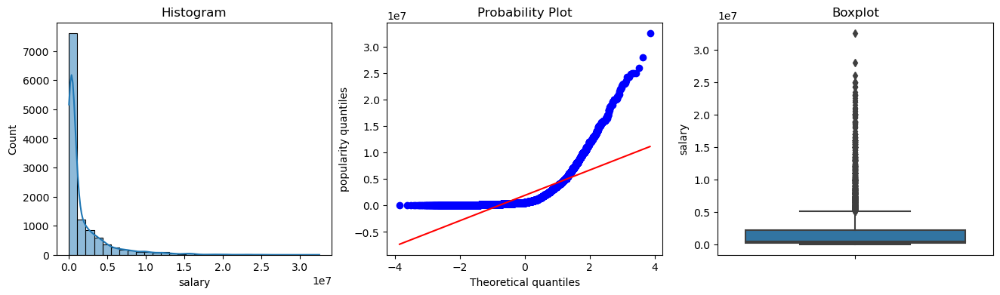

In [219]:
# print distribution for target variable salary before capping
diagnostic_plots(merged_data, 'salary')

In [220]:
windsorizer = Winsorizer(capping_method ='quantiles', 
                        tail='right', # cap left, right or both tails
                        fold =0.05,
                        variables=['salary'])

windsorizer.fit(merged_data)

Winsorizer(capping_method='quantiles', fold=0.05, variables=['salary'])

In [221]:
merged_data = windsorizer.transform(merged_data)

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


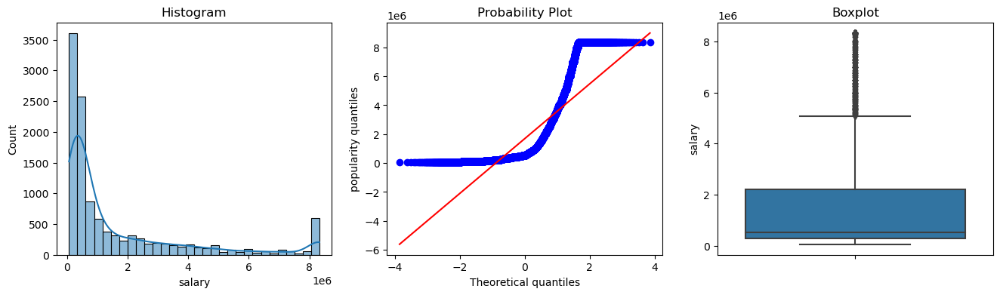

In [222]:
# print distribution for target variable salary after capping
diagnostic_plots(merged_data, 'salary')

### Train and Test Split

In [223]:
X_train, X_test, y_train, y_test = train_test_split(
    merged_data.drop('salary',axis=1), merged_data['salary'], test_size=0.3, random_state=420)

X_train.shape, X_test.shape

((8206, 42), (3518, 42))

In [224]:
y_train.shape, y_test.shape

((8206,), (3518,))

### Missing Value Imputation

In [225]:
outlier_cols.isnull().sum()

g_batting             0
r_batting          1910
h_batting          1910
hr_batting         1910
rbi_batting        1910
sb_batting         1910
cs_batting         1910
bb_batting         1910
so_batting         1910
ibb_batting        1910
hbp_batting        1910
sh_batting         1910
sf_batting         1910
g_idp_batting      1910
po_fielding           0
a_fielding            0
e_fielding            0
dp_fielding           0
w_pitching            0
l_pitching            0
cg_pitching           0
sho_pitching          0
sv_pitching           0
er_pitching           0
bb_pitching           0
so_pitching           0
baopp_pitching      475
era_pitching          0
ibb_pitching          0
wp_pitching           0
hbp_pitching          0
bk_pitching           0
sh_pitching        5434
sf_pitching        5434
number_of_roles       0
salary                0
dtype: int64

In [226]:
cat_cols = [c for c in merged_data.columns if merged_data[c].dtypes=='O']
print(merged_data[cat_cols].isnull().mean().sort_values())

team_id      0.000000
league_id    0.000000
award_id     0.958802
dtype: float64


year                              0.000000
salary                            0.000000
g_batting                         0.000000
r_batting                         0.162914
h_batting                         0.162914
hr_batting                        0.162914
rbi_batting                       0.162914
sb_batting                        0.162914
cs_batting                        0.162914
bb_batting                        0.162914
so_batting                        0.162914
ibb_batting                       0.162914
hbp_batting                       0.162914
sh_batting                        0.162914
sf_batting                        0.162914
g_idp_batting                     0.162914
po_fielding                       0.000000
a_fielding                        0.000000
e_fielding                        0.000000
dp_fielding                       0.000000
w_pitching                        0.000000
l_pitching                        0.000000
cg_pitching                       0.000000
sho_pitchin

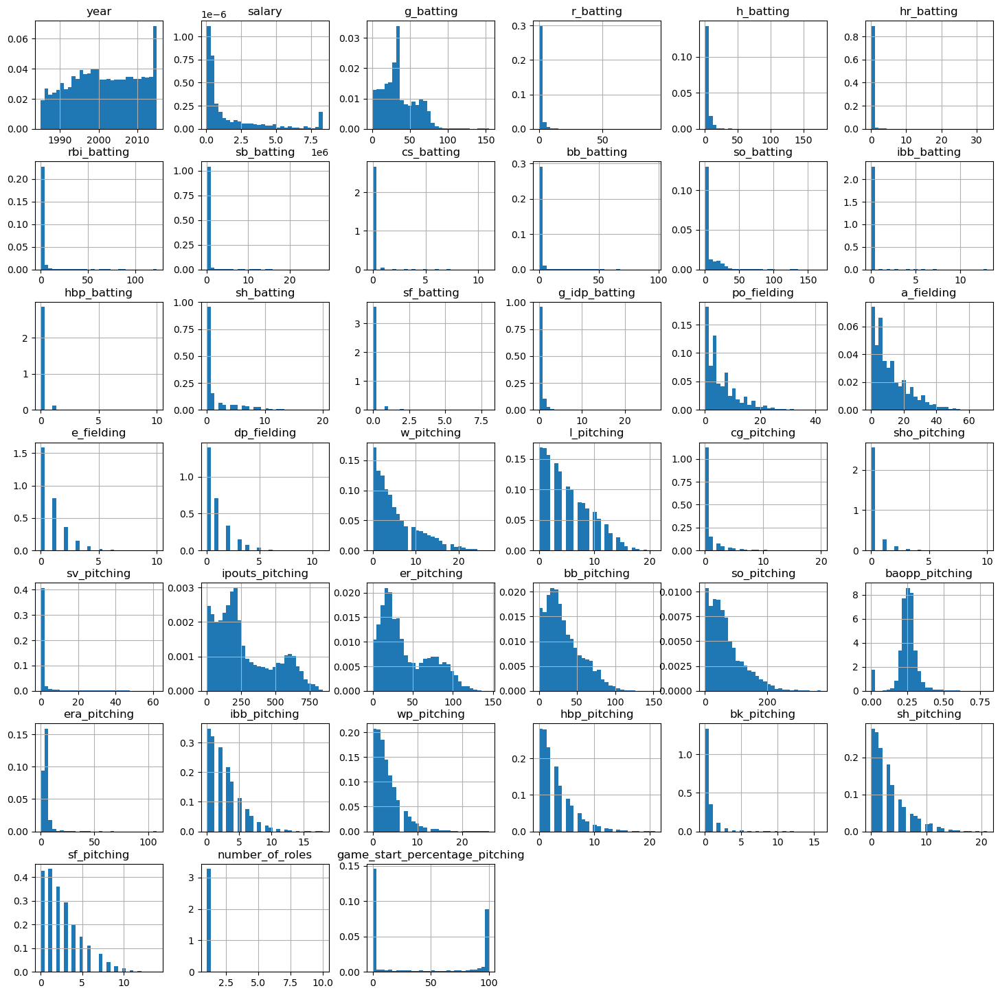

In [227]:
num_cols = [c for c in merged_data.columns if merged_data[c].dtypes!='O']
print(merged_data[num_cols].isnull().mean())

merged_data[num_cols].hist(bins=30, figsize=(18,18), density=True)
plt.show()

In [228]:
features_num_median = ['r_batting','h_batting','hr_batting','rbi_batting','sb_batting','cs_batting','bb_batting','so_batting','ibb_batting',\
                       'hbp_batting','sh_batting','sf_batting','g_idp_batting','sh_pitching','sf_pitching'] # skewed distribution
features_num_mean = ['baopp_pitching'] # somewhat normally distributed


In [229]:
pipe = Pipeline(steps=[
    ('imp_num_mean', mdi.MeanMedianImputer(imputation_method = 'mean', variables=features_num_mean)),
    ('imp_num_median', mdi.MeanMedianImputer(imputation_method = 'median', variables=features_num_median))
])

In [230]:
pipe.fit(X_train)

Pipeline(steps=[('imp_num_mean',
                 MeanMedianImputer(imputation_method='mean',
                                   variables=['baopp_pitching'])),
                ('imp_num_median',
                 MeanMedianImputer(variables=['r_batting', 'h_batting',
                                              'hr_batting', 'rbi_batting',
                                              'sb_batting', 'cs_batting',
                                              'bb_batting', 'so_batting',
                                              'ibb_batting', 'hbp_batting',
                                              'sh_batting', 'sf_batting',
                                              'g_idp_batting', 'sh_pitching',
                                              'sf_pitching']))])

In [231]:
X_train = pipe.transform(X_train)
X_test = pipe.transform(X_test)

In [232]:
X_train.isnull().sum()

year                                 0
team_id                              0
league_id                            0
g_batting                            0
r_batting                            0
h_batting                            0
hr_batting                           0
rbi_batting                          0
sb_batting                           0
cs_batting                           0
bb_batting                           0
so_batting                           0
ibb_batting                          0
hbp_batting                          0
sh_batting                           0
sf_batting                           0
g_idp_batting                        0
po_fielding                          0
a_fielding                           0
e_fielding                           0
dp_fielding                          0
w_pitching                           0
l_pitching                           0
cg_pitching                          0
sho_pitching                         0
sv_pitching              

In [233]:
X_test.isnull().sum()

year                                 0
team_id                              0
league_id                            0
g_batting                            0
r_batting                            0
h_batting                            0
hr_batting                           0
rbi_batting                          0
sb_batting                           0
cs_batting                           0
bb_batting                           0
so_batting                           0
ibb_batting                          0
hbp_batting                          0
sh_batting                           0
sf_batting                           0
g_idp_batting                        0
po_fielding                          0
a_fielding                           0
e_fielding                           0
dp_fielding                          0
w_pitching                           0
l_pitching                           0
cg_pitching                          0
sho_pitching                         0
sv_pitching              

In [234]:
# Missing award_id indicates that the player won no award
X_train['award_id'] = X_train['award_id'].fillna("No Award")

In [235]:
# Missing award_id indicates that the player won no award
X_test['award_id'] = X_test['award_id'].fillna("No Award")

In [236]:
X_train.isnull().sum()

year                              0
team_id                           0
league_id                         0
g_batting                         0
r_batting                         0
h_batting                         0
hr_batting                        0
rbi_batting                       0
sb_batting                        0
cs_batting                        0
bb_batting                        0
so_batting                        0
ibb_batting                       0
hbp_batting                       0
sh_batting                        0
sf_batting                        0
g_idp_batting                     0
po_fielding                       0
a_fielding                        0
e_fielding                        0
dp_fielding                       0
w_pitching                        0
l_pitching                        0
cg_pitching                       0
sho_pitching                      0
sv_pitching                       0
ipouts_pitching                   0
er_pitching                 

In [237]:
X_test.isnull().sum()

year                              0
team_id                           0
league_id                         0
g_batting                         0
r_batting                         0
h_batting                         0
hr_batting                        0
rbi_batting                       0
sb_batting                        0
cs_batting                        0
bb_batting                        0
so_batting                        0
ibb_batting                       0
hbp_batting                       0
sh_batting                        0
sf_batting                        0
g_idp_batting                     0
po_fielding                       0
a_fielding                        0
e_fielding                        0
dp_fielding                       0
w_pitching                        0
l_pitching                        0
cg_pitching                       0
sho_pitching                      0
sv_pitching                       0
ipouts_pitching                   0
er_pitching                 

year                              0.0
g_batting                         0.0
r_batting                         0.0
h_batting                         0.0
hr_batting                        0.0
rbi_batting                       0.0
sb_batting                        0.0
cs_batting                        0.0
bb_batting                        0.0
so_batting                        0.0
ibb_batting                       0.0
hbp_batting                       0.0
sh_batting                        0.0
sf_batting                        0.0
g_idp_batting                     0.0
po_fielding                       0.0
a_fielding                        0.0
e_fielding                        0.0
dp_fielding                       0.0
w_pitching                        0.0
l_pitching                        0.0
cg_pitching                       0.0
sho_pitching                      0.0
sv_pitching                       0.0
ipouts_pitching                   0.0
er_pitching                       0.0
bb_pitching 

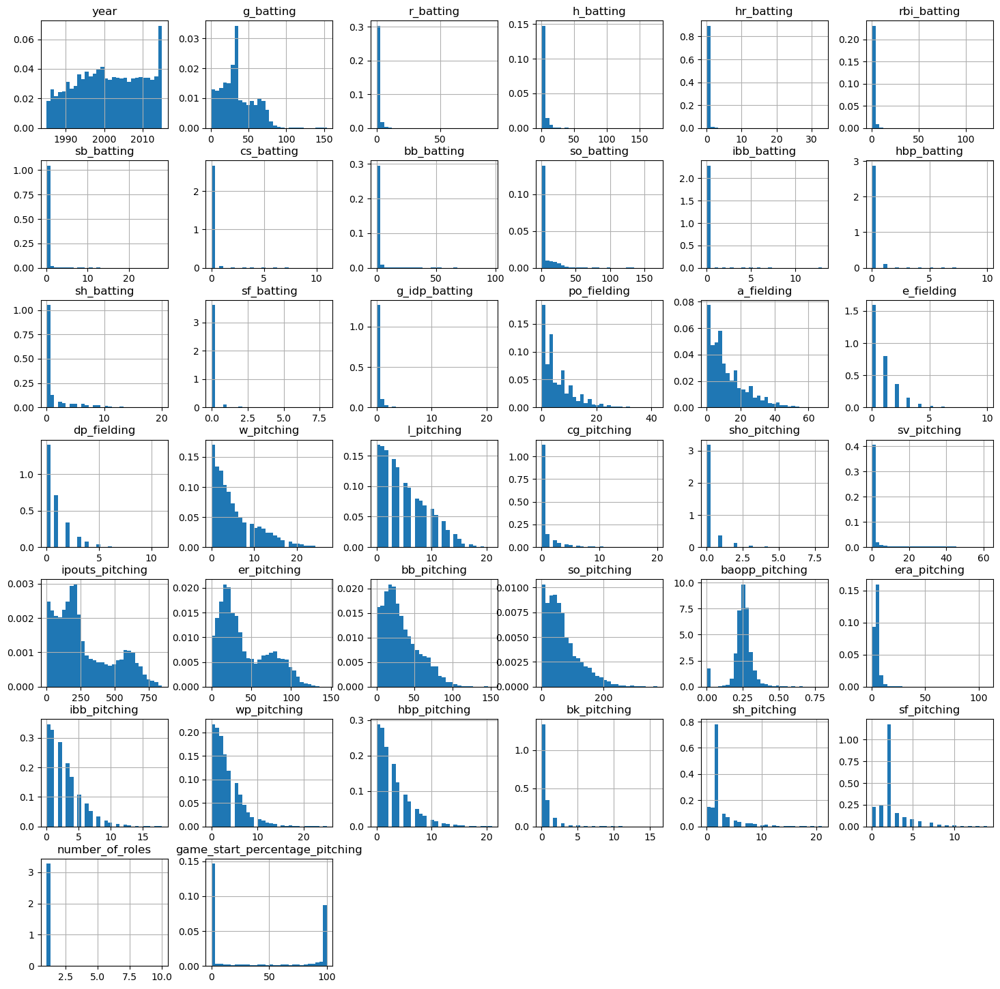

In [238]:
num_cols = [c for c in X_train.columns if X_train[c].dtypes!='O']
print(X_train[num_cols].isnull().mean())

X_train[num_cols].hist(bins=30, figsize=(18,18), density=True)
plt.show()

year                              0.0
g_batting                         0.0
r_batting                         0.0
h_batting                         0.0
hr_batting                        0.0
rbi_batting                       0.0
sb_batting                        0.0
cs_batting                        0.0
bb_batting                        0.0
so_batting                        0.0
ibb_batting                       0.0
hbp_batting                       0.0
sh_batting                        0.0
sf_batting                        0.0
g_idp_batting                     0.0
po_fielding                       0.0
a_fielding                        0.0
e_fielding                        0.0
dp_fielding                       0.0
w_pitching                        0.0
l_pitching                        0.0
cg_pitching                       0.0
sho_pitching                      0.0
sv_pitching                       0.0
ipouts_pitching                   0.0
er_pitching                       0.0
bb_pitching 

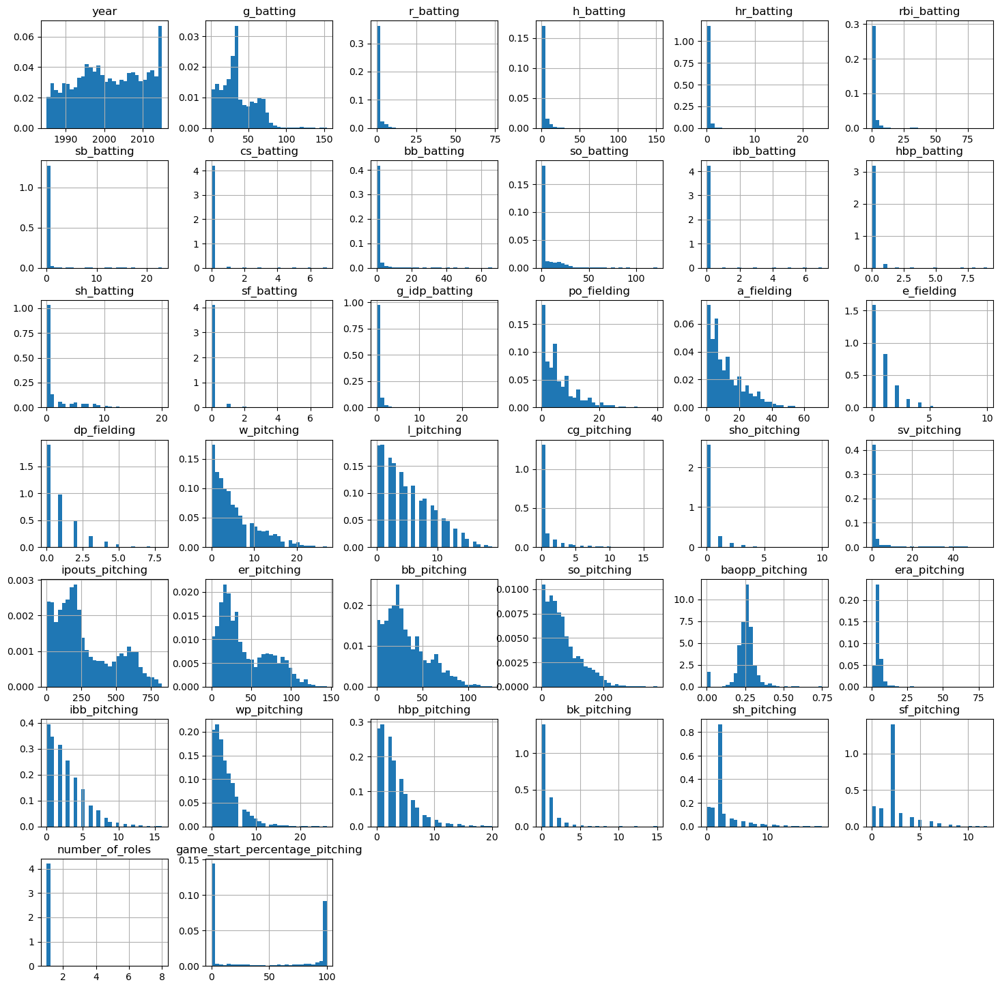

In [239]:
num_cols = [c for c in X_test.columns if X_test[c].dtypes!='O']
print(X_test[num_cols].isnull().mean())

X_test[num_cols].hist(bins=30, figsize=(18,18), density=True)
plt.show()

In [240]:
# print columns with outliers
cols_with_outliers

['g_batting',
 'r_batting',
 'h_batting',
 'hr_batting',
 'rbi_batting',
 'sb_batting',
 'cs_batting',
 'bb_batting',
 'so_batting',
 'ibb_batting',
 'hbp_batting',
 'sh_batting',
 'sf_batting',
 'g_idp_batting',
 'po_fielding',
 'a_fielding',
 'e_fielding',
 'dp_fielding',
 'w_pitching',
 'l_pitching',
 'cg_pitching',
 'sho_pitching',
 'sv_pitching',
 'er_pitching',
 'bb_pitching',
 'so_pitching',
 'baopp_pitching',
 'era_pitching',
 'ibb_pitching',
 'wp_pitching',
 'hbp_pitching',
 'bk_pitching',
 'sh_pitching',
 'sf_pitching',
 'number_of_roles',
 'salary']

In [241]:
# print outlier list by number of outliers in ascending order
outliers_info_list_sorted_numoutliers

[{'column': 'year', 'num_outliers': 0, 'unique_values': 31},
 {'column': 'ipouts_pitching', 'num_outliers': 0, 'unique_values': 799},
 {'column': 'game_start_percentage_pitching',
  'num_outliers': 0,
  'unique_values': 613},
 {'column': 'er_pitching', 'num_outliers': 3, 'unique_values': 139},
 {'column': 'l_pitching', 'num_outliers': 29, 'unique_values': 21},
 {'column': 'g_batting', 'num_outliers': 79, 'unique_values': 137},
 {'column': 'ibb_batting', 'num_outliers': 104, 'unique_values': 12},
 {'column': 'sf_pitching', 'num_outliers': 142, 'unique_values': 15},
 {'column': 'bb_pitching', 'num_outliers': 183, 'unique_values': 128},
 {'column': 'number_of_roles', 'num_outliers': 212, 'unique_values': 10},
 {'column': 'cs_batting', 'num_outliers': 219, 'unique_values': 10},
 {'column': 'w_pitching', 'num_outliers': 250, 'unique_values': 26},
 {'column': 'sb_batting', 'num_outliers': 259, 'unique_values': 21},
 {'column': 'wp_pitching', 'num_outliers': 263, 'unique_values': 27},
 {'colu

In [242]:
# print outlier list by number of unique values in ascending order
outliers_info_list_sorted_uniquevalues

[{'column': 'sf_batting', 'num_outliers': 470, 'unique_values': 9},
 {'column': 'cs_batting', 'num_outliers': 219, 'unique_values': 10},
 {'column': 'sho_pitching', 'num_outliers': 1745, 'unique_values': 10},
 {'column': 'number_of_roles', 'num_outliers': 212, 'unique_values': 10},
 {'column': 'hbp_batting', 'num_outliers': 479, 'unique_values': 11},
 {'column': 'e_fielding', 'num_outliers': 960, 'unique_values': 11},
 {'column': 'ibb_batting', 'num_outliers': 104, 'unique_values': 12},
 {'column': 'dp_fielding', 'num_outliers': 1195, 'unique_values': 12},
 {'column': 'sf_pitching', 'num_outliers': 142, 'unique_values': 15},
 {'column': 'bk_pitching', 'num_outliers': 501, 'unique_values': 16},
 {'column': 'ibb_pitching', 'num_outliers': 378, 'unique_values': 19},
 {'column': 'g_idp_batting', 'num_outliers': 1372, 'unique_values': 20},
 {'column': 'cg_pitching', 'num_outliers': 2926, 'unique_values': 20},
 {'column': 'sb_batting', 'num_outliers': 259, 'unique_values': 21},
 {'column': '

In [243]:
len(outliers_info_list_sorted_uniquevalues)

38

In [244]:
# identify all columns
all_columns = [
    'sf_batting', 'cs_batting', 'sho_pitching', 'number_of_roles', 'hbp_batting', 
    'e_fielding', 'ibb_batting', 'dp_fielding', 'sf_pitching', 'bk_pitching', 
    'ibb_pitching', 'g_idp_batting', 'cg_pitching', 'sb_batting', 'sh_batting', 
    'l_pitching', 'sh_pitching', 'hbp_pitching', 'hr_batting', 'w_pitching', 
    'wp_pitching', 'year', 'po_fielding', 'bb_batting', 'sv_pitching', 
    'rbi_batting', 'r_batting', 'a_fielding', 'so_batting', 'h_batting', 
    'bb_pitching', 'g_batting', 'er_pitching', 'so_pitching', 'baopp_pitching', 
    'game_start_percentage_pitching', 'ipouts_pitching', 'era_pitching'
]

In [245]:
#cols to leave it as it is
#These columns either have very few outliers compared to their unique values, or they likely represent discrete
#some of the distribution looks discrete thus they do not need to be capped
cols_without_capping = [
    'year',
    'ipouts_pitching',
    'game_start_percentage_pitching',
    'er_pitching',
    'g_batting',
    'hr_batting',
    'sb_batting',
    'cs_batting',
    'ibb_batting',
    'hbp_batting',
    'sf_batting',
    'g_idp_batting',
    'e_fielding',
    'dp_fielding',
    'w_pitching',
    'l_pitching',
    'sho_pitching',
    'bk_pitching',
    'sh_pitching',
    'sf_pitching',
    'number_of_roles',
    'ibb_pitching',
    'cg_pitching',
    'sh_batting',
    'hpb_pitching'
]

len(cols_without_capping)


25

In [246]:
# if columns not found in cols_without_capping it is going to be capped
capping_columns = [col for col in all_columns if col not in cols_without_capping]
print(capping_columns)
print(len(capping_columns))

['hbp_pitching', 'wp_pitching', 'po_fielding', 'bb_batting', 'sv_pitching', 'rbi_batting', 'r_batting', 'a_fielding', 'so_batting', 'h_batting', 'bb_pitching', 'so_pitching', 'baopp_pitching', 'era_pitching']
14


Generating diagnostic plots for column: hbp_pitching


c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


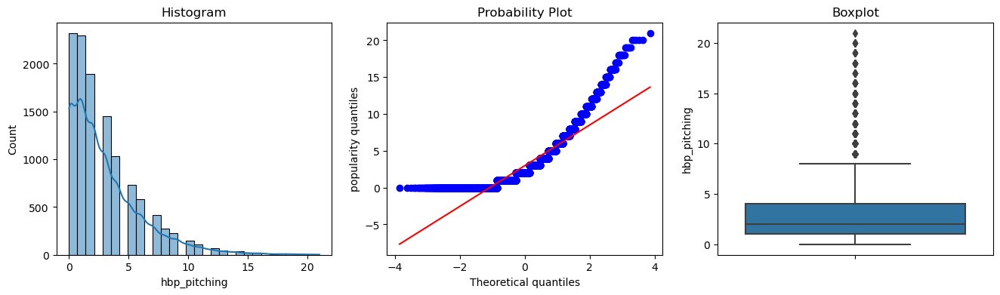

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


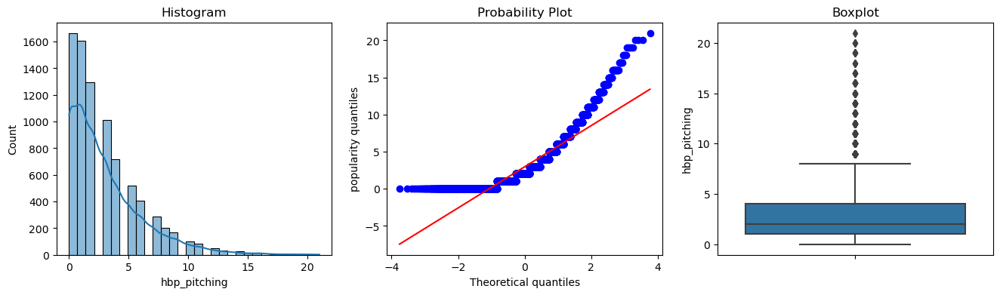

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


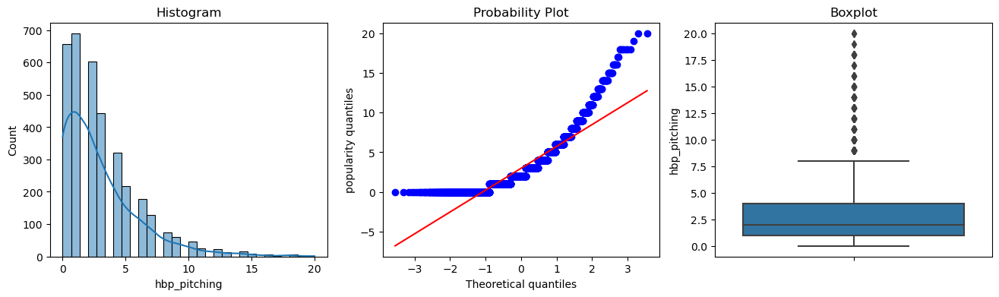




Generating diagnostic plots for column: wp_pitching


c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


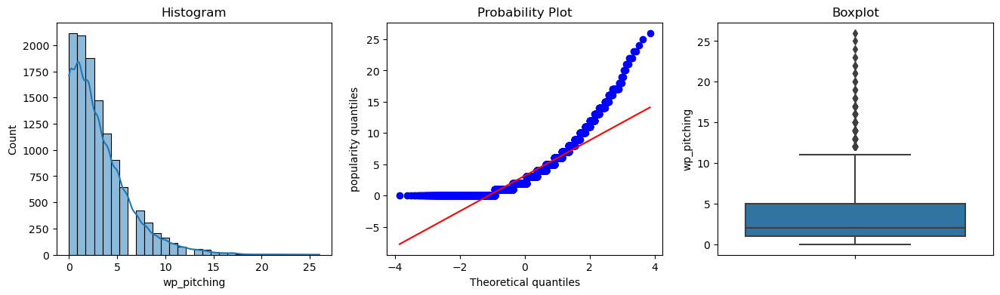

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


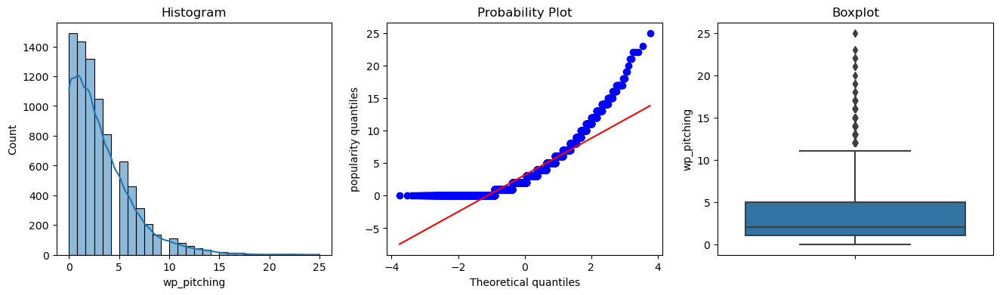

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


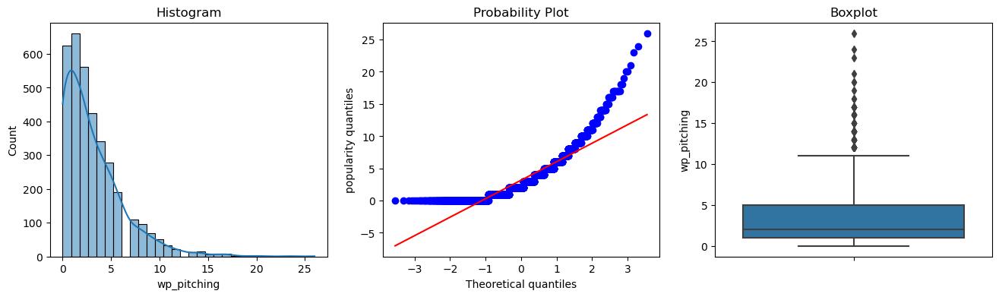




Generating diagnostic plots for column: po_fielding


c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


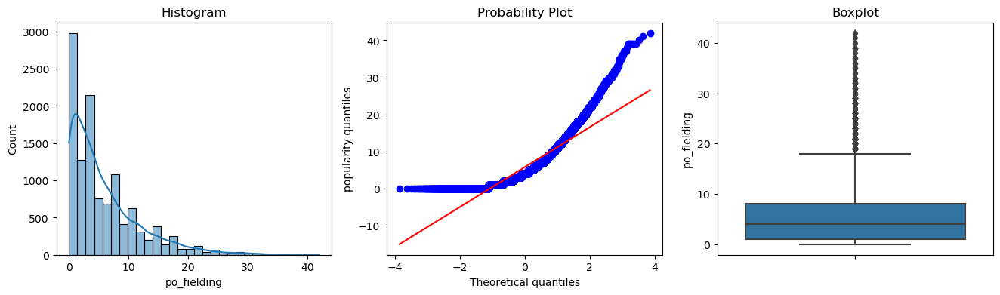

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


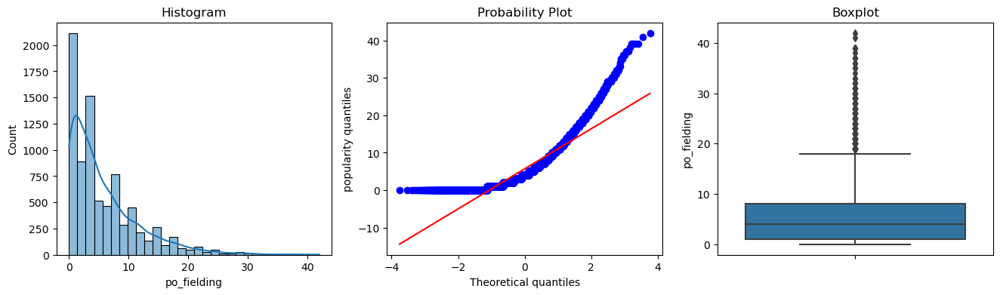

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


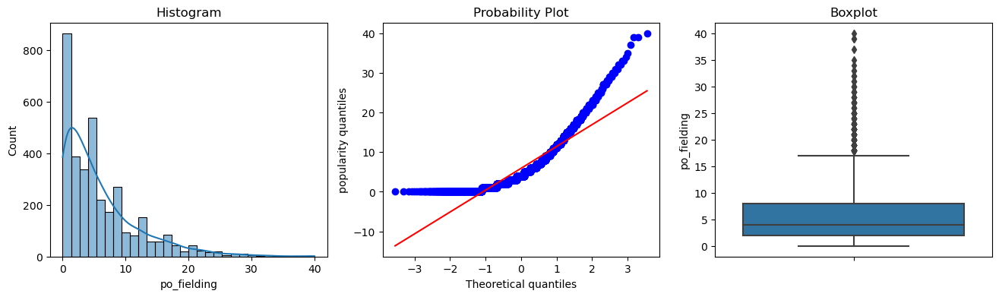




Generating diagnostic plots for column: bb_batting


c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


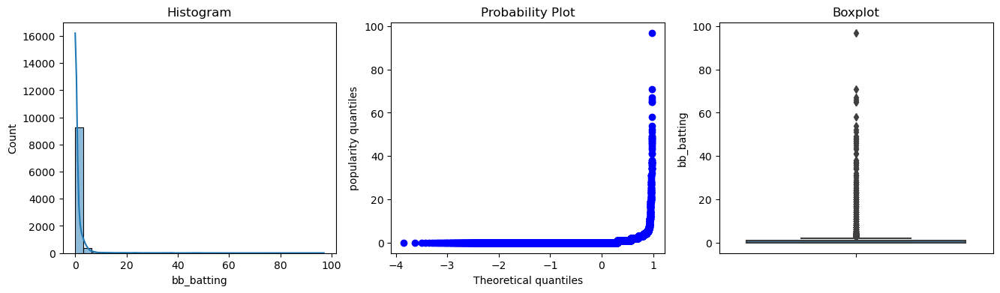

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


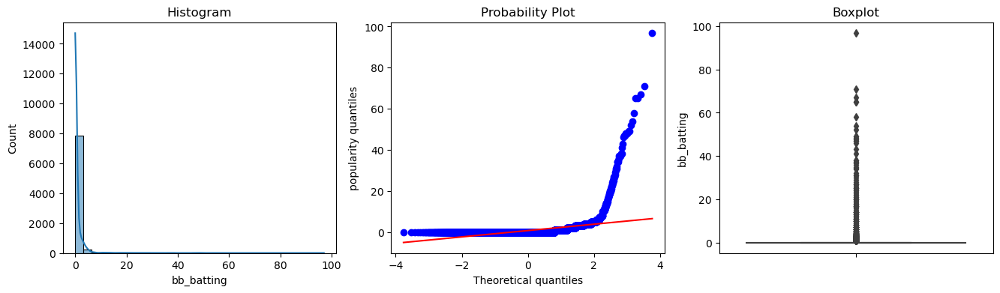

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


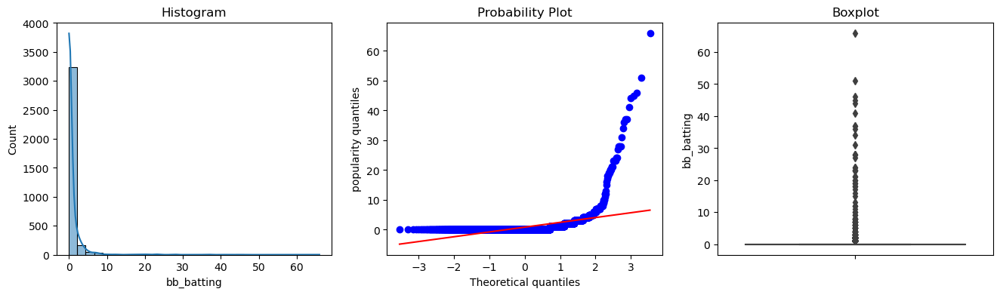




Generating diagnostic plots for column: sv_pitching


c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


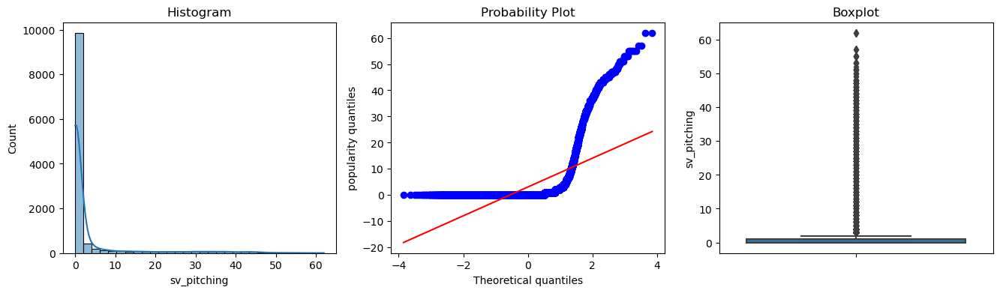

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


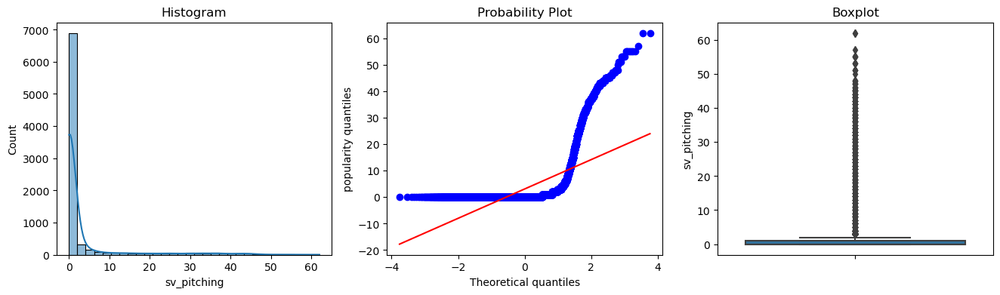

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


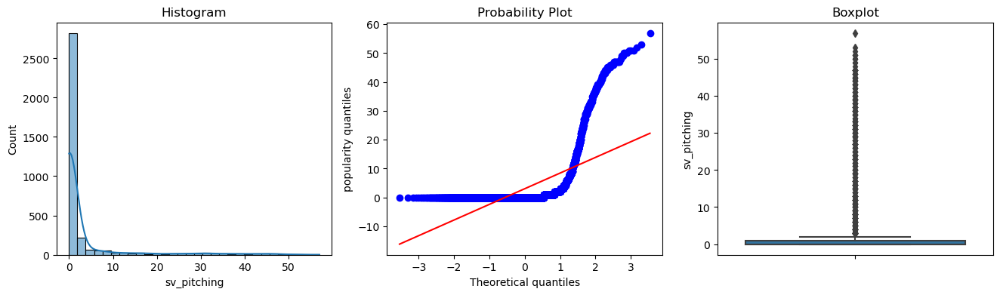




Generating diagnostic plots for column: rbi_batting


c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


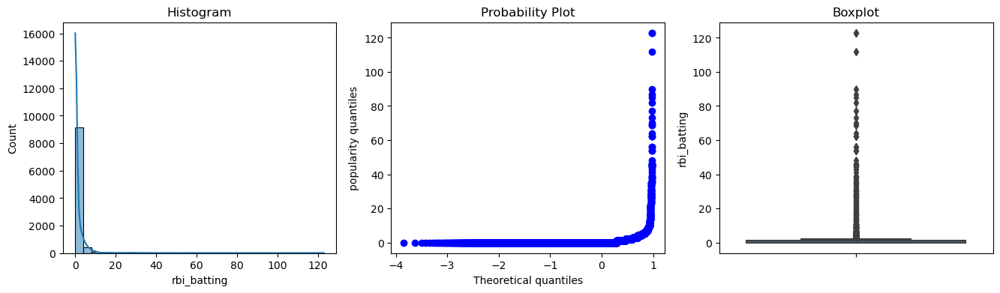

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


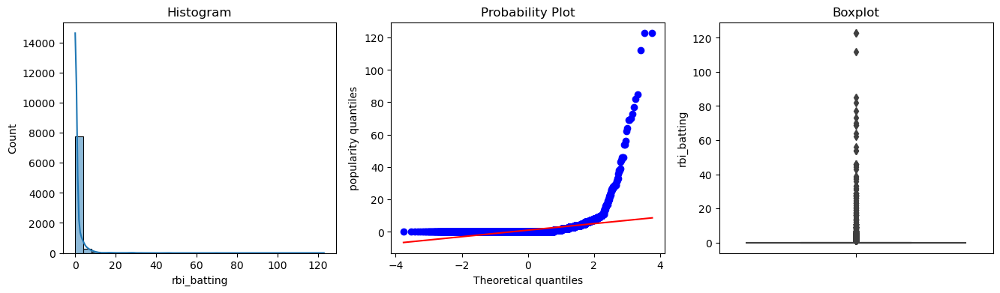

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


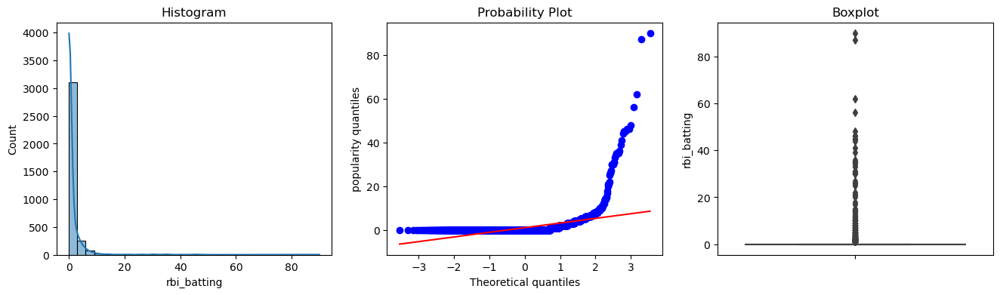




Generating diagnostic plots for column: r_batting


c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


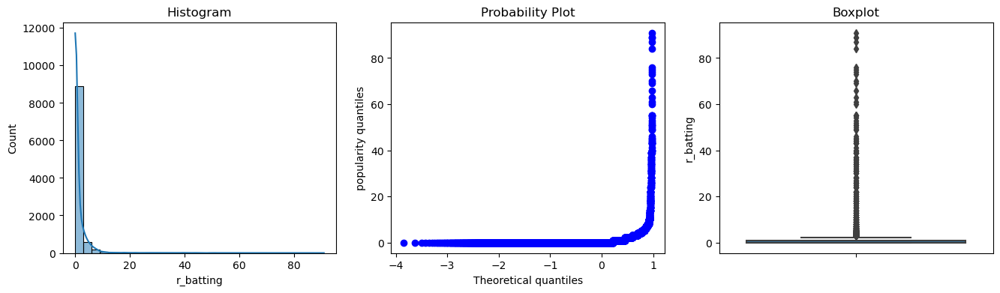

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


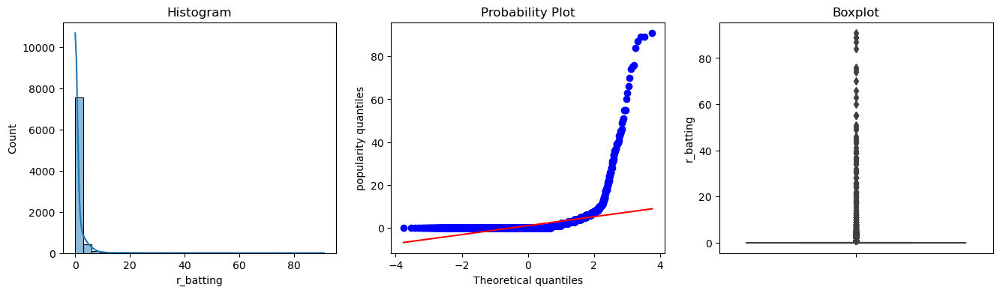

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


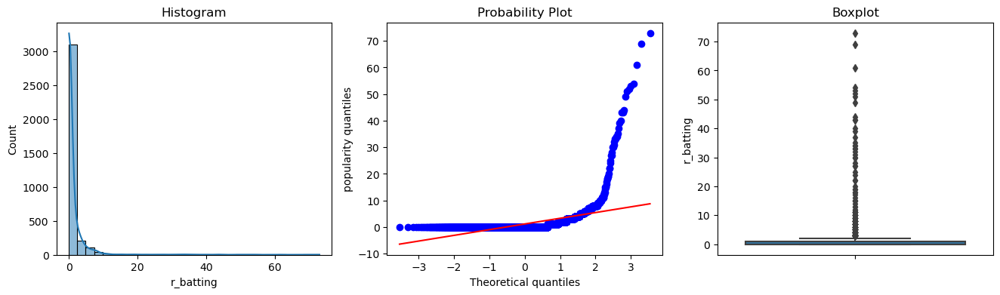




Generating diagnostic plots for column: a_fielding


c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


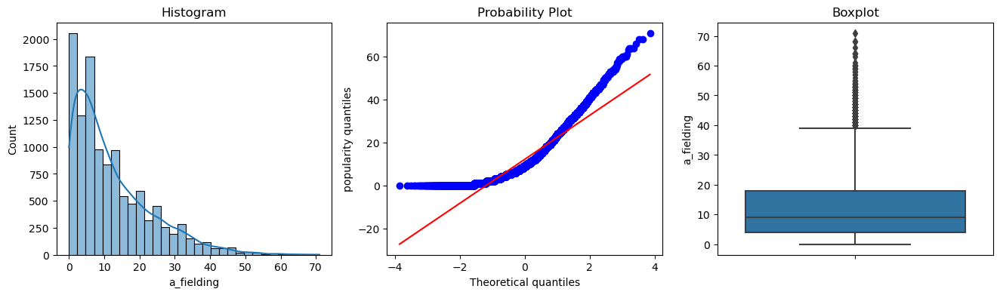

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


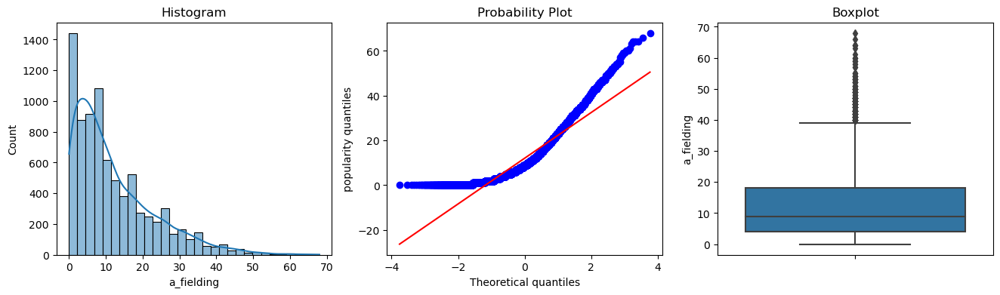

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


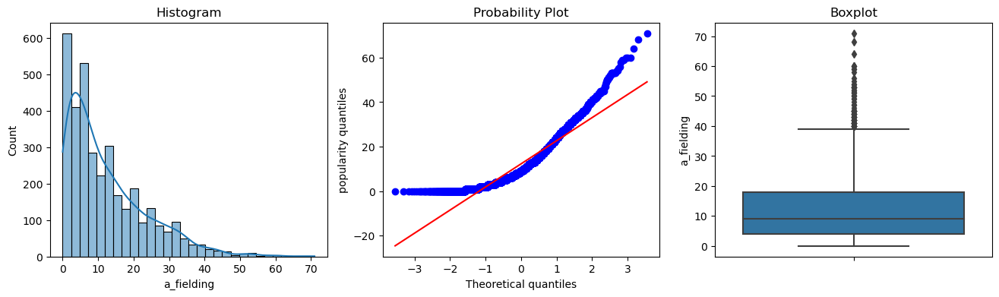




Generating diagnostic plots for column: so_batting


c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


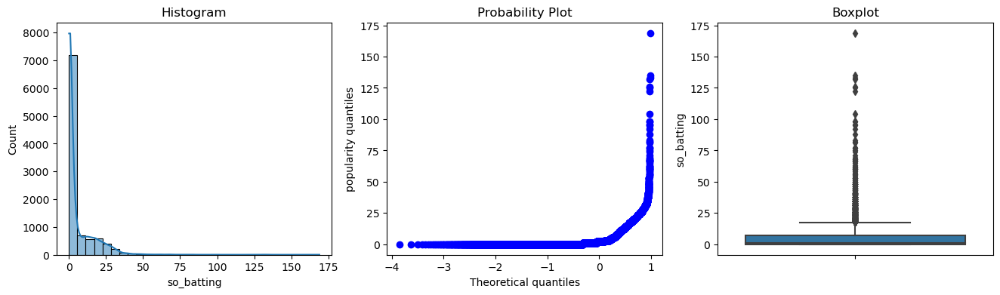

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


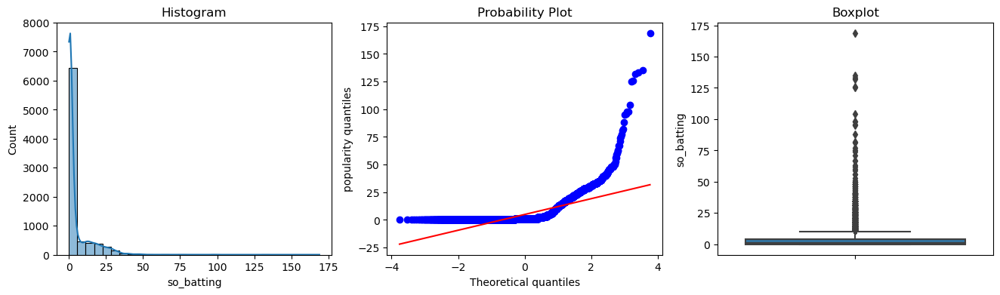

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


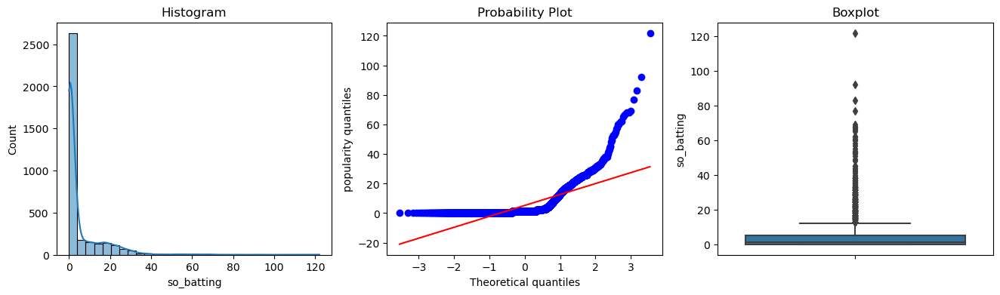




Generating diagnostic plots for column: h_batting


c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


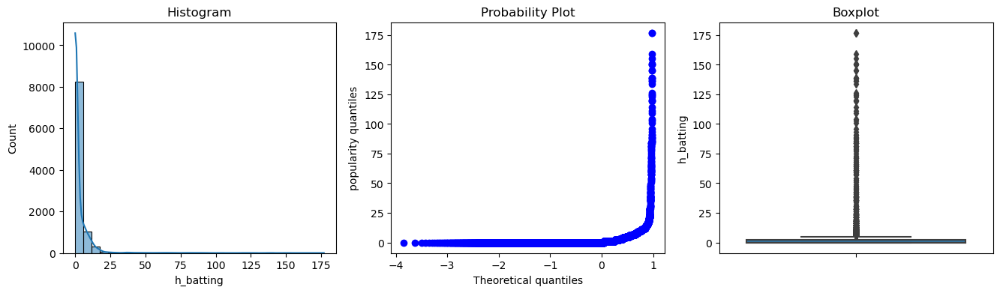

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


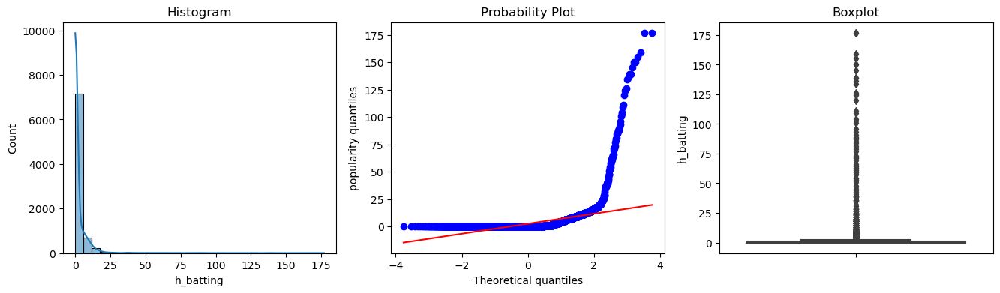

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


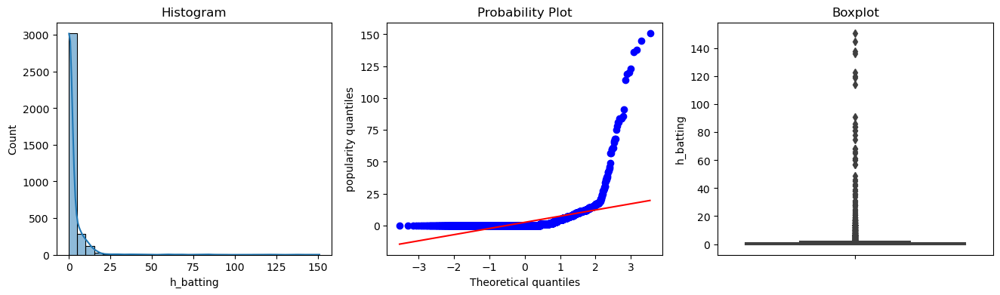




Generating diagnostic plots for column: bb_pitching


c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


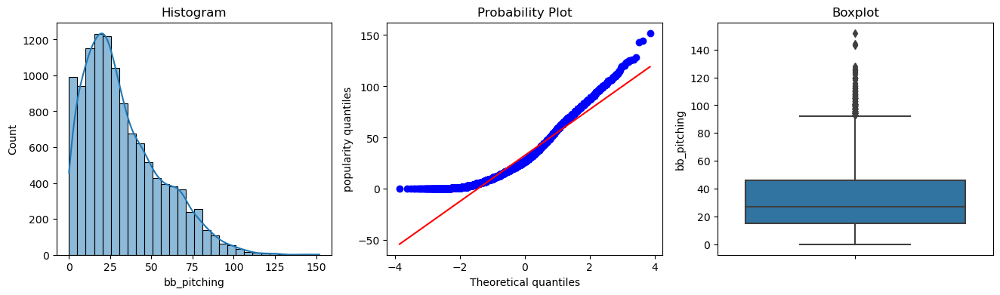

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


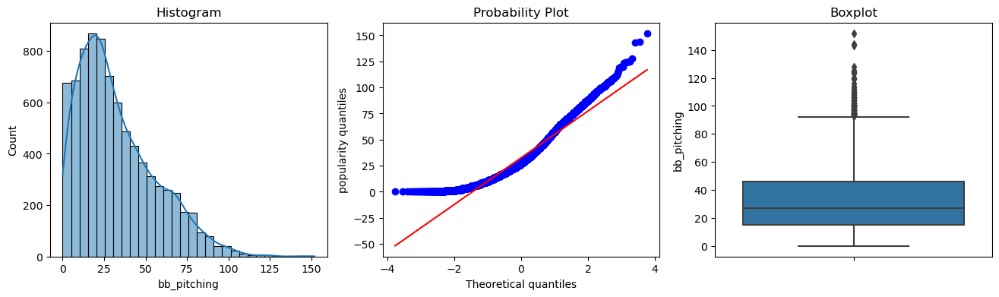

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


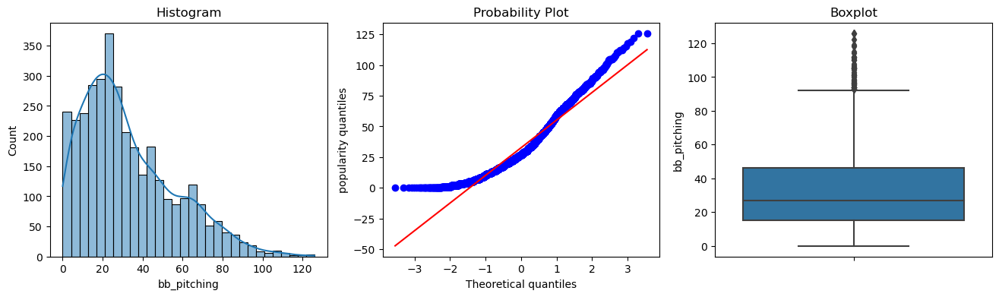




Generating diagnostic plots for column: so_pitching


c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


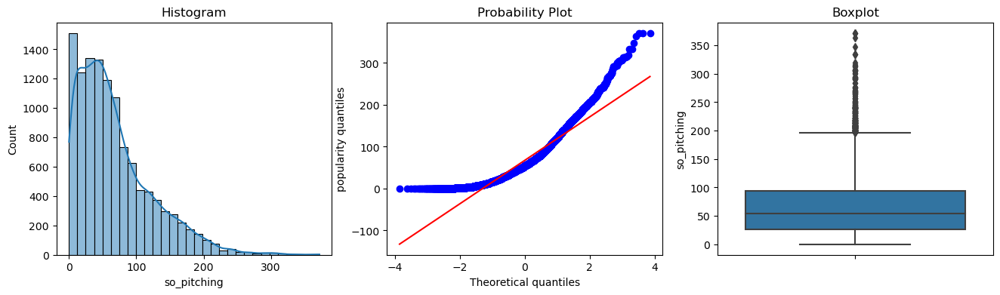

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


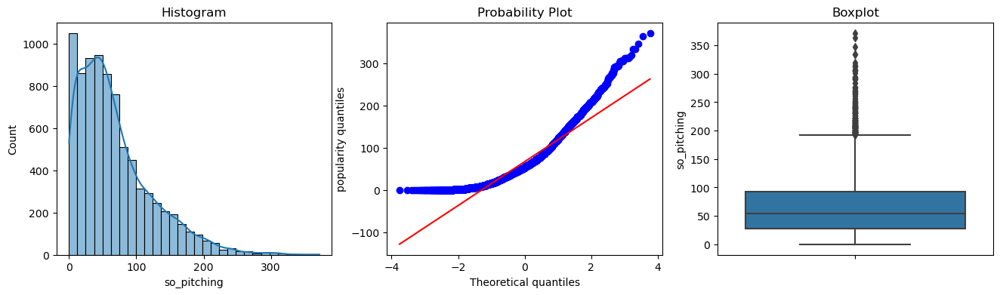

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


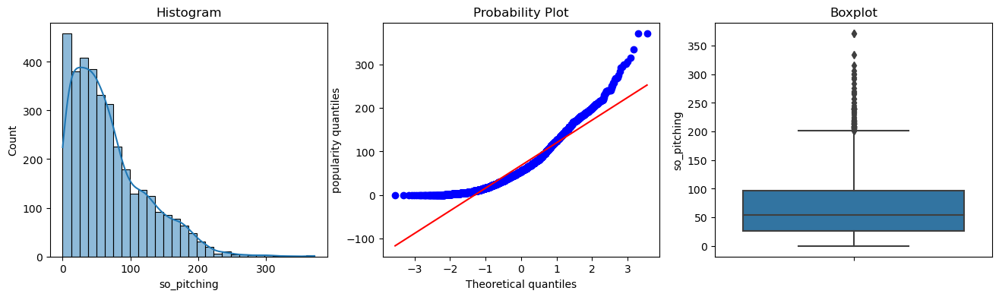




Generating diagnostic plots for column: baopp_pitching


c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


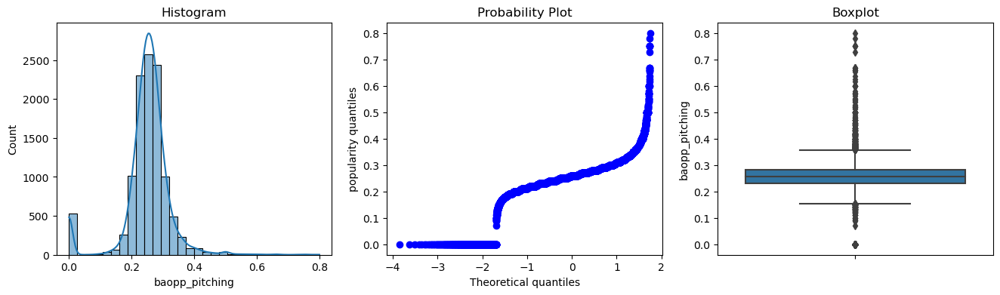

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


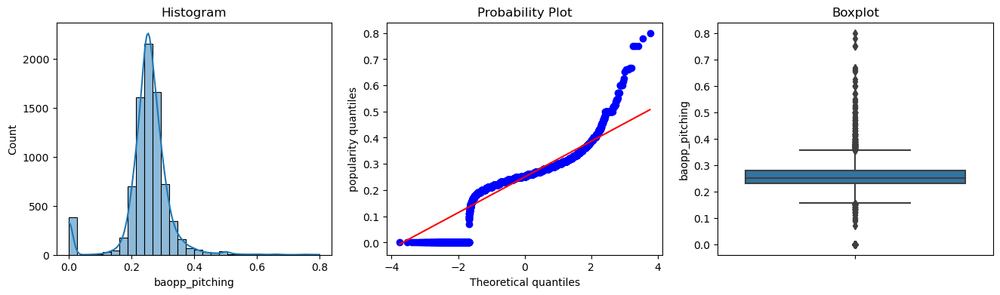

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


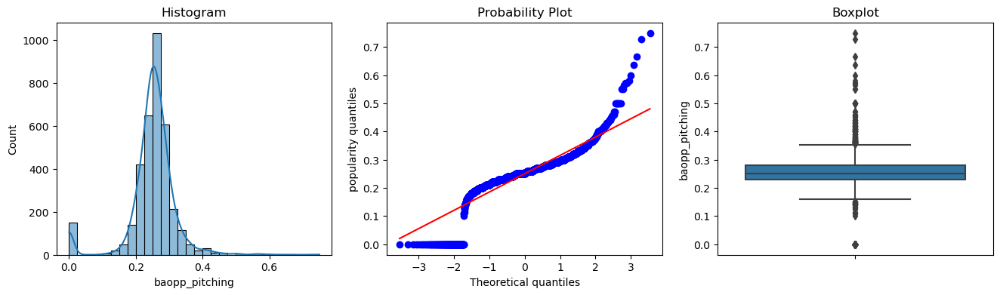




Generating diagnostic plots for column: era_pitching


c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


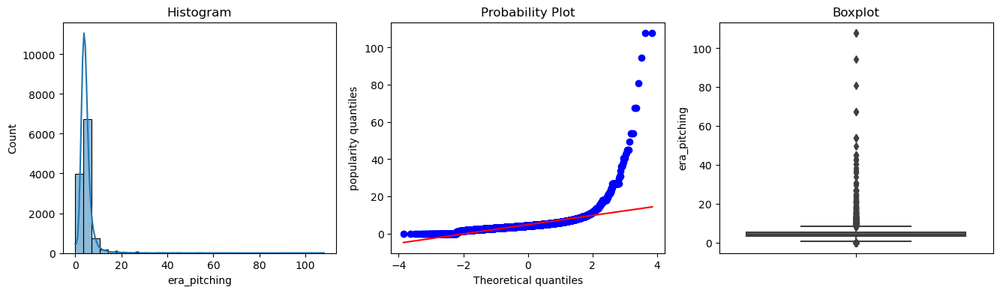

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


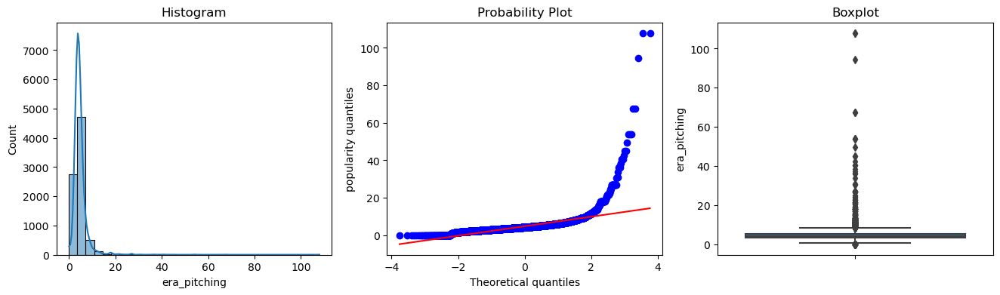

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


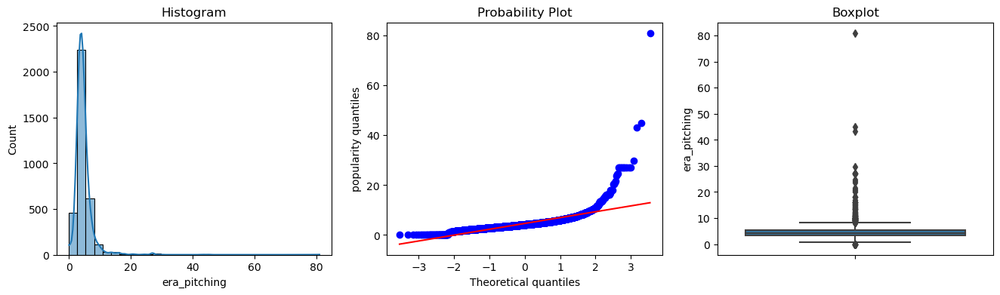

In [247]:
# print distribution for capping_columns before capping
for col in capping_columns:
    print(f"Generating diagnostic plots for column: {col}")
    diagnostic_plots(merged_data, col)
    diagnostic_plots(X_train, col)
    diagnostic_plots(X_test, col)
    print()
    print()
    print()

In [248]:
windsorizer = Winsorizer(capping_method ='quantiles', 
                        tail='both', # cap left, right or both tails
                        fold =0.01,
                        variables=capping_columns)

windsorizer.fit(X_train)

Winsorizer(capping_method='quantiles', fold=0.01, tail='both',
           variables=['hbp_pitching', 'wp_pitching', 'po_fielding',
                      'bb_batting', 'sv_pitching', 'rbi_batting', 'r_batting',
                      'a_fielding', 'so_batting', 'h_batting', 'bb_pitching',
                      'so_pitching', 'baopp_pitching', 'era_pitching'])

In [249]:
X_train = windsorizer.transform(X_train)
X_test = windsorizer.transform(X_test)

Generating diagnostic plots for column: hbp_pitching


c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


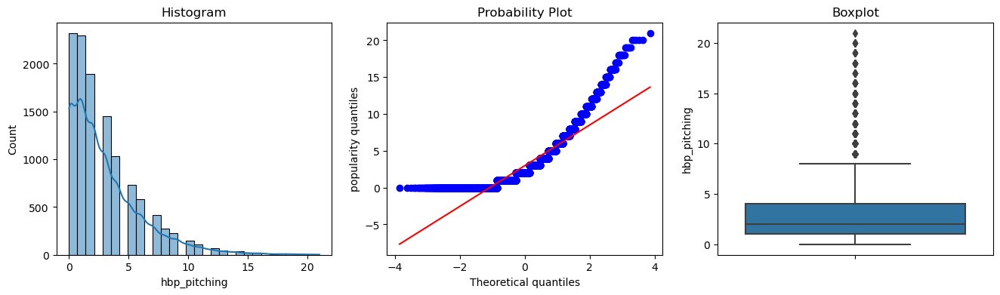

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


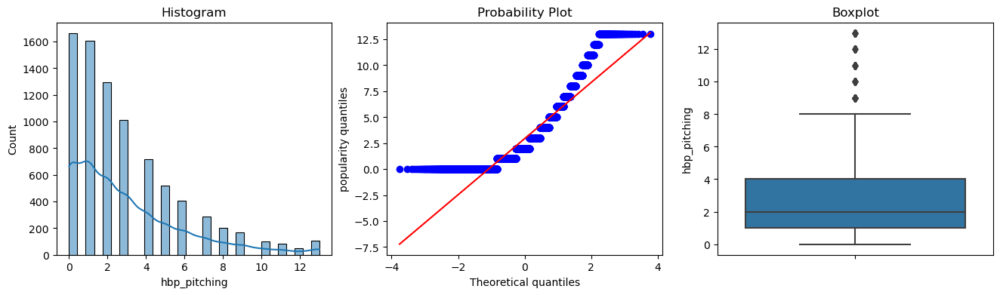

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


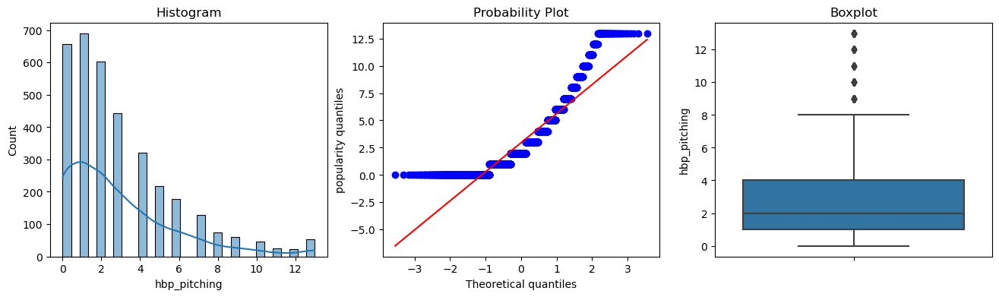




Generating diagnostic plots for column: wp_pitching


c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


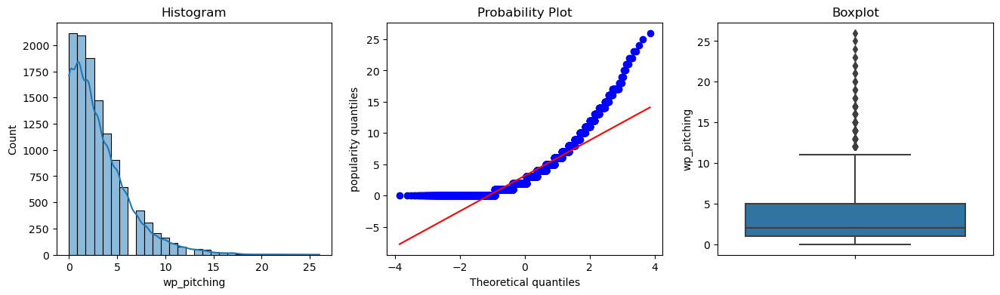

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


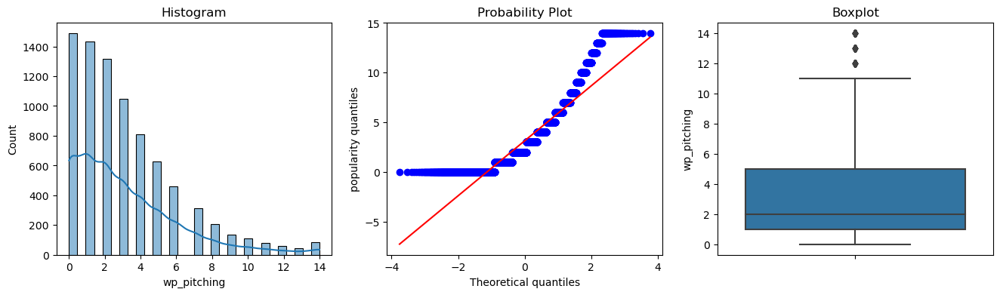

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


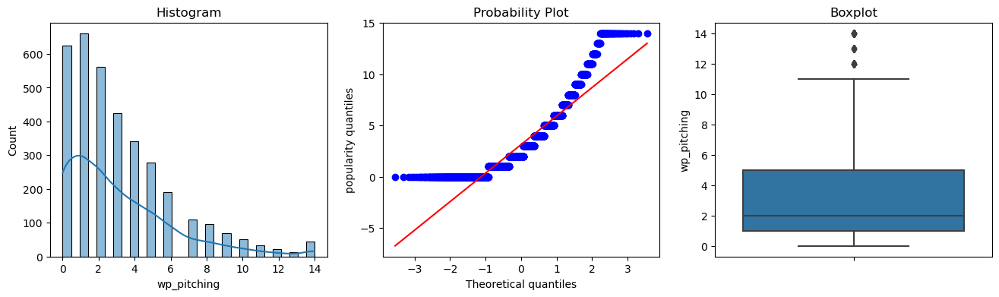




Generating diagnostic plots for column: po_fielding


c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


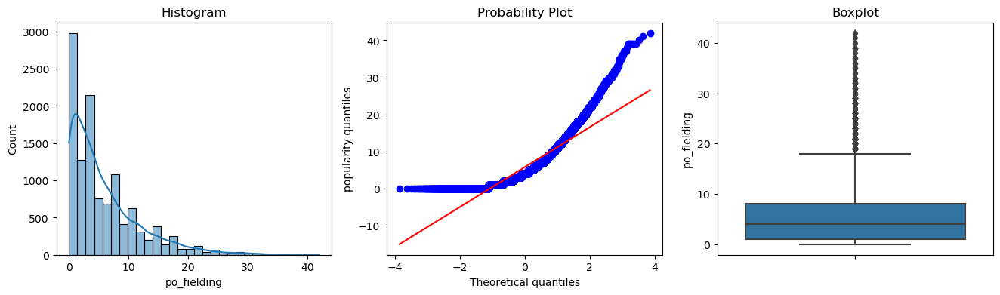

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


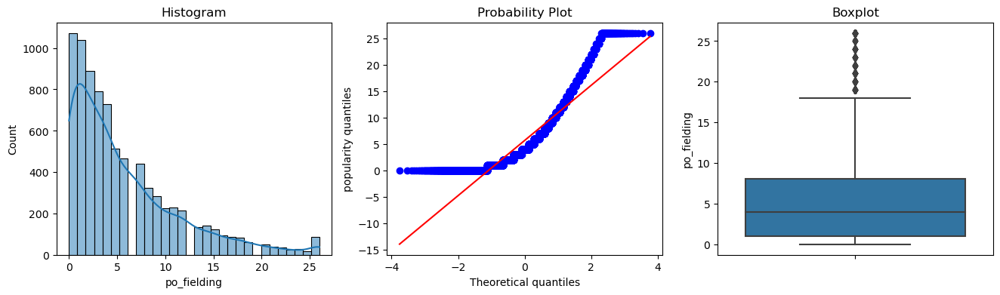

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


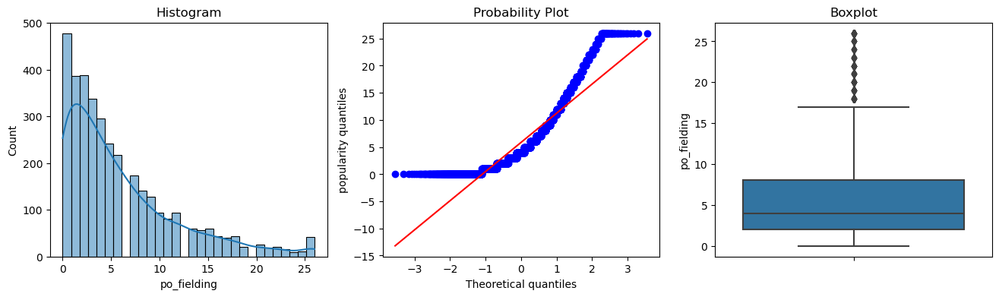




Generating diagnostic plots for column: bb_batting


c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


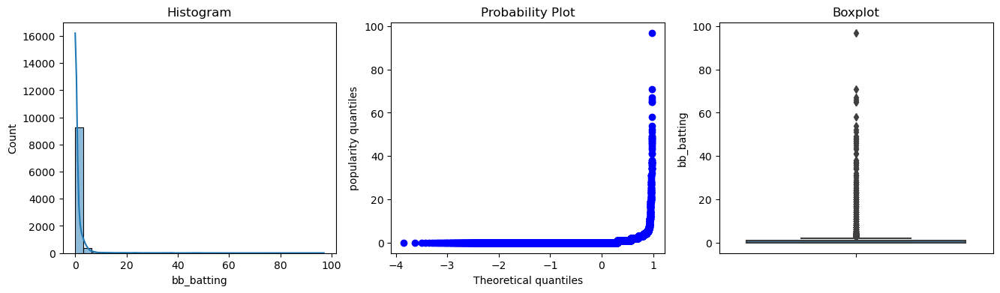

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


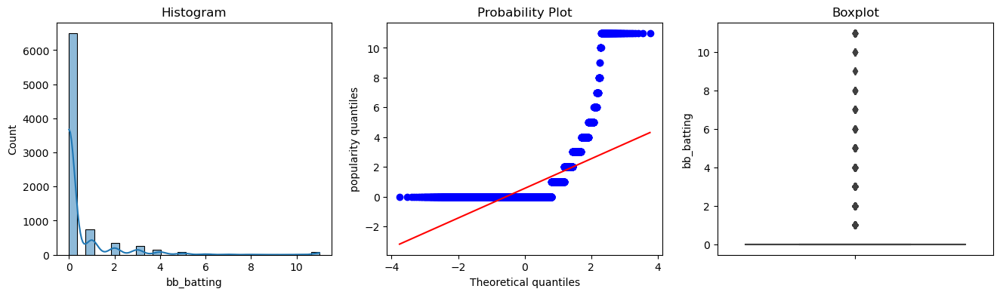

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


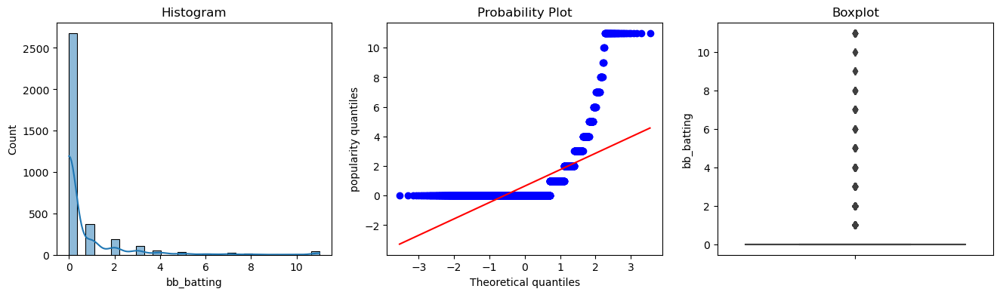




Generating diagnostic plots for column: sv_pitching


c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


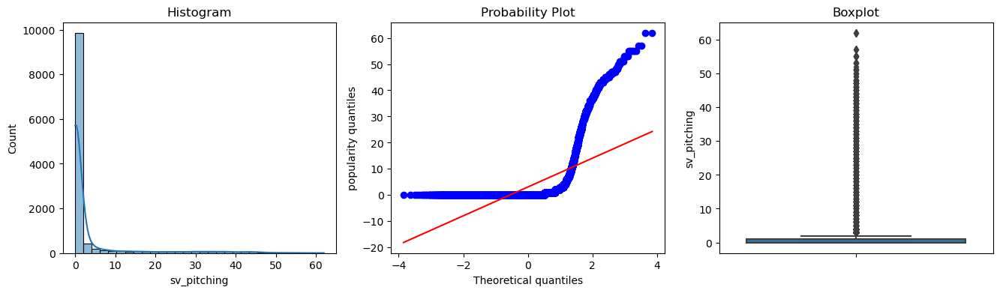

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


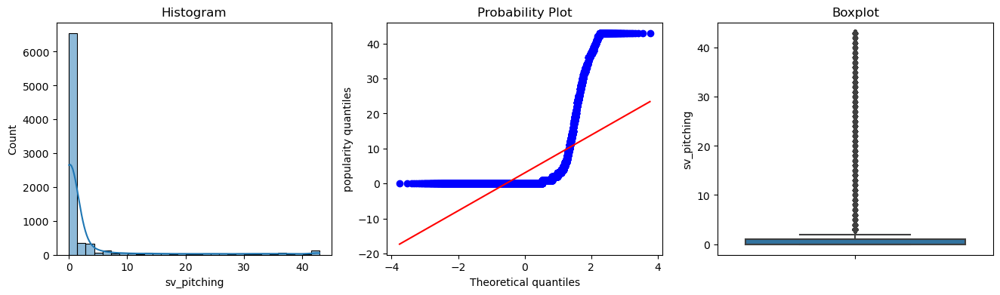

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


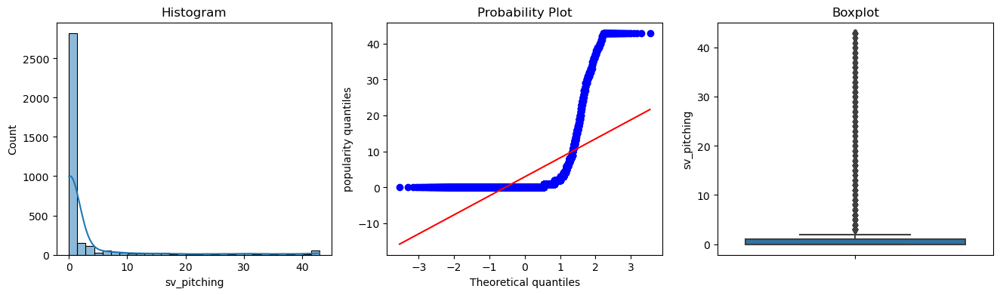




Generating diagnostic plots for column: rbi_batting


c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


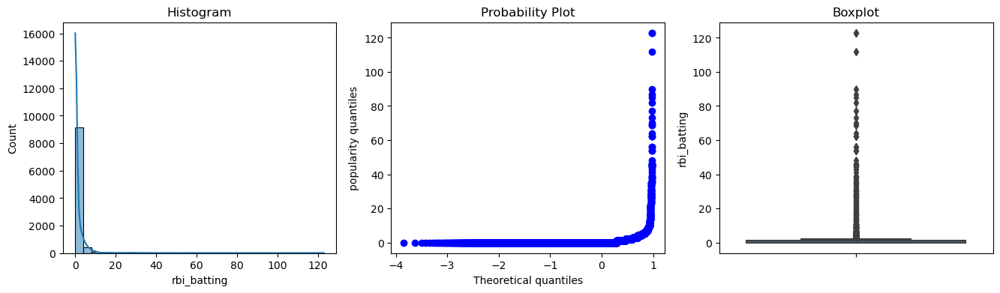

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


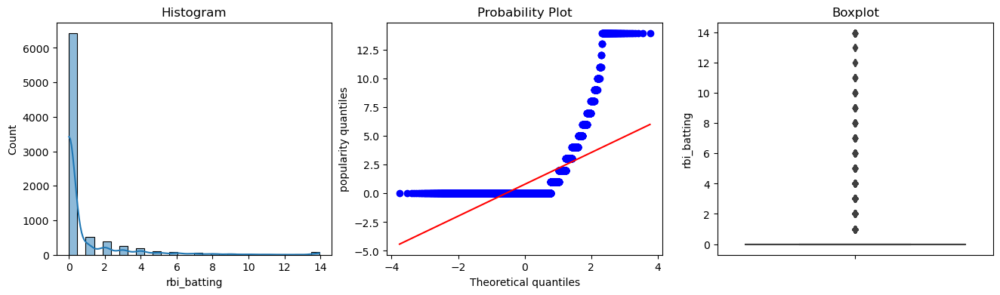

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


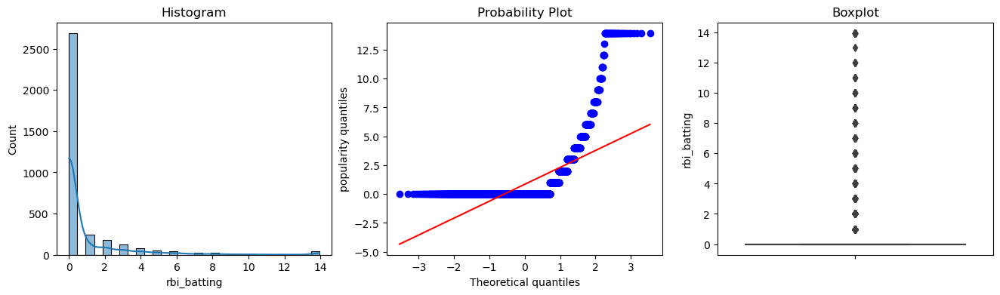




Generating diagnostic plots for column: r_batting


c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


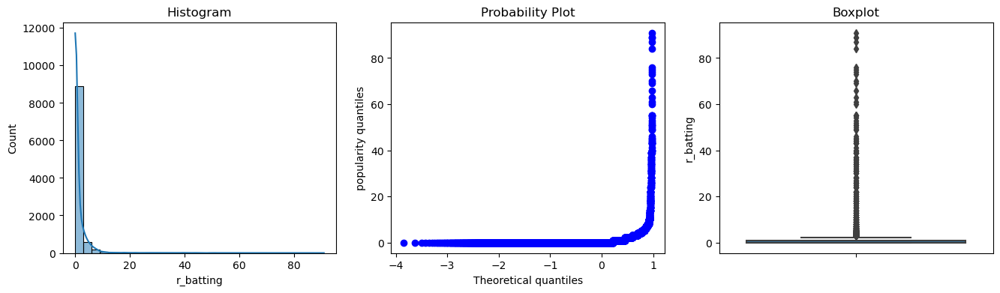

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


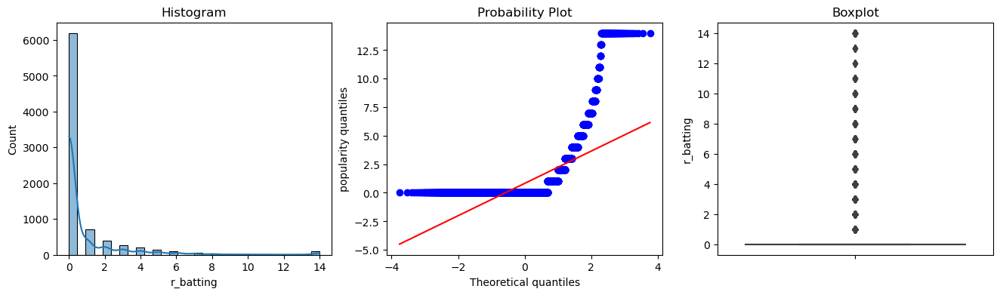

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


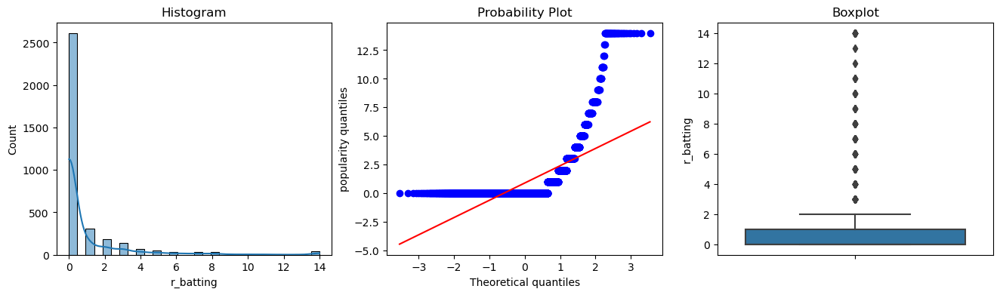




Generating diagnostic plots for column: a_fielding


c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


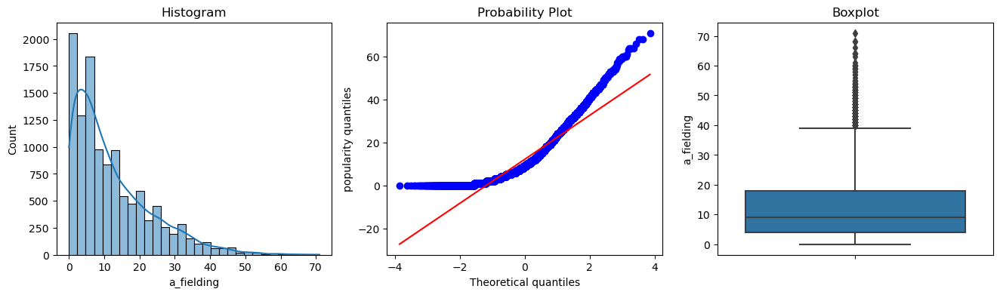

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


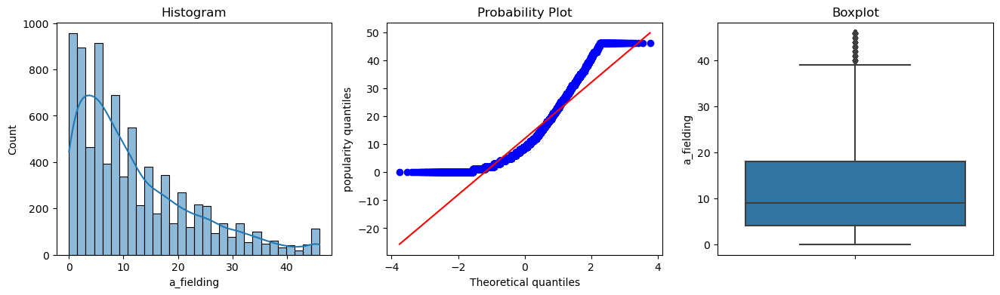

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


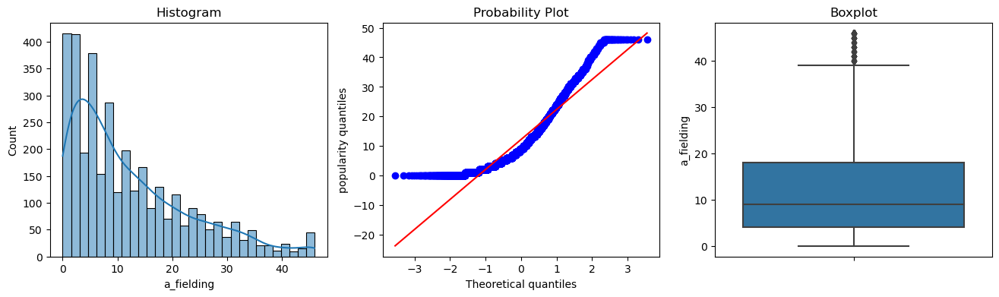




Generating diagnostic plots for column: so_batting


c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


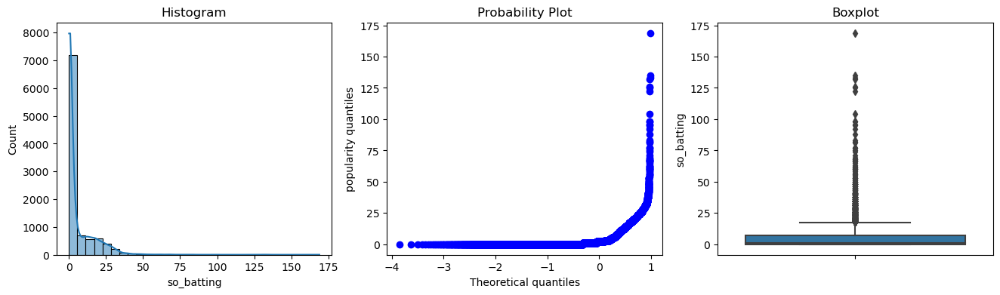

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


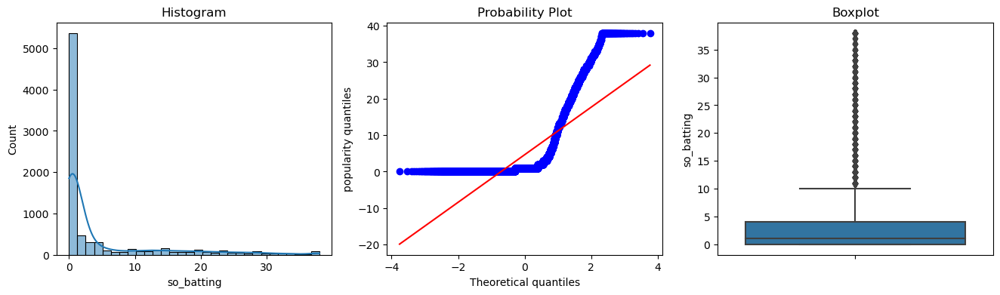

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


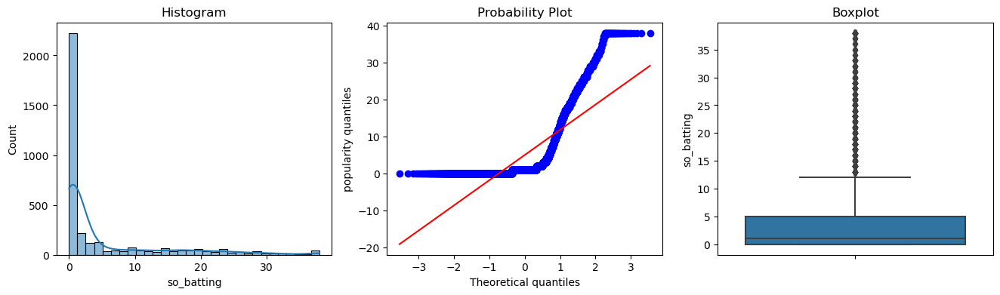




Generating diagnostic plots for column: h_batting


c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


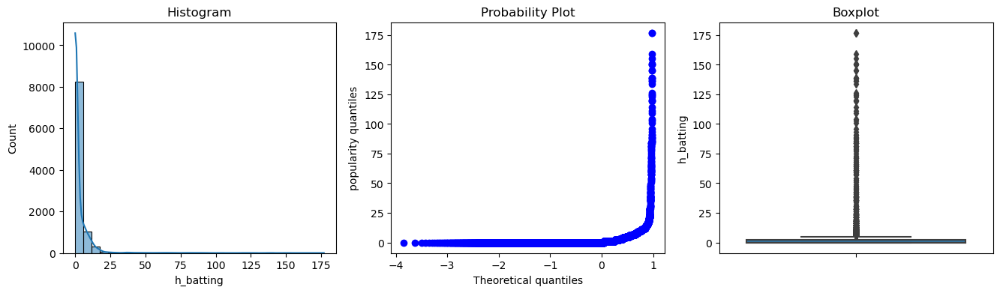

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


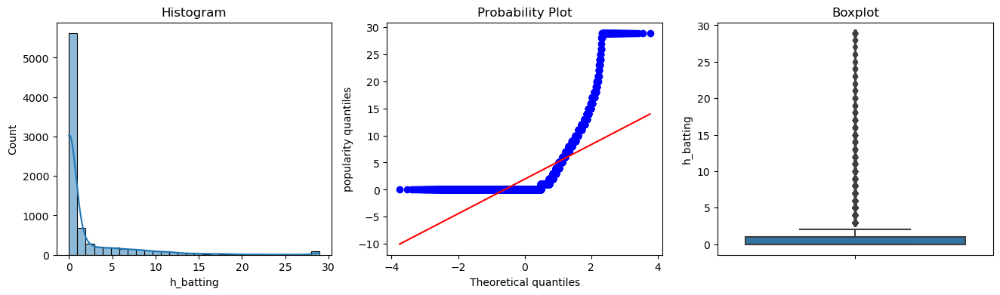

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


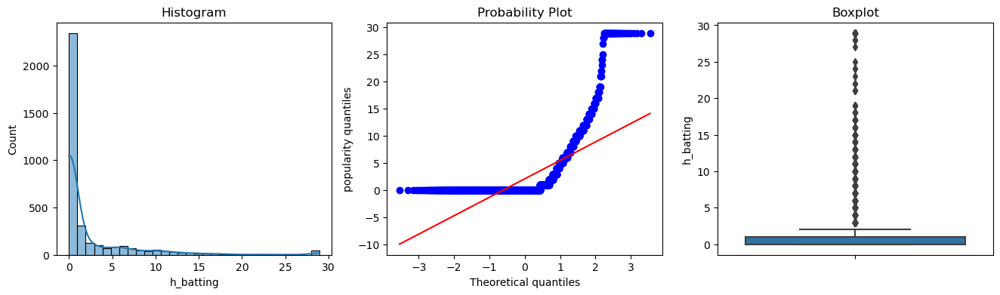




Generating diagnostic plots for column: bb_pitching


c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


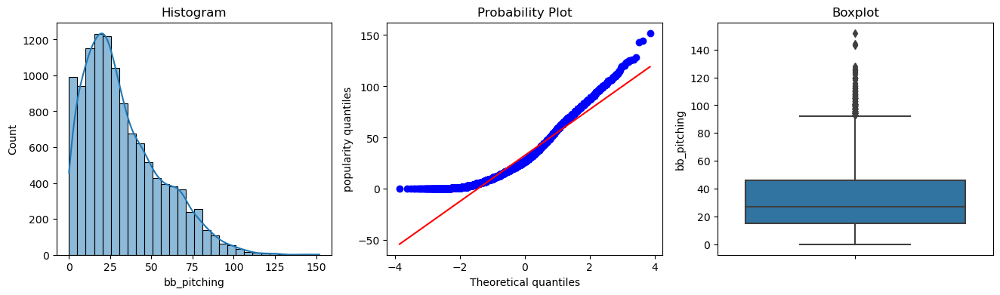

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


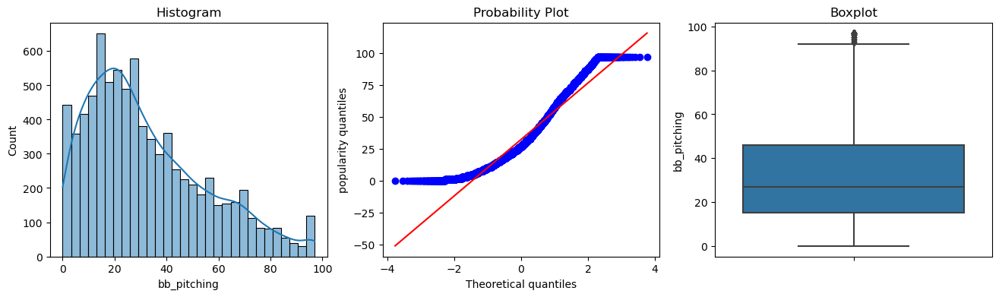

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


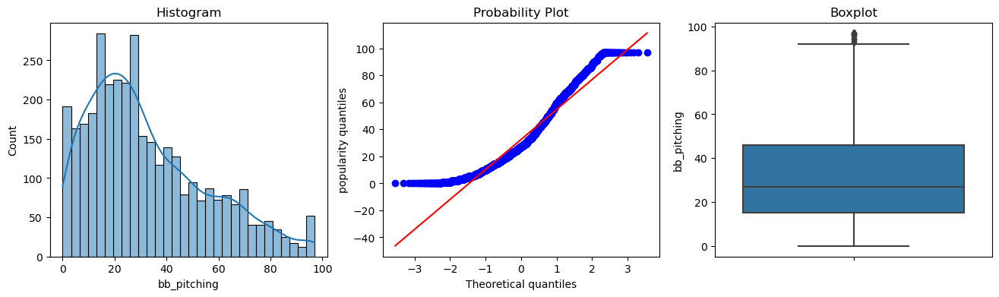




Generating diagnostic plots for column: so_pitching


c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


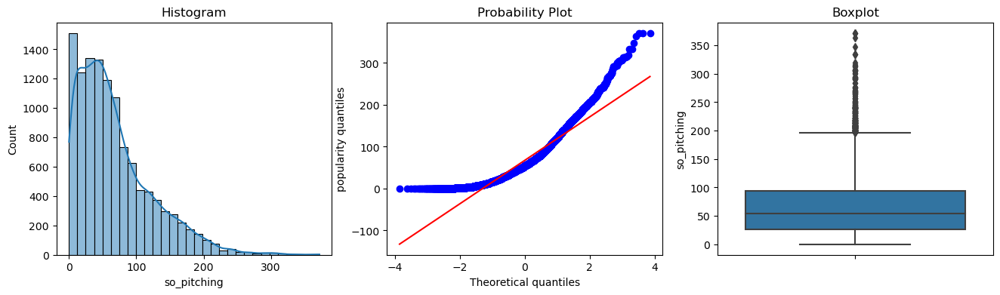

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


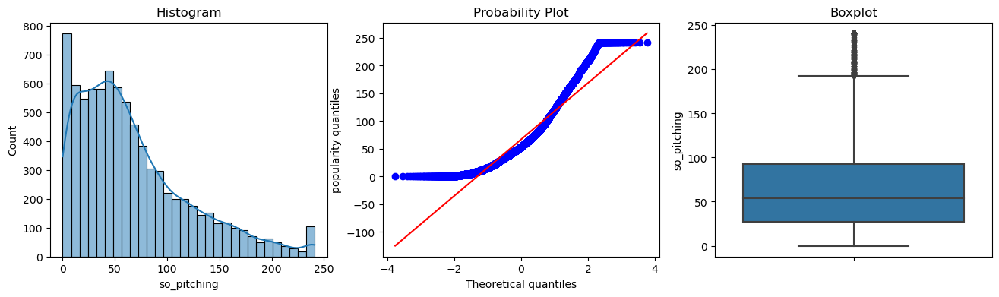

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


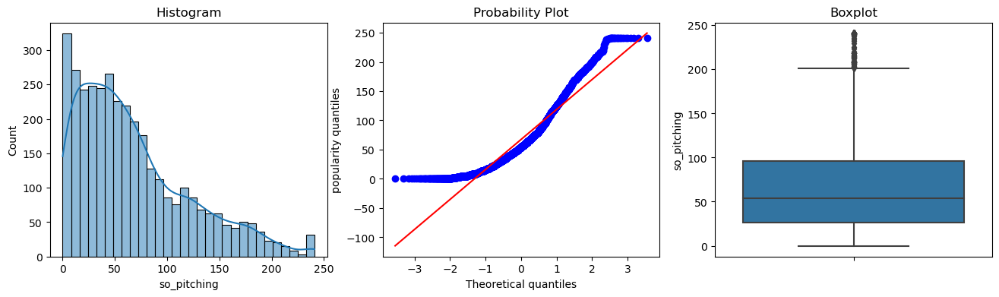




Generating diagnostic plots for column: baopp_pitching


c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


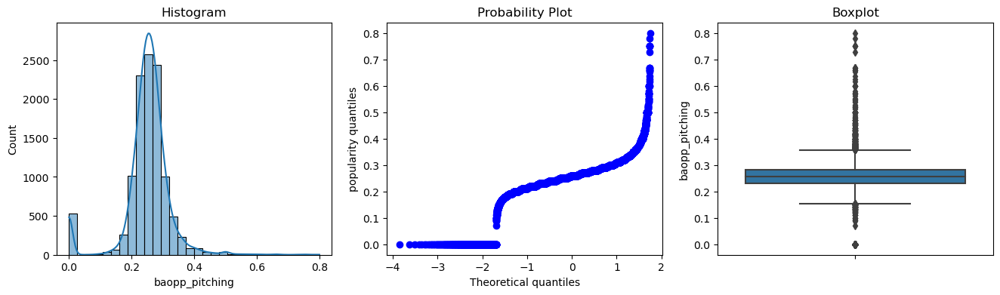

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


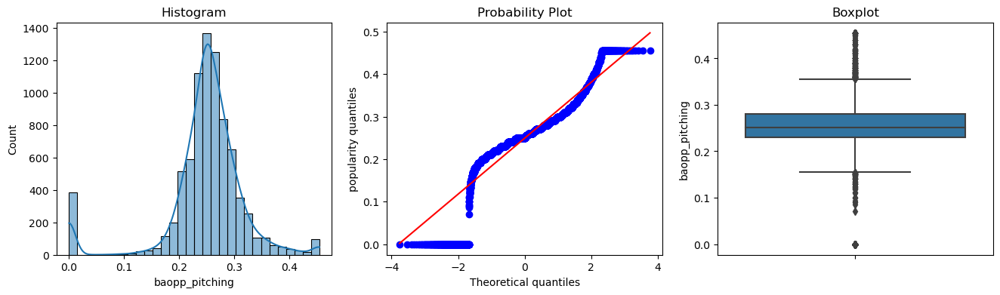

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


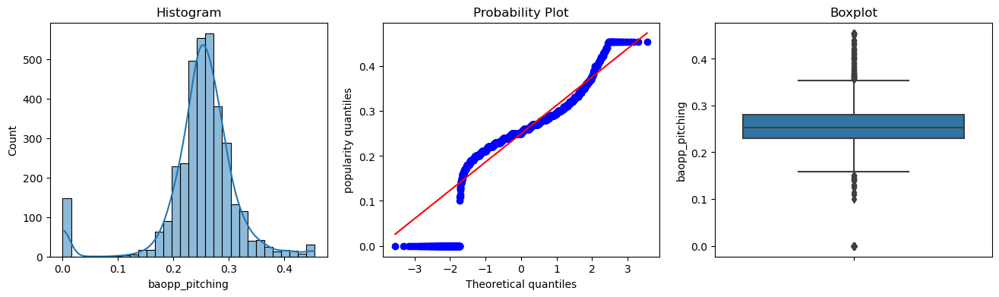




Generating diagnostic plots for column: era_pitching


c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


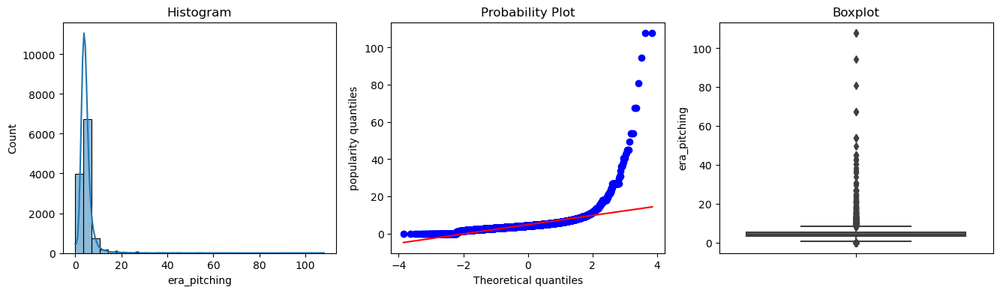

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


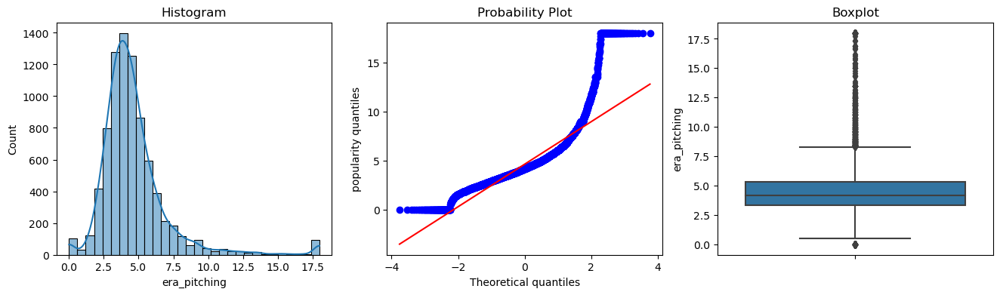

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


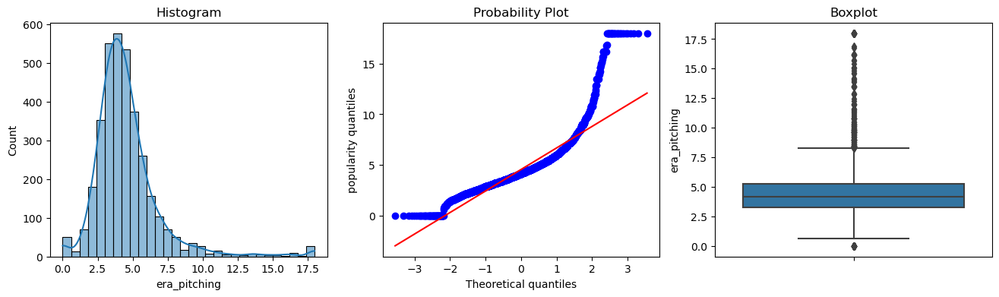

In [250]:
# print distribution after capping for capping_columns
for col in capping_columns:
    print(f"Generating diagnostic plots for column: {col}")
    diagnostic_plots(merged_data, col)
    diagnostic_plots(X_train, col)
    diagnostic_plots(X_test, col)
    print()
    print()
    print()

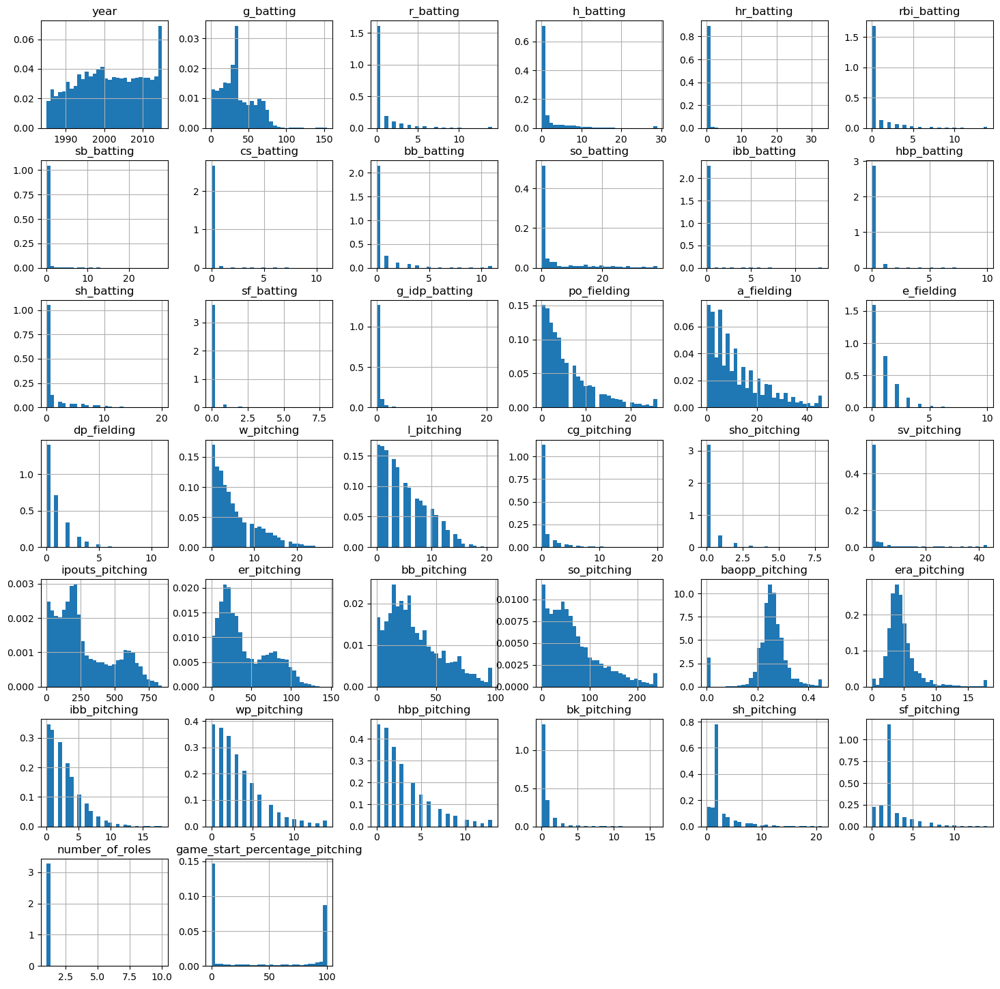

In [251]:
num_cols = [c for c in X_train.columns if X_train[c].dtypes!='O']
X_train[num_cols].hist(bins=30, figsize=(18,18), density=True)
plt.show()

In [252]:
# These columns were identified which could potentially make the distribution look more normal
cols_for_transforming = ['g_batting','er_pitching','bb_pitching','so_pitching','baopp_pitching','era_pitching',\
                         'po_fielding','l_pitching','wp_pitching','ipouts_pitching']                           

Generating diagnostic plots for column: g_batting


c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


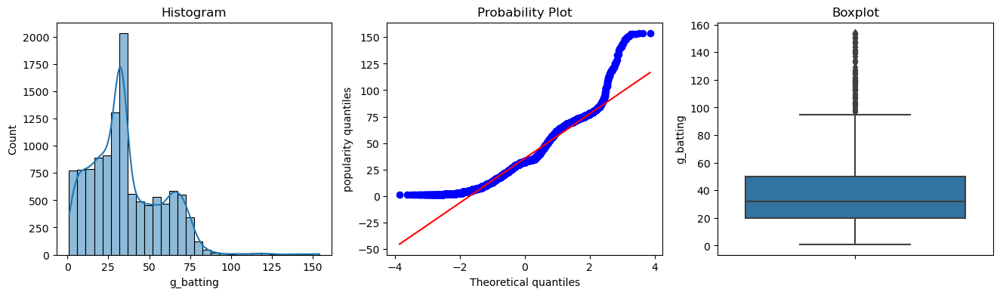

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


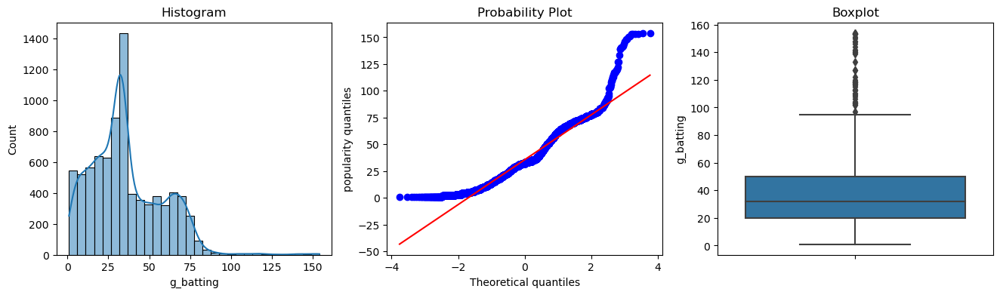

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


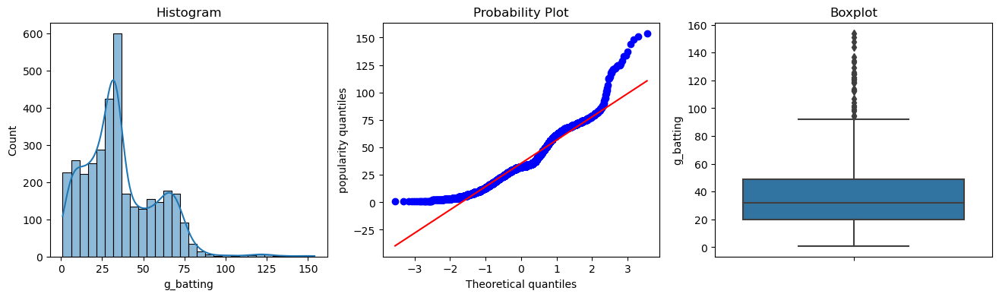




Generating diagnostic plots for column: er_pitching


c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


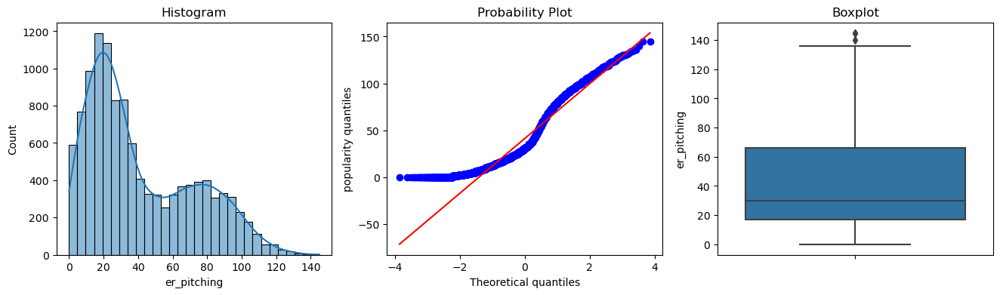

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


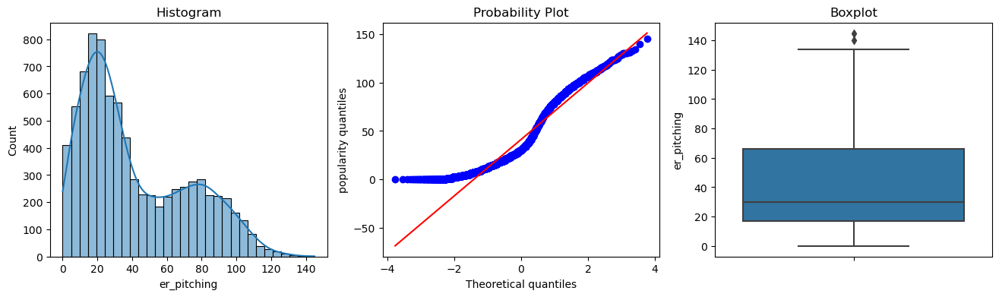

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


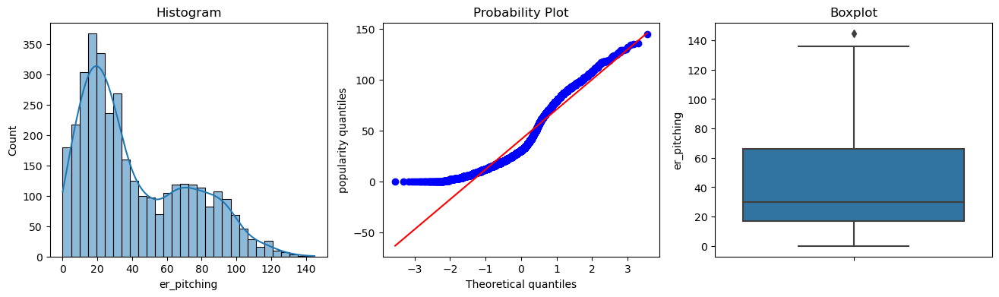




Generating diagnostic plots for column: bb_pitching


c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


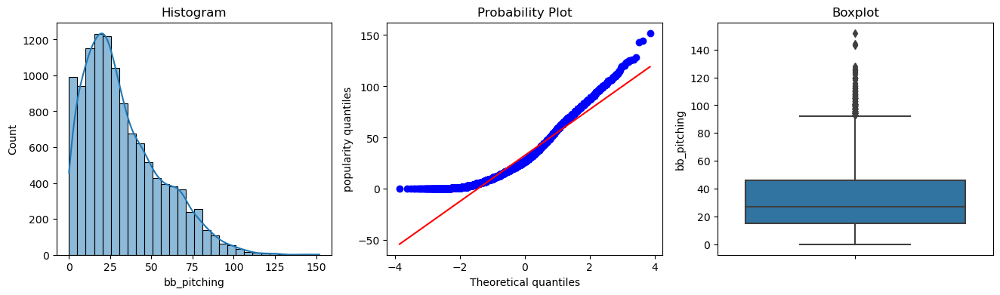

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


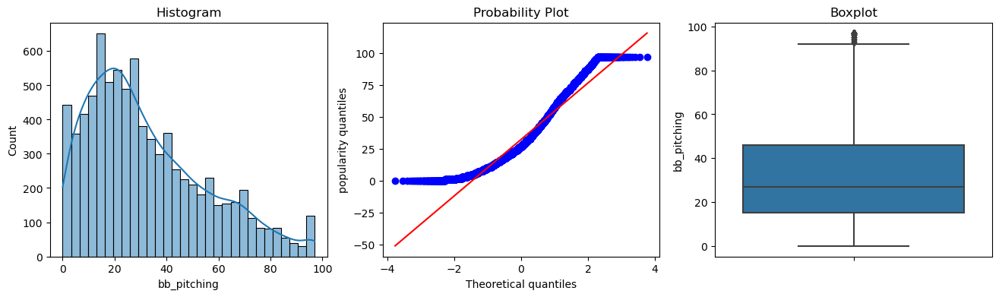

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


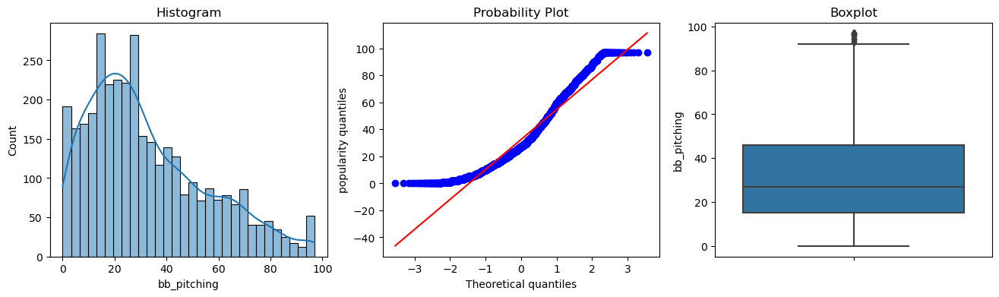




Generating diagnostic plots for column: so_pitching


c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


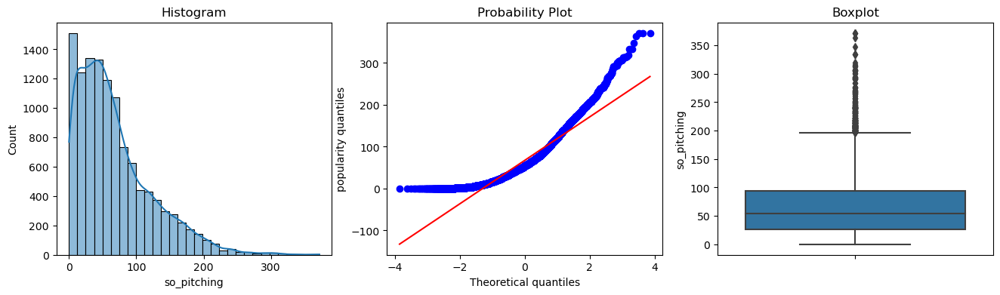

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


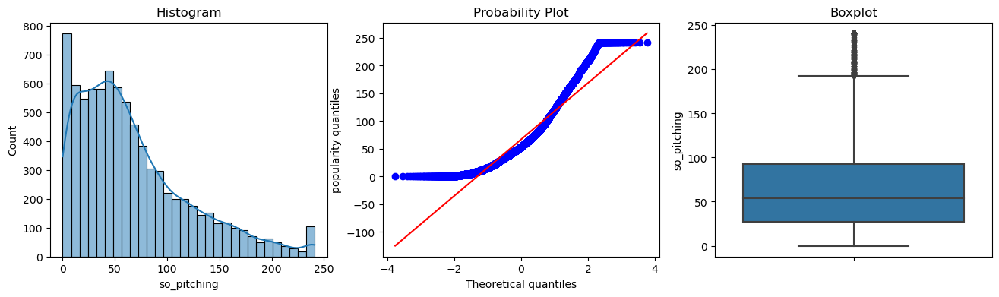

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


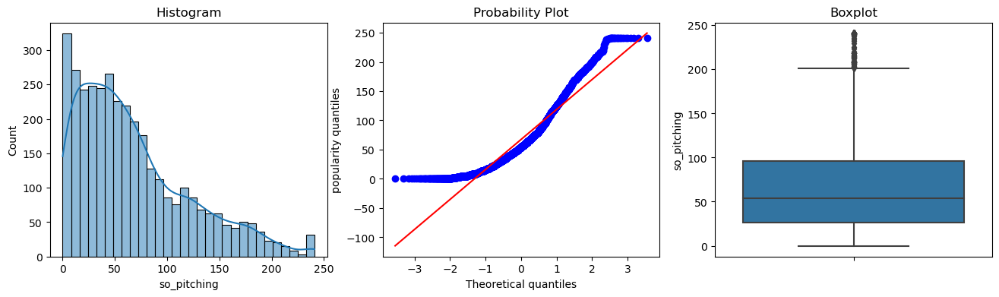




Generating diagnostic plots for column: baopp_pitching


c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


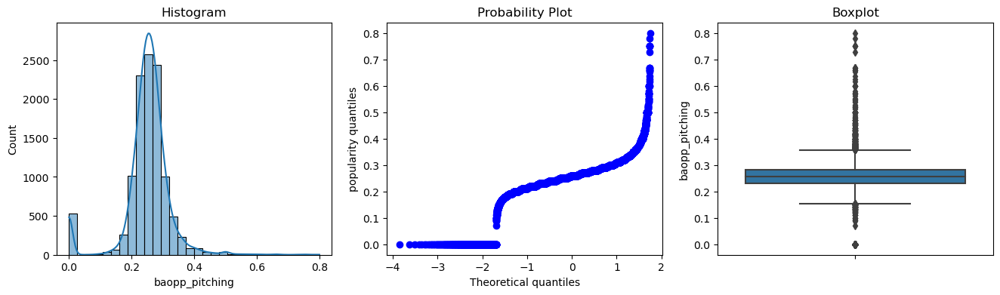

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


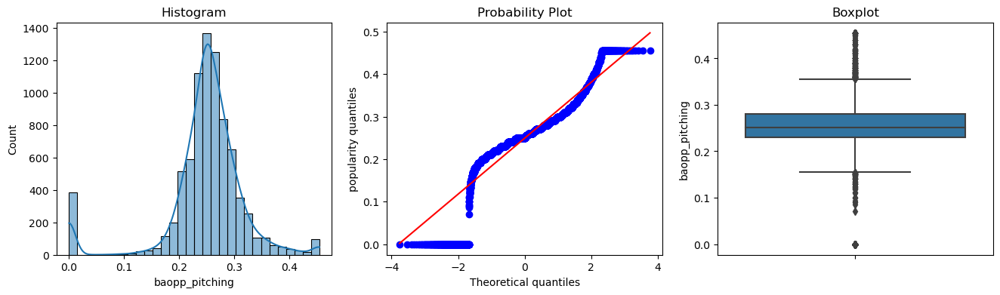

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


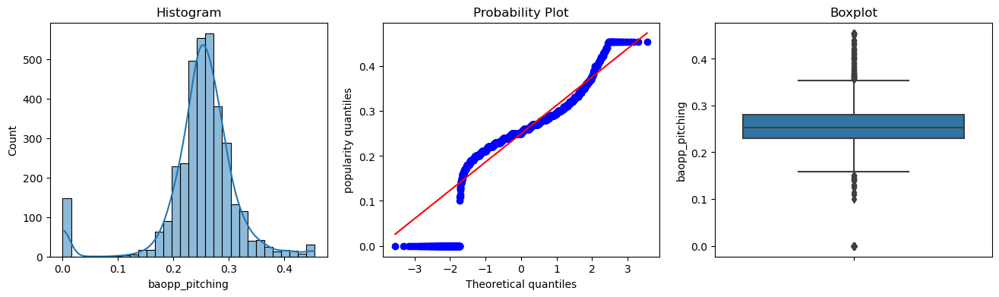




Generating diagnostic plots for column: era_pitching


c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


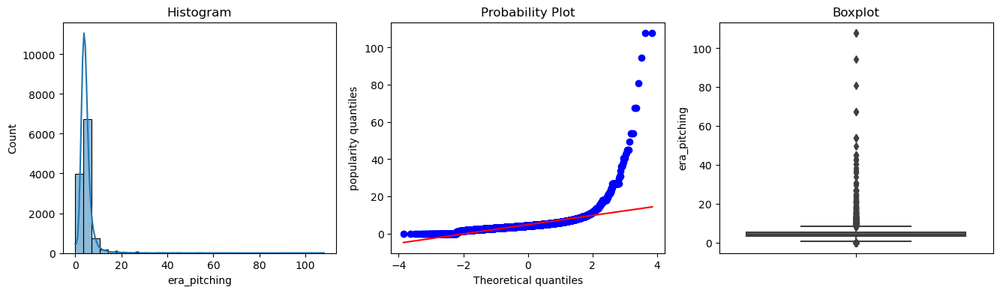

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


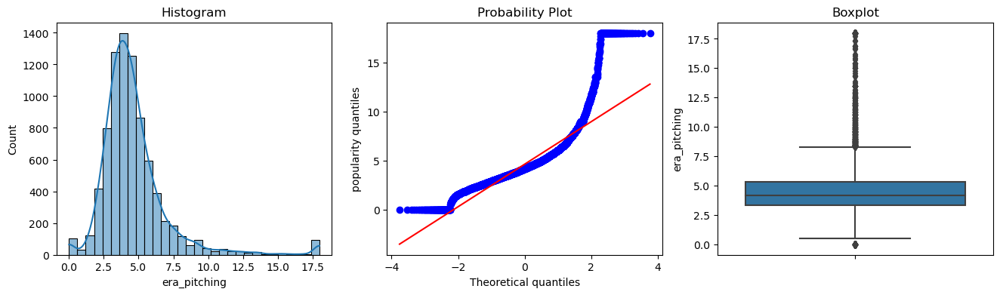

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


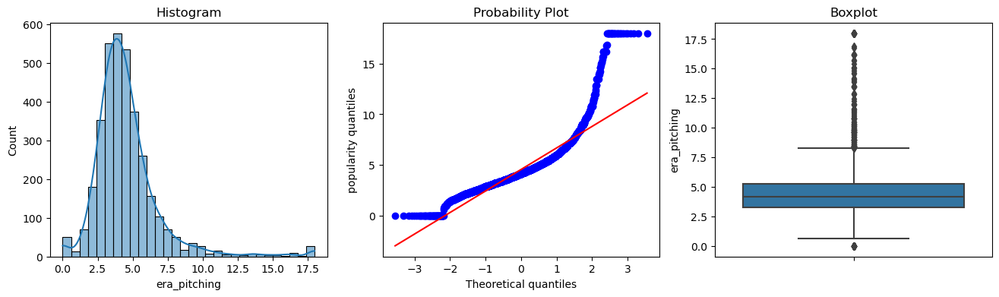




Generating diagnostic plots for column: po_fielding


c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


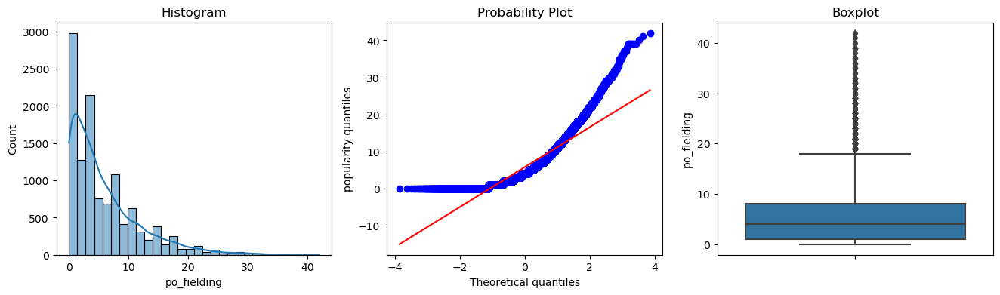

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


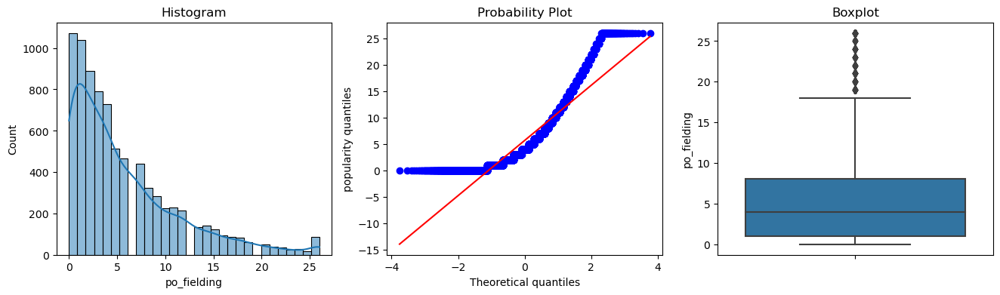

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


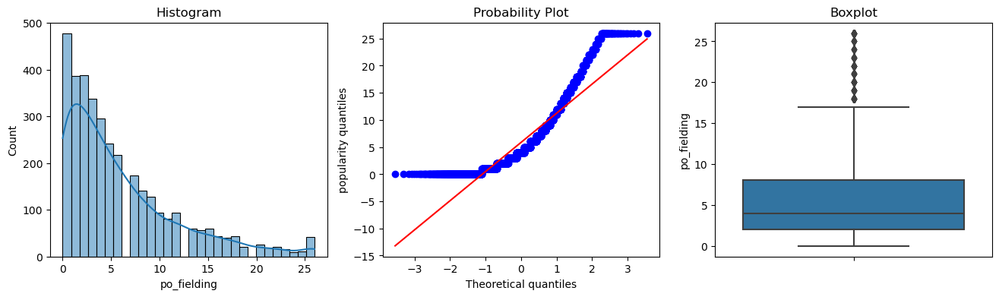




Generating diagnostic plots for column: l_pitching


c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


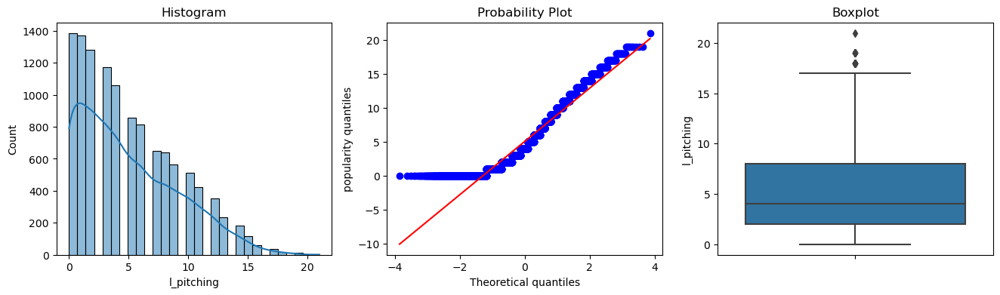

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


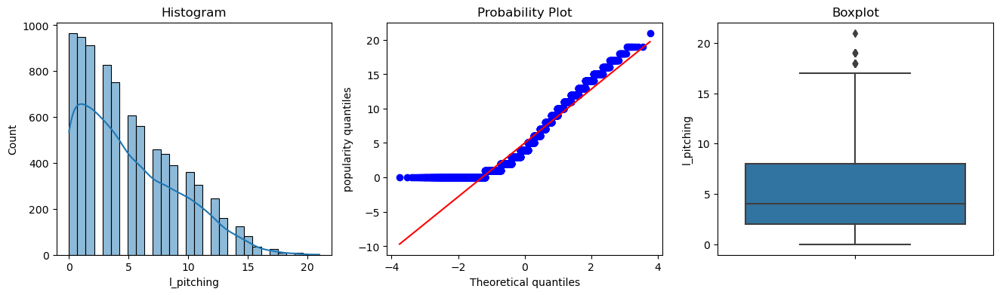

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


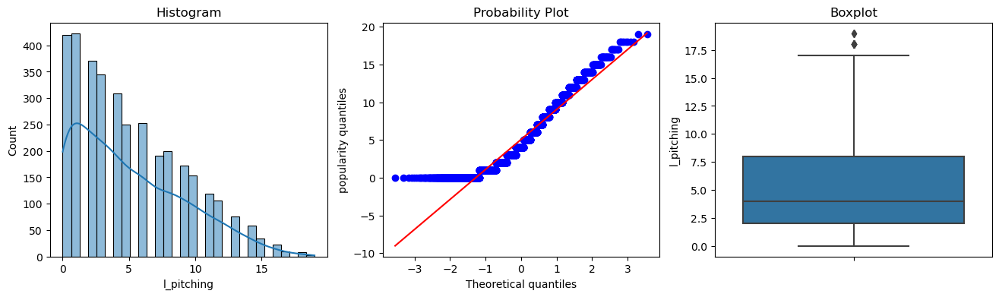




Generating diagnostic plots for column: wp_pitching


c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


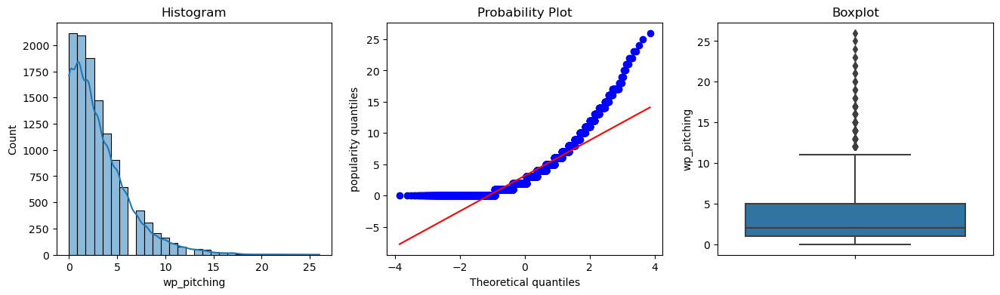

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


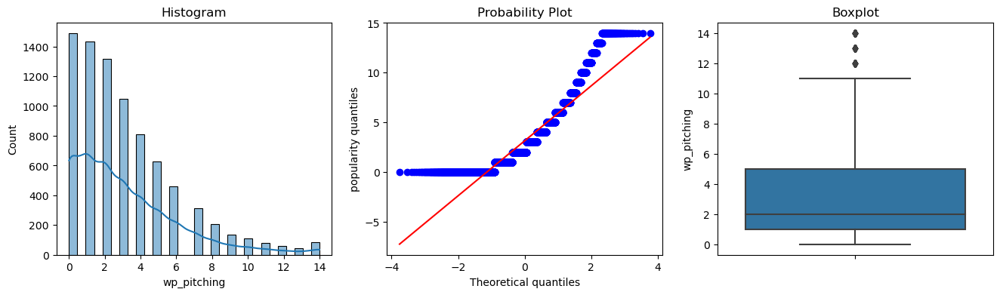

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


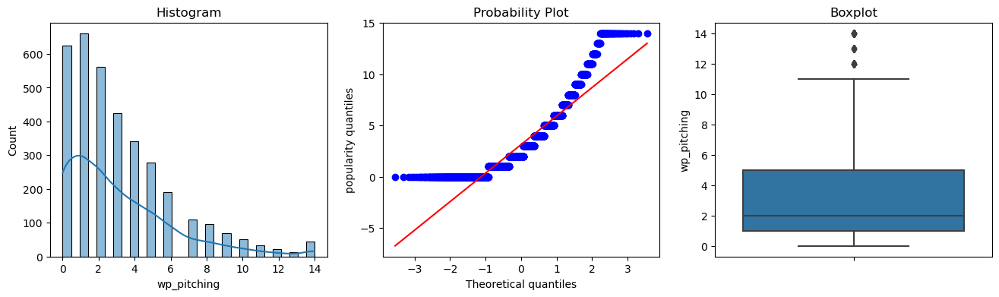




Generating diagnostic plots for column: ipouts_pitching


c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


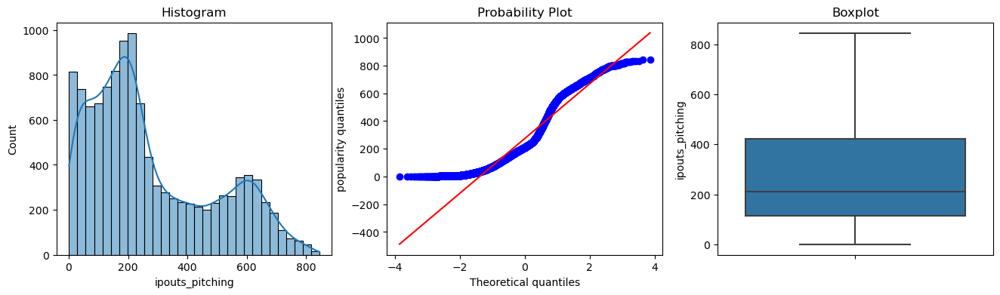

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


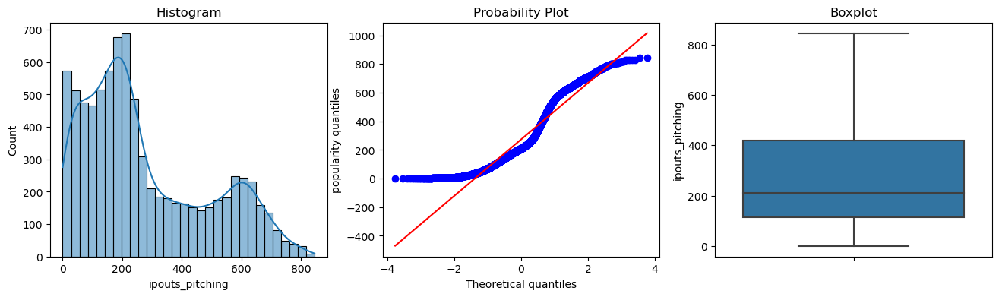

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


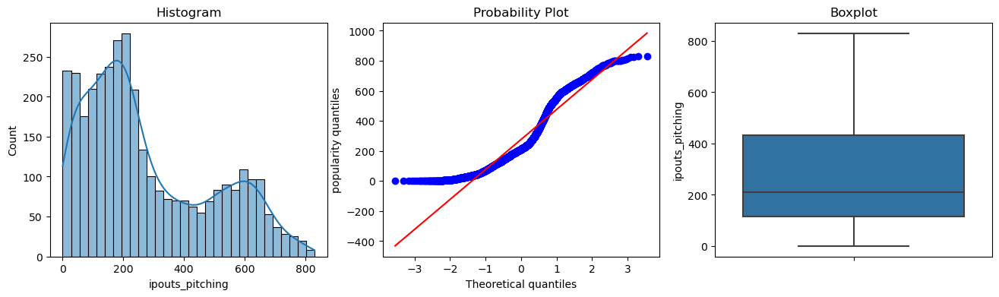

In [253]:
# print distribution for cols_for_transforming before YeoJohnson Transformation
for col in cols_for_transforming:
    print(f"Generating diagnostic plots for column: {col}")
    diagnostic_plots(merged_data, col)
    diagnostic_plots(X_train, col)
    diagnostic_plots(X_test, col)
    print()
    print()
    print()

In [254]:
yjt = YeoJohnsonTransformer(variables = cols_for_transforming)

yjt.fit(X_train)

YeoJohnsonTransformer(variables=['g_batting', 'er_pitching', 'bb_pitching',
                                 'so_pitching', 'baopp_pitching',
                                 'era_pitching', 'po_fielding', 'l_pitching',
                                 'wp_pitching', 'ipouts_pitching'])

In [255]:
X_train = yjt.transform(X_train)
X_test = yjt.transform(X_test)

In [256]:
yjt.lambda_dict_

{'g_batting': 0.5048797058687934,
 'er_pitching': 0.356914729683688,
 'bb_pitching': 0.4118517429817402,
 'so_pitching': 0.37780816416046203,
 'baopp_pitching': 4.6506749231405236,
 'era_pitching': 0.11690117478066336,
 'po_fielding': 0.09333280842109705,
 'l_pitching': 0.2984814450553774,
 'wp_pitching': 0.08479829556330327,
 'ipouts_pitching': 0.40586356667383783}

Generating diagnostic plots for column: g_batting


c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


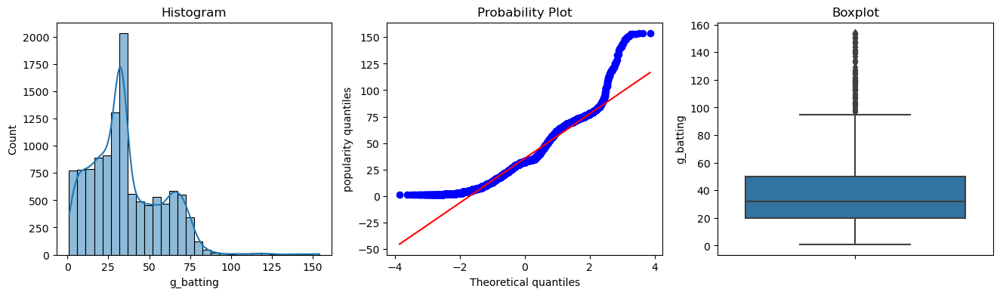

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


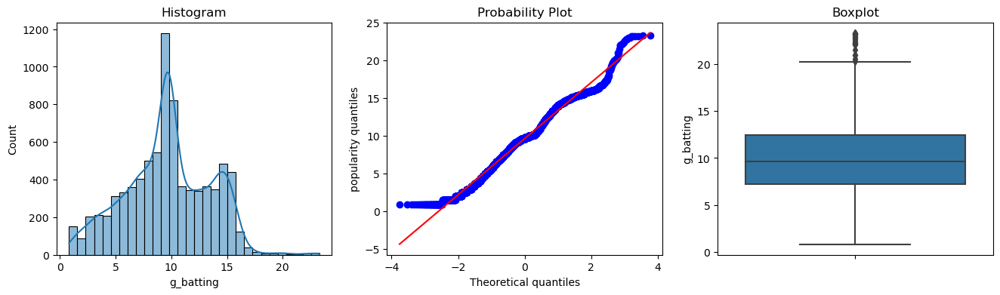

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


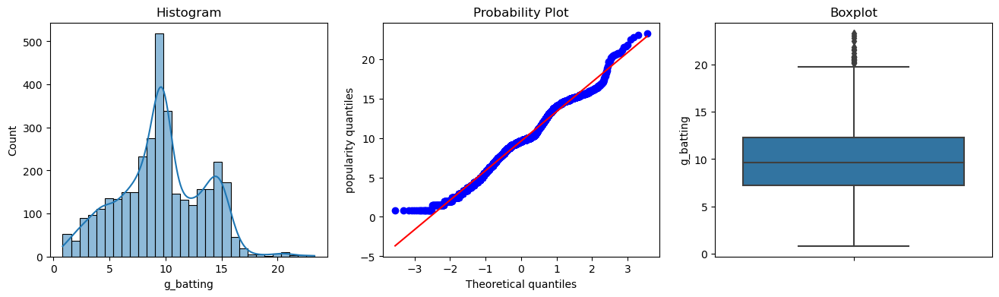




Generating diagnostic plots for column: er_pitching


c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


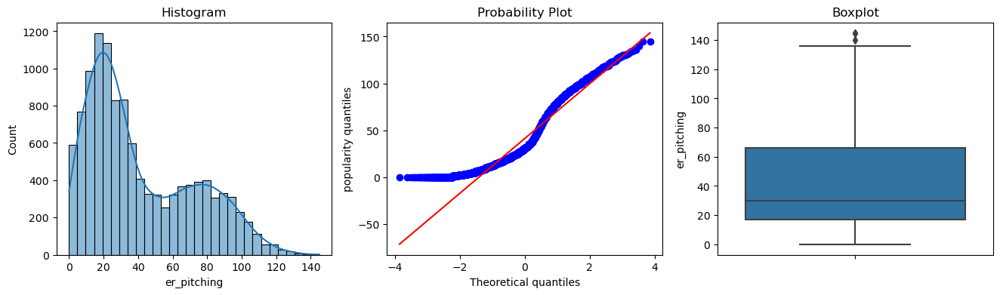

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


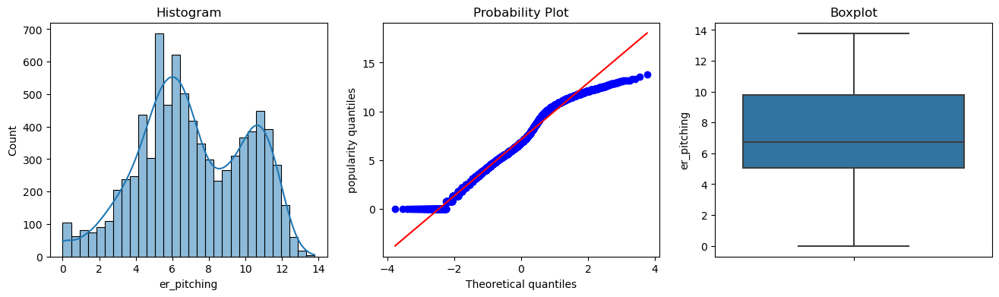

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


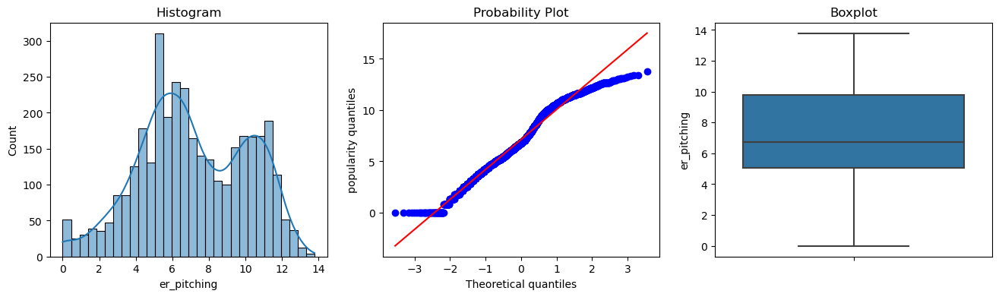




Generating diagnostic plots for column: bb_pitching


c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


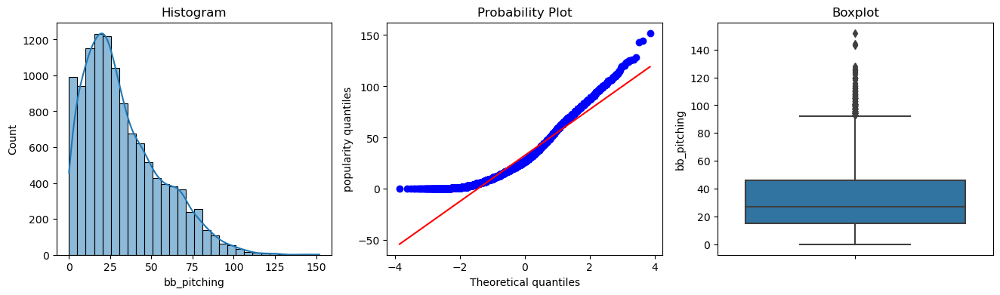

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


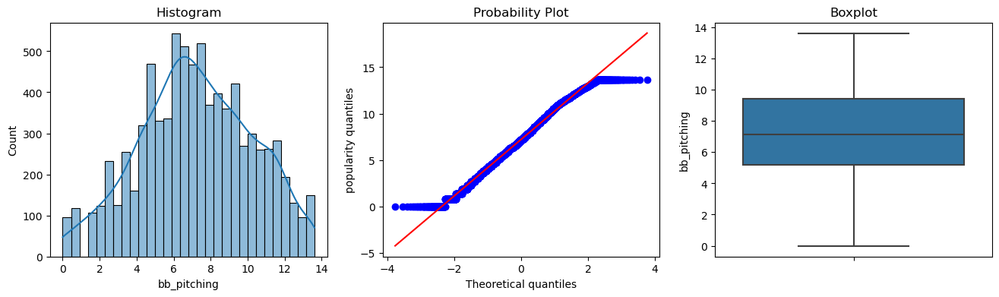

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


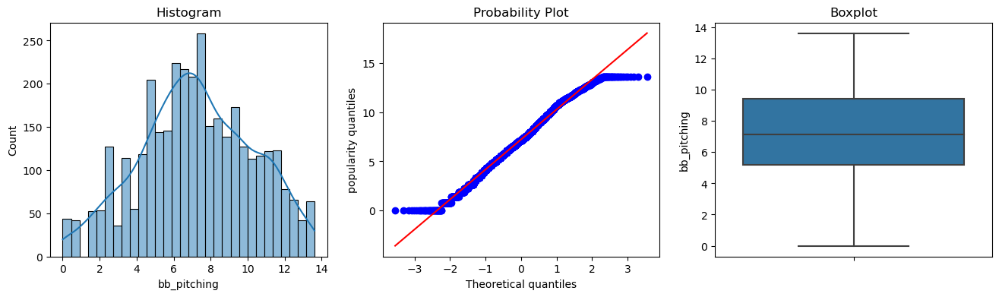




Generating diagnostic plots for column: so_pitching


c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


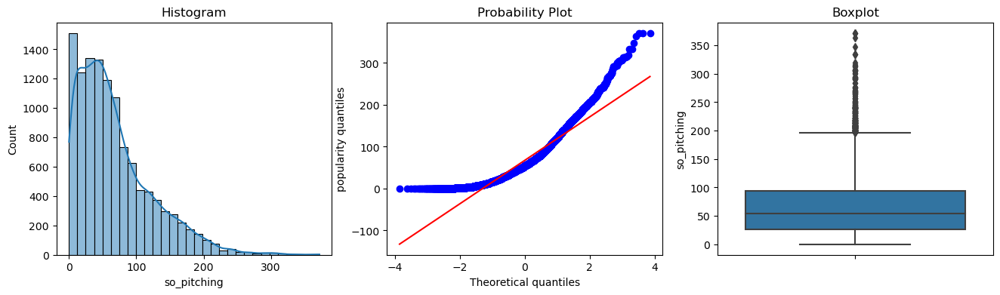

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


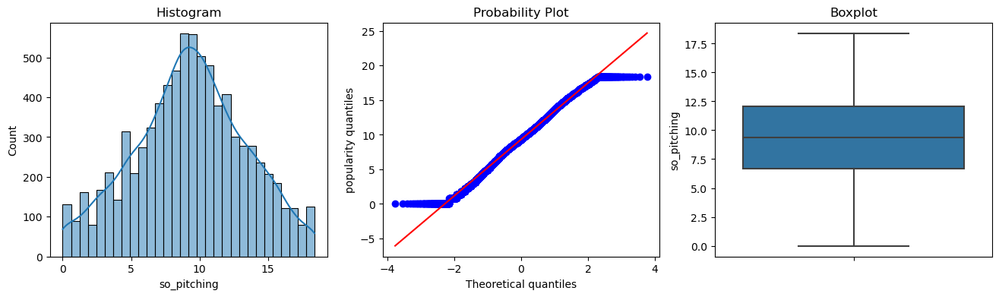

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


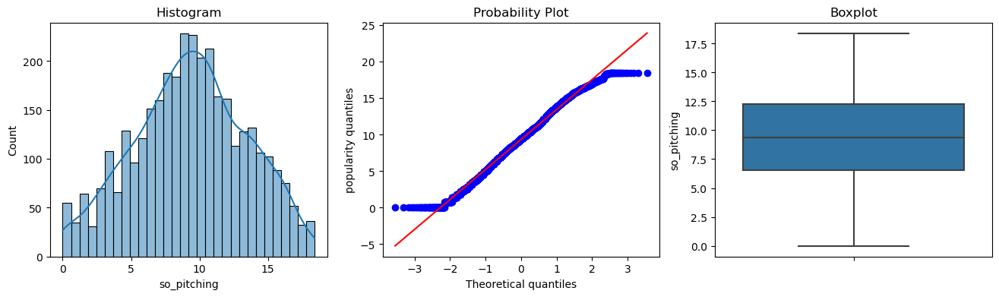




Generating diagnostic plots for column: baopp_pitching


c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


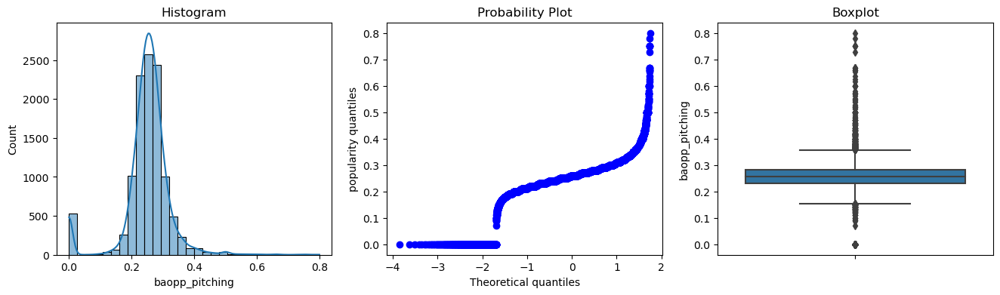

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


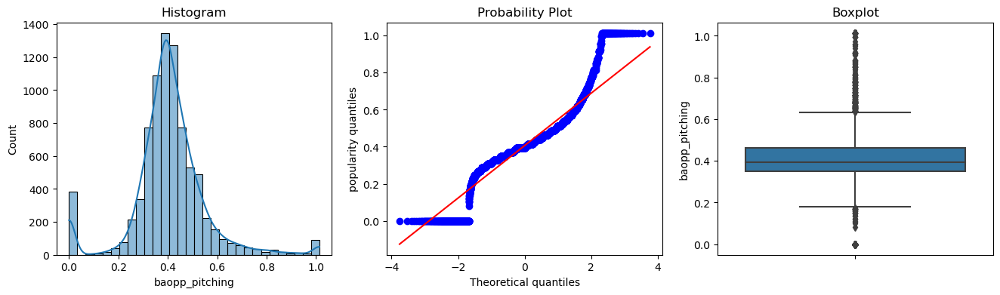

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


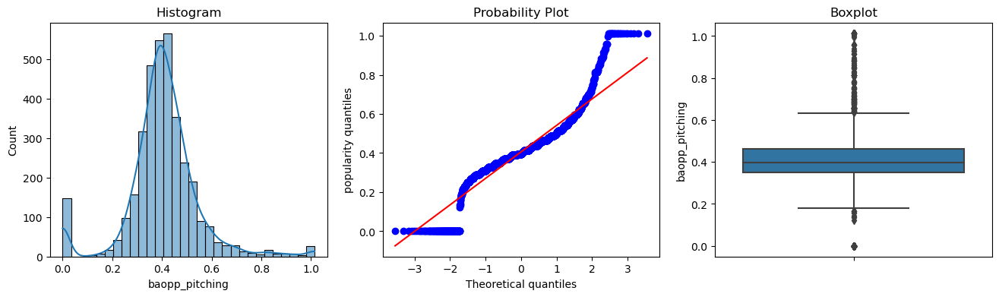




Generating diagnostic plots for column: era_pitching


c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


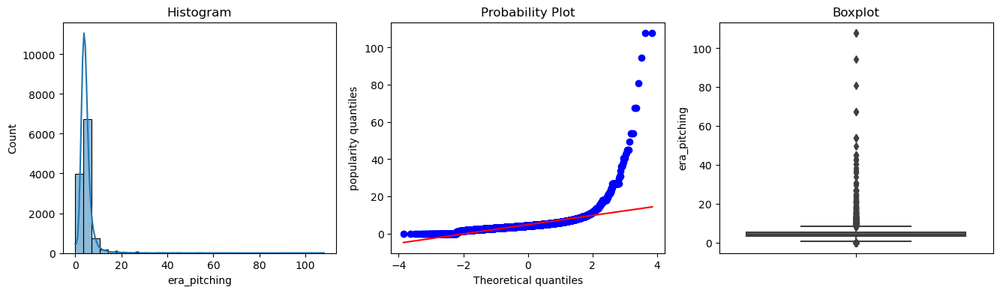

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


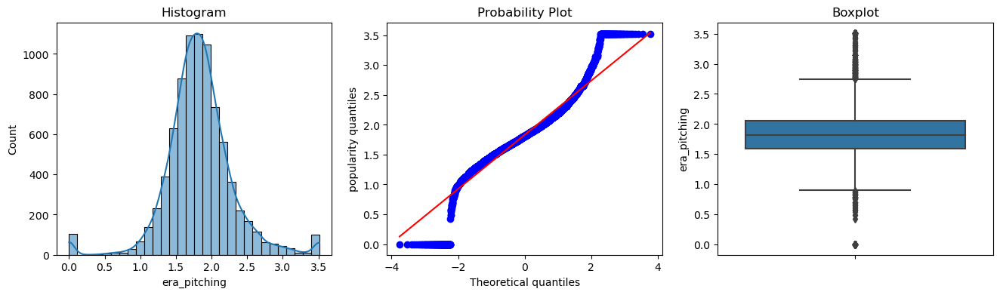

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


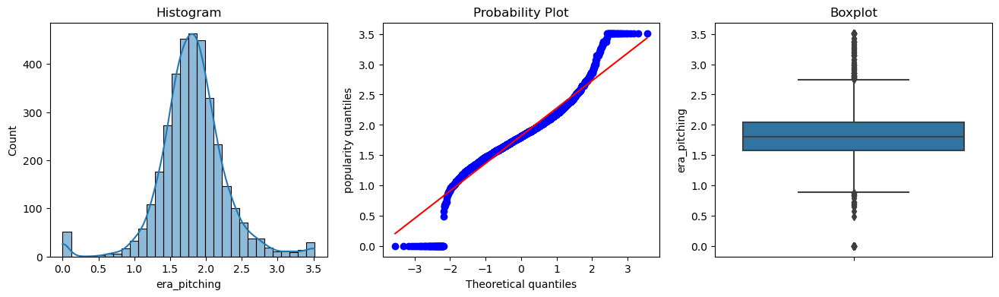




Generating diagnostic plots for column: po_fielding


c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


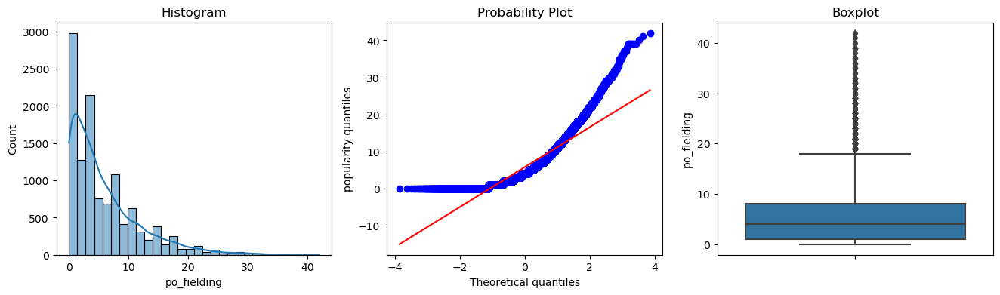

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


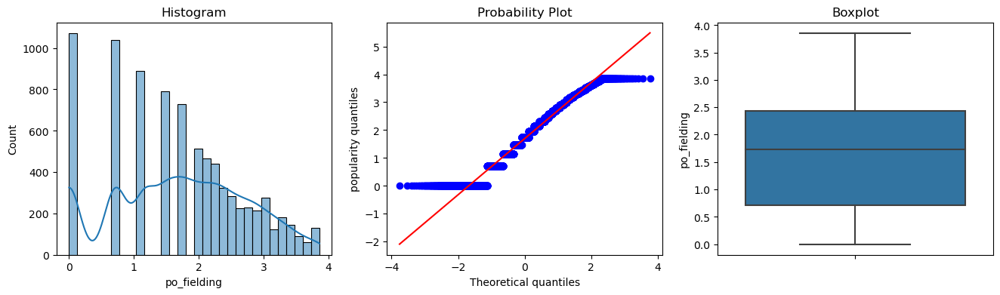

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


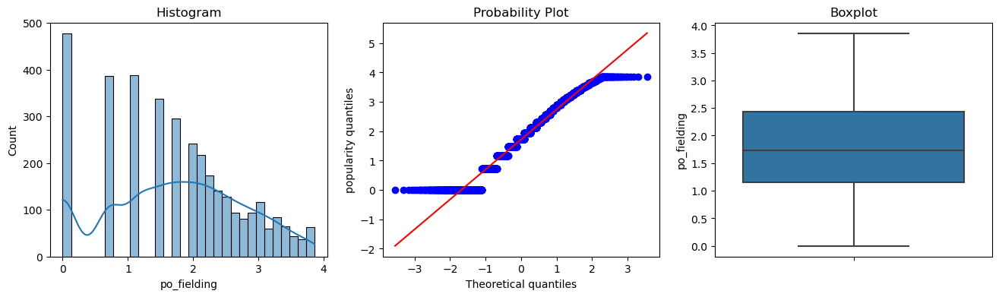




Generating diagnostic plots for column: l_pitching


c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


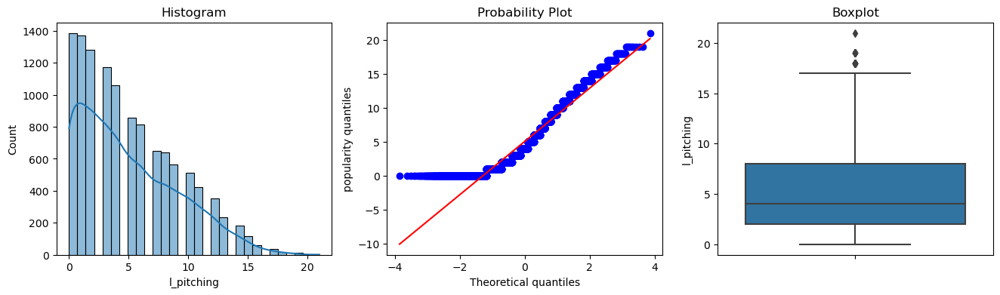

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


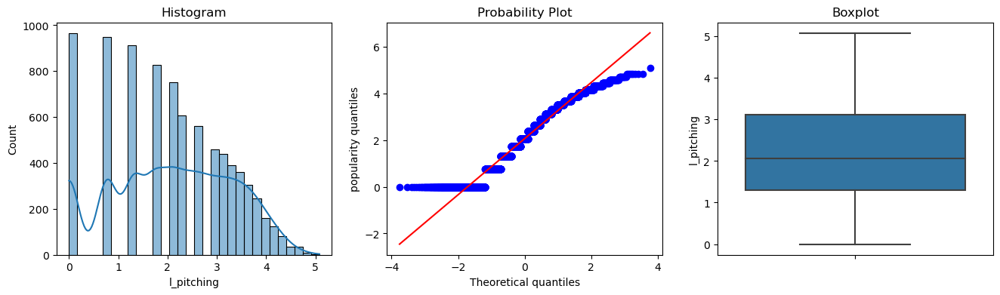

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


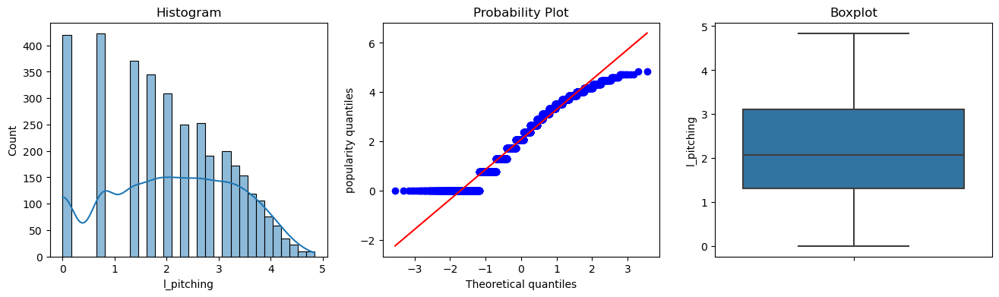




Generating diagnostic plots for column: wp_pitching


c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


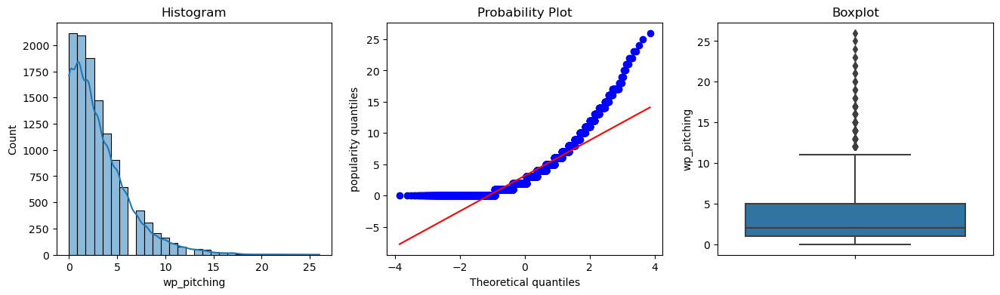

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


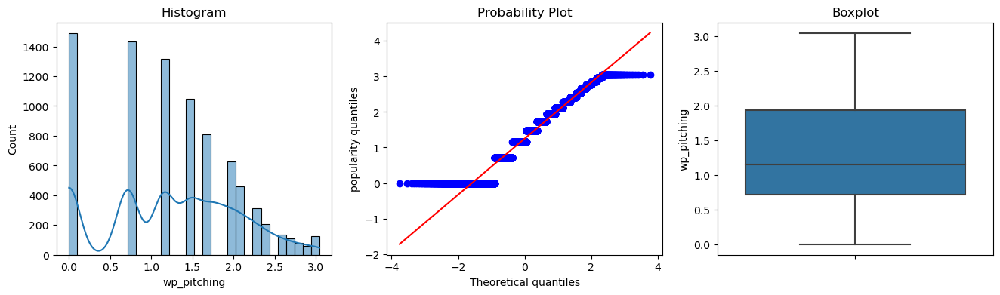

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


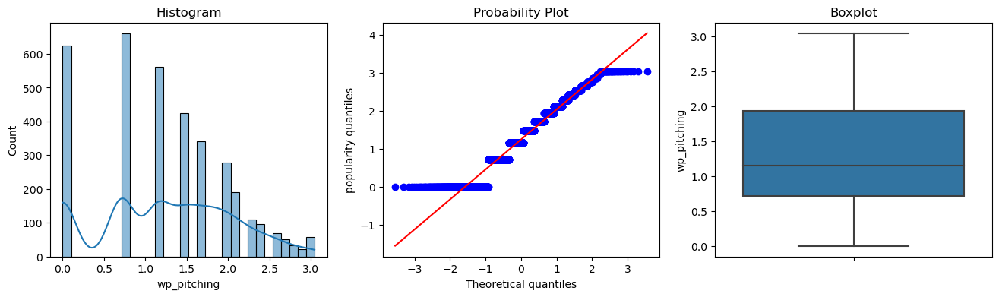




Generating diagnostic plots for column: ipouts_pitching


c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


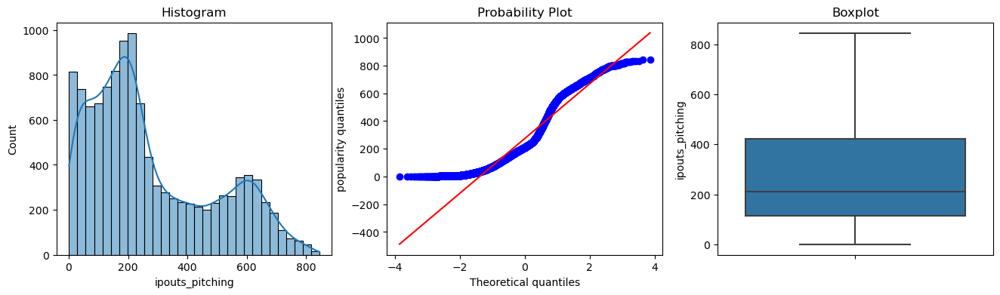

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


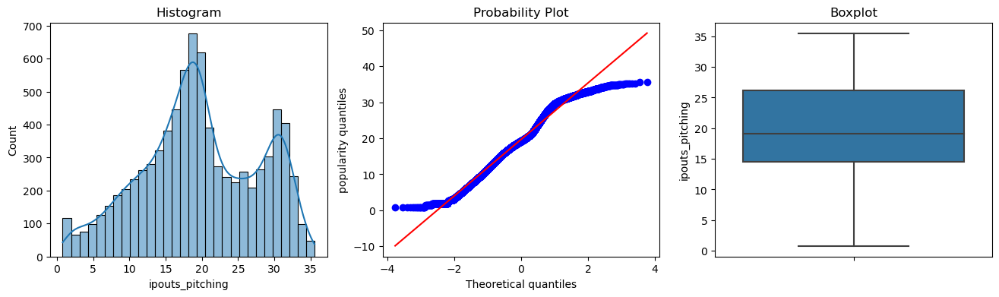

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


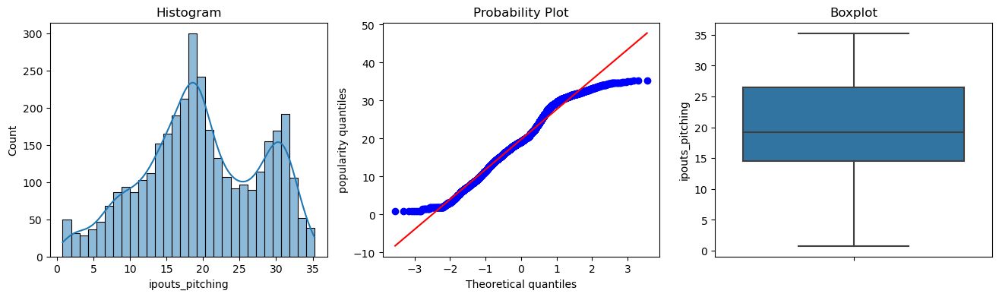

In [257]:
# plot diagnostic_plots for columns which have been transformed after Yeo-Johnson Transformation
for col in cols_for_transforming:
    print(f"Generating diagnostic plots for column: {col}")
    diagnostic_plots(merged_data, col)
    diagnostic_plots(X_train, col)
    diagnostic_plots(X_test, col)
    print()
    print()
    print()

###  Categorical Data Encoding

In [258]:
# find categorical columns
cat_cols = [c for c in merged_data.columns if merged_data[c].dtypes=='O']
print(cat_cols)

['team_id', 'league_id', 'award_id']


In [259]:
# print cardinality for team_id
X_train['team_id'].nunique()

35

In [260]:
X_train['team_id'].value_counts()/len(X_train)

team_id
BAL    0.038387
SLN    0.037777
PHI    0.037290
SDN    0.036924
BOS    0.036437
CLE    0.036071
OAK    0.035949
CHN    0.035706
NYA    0.035462
LAN    0.035218
DET    0.035096
KCA    0.034974
CHA    0.034853
TEX    0.034731
NYN    0.034609
CIN    0.034487
PIT    0.034487
SFN    0.033634
TOR    0.033512
SEA    0.033025
ATL    0.031806
MIN    0.030831
HOU    0.030587
COL    0.026444
FLO    0.022666
MON    0.021570
ARI    0.021448
MIL    0.020960
TBA    0.019985
ML4    0.014014
CAL    0.013770
WAS    0.012552
LAA    0.011942
ANA    0.008774
MIA    0.004021
Name: count, dtype: float64

In [261]:
X_test['team_id'].value_counts()/len(X_test)

team_id
ATL    0.042354
PIT    0.039227
BOS    0.038374
CLE    0.038374
NYN    0.037806
TOR    0.037237
LAN    0.036669
CIN    0.036100
CHN    0.035816
OAK    0.035816
TEX    0.035247
HOU    0.034963
NYA    0.034679
PHI    0.034110
SFN    0.033826
MIN    0.033826
SLN    0.032973
SDN    0.032973
KCA    0.032689
CHA    0.031268
DET    0.030131
SEA    0.028709
COL    0.027004
FLO    0.024730
BAL    0.024161
MON    0.022456
TBA    0.021035
ARI    0.020182
MIL    0.019898
ML4    0.015350
CAL    0.013076
LAA    0.013076
WAS    0.012507
ANA    0.009380
MIA    0.003980
Name: count, dtype: float64

In [262]:
# print cardinality for league_id
X_train['league_id'].nunique()

2

In [263]:
X_train['league_id'].value_counts()/len(X_train)

league_id
NL    0.509871
AL    0.490129
Name: count, dtype: float64

In [264]:
X_test['league_id'].value_counts()/len(X_test)

league_id
NL    0.524161
AL    0.475839
Name: count, dtype: float64

In [265]:
# print cardinality for award_id
X_train['award_id'].nunique()

16

In [266]:
# Different awards may have different salary thus I did not
# group rare categories for award_id despite having only 
# less than 1% of values for each unique award
X_train['award_id'].value_counts()/len(X_train)

award_id
No Award                       0.960273
TSN All-Star                   0.006702
Cy Young Award                 0.005362
Gold Glove                     0.004874
TSN Pitcher of the Year        0.004753
Rolaids Relief Man Award       0.004753
Silver Slugger                 0.002681
TSN Fireman of the Year        0.002559
TSN Reliever of the Year       0.001340
Babe Ruth Award                0.001340
Rookie of the Year             0.001219
ALCS MVP                       0.001219
NLCS MVP                       0.001097
Pitching Triple Crown          0.000975
Comeback Player of the Year    0.000609
Most Valuable Player           0.000244
Name: count, dtype: float64

In [267]:
X_test['award_id'].value_counts()/len(X_test)

award_id
No Award                       0.955372
TSN All-Star                   0.008812
Gold Glove                     0.005969
Cy Young Award                 0.005117
TSN Pitcher of the Year        0.005117
Rolaids Relief Man Award       0.004832
TSN Fireman of the Year        0.003695
TSN Reliever of the Year       0.002558
Silver Slugger                 0.002558
NLCS MVP                       0.001421
Rookie of the Year             0.001137
Comeback Player of the Year    0.001137
Babe Ruth Award                0.000853
ALCS MVP                       0.000569
Most Valuable Player           0.000569
Pitching Triple Crown          0.000284
Name: count, dtype: float64

In [268]:
def find_frequent_labels(df, variable, tolerance):
    
    temp = df[variable].value_counts()  / len(df)
    
    non_rare = [x for x in temp.loc[temp>tolerance].index.values]
    
    return non_rare

In [269]:
# identify non-rare categories for team_id
frequent_cat = find_frequent_labels(X_train, 'team_id', 0.01)

frequent_cat

['BAL',
 'SLN',
 'PHI',
 'SDN',
 'BOS',
 'CLE',
 'OAK',
 'CHN',
 'NYA',
 'LAN',
 'DET',
 'KCA',
 'CHA',
 'TEX',
 'NYN',
 'CIN',
 'PIT',
 'SFN',
 'TOR',
 'SEA',
 'ATL',
 'MIN',
 'HOU',
 'COL',
 'FLO',
 'MON',
 'ARI',
 'MIL',
 'TBA',
 'ML4',
 'CAL',
 'WAS',
 'LAA']

In [270]:
X_train['team_id'].value_counts() / len(X_train)

team_id
BAL    0.038387
SLN    0.037777
PHI    0.037290
SDN    0.036924
BOS    0.036437
CLE    0.036071
OAK    0.035949
CHN    0.035706
NYA    0.035462
LAN    0.035218
DET    0.035096
KCA    0.034974
CHA    0.034853
TEX    0.034731
NYN    0.034609
CIN    0.034487
PIT    0.034487
SFN    0.033634
TOR    0.033512
SEA    0.033025
ATL    0.031806
MIN    0.030831
HOU    0.030587
COL    0.026444
FLO    0.022666
MON    0.021570
ARI    0.021448
MIL    0.020960
TBA    0.019985
ML4    0.014014
CAL    0.013770
WAS    0.012552
LAA    0.011942
ANA    0.008774
MIA    0.004021
Name: count, dtype: float64

In [271]:
#identify rare categories for team_id
[x for x in X_train['team_id'].unique() if x not in frequent_cat]

['ANA', 'MIA']

In [272]:
#group rare categories for team_id
X_train['team_id'] = np.where(X_train['team_id'].isin(frequent_cat), X_train['team_id'], 'Rare')
    
X_test['team_id'] = np.where(X_test['team_id'].isin(frequent_cat), X_test['team_id'], 'Rare')

In [273]:
# show cardinality of team_id after grouping rare categories
X_train['team_id'].nunique()

34

In [274]:
X_train['team_id'].value_counts() / len(X_train)

team_id
BAL     0.038387
SLN     0.037777
PHI     0.037290
SDN     0.036924
BOS     0.036437
CLE     0.036071
OAK     0.035949
CHN     0.035706
NYA     0.035462
LAN     0.035218
DET     0.035096
KCA     0.034974
CHA     0.034853
TEX     0.034731
NYN     0.034609
CIN     0.034487
PIT     0.034487
SFN     0.033634
TOR     0.033512
SEA     0.033025
ATL     0.031806
MIN     0.030831
HOU     0.030587
COL     0.026444
FLO     0.022666
MON     0.021570
ARI     0.021448
MIL     0.020960
TBA     0.019985
ML4     0.014014
CAL     0.013770
Rare    0.012796
WAS     0.012552
LAA     0.011942
Name: count, dtype: float64

In [275]:
X_train.head()

,year,team_id,league_id,g_batting,r_batting,h_batting,hr_batting,rbi_batting,sb_batting,cs_batting,bb_batting,so_batting,ibb_batting,hbp_batting,sh_batting,sf_batting,g_idp_batting,po_fielding,a_fielding,e_fielding,dp_fielding,w_pitching,l_pitching,cg_pitching,sho_pitching,sv_pitching,ipouts_pitching,er_pitching,bb_pitching,so_pitching,baopp_pitching,era_pitching,ibb_pitching,wp_pitching,hbp_pitching,bk_pitching,sh_pitching,sf_pitching,award_id,selected_for_allstar,number_of_roles,game_start_percentage_pitching
11390,2013,PIT,NL,13.538887,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5.0,0.0,0.0,1.0,0.0,0.0,1.950290,10.0,0.0,0.0,6,0.770062,0,0,0,19.612053,5.058902,7.289346,9.784803,0.271631,1.202249,1.0,1.935042,3.0,0,3.0,1.0,No Award,False,1,0.0
9355,2008,TOR,AL,14.567890,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.687412,14.0,1.0,1.0,0,1.717122,0,0,5,19.244346,4.563669,7.149916,9.626590,0.312807,1.086065,7.0,1.471067,4.0,0,5.0,0.0,No Award,False,1,0.0
3702,1995,LAN,NL,10.447660,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.479975,3.0,1.0,0.0,1,1.717122,0,0,3,13.827091,6.282905,5.736186,6.920625,0.438471,2.313564,3.0,0.000000,1.0,0,2.0,2.0,No Award,False,1,0.0
7150,2003,KCA,AL,4.025392,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.156912,7.0,1.0,1.0,2,0.770062,1,0,0,16.159215,6.517588,6.244320,6.674460,0.500485,2.035730,0.0,0.713923,3.0,0,3.0,5.0,No Award,False,1,100.0
790,1987,PHI,NL,10.112987,2.0,5.0,0.0,4.0,0.0,1.0,2.0,23.0,0.0,0.0,10.0,0.0,2.0,2.294944,21.0,0.0,0.0,13,3.683641,3,2,0,31.333719,11.694771,11.540962,13.806938,0.369711,1.822905,7.0,1.471067,5.0,1,2.0,2.0,No Award,False,1,100.0


In [276]:
X_test.head()

,year,team_id,league_id,g_batting,r_batting,h_batting,hr_batting,rbi_batting,sb_batting,cs_batting,bb_batting,so_batting,ibb_batting,hbp_batting,sh_batting,sf_batting,g_idp_batting,po_fielding,a_fielding,e_fielding,dp_fielding,w_pitching,l_pitching,cg_pitching,sho_pitching,sv_pitching,ipouts_pitching,er_pitching,bb_pitching,so_pitching,baopp_pitching,era_pitching,ibb_pitching,wp_pitching,hbp_pitching,bk_pitching,sh_pitching,sf_pitching,award_id,selected_for_allstar,number_of_roles,game_start_percentage_pitching
9763,2009,TEX,AL,4.964275,1.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.479975,13.0,0.0,2.0,4,2.369054,2,1,0,18.304768,8.012749,6.560737,7.494373,0.556066,2.204612,0.0,0.000000,2.0,0,1.0,1.0,No Award,False,1,100.000000
312,1986,CIN,NL,15.059537,1.0,1.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,0.0,0.0,0.0,1.0,2.438744,20.0,0.0,2.0,10,1.717122,0,0,14,24.122997,7.924376,9.109607,13.404173,0.391967,1.573702,8.0,1.471067,2.0,0,2.0,2.0,No Award,False,1,0.000000
8739,2007,LAN,NL,2.483162,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,1.0,0.0,0,0.000000,0,0,0,2.634627,1.793571,1.869468,2.561749,0.603496,3.375091,1.0,0.000000,0.0,0,0.0,0.0,No Award,False,1,0.000000
2432,1992,KCA,AL,9.049460,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,2.898005,13.0,1.0,1.0,1,2.066127,0,0,3,21.110823,8.436272,8.433590,8.779709,0.414882,1.989111,3.0,1.151413,8.0,0,2.0,2.0,No Award,False,1,27.586207
8868,2007,SEA,AL,6.049927,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.716060,6.0,0.0,0.0,1,0.770062,0,0,0,13.952327,5.777597,6.079745,5.072888,0.417210,2.111402,0.0,1.935042,8.0,1,0.0,3.0,No Award,False,1,0.000000


### Categorical Data Encoding

In [277]:
# show shape before any form of categorical encoding
X_train.shape

(8206, 42)

In [278]:
# apply target-mean encoding to team_id (high cardinaility-34) and league_id
mean_enc = MeanEncoder(variables=['team_id','league_id'])

In [279]:
mean_enc.fit(X_train, y_train)

MeanEncoder(variables=['team_id', 'league_id'])

In [280]:
mean_enc.variables

['team_id', 'league_id']

In [281]:
mean_enc.encoder_dict_

{'team_id': {'ARI': 2332027.903409091,
  'ATL': 2230199.946360153,
  'BAL': 1422512.2603174604,
  'BOS': 2271212.1739130435,
  'CAL': 840692.7345132744,
  'CHA': 1630223.7517482517,
  'CHN': 2017896.8839590445,
  'CIN': 1416136.038869258,
  'CLE': 1386062.1317567567,
  'COL': 1505332.7235023042,
  'DET': 1724763.8645833333,
  'FLO': 1026675.8494623656,
  'HOU': 1420555.952191235,
  'KCA': 1447768.8292682928,
  'LAA': 3441446.2551020407,
  'LAN': 2180289.6124567473,
  'MIL': 2145126.9360465114,
  'MIN': 1562901.8181818181,
  'ML4': 487770.2956521739,
  'MON': 676461.011299435,
  'NYA': 2559789.079037801,
  'NYN': 2111074.3626760566,
  'OAK': 1103627.9966101695,
  'PHI': 1935396.0424836602,
  'PIT': 973189.7314487633,
  'Rare': 1914532.3714285714,
  'SDN': 1347944.7821782178,
  'SEA': 1838194.1439114392,
  'SFN': 2050919.5942028984,
  'SLN': 1748221.0967741935,
  'TBA': 1224826.213414634,
  'TEX': 1661461.694736842,
  'TOR': 1579603.7345454546,
  'WAS': 2046645.4466019417},
 'league_id':

In [282]:
X_train_enc = mean_enc.transform(X_train)
X_test_enc = mean_enc.transform(X_test)

In [283]:
X_train_enc.head()

,year,team_id,league_id,g_batting,r_batting,h_batting,hr_batting,rbi_batting,sb_batting,cs_batting,bb_batting,so_batting,ibb_batting,hbp_batting,sh_batting,sf_batting,g_idp_batting,po_fielding,a_fielding,e_fielding,dp_fielding,w_pitching,l_pitching,cg_pitching,sho_pitching,sv_pitching,ipouts_pitching,er_pitching,bb_pitching,so_pitching,baopp_pitching,era_pitching,ibb_pitching,wp_pitching,hbp_pitching,bk_pitching,sh_pitching,sf_pitching,award_id,selected_for_allstar,number_of_roles,game_start_percentage_pitching
11390,2013,9.731897e+05,1.724570e+06,13.538887,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5.0,0.0,0.0,1.0,0.0,0.0,1.950290,10.0,0.0,0.0,6,0.770062,0,0,0,19.612053,5.058902,7.289346,9.784803,0.271631,1.202249,1.0,1.935042,3.0,0,3.0,1.0,No Award,False,1,0.0
9355,2008,1.579604e+06,1.649544e+06,14.567890,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.687412,14.0,1.0,1.0,0,1.717122,0,0,5,19.244346,4.563669,7.149916,9.626590,0.312807,1.086065,7.0,1.471067,4.0,0,5.0,0.0,No Award,False,1,0.0
3702,1995,2.180290e+06,1.724570e+06,10.447660,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.479975,3.0,1.0,0.0,1,1.717122,0,0,3,13.827091,6.282905,5.736186,6.920625,0.438471,2.313564,3.0,0.000000,1.0,0,2.0,2.0,No Award,False,1,0.0
7150,2003,1.447769e+06,1.649544e+06,4.025392,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.156912,7.0,1.0,1.0,2,0.770062,1,0,0,16.159215,6.517588,6.244320,6.674460,0.500485,2.035730,0.0,0.713923,3.0,0,3.0,5.0,No Award,False,1,100.0
790,1987,1.935396e+06,1.724570e+06,10.112987,2.0,5.0,0.0,4.0,0.0,1.0,2.0,23.0,0.0,0.0,10.0,0.0,2.0,2.294944,21.0,0.0,0.0,13,3.683641,3,2,0,31.333719,11.694771,11.540962,13.806938,0.369711,1.822905,7.0,1.471067,5.0,1,2.0,2.0,No Award,False,1,100.0


In [284]:
X_test_enc.head()

,year,team_id,league_id,g_batting,r_batting,h_batting,hr_batting,rbi_batting,sb_batting,cs_batting,bb_batting,so_batting,ibb_batting,hbp_batting,sh_batting,sf_batting,g_idp_batting,po_fielding,a_fielding,e_fielding,dp_fielding,w_pitching,l_pitching,cg_pitching,sho_pitching,sv_pitching,ipouts_pitching,er_pitching,bb_pitching,so_pitching,baopp_pitching,era_pitching,ibb_pitching,wp_pitching,hbp_pitching,bk_pitching,sh_pitching,sf_pitching,award_id,selected_for_allstar,number_of_roles,game_start_percentage_pitching
9763,2009,1.661462e+06,1.649544e+06,4.964275,1.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.479975,13.0,0.0,2.0,4,2.369054,2,1,0,18.304768,8.012749,6.560737,7.494373,0.556066,2.204612,0.0,0.000000,2.0,0,1.0,1.0,No Award,False,1,100.000000
312,1986,1.416136e+06,1.724570e+06,15.059537,1.0,1.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,0.0,0.0,0.0,1.0,2.438744,20.0,0.0,2.0,10,1.717122,0,0,14,24.122997,7.924376,9.109607,13.404173,0.391967,1.573702,8.0,1.471067,2.0,0,2.0,2.0,No Award,False,1,0.000000
8739,2007,2.180290e+06,1.724570e+06,2.483162,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,1.0,0.0,0,0.000000,0,0,0,2.634627,1.793571,1.869468,2.561749,0.603496,3.375091,1.0,0.000000,0.0,0,0.0,0.0,No Award,False,1,0.000000
2432,1992,1.447769e+06,1.649544e+06,9.049460,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,2.898005,13.0,1.0,1.0,1,2.066127,0,0,3,21.110823,8.436272,8.433590,8.779709,0.414882,1.989111,3.0,1.151413,8.0,0,2.0,2.0,No Award,False,1,27.586207
8868,2007,1.838194e+06,1.649544e+06,6.049927,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.716060,6.0,0.0,0.0,1,0.770062,0,0,0,13.952327,5.777597,6.079745,5.072888,0.417210,2.111402,0.0,1.935042,8.0,1,0.0,3.0,No Award,False,1,0.000000


In [285]:
ohe_enc = OneHotEncoder(
    top_categories=None,
    drop_last=True)  # to return k-1, false to return k

ohe_enc.fit(X_train_enc)

ohe_enc.variables

In [286]:
X_train_ohe = ohe_enc.transform(X_train_enc)
X_test_ohe = ohe_enc.transform(X_test_enc)

X_train_ohe.head()

,year,team_id,league_id,g_batting,r_batting,h_batting,hr_batting,rbi_batting,sb_batting,cs_batting,bb_batting,so_batting,ibb_batting,hbp_batting,sh_batting,sf_batting,g_idp_batting,po_fielding,a_fielding,e_fielding,dp_fielding,w_pitching,l_pitching,cg_pitching,sho_pitching,sv_pitching,ipouts_pitching,er_pitching,bb_pitching,so_pitching,baopp_pitching,era_pitching,ibb_pitching,wp_pitching,hbp_pitching,bk_pitching,sh_pitching,sf_pitching,selected_for_allstar,number_of_roles,game_start_percentage_pitching,award_id_No Award,award_id_TSN All-Star,award_id_Gold Glove,award_id_TSN Fireman of the Year,award_id_NLCS MVP,award_id_Comeback Player of the Year,award_id_TSN Pitcher of the Year,award_id_Cy Young Award,award_id_Silver Slugger,award_id_Rookie of the Year,award_id_Pitching Triple Crown,award_id_Rolaids Relief Man Award,award_id_TSN Reliever of the Year,award_id_ALCS MVP,award_id_Most Valuable Player
11390,2013,9.731897e+05,1.724570e+06,13.538887,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5.0,0.0,0.0,1.0,0.0,0.0,1.950290,10.0,0.0,0.0,6,0.770062,0,0,0,19.612053,5.058902,7.289346,9.784803,0.271631,1.202249,1.0,1.935042,3.0,0,3.0,1.0,False,1,0.0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
9355,2008,1.579604e+06,1.649544e+06,14.567890,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.687412,14.0,1.0,1.0,0,1.717122,0,0,5,19.244346,4.563669,7.149916,9.626590,0.312807,1.086065,7.0,1.471067,4.0,0,5.0,0.0,False,1,0.0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3702,1995,2.180290e+06,1.724570e+06,10.447660,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.479975,3.0,1.0,0.0,1,1.717122,0,0,3,13.827091,6.282905,5.736186,6.920625,0.438471,2.313564,3.0,0.000000,1.0,0,2.0,2.0,False,1,0.0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
7150,2003,1.447769e+06,1.649544e+06,4.025392,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.156912,7.0,1.0,1.0,2,0.770062,1,0,0,16.159215,6.517588,6.244320,6.674460,0.500485,2.035730,0.0,0.713923,3.0,0,3.0,5.0,False,1,100.0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
790,1987,1.935396e+06,1.724570e+06,10.112987,2.0,5.0,0.0,4.0,0.0,1.0,2.0,23.0,0.0,0.0,10.0,0.0,2.0,2.294944,21.0,0.0,0.0,13,3.683641,3,2,0,31.333719,11.694771,11.540962,13.806938,0.369711,1.822905,7.0,1.471067,5.0,1,2.0,2.0,False,1,100.0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [287]:
X_train_ohe.isnull().sum()

year                                    0
team_id                                 0
league_id                               0
g_batting                               0
r_batting                               0
h_batting                               0
hr_batting                              0
rbi_batting                             0
sb_batting                              0
cs_batting                              0
bb_batting                              0
so_batting                              0
ibb_batting                             0
hbp_batting                             0
sh_batting                              0
sf_batting                              0
g_idp_batting                           0
po_fielding                             0
a_fielding                              0
e_fielding                              0
dp_fielding                             0
w_pitching                              0
l_pitching                              0
cg_pitching                       

In [288]:
X_train_ohe.shape

(8206, 56)

In [289]:
X_test_ohe.isnull().sum()

year                                    0
team_id                                 0
league_id                               0
g_batting                               0
r_batting                               0
h_batting                               0
hr_batting                              0
rbi_batting                             0
sb_batting                              0
cs_batting                              0
bb_batting                              0
so_batting                              0
ibb_batting                             0
hbp_batting                             0
sh_batting                              0
sf_batting                              0
g_idp_batting                           0
po_fielding                             0
a_fielding                              0
e_fielding                              0
dp_fielding                             0
w_pitching                              0
l_pitching                              0
cg_pitching                       

In [290]:
X_test_ohe.shape

(3518, 56)

### Variable Discretization /Binning

In [291]:
num_cols = [c for c in merged_data.columns if merged_data[c].dtypes!='O']
print(merged_data[num_cols].isnull().mean().sort_values())

year                              0.000000
w_pitching                        0.000000
l_pitching                        0.000000
cg_pitching                       0.000000
sho_pitching                      0.000000
sv_pitching                       0.000000
ipouts_pitching                   0.000000
er_pitching                       0.000000
bb_pitching                       0.000000
so_pitching                       0.000000
era_pitching                      0.000000
ibb_pitching                      0.000000
wp_pitching                       0.000000
hbp_pitching                      0.000000
bk_pitching                       0.000000
selected_for_allstar              0.000000
number_of_roles                   0.000000
e_fielding                        0.000000
dp_fielding                       0.000000
po_fielding                       0.000000
salary                            0.000000
g_batting                         0.000000
a_fielding                        0.000000
game_start_

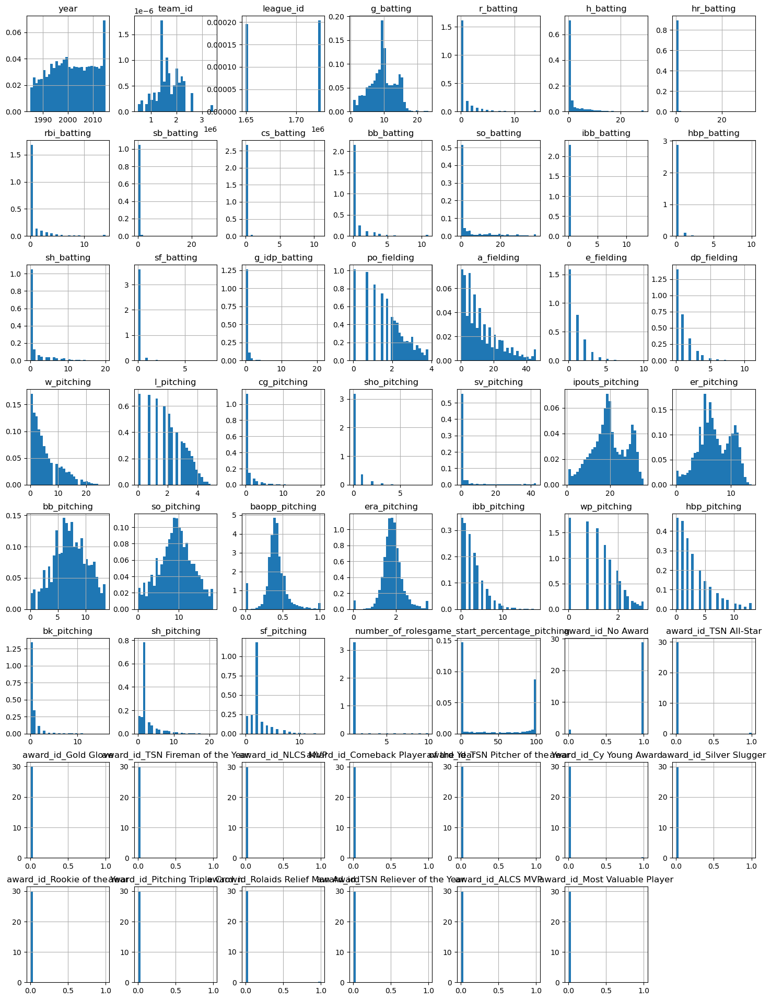

In [292]:
X_train_ohe.hist(bins=30, figsize=(18,24), density=True)
plt.show()

In [293]:
outliers_info_list_sorted_uniquevalues

[{'column': 'sf_batting', 'num_outliers': 470, 'unique_values': 9},
 {'column': 'cs_batting', 'num_outliers': 219, 'unique_values': 10},
 {'column': 'sho_pitching', 'num_outliers': 1745, 'unique_values': 10},
 {'column': 'number_of_roles', 'num_outliers': 212, 'unique_values': 10},
 {'column': 'hbp_batting', 'num_outliers': 479, 'unique_values': 11},
 {'column': 'e_fielding', 'num_outliers': 960, 'unique_values': 11},
 {'column': 'ibb_batting', 'num_outliers': 104, 'unique_values': 12},
 {'column': 'dp_fielding', 'num_outliers': 1195, 'unique_values': 12},
 {'column': 'sf_pitching', 'num_outliers': 142, 'unique_values': 15},
 {'column': 'bk_pitching', 'num_outliers': 501, 'unique_values': 16},
 {'column': 'ibb_pitching', 'num_outliers': 378, 'unique_values': 19},
 {'column': 'g_idp_batting', 'num_outliers': 1372, 'unique_values': 20},
 {'column': 'cg_pitching', 'num_outliers': 2926, 'unique_values': 20},
 {'column': 'sb_batting', 'num_outliers': 259, 'unique_values': 21},
 {'column': '

In [294]:
# By binning these columns, the results of binning will lead to a loss of granularity
# disc = EqualWidthDiscretiser(bins=35, variables = ['a_fielding','ipouts_pitching','baopp_pitching','er_pitching','bb_pitching'])

# disc.fit(X_train_ohe)

In [295]:
# make the distribution look more normal
disc = EqualWidthDiscretiser(bins=35, variables = ['a_fielding'])

disc.fit(X_train_ohe)

EqualWidthDiscretiser(bins=35, variables=['a_fielding'])

In [296]:
disc.binner_dict_

{'a_fielding': [-inf,
  1.3142857142857143,
  2.6285714285714286,
  3.942857142857143,
  5.257142857142857,
  6.571428571428571,
  7.885714285714286,
  9.2,
  10.514285714285714,
  11.82857142857143,
  13.142857142857142,
  14.457142857142857,
  15.771428571428572,
  17.085714285714285,
  18.4,
  19.714285714285715,
  21.02857142857143,
  22.34285714285714,
  23.65714285714286,
  24.97142857142857,
  26.285714285714285,
  27.6,
  28.914285714285715,
  30.228571428571428,
  31.542857142857144,
  32.857142857142854,
  34.17142857142857,
  35.48571428571429,
  36.8,
  38.114285714285714,
  39.42857142857143,
  40.74285714285714,
  42.05714285714286,
  43.371428571428574,
  44.68571428571428,
  inf]}

In [297]:
X_train_ohe = disc.transform(X_train_ohe)
X_test_ohe = disc.transform(X_test_ohe)

In [298]:
# for skewed distributions to make the distribution look more evenly distributed
disc = EqualFrequencyDiscretiser(q=15, variables = ['e_fielding','dp_fielding','w_pitching','l_pitching','sv_pitching',\
                                                    'bb_batting','so_batting','h_batting','cg_pitching'])
                                 
disc.fit(X_train_ohe)

EqualFrequencyDiscretiser(q=15,
                          variables=['e_fielding', 'dp_fielding', 'w_pitching',
                                     'l_pitching', 'sv_pitching', 'bb_batting',
                                     'so_batting', 'h_batting', 'cg_pitching'])

In [299]:
disc.binner_dict_

{'e_fielding': [-inf, 1.0, 2.0, 3.0, inf],
 'dp_fielding': [-inf, 1.0, 2.0, 3.0, inf],
 'w_pitching': [-inf, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 8.0, 9.0, 12.0, 15.0, inf],
 'l_pitching': [-inf,
  0.7700619866939002,
  1.300152890452564,
  1.7171221162000765,
  2.0661268104759163,
  2.369053997838694,
  2.638355421579802,
  2.881863272624388,
  3.3110864217609848,
  3.503312742248047,
  3.8537142742601134,
  inf],
 'sv_pitching': [-inf, 1.0, 2.0, 4.0, 18.0, inf],
 'bb_batting': [-inf, 1.0, 3.0, inf],
 'so_batting': [-inf, 1.0, 2.0, 3.0, 7.0, 14.0, 22.0, inf],
 'h_batting': [-inf, 1.0, 2.0, 5.0, 9.0, inf],
 'cg_pitching': [-inf, 1.0, 2.0, 4.0, inf]}

In [300]:
X_train_ohe = disc.transform(X_train_ohe)
X_test_ohe = disc.transform(X_test_ohe)

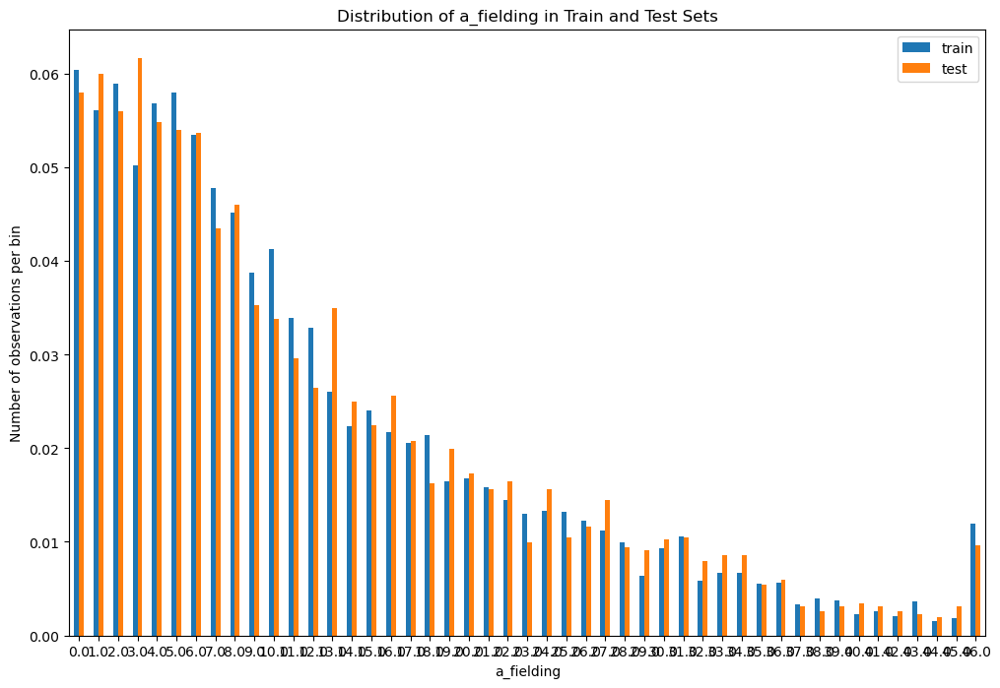

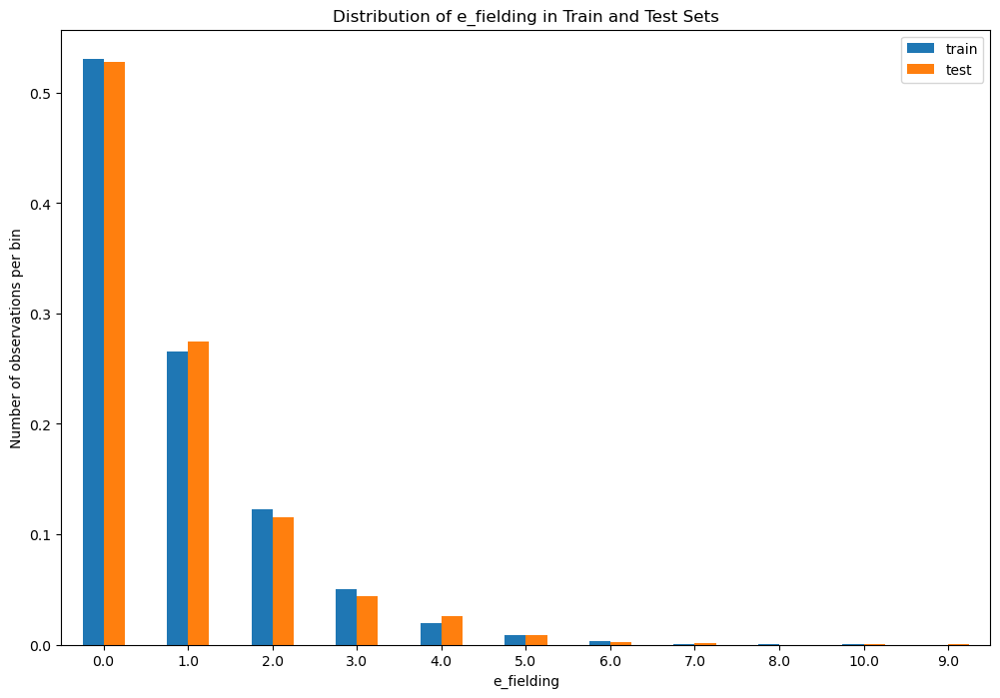

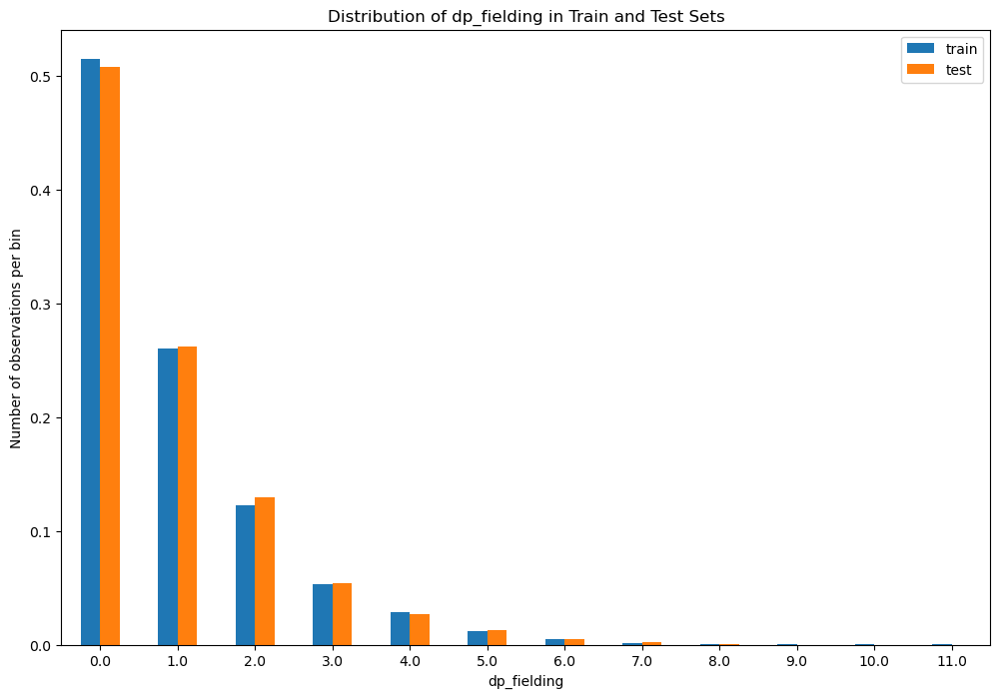

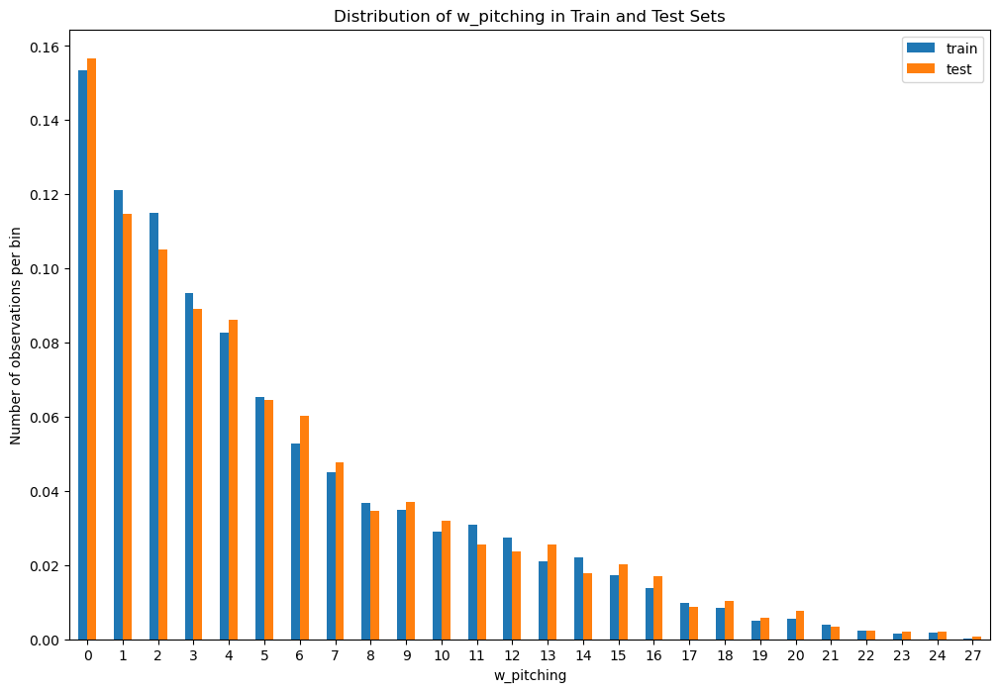

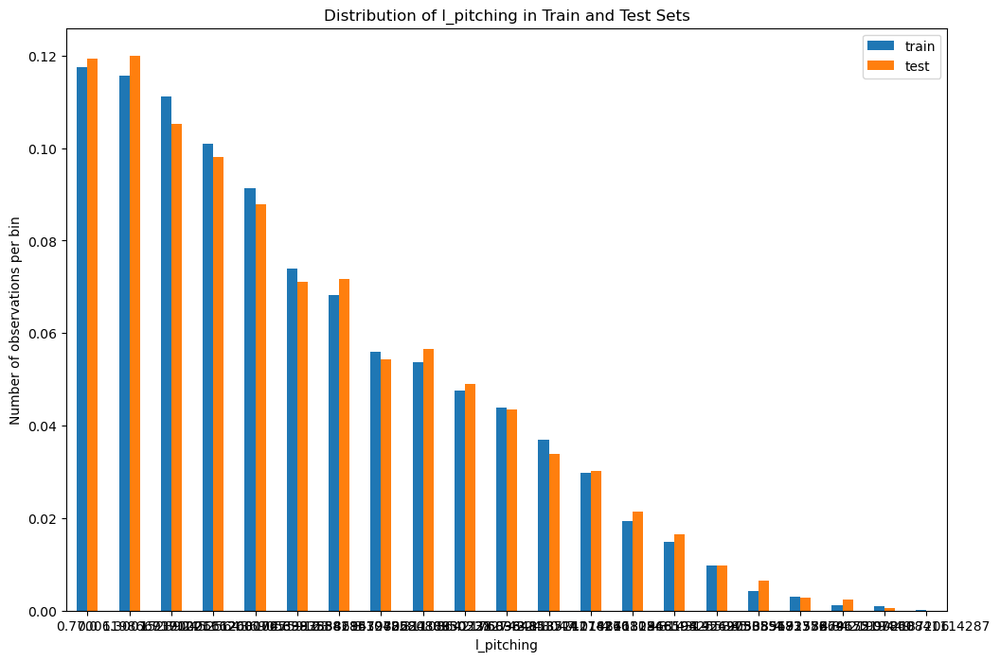

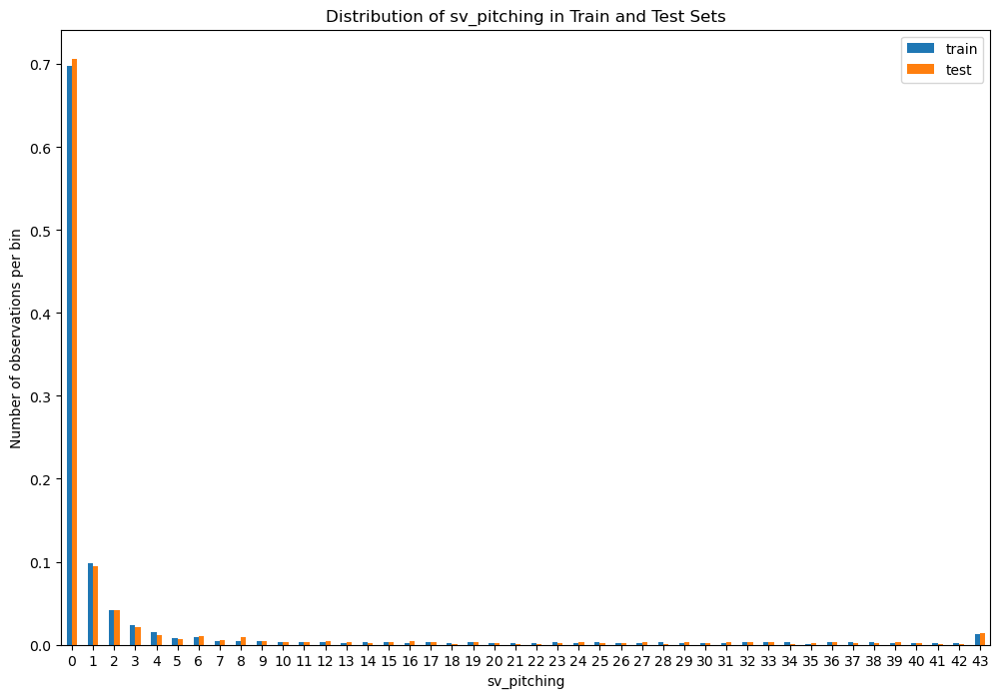

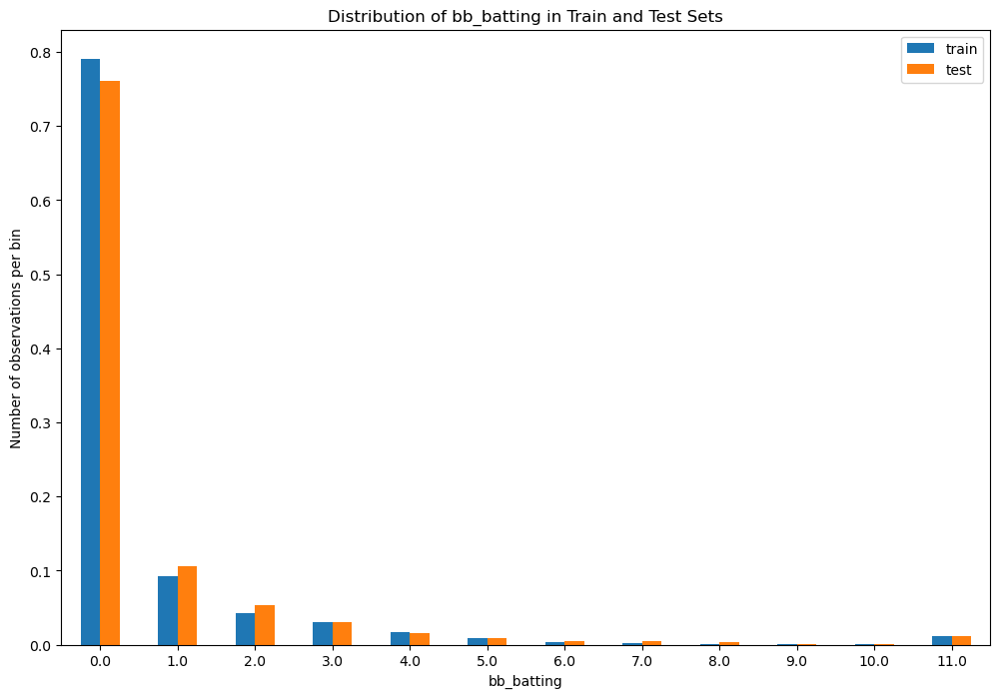

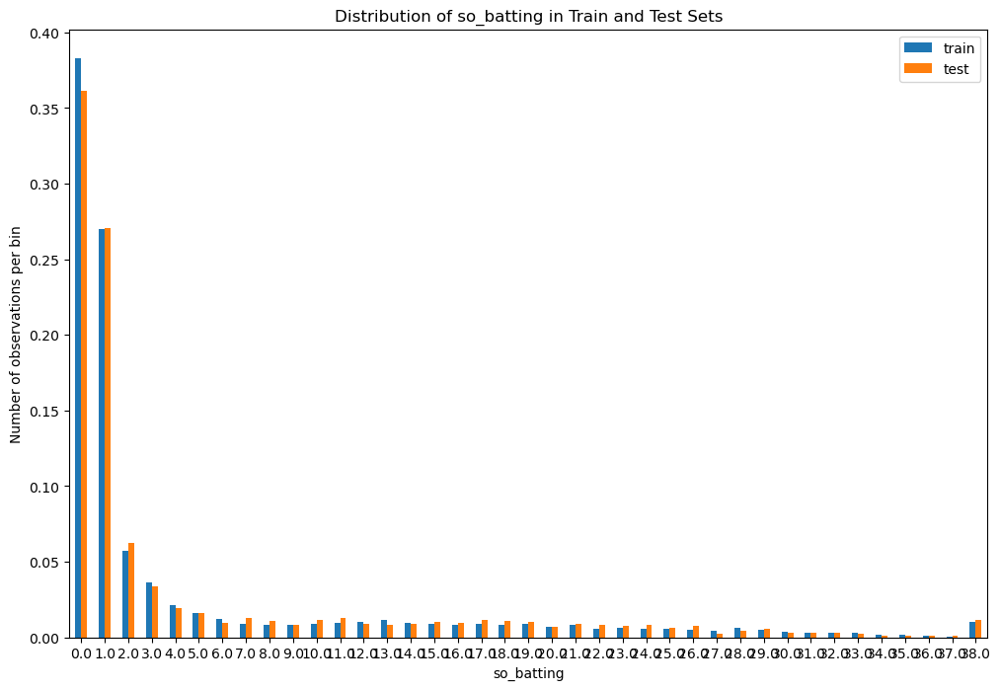

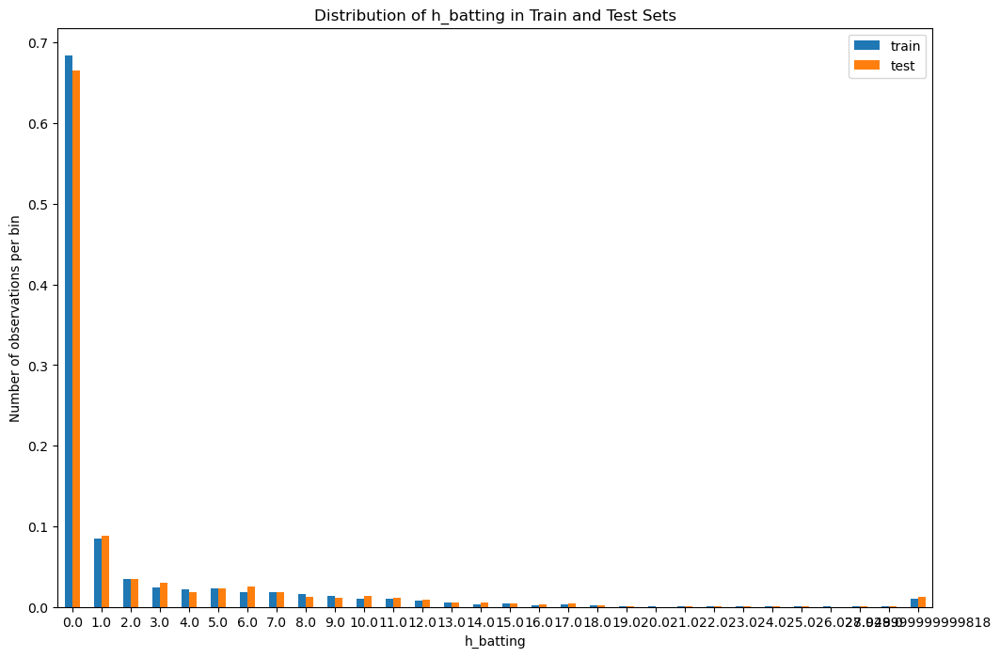

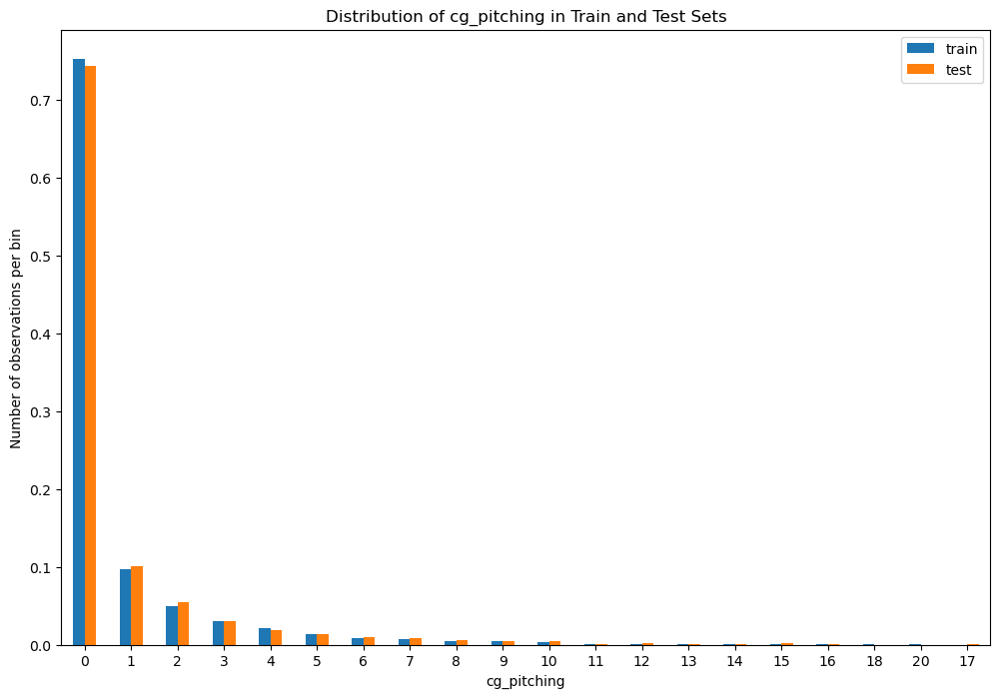

In [301]:
# list of columns to plot
columns_to_plot = ['a_fielding','e_fielding','dp_fielding','w_pitching','l_pitching','sv_pitching','bb_batting','so_batting','h_batting','cg_pitching']

for col in columns_to_plot:
    # ccalculate the proportion of observations per bin for training data
    t1 = X_train.groupby([col])[col].count() / len(X_train)
    
    # calculate the proportion of observations per bin for test data
    t2 = X_test.groupby([col])[col].count() / len(X_test)
    
    # concatenate the results into a single DataFrame
    tmp = pd.concat([t1, t2], axis=1)
    tmp.columns = ['train', 'test']
    
    tmp.plot.bar(figsize=(12,8))
    plt.xticks(rotation=0)
    plt.ylabel('Number of observations per bin')
    plt.title(f'Distribution of {col} in Train and Test Sets')
    plt.show()


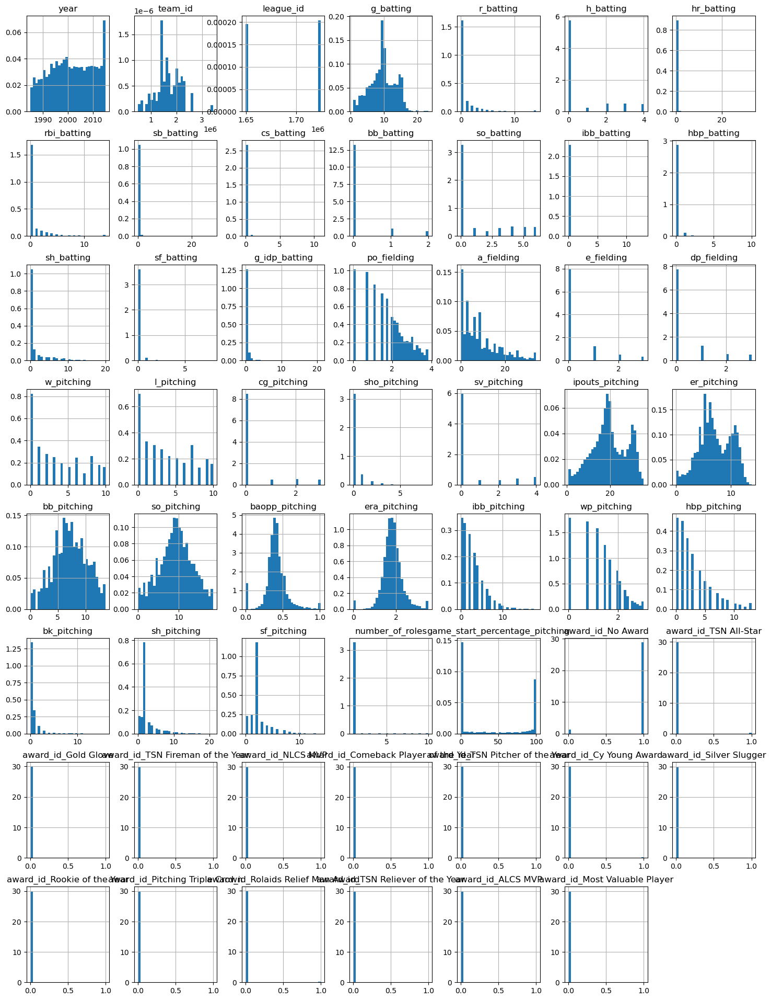

In [302]:
X_train_ohe.hist(bins=30, figsize=(18,24), density=True)
plt.show()

### Feature Engineering

In [303]:
# choose robust scaling as my scaler as it is least sensitive to outliers
scaler = RobustScaler()

# fit the scaler to the train set, it will learn the parameters
scaler.fit(X_train_ohe)

# transform train and test sets
X_train_scaled = scaler.transform(X_train_ohe)
X_test_scaled = scaler.transform(X_test_ohe)

In [304]:
scaler.center_

array([2.00100000e+03, 1.66146169e+06, 1.72456961e+06, 9.59320969e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 1.73660432e+00, 6.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 3.00000000e+00, 3.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 1.91613859e+01, 6.74207966e+00,
       7.14991571e+00, 9.34122048e+00, 3.94228301e-01, 1.81357801e+00,
       2.00000000e+00, 1.15141273e+00, 2.00000000e+00, 0.00000000e+00,
       2.00000000e+00, 2.00000000e+00, 0.00000000e+00, 1.00000000e+00,
       7.14285714e+00, 1.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00])

In [305]:
scaler.scale_

array([1.40000000e+01, 6.34783555e+05, 7.50253682e+04, 5.20639552e+00,
       1.00000000e+00, 1.00000000e+00, 1.00000000e+00, 1.00000000e+00,
       1.00000000e+00, 1.00000000e+00, 1.00000000e+00, 3.00000000e+00,
       1.00000000e+00, 1.00000000e+00, 1.00000000e+00, 1.00000000e+00,
       1.00000000e+00, 1.72268464e+00, 1.00000000e+01, 1.00000000e+00,
       1.00000000e+00, 6.00000000e+00, 6.00000000e+00, 1.00000000e+00,
       1.00000000e+00, 1.00000000e+00, 1.16325169e+01, 4.70506121e+00,
       4.24900104e+00, 5.40834523e+00, 1.14647355e-01, 4.63996443e-01,
       3.00000000e+00, 1.22111863e+00, 3.00000000e+00, 1.00000000e+00,
       1.00000000e+00, 1.00000000e+00, 1.00000000e+00, 1.00000000e+00,
       1.00000000e+02, 1.00000000e+00, 1.00000000e+00, 1.00000000e+00,
       1.00000000e+00, 1.00000000e+00, 1.00000000e+00, 1.00000000e+00,
       1.00000000e+00, 1.00000000e+00, 1.00000000e+00, 1.00000000e+00,
       1.00000000e+00, 1.00000000e+00, 1.00000000e+00, 1.00000000e+00])

In [306]:
# scaler = MinMaxScaler()

# # fit the scaler to the train set, it will learn the parameters
# scaler.fit(X_train_ohe)

# # transform train and test sets
# X_train_scaled = scaler.transform(X_train_ohe)
# X_test_scaled = scaler.transform(X_test_ohe)

In [307]:
# scaler.data_max_

In [308]:
# scaler.min_

In [309]:
# scaler.data_range_

In [310]:
# # standardisation: with the StandardScaler from sklearn

# # set up the scaler
# scaler = StandardScaler()

# # fit the scaler to the train set, it will learn the parameters
# scaler.fit(X_train_ohe)

# # transform train and test sets
# X_train_scaled = scaler.transform(X_train_ohe)
# X_test_scaled = scaler.transform(X_test_ohe)

In [311]:
# scaler.mean_

In [312]:
# scaler.scale_

In [313]:
X_train_scaled = pd.DataFrame(X_train_scaled, columns=X_train_ohe.columns)
X_test_scaled = pd.DataFrame(X_test_scaled, columns=X_test_ohe.columns)

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating ins

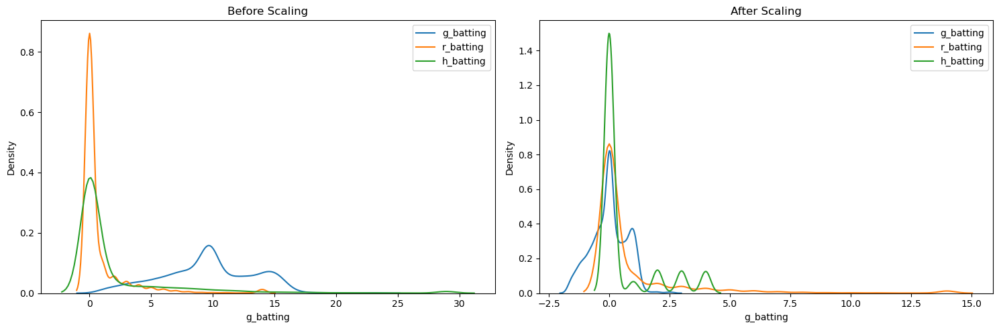

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating ins

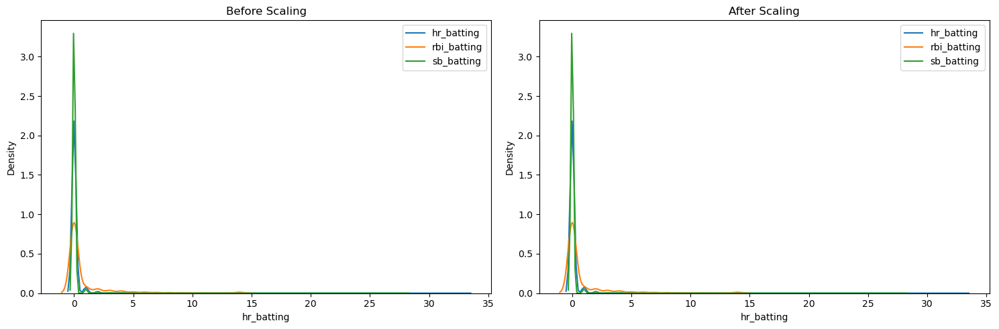

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating ins

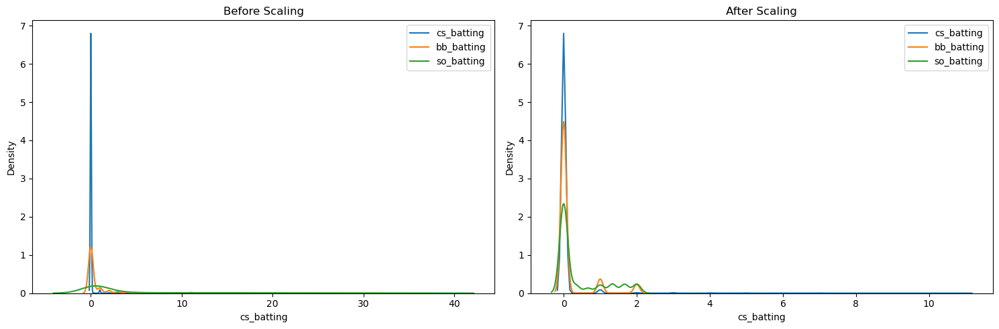

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating ins

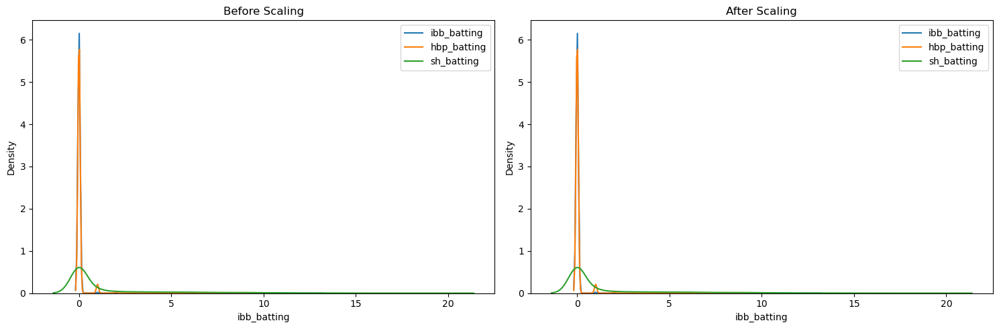

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating ins

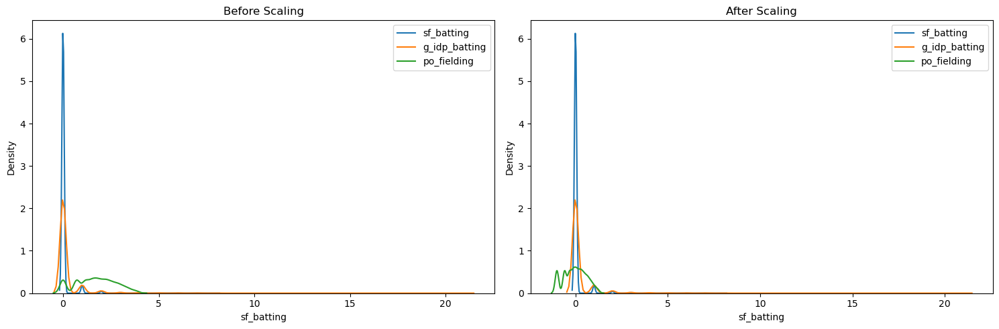

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating ins

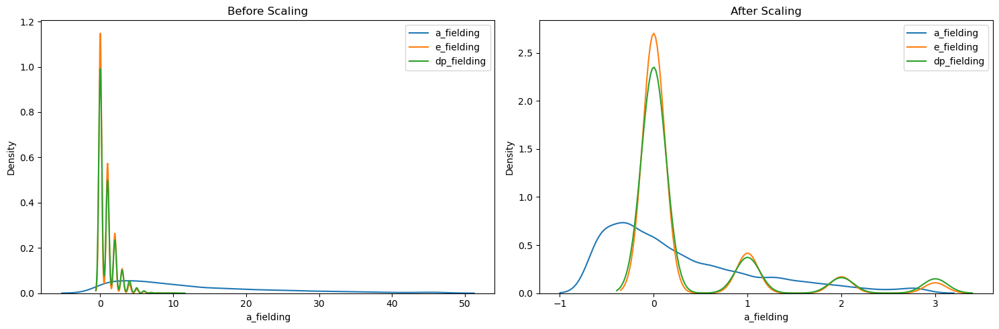

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating ins

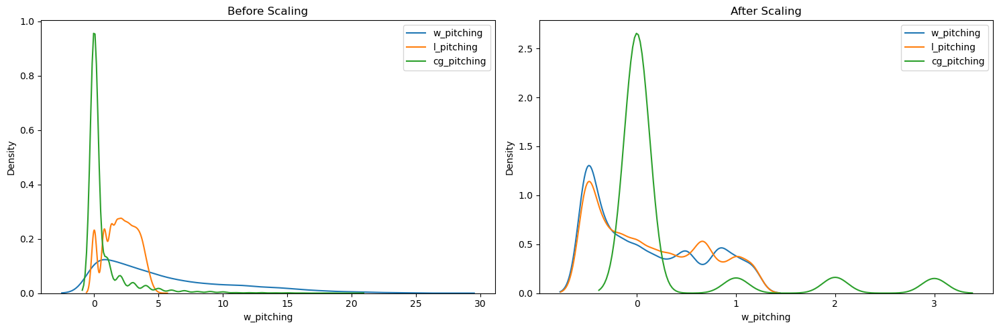

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating ins

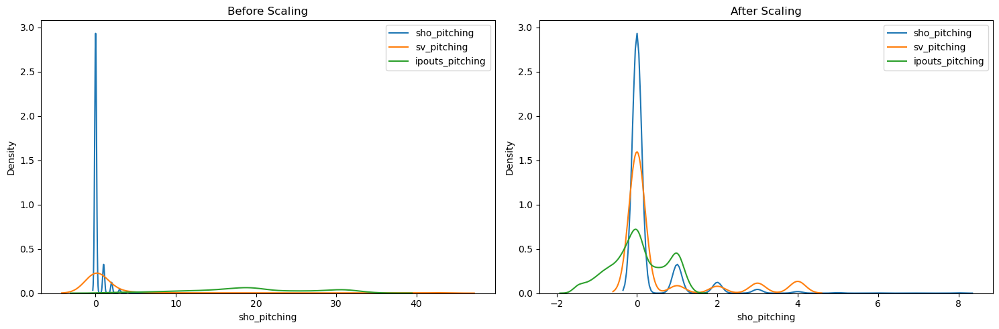

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating ins

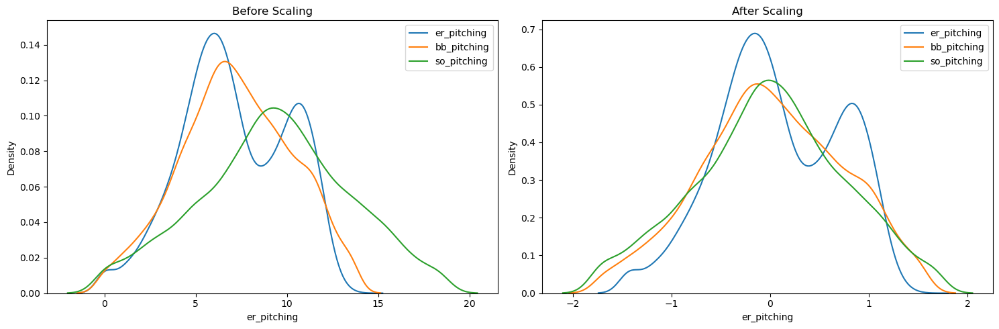

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating ins

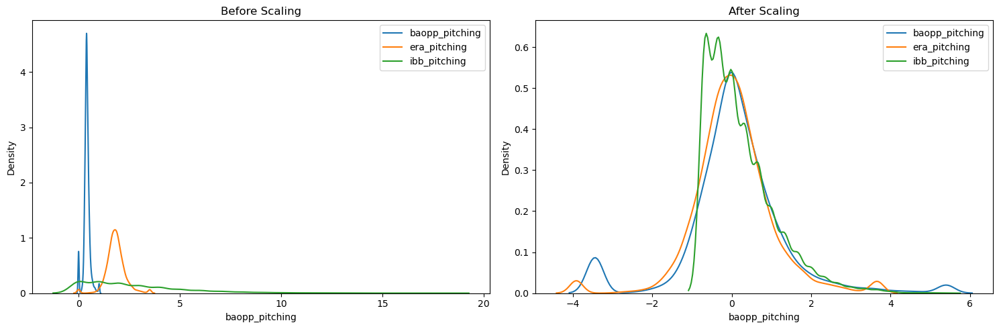

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating ins

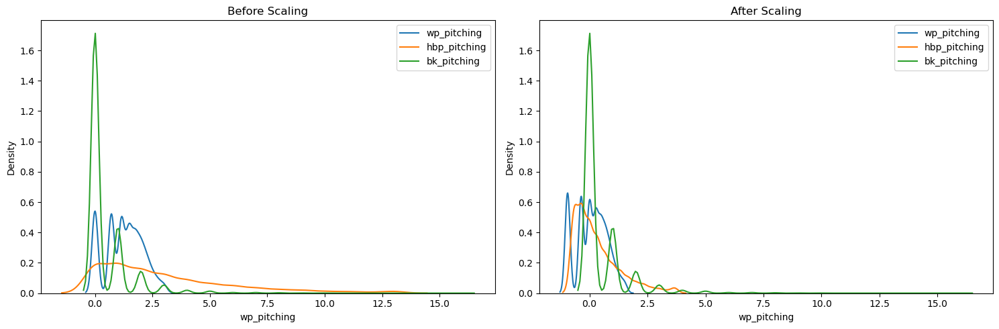

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating ins

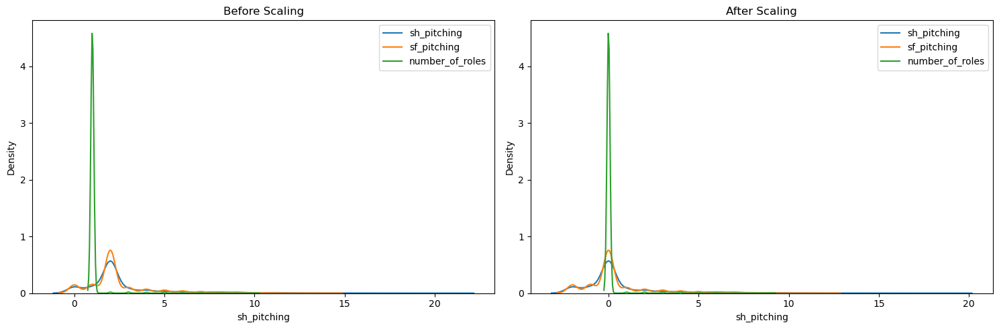

c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\user\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


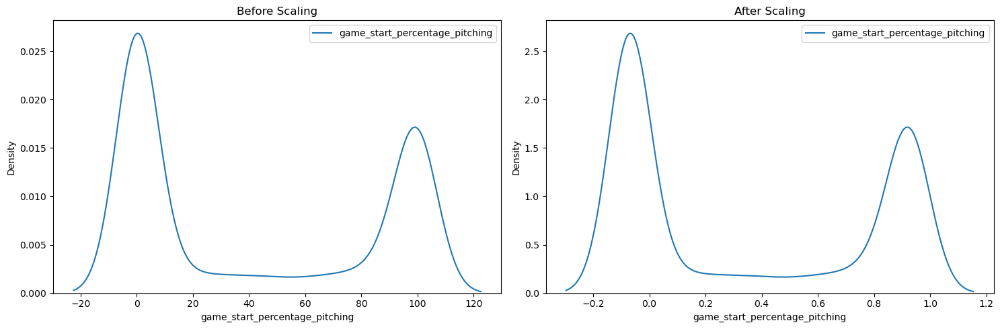

In [314]:
# plot scaling plots
non_categorical_columns = X_train.select_dtypes(include=['float64', 'int64']).columns

# define a function to plot KDE plots for a batch of columns
def plot_kde_plots(columns, X_train, X_train_scaled):
    # Create the figure and axes for plotting
    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(15, 5))
    
    # plot KDEs for the original data
    for column in columns:
        sns.kdeplot(X_train[column], ax=axes[0], label=column)
    
    axes[0].set_title('Before Scaling')
    axes[0].legend()
    
    # plot KDEs for the scaled data
    for column in columns:
        sns.kdeplot(X_train_scaled[column], ax=axes[1], label=column)
    
    axes[1].set_title('After Scaling')
    axes[1].legend()

    plt.tight_layout()
    plt.show()

# number of columns per batch
batch_size = 3

# loop through non-categorical columns in batches of 3
for i in range(0, len(non_categorical_columns), batch_size):
    batch_columns = non_categorical_columns[i:i + batch_size]
    plot_kde_plots(batch_columns, X_train, X_train_scaled)


### Creation of new features

In [315]:
X_train_scaled['r_batting_h_batting'] = X_train_scaled['r_batting'] * X_train_scaled['h_batting']
X_test_scaled['r_batting_h_batting'] = X_test_scaled['r_batting'] * X_test_scaled['h_batting']

In [316]:
X_train_scaled['a_fielding_dp_fielding'] = X_train_scaled['a_fielding'] * X_train_scaled['dp_fielding']
X_test_scaled['a_fielding_dp_fielding'] = X_test_scaled['a_fielding'] * X_test_scaled['dp_fielding']

In [317]:
X_train_scaled['bb_pitching_so_pitching'] = X_train_scaled['bb_pitching'] * X_train_scaled['so_pitching']
X_test_scaled['bb_pitching_so_pitching'] = X_test_scaled['bb_pitching'] * X_test_scaled['so_pitching']

In [318]:
X_train_scaled.head()

,year,team_id,league_id,g_batting,r_batting,h_batting,hr_batting,rbi_batting,sb_batting,cs_batting,bb_batting,so_batting,ibb_batting,hbp_batting,sh_batting,sf_batting,g_idp_batting,po_fielding,a_fielding,e_fielding,dp_fielding,w_pitching,l_pitching,cg_pitching,sho_pitching,sv_pitching,ipouts_pitching,er_pitching,bb_pitching,so_pitching,baopp_pitching,era_pitching,ibb_pitching,wp_pitching,hbp_pitching,bk_pitching,sh_pitching,sf_pitching,selected_for_allstar,number_of_roles,game_start_percentage_pitching,award_id_No Award,award_id_TSN All-Star,award_id_Gold Glove,award_id_TSN Fireman of the Year,award_id_NLCS MVP,award_id_Comeback Player of the Year,award_id_TSN Pitcher of the Year,award_id_Cy Young Award,award_id_Silver Slugger,award_id_Rookie of the Year,award_id_Pitching Triple Crown,award_id_Rolaids Relief Man Award,award_id_TSN Reliever of the Year,award_id_ALCS MVP,award_id_Most Valuable Player,r_batting_h_batting,a_fielding_dp_fielding,bb_pitching_so_pitching
0,0.857143,-1.084262,0.0,0.757852,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.124042,0.1,0.0,0.0,0.333333,-0.500000,0.0,0.0,0.0,0.038742,-0.357738,0.032815,0.082018,-1.069341,-1.317530,-0.333333,0.641730,0.333333,0.0,1.0,-1.0,0.0,0.0,-0.071429,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.002691
1,0.500000,-0.128954,-1.0,0.955494,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.551934,0.4,0.0,0.0,-0.500000,-0.166667,0.0,0.0,3.0,0.007132,-0.462993,0.000000,0.052765,-0.710193,-1.567929,1.666667,0.261771,0.666667,0.0,3.0,-2.0,0.0,0.0,-0.071429,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000
2,-0.428571,0.817330,0.0,0.164115,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.148971,-0.4,0.0,0.0,-0.500000,-0.166667,0.0,0.0,2.0,-0.458568,-0.097592,-0.332720,-0.447567,0.385903,1.077563,0.333333,-0.942916,-0.333333,0.0,0.0,0.0,0.0,0.0,-0.071429,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.0,0.148915
3,0.142857,-0.336639,-1.0,-1.069419,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.336505,-0.1,0.0,0.0,-0.333333,-0.500000,0.0,0.0,0.0,-0.258084,-0.047713,-0.213131,-0.493082,0.926813,0.478779,-0.666667,-0.358270,0.333333,0.0,1.0,3.0,0.0,0.0,0.928571,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.0,0.105091
4,-1.000000,0.431540,0.0,0.099834,2.0,2.0,0.0,4.0,0.0,1.0,1.0,2.0,0.0,0.0,10.0,0.0,2.0,0.324110,0.9,0.0,0.0,1.000000,1.000000,2.0,2.0,0.0,1.046406,1.052631,1.033430,0.825709,-0.213851,0.020102,1.666667,0.261771,1.000000,1.0,0.0,0.0,0.0,0.0,0.928571,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,0.0,0.853312


In [319]:
X_test_scaled.head()

,year,team_id,league_id,g_batting,r_batting,h_batting,hr_batting,rbi_batting,sb_batting,cs_batting,bb_batting,so_batting,ibb_batting,hbp_batting,sh_batting,sf_batting,g_idp_batting,po_fielding,a_fielding,e_fielding,dp_fielding,w_pitching,l_pitching,cg_pitching,sho_pitching,sv_pitching,ipouts_pitching,er_pitching,bb_pitching,so_pitching,baopp_pitching,era_pitching,ibb_pitching,wp_pitching,hbp_pitching,bk_pitching,sh_pitching,sf_pitching,selected_for_allstar,number_of_roles,game_start_percentage_pitching,award_id_No Award,award_id_TSN All-Star,award_id_Gold Glove,award_id_TSN Fireman of the Year,award_id_NLCS MVP,award_id_Comeback Player of the Year,award_id_TSN Pitcher of the Year,award_id_Cy Young Award,award_id_Silver Slugger,award_id_Rookie of the Year,award_id_Pitching Triple Crown,award_id_Rolaids Relief Man Award,award_id_TSN Reliever of the Year,award_id_ALCS MVP,award_id_Most Valuable Player,r_batting_h_batting,a_fielding_dp_fielding,bb_pitching_so_pitching
0,0.571429,0.000000,-1.0,-0.889086,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,-0.148971,0.3,0.0,1.0,0.000000,0.166667,1.0,1.0,0.0,-0.073640,0.270064,-0.138663,-0.341481,1.411615,0.842752,-0.666667,-0.942916,0.000000,0.0,-1.0,-1.0,0.0,0.0,0.928571,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.3,0.047351
1,-1.071429,-0.386471,0.0,1.049925,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.666667,0.0,0.0,0.0,0.0,1.0,0.407585,0.9,0.0,1.0,0.833333,-0.166667,0.0,0.0,3.0,0.426529,0.251282,0.461212,0.751238,-0.019727,-0.516979,2.000000,0.261771,0.000000,0.0,0.0,0.0,0.0,0.0,-0.071429,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.9,0.346480
2,0.428571,0.817330,0.0,-1.365637,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,-1.008080,-0.6,0.0,0.0,-0.500000,-0.500000,0.0,0.0,0.0,-1.420738,-1.051742,-1.242750,-1.253521,1.825315,3.365354,-0.333333,-0.942916,-0.666667,0.0,-2.0,-2.0,0.0,0.0,-0.071429,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.0,1.557813
3,-0.642857,-0.336639,-1.0,-0.104439,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.674180,0.3,0.0,0.0,-0.500000,0.000000,0.0,0.0,2.0,0.167585,0.360079,0.302112,-0.103823,0.180150,0.378306,0.333333,0.000000,2.000000,0.0,0.0,0.0,0.0,0.0,0.204433,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.031366
4,0.428571,0.278414,-1.0,-0.680563,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,-0.592415,-0.2,0.0,0.0,-0.500000,-0.500000,0.0,0.0,0.0,-0.447802,-0.204988,-0.251864,-0.789212,0.200459,0.641868,-0.666667,0.641730,2.000000,1.0,-2.0,1.0,0.0,0.0,-0.071429,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.0,0.198774


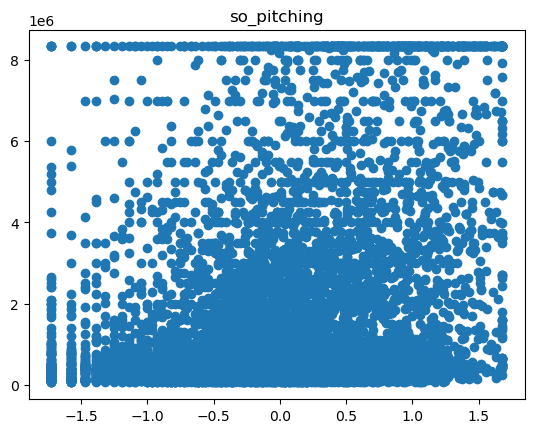

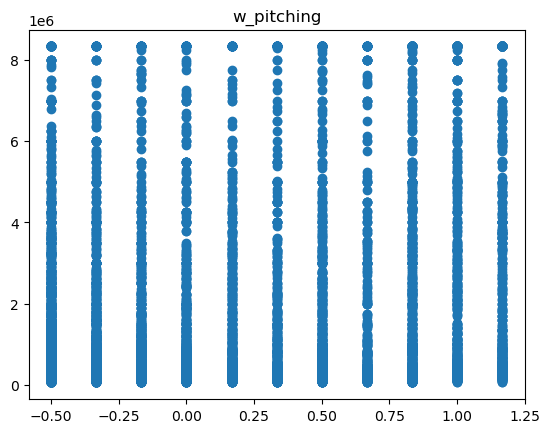

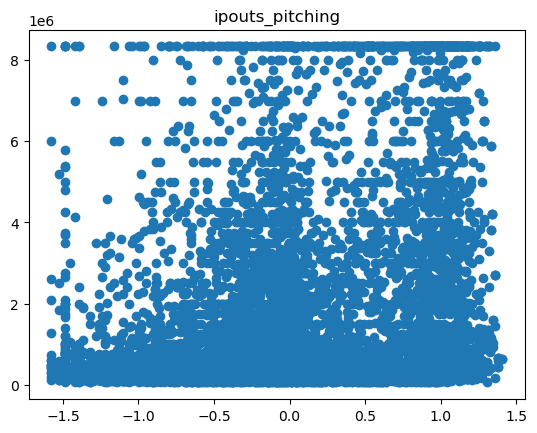

In [320]:
# plot relation of features of interest with the target

for f in ['so_pitching', 'w_pitching', 'ipouts_pitching']:
    plt.scatter(X_train_scaled[f], y_train)
    plt.title(f)
    plt.show()

In [321]:
# choose variables with substantial correlation with target variable salary
key_features = ['so_pitching', 'w_pitching', 'ipouts_pitching']

In [322]:
# set degree to 2
poly = PolynomialFeatures(degree=2, interaction_only=False, include_bias=False)

In [323]:
poly.fit(X_train_scaled[key_features])

PolynomialFeatures(include_bias=False)

In [324]:
train_t = poly.transform(X_train_scaled[key_features])
test_t = poly.transform(X_test_scaled[key_features])

In [325]:
poly_features = poly.get_feature_names_out(key_features)

In [326]:
len(poly.get_feature_names_out(key_features))

9

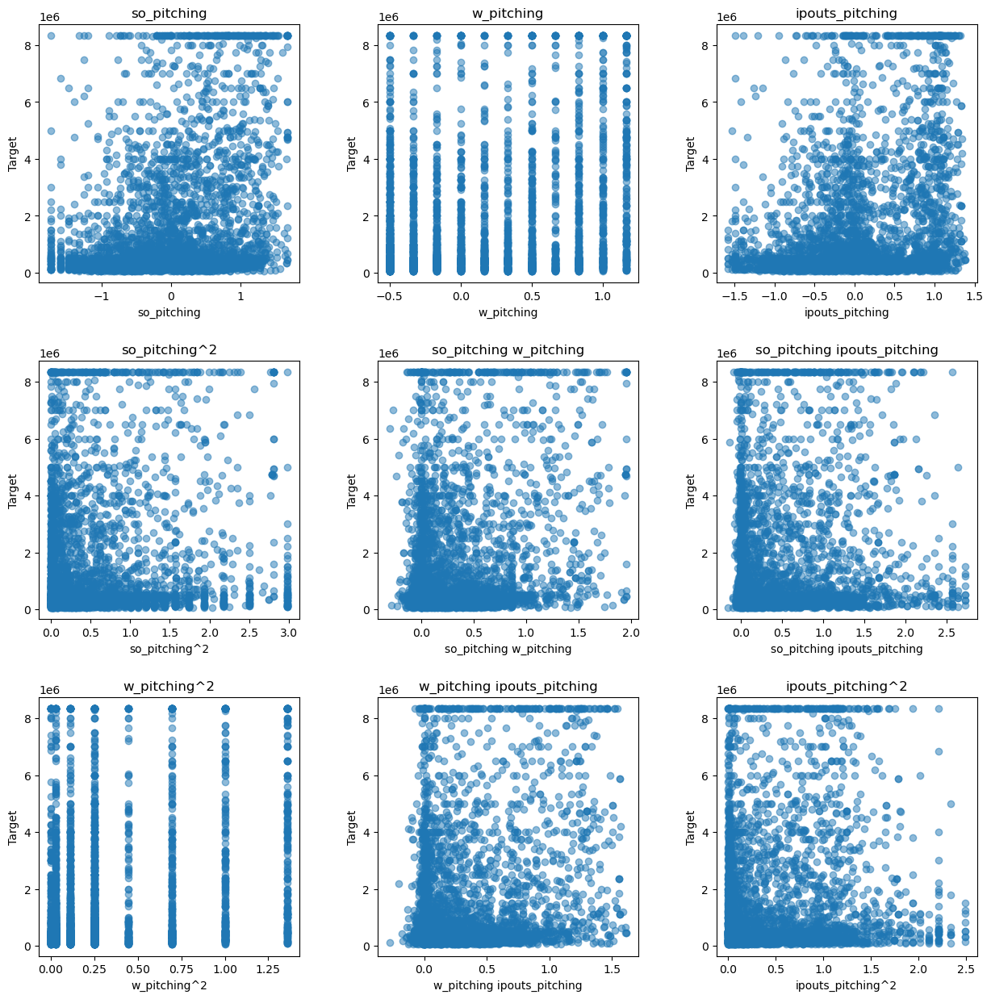

In [327]:
# capture the returned features in a DataFrame
train_t_df = pd.DataFrame(train_t, columns=poly_features, index=X_train_scaled.index)
test_t_df = pd.DataFrame(test_t, columns=poly_features, index=X_test_scaled.index)

# drop the original key features from scaled dataframes to avoid duplicated column names
X_train_scaled = X_train_scaled.drop(columns=key_features)
X_test_scaled = X_test_scaled.drop(columns=key_features)

# concatenate the polynomial features with the scaled dataframes
X_train_scaled = pd.concat([X_train_scaled, train_t_df], axis=1)
X_test_scaled = pd.concat([X_test_scaled, test_t_df], axis=1)

# define a function to plot features vs target
def plot_features(df, target, poly_features):
    num_features = len(poly_features)
    num_rows = int(np.ceil(num_features / 3))  # Calculate number of rows needed
    
    fig, axs = plt.subplots(num_rows, 3, figsize=(15, num_rows * 5))
    plt.subplots_adjust(wspace=0.3, hspace=0.3)
    
    feature_names = poly_features 

    for i in range(num_rows):
        for j in range(3):
            index = i * 3 + j
            if index < len(feature_names):
                feature_name = feature_names[index]
                axs[i, j].scatter(df[feature_name], target, alpha=0.5)
                axs[i, j].set_title(feature_name)
                axs[i, j].set_xlabel(feature_name)
                axs[i, j].set_ylabel('Target')
            else:
                axs[i, j].axis('off')  # Hide unused subplots
    
    plt.show()

plot_features(test_t_df, y_test, poly_features)


In [328]:
X_train_scaled.head()

,year,team_id,league_id,g_batting,r_batting,h_batting,hr_batting,rbi_batting,sb_batting,cs_batting,bb_batting,so_batting,ibb_batting,hbp_batting,sh_batting,sf_batting,g_idp_batting,po_fielding,a_fielding,e_fielding,dp_fielding,l_pitching,cg_pitching,sho_pitching,sv_pitching,er_pitching,bb_pitching,baopp_pitching,era_pitching,ibb_pitching,wp_pitching,hbp_pitching,bk_pitching,sh_pitching,sf_pitching,selected_for_allstar,number_of_roles,game_start_percentage_pitching,award_id_No Award,award_id_TSN All-Star,award_id_Gold Glove,award_id_TSN Fireman of the Year,award_id_NLCS MVP,award_id_Comeback Player of the Year,award_id_TSN Pitcher of the Year,award_id_Cy Young Award,award_id_Silver Slugger,award_id_Rookie of the Year,award_id_Pitching Triple Crown,award_id_Rolaids Relief Man Award,award_id_TSN Reliever of the Year,award_id_ALCS MVP,award_id_Most Valuable Player,r_batting_h_batting,a_fielding_dp_fielding,bb_pitching_so_pitching,so_pitching,w_pitching,ipouts_pitching,so_pitching^2,so_pitching w_pitching,so_pitching ipouts_pitching,w_pitching^2,w_pitching ipouts_pitching,ipouts_pitching^2
0,0.857143,-1.084262,0.0,0.757852,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.124042,0.1,0.0,0.0,-0.500000,0.0,0.0,0.0,-0.357738,0.032815,-1.069341,-1.317530,-0.333333,0.641730,0.333333,0.0,1.0,-1.0,0.0,0.0,-0.071429,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.002691,0.082018,0.333333,0.038742,0.006727,0.027339,0.003178,0.111111,0.012914,0.001501
1,0.500000,-0.128954,-1.0,0.955494,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.551934,0.4,0.0,0.0,-0.166667,0.0,0.0,3.0,-0.462993,0.000000,-0.710193,-1.567929,1.666667,0.261771,0.666667,0.0,3.0,-2.0,0.0,0.0,-0.071429,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.052765,-0.500000,0.007132,0.002784,-0.026382,0.000376,0.250000,-0.003566,0.000051
2,-0.428571,0.817330,0.0,0.164115,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.148971,-0.4,0.0,0.0,-0.166667,0.0,0.0,2.0,-0.097592,-0.332720,0.385903,1.077563,0.333333,-0.942916,-0.333333,0.0,0.0,0.0,0.0,0.0,-0.071429,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.0,0.148915,-0.447567,-0.500000,-0.458568,0.200316,0.223783,0.205240,0.250000,0.229284,0.210284
3,0.142857,-0.336639,-1.0,-1.069419,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.336505,-0.1,0.0,0.0,-0.500000,0.0,0.0,0.0,-0.047713,-0.213131,0.926813,0.478779,-0.666667,-0.358270,0.333333,0.0,1.0,3.0,0.0,0.0,0.928571,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.0,0.105091,-0.493082,-0.333333,-0.258084,0.243130,0.164361,0.127257,0.111111,0.086028,0.066608
4,-1.000000,0.431540,0.0,0.099834,2.0,2.0,0.0,4.0,0.0,1.0,1.0,2.0,0.0,0.0,10.0,0.0,2.0,0.324110,0.9,0.0,0.0,1.000000,2.0,2.0,0.0,1.052631,1.033430,-0.213851,0.020102,1.666667,0.261771,1.000000,1.0,0.0,0.0,0.0,0.0,0.928571,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,0.0,0.853312,0.825709,1.000000,1.046406,0.681795,0.825709,0.864026,1.000000,1.046406,1.094965


In [329]:
X_test_scaled.head()

,year,team_id,league_id,g_batting,r_batting,h_batting,hr_batting,rbi_batting,sb_batting,cs_batting,bb_batting,so_batting,ibb_batting,hbp_batting,sh_batting,sf_batting,g_idp_batting,po_fielding,a_fielding,e_fielding,dp_fielding,l_pitching,cg_pitching,sho_pitching,sv_pitching,er_pitching,bb_pitching,baopp_pitching,era_pitching,ibb_pitching,wp_pitching,hbp_pitching,bk_pitching,sh_pitching,sf_pitching,selected_for_allstar,number_of_roles,game_start_percentage_pitching,award_id_No Award,award_id_TSN All-Star,award_id_Gold Glove,award_id_TSN Fireman of the Year,award_id_NLCS MVP,award_id_Comeback Player of the Year,award_id_TSN Pitcher of the Year,award_id_Cy Young Award,award_id_Silver Slugger,award_id_Rookie of the Year,award_id_Pitching Triple Crown,award_id_Rolaids Relief Man Award,award_id_TSN Reliever of the Year,award_id_ALCS MVP,award_id_Most Valuable Player,r_batting_h_batting,a_fielding_dp_fielding,bb_pitching_so_pitching,so_pitching,w_pitching,ipouts_pitching,so_pitching^2,so_pitching w_pitching,so_pitching ipouts_pitching,w_pitching^2,w_pitching ipouts_pitching,ipouts_pitching^2
0,0.571429,0.000000,-1.0,-0.889086,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,-0.148971,0.3,0.0,1.0,0.166667,1.0,1.0,0.0,0.270064,-0.138663,1.411615,0.842752,-0.666667,-0.942916,0.000000,0.0,-1.0,-1.0,0.0,0.0,0.928571,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.3,0.047351,-0.341481,0.000000,-0.073640,0.116609,-0.000000,0.025147,0.000000,-0.000000,0.005423
1,-1.071429,-0.386471,0.0,1.049925,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.666667,0.0,0.0,0.0,0.0,1.0,0.407585,0.9,0.0,1.0,-0.166667,0.0,0.0,3.0,0.251282,0.461212,-0.019727,-0.516979,2.000000,0.261771,0.000000,0.0,0.0,0.0,0.0,0.0,-0.071429,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.9,0.346480,0.751238,0.833333,0.426529,0.564358,0.626031,0.320425,0.694444,0.355441,0.181927
2,0.428571,0.817330,0.0,-1.365637,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,-1.008080,-0.6,0.0,0.0,-0.500000,0.0,0.0,0.0,-1.051742,-1.242750,1.825315,3.365354,-0.333333,-0.942916,-0.666667,0.0,-2.0,-2.0,0.0,0.0,-0.071429,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.0,1.557813,-1.253521,-0.500000,-1.420738,1.571314,0.626760,1.780924,0.250000,0.710369,2.018497
3,-0.642857,-0.336639,-1.0,-0.104439,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.674180,0.3,0.0,0.0,0.000000,0.0,0.0,2.0,0.360079,0.302112,0.180150,0.378306,0.333333,0.000000,2.000000,0.0,0.0,0.0,0.0,0.0,0.204433,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.031366,-0.103823,-0.500000,0.167585,0.010779,0.051912,-0.017399,0.250000,-0.083793,0.028085
4,0.428571,0.278414,-1.0,-0.680563,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,-0.592415,-0.2,0.0,0.0,-0.500000,0.0,0.0,0.0,-0.204988,-0.251864,0.200459,0.641868,-0.666667,0.641730,2.000000,1.0,-2.0,1.0,0.0,0.0,-0.071429,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.0,0.198774,-0.789212,-0.500000,-0.447802,0.622856,0.394606,0.353411,0.250000,0.223901,0.200526


### PCA

In [330]:
pca = PCA()

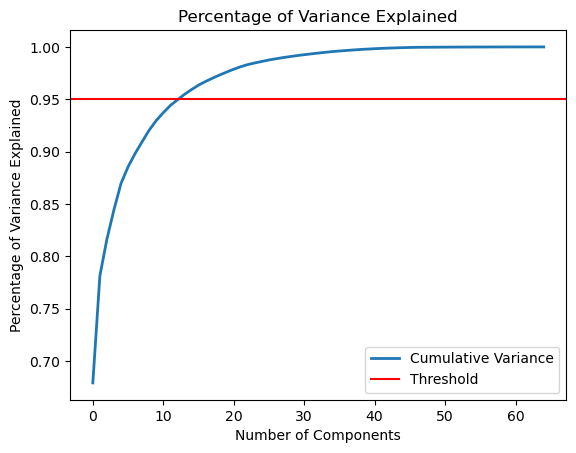

In [331]:
threshold = 0.95

pca.fit(X_train_scaled)

cumulative_explained_variance = np.cumsum(pca.explained_variance_ratio_)

plt.plot(cumulative_explained_variance, linewidth=2)
plt.axhline(y=threshold, color='red')
plt.title('Percentage of Variance Explained')
plt.xlabel('Number of Components')
plt.ylabel('Percentage of Variance Explained')
plt.legend(['Cumulative Variance', 'Threshold'])
plt.show()

In [332]:
x_train_final = pca.transform(X_train_scaled)
x_test_final = pca.transform(X_test_scaled)

In [333]:
print(len(pca.explained_variance_ratio_))
print(pca.explained_variance_ratio_)

65
[6.78931923e-01 1.02247807e-01 3.51619554e-02 2.81113202e-02
 2.51006059e-02 1.58346736e-02 1.27720417e-02 1.12702914e-02
 1.10641205e-02 9.15379172e-03 7.49062633e-03 6.86746096e-03
 5.39220297e-03 5.22689466e-03 4.56520916e-03 4.29562971e-03
 3.48303132e-03 3.20782187e-03 2.98261403e-03 2.83067222e-03
 2.70734777e-03 2.40118882e-03 2.03972050e-03 1.56271210e-03
 1.43335999e-03 1.39867701e-03 1.15270403e-03 1.12254351e-03
 9.71452957e-04 9.45296073e-04 8.36081130e-04 7.96445244e-04
 7.74825238e-04 7.28476640e-04 6.56176702e-04 5.89407739e-04
 5.04642294e-04 4.92198712e-04 4.57850297e-04 3.74683162e-04
 3.50065041e-04 3.34859831e-04 2.49718129e-04 2.23353070e-04
 2.08950781e-04 1.77562533e-04 1.34679535e-04 5.35275693e-05
 4.51108335e-05 4.40724737e-05 4.02127050e-05 3.75410853e-05
 3.37865036e-05 2.54427629e-05 2.09549329e-05 1.49173431e-05
 1.41071982e-05 1.10588073e-05 1.04719735e-05 9.65984341e-06
 8.44668399e-06 6.51296428e-06 5.52245518e-06 2.26764605e-06
 7.13331169e-07]


Text(0, 0.5, 'Percentage of Variance Explained')

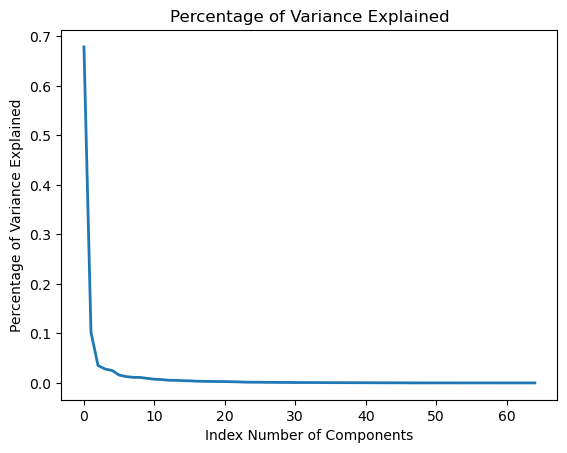

In [334]:
plt.plot(pca.explained_variance_ratio_, linewidth=2)
plt.title('Percentage of Variance Explained')
plt.xlabel('Index Number of Components')
plt.ylabel('Percentage of Variance Explained')

### Step 4: Machine Learning Modelling

In [335]:
X_train_student_final_premodel_version = x_train_final
X_test_student_final_premodel_version = x_test_final

y_train_student_final_premodel_version = y_train
y_test_student_final_premodel_version = y_test

In [336]:
X_train_final = X_train_student_final_premodel_version
X_test_final = X_test_student_final_premodel_version

y_train_final = y_train_student_final_premodel_version
y_test_final = y_test_student_final_premodel_version

In [337]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score

### Linear Regression Model

In [338]:
# Build Linear Regression Model
model_linear_regression = LinearRegression()
model_linear_regression.fit(X_train_final, y_train_final)

# Evaluate the Linear Regression Model using Mean Square Error (MSE)
# The lower MSE, the better the model performance
print('Linear Regression train_mse:', mean_squared_error(y_train_final, model_linear_regression.predict(X_train_final)), 
      '\nLinear Regression test_mse:', mean_squared_error(y_test_final, model_linear_regression.predict(X_test_final)))

train_rmse = np.sqrt(mean_squared_error(y_train_final, model_linear_regression.predict(X_train_final)))
test_rmse = np.sqrt(mean_squared_error(y_test_final, model_linear_regression.predict(X_test_final)))
print('Linear Regression train_rmse:', train_rmse,
      '\nLinear Regression test_rmse:', test_rmse)

# Evaluate the Linear Regression Model using R-Square
# The closer the r-square value to 1, the better the model performance
print('Linear Regression train_r-sq:', r2_score(y_train_final, model_linear_regression.predict(X_train_final)), 
      '\nLinear Regression test_r-sq:', r2_score(y_test_final, model_linear_regression.predict(X_test_final)))



Linear Regression train_mse: 3298665227276.33 
Linear Regression test_mse: 3284718637666.54
Linear Regression train_rmse: 1816222.7912005538 
Linear Regression test_rmse: 1812379.2753357505
Linear Regression train_r-sq: 0.36268690708376894 
Linear Regression test_r-sq: 0.3579476985214224


### Lasso Regression Model

In [339]:
from sklearn.linear_model import Lasso
from sklearn.metrics import mean_squared_error, r2_score
import numpy as np

# Build Lasso Regression Model
model_lasso = Lasso(alpha=1.0)
model_lasso.fit(X_train_final, y_train_final)

# Evaluate the Lasso Regression Model using Mean Squared Error (MSE)
print('Lasso Regression train_mse:', mean_squared_error(y_train_final, model_lasso.predict(X_train_final)), 
      '\nLasso Regression test_mse:', mean_squared_error(y_test_final, model_lasso.predict(X_test_final)))

train_rmse_lasso = np.sqrt(mean_squared_error(y_train_final, model_lasso.predict(X_train_final)))
test_rmse_lasso = np.sqrt(mean_squared_error(y_test_final, model_lasso.predict(X_test_final)))
print('Lasso Regression train_rmse:', train_rmse_lasso,
      '\nLasso Regression test_rmse:', test_rmse_lasso)

# Evaluate the Lasso Regression Model using R-Square
print('Lasso Regression train_r-sq:', r2_score(y_train_final, model_lasso.predict(X_train_final)), 
      '\nLasso Regression test_r-sq:', r2_score(y_test_final, model_lasso.predict(X_test_final)))




Lasso Regression train_mse: 3298665253440.4 
Lasso Regression test_mse: 3284705625138.973
Lasso Regression train_rmse: 1816222.7984034338 
Lasso Regression test_rmse: 1812375.6854303065
Lasso Regression train_r-sq: 0.3626869020287836 
Lasso Regression test_r-sq: 0.3579502420340316


### Ridge Regression Model

In [340]:
from sklearn.linear_model import Ridge

# Build Ridge Regression Model
model_ridge = Ridge(alpha=1.0)
model_ridge.fit(X_train_final, y_train_final)

# Evaluate the Ridge Regression Model using Mean Squared Error (MSE)
print('Ridge Regression train_mse:', mean_squared_error(y_train_final, model_ridge.predict(X_train_final)), 
      '\nRidge Regression test_mse:', mean_squared_error(y_test_final, model_ridge.predict(X_test_final)))

train_rmse_ridge = np.sqrt(mean_squared_error(y_train_final, model_ridge.predict(X_train_final)))
test_rmse_ridge = np.sqrt(mean_squared_error(y_test_final, model_ridge.predict(X_test_final)))
print('Ridge Regression train_rmse:', train_rmse_ridge,
      '\nRidge Regression test_rmse:', test_rmse_ridge)

# Evaluate the Ridge Regression Model using R-Square
print('Ridge Regression train_r-sq:', r2_score(y_train_final, model_ridge.predict(X_train_final)), 
      '\nRidge Regression test_r-sq:', r2_score(y_test_final, model_ridge.predict(X_test_final)))




Ridge Regression train_mse: 3299060622569.395 
Ridge Regression test_mse: 3283556996272.221
Ridge Regression train_rmse: 1816331.6389275927 
Ridge Regression test_rmse: 1812058.7728526415
Ridge Regression train_r-sq: 0.3626105153981064 
Ridge Regression test_r-sq: 0.3581747604445237


### DecisionTreeRegressor

In [341]:
from sklearn.tree import DecisionTreeRegressor

# Build Decision Tree Regressor Model
model_tree = DecisionTreeRegressor(random_state=42,max_depth=5)
model_tree.fit(X_train_final, y_train_final)

# Evaluate the Decision Tree Regressor Model using Mean Squared Error (MSE)
train_mse_tree = mean_squared_error(y_train_final, model_tree.predict(X_train_final))
test_mse_tree = mean_squared_error(y_test_final, model_tree.predict(X_test_final))
print('Decision Tree train_mse:', train_mse_tree, 
      '\nDecision Tree test_mse:', test_mse_tree)

# Calculate RMSE for the Decision Tree Regressor Model
train_rmse_tree = np.sqrt(train_mse_tree)
test_rmse_tree = np.sqrt(test_mse_tree)
print('Decision Tree train_rmse:', train_rmse_tree,
      '\nDecision Tree test_rmse:', test_rmse_tree)

# Evaluate the Decision Tree Regressor Model using R-Square
train_r2_tree = r2_score(y_train_final, model_tree.predict(X_train_final))
test_r2_tree = r2_score(y_test_final, model_tree.predict(X_test_final))
print('Decision Tree train_r-sq:', train_r2_tree, 
      '\nDecision Tree test_r-sq:', test_r2_tree)

Decision Tree train_mse: 3698322414532.5776 
Decision Tree test_mse: 4236997120367.652
Decision Tree train_rmse: 1923102.289149638 
Decision Tree test_rmse: 2058396.735415127
Decision Tree train_r-sq: 0.2854718092889591 
Decision Tree test_r-sq: 0.17180920116107512


### Naive Baseline Model

In [342]:
# pick the mean target value from all of train data
print(y_train.mean())

mean_target_value = y_train.mean()

print(f"The train mean target value is {mean_target_value:.2f}.")

1687797.4844016572
The train mean target value is 1687797.48.


In [343]:
y_train_preds_naive = [round(mean_target_value,2) for row in X_train_ohe.iloc[:,0]]
y_train_preds_naive[0:5]

[1687797.48, 1687797.48, 1687797.48, 1687797.48, 1687797.48]

In [344]:
y_test_preds_naive = [round(mean_target_value,2) for row in X_test_ohe.iloc[:,0]]
y_test_preds_naive[0:5]

[1687797.48, 1687797.48, 1687797.48, 1687797.48, 1687797.48]

In [345]:
# Mean Squared Error (the lower the better, 0 is best possible score)

# train MSE score
y_true = y_train
y_pred = y_train_preds_naive

train_mse_naive = mean_squared_error(y_true, y_pred)
print(f"The Naive Baseline Model's MSE on train data is {train_mse_naive:.2f}.")

# test MSE score
y_true = y_test
y_pred = y_test_preds_naive

test_mse_naive = mean_squared_error(y_true, y_pred)
print(f"The Naive Baseline Model's MSE on test data is {test_mse_naive:.2f}.")

print()

# Root Mean Squared Error (if MSE < 1, rooting it makes it numerically larger, vice-versa if MSE > 1)

# train RMSE score
y_true = y_train
y_pred = y_train_preds_naive

train_rmse_naive = mean_squared_error(y_true, y_pred, squared=False)
print(f"The Naive Baseline Model's RMSE on train data is {train_rmse_naive:.2f}.")

# test RMSE score
y_true = y_test
y_pred = y_test_preds_naive

test_rmse_naive = mean_squared_error(y_true, y_pred, squared=False)
print(f"The Naive Baseline Model's RMSE on test data is {test_rmse_naive:.2f}.")

print()

# R2 Value (Coefficient of Determination, which measures how well the X cols account for y's variance, 1.0 is best score)

# train R2 score
y_true = y_train
y_pred = y_train_preds_naive

train_r2_naive = r2_score(y_true, y_pred)
print(f"The Naive Baseline Model's R2 on train data is {train_r2_naive:.2f}.")

# test R2 score
y_true = y_test
y_pred = y_test_preds_naive

test_r2_naive = r2_score(y_true, y_pred)
print(f"The Naive Baseline Model's R2 on test data is {test_r2_naive:.2f}.")


The Naive Baseline Model's MSE on train data is 5175894335046.88.
The Naive Baseline Model's MSE on test data is 5116054716901.96.

The Naive Baseline Model's RMSE on train data is 2275059.19.
The Naive Baseline Model's RMSE on test data is 2261869.74.

The Naive Baseline Model's R2 on train data is 0.00.
The Naive Baseline Model's R2 on test data is -0.00.


c:\Users\user\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:483: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\user\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:483: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


# Report

## Table of Contents
##### Introduction with Value Based Problem Statement
##### Problem Formulation
##### Data Wrangling on multiple tables
##### Data Cleansing and Transformation
##### Machine Learning Model
##### Summary and Further Improvements
##### Reflection


### Introduction with Value Based Problem Statement
In the competitive world of professional baseball, well-rounded pitchers who excel not only in their primary role but also contribute significantly to batting and fielding are highly valued assets. These versatile players can have a substantial impact on a team's performance and, consequently, on their market value. However, determining appropriate salaries for such multi-faceted athletes presents a unique challenge for team management and front offices.

The aim of this analysis is to predict the salaries of well-rounded pitchers based on their performance metrics across pitching, batting, and fielding. By developing an accurate predictive model, I seek to uncover valuable insights that influence salary decisions for these versatile players. This information can help teams optimise their resource allocation for pitcher salaries, ensuring they appropriately compensate players for their diverse skill sets while maintaining a competitive edge in the market.

Understanding the factors that drive salary determinations for well-rounded pitchers offers several key benefits. It allows for improved talent valuation, enabling teams to more accurately assess the worth of pitchers who contribute in multiple areas. This, in turn, leads to more informed contract negotiations and free agent acquisitions. Additionally, a clearer understanding of how various skills translate to market value helps teams optimise their budget allocation, ensuring that resources are distributed efficiently across their pitching staff and overall roster.

By addressing this complex problem, I aim to provide valuable insights that can enhance decision-making processes in professional baseball 
management, ultimately contributing to more successful and sustainable team-building strategies.

To create the model, I will be using and evaluating 4 different regression models to predict pitcher salary, and I would choose the model which performs better. These models include Linear Regression Model, Lasso Regression Model, Ridge Regression Model and Decision Tree Regressor. I would then need to explore the relevant tables and combine tables to finalise my dataset. After that, I would create new features as well as dropping columns to aid in the accuracy of the prediction model. Data Cleansing and Transformation would then be carried out to clean and transform the dataset to ensure that the data is suitable for fitting into the prediction models such as missing value imputation, outlier handling and categorical variable transformation. I would then scale the cleaned dataset and apply polynomial expansion and create new features to potentially improve model performance. Lastly, principal component analysis would be applied to determine if it reduces dimensionality. This FINAL dataset would then be fit into the models to predict salary, and the models’ results would be compared with the naïve baseline followed by one another using MSE (Mean Squared error), RMSE (Root Mean Squared error) and R-square to determine the best model.

443 words

### Problem Formulation
#### Load and Explore the Data
Before I loaded the datasets, I had to determine which csv files are appropriate to use in predicting well-rounded pitcher’s salary. After looking through all the 26 csv files and data dictionary, I have chosen the following csv files to explore: 

Salary.csv: This csv file provides information of my target variable “salary”; thus it is the most important csv file to load inside

batting.csv: This file provides batting information of players which is essential for assessing a pitcher’s well-roundedness

fielding.csv: This file provides fielding information of players which is essential for assessing a pitcher’s well-roundedness

player_award.csv: This file provides player award information where certain player awards may influence the pitcher’s salary

all_star.csv: This file provides all star game information which could influence salary decisions since only decent pitchers would be selected for the all-star game, thus expecting higher pay

pitching.csv: This file provides pitching information of pitchers which is very important since we are assessing a **pitcher’s** well-roundedness, and the pitching information shows pitching metrics which could influence salary decisions of these pitchers

batting_postseason.csv: This file provides postseason data on batting for players to see if postseason batting performance affects the salary, especially for pitchers with notable batting skills

fielding_postseason.csv: This file provides postseason data on fielding for players to evaluate how postseason fielding performance impacts salary, considering its potential influence on overall assessments

pitching_postseason.csv: This file provides postseason data on pitching for pitchers to see if postseason performance impacts salary decisions.

After I loaded the files, I explored each of the 9 csv files by:

.head(): To explore the first 5 rows of the csv file 

.shape: To understand the shape of the csv file

.dtypes: To understand the data types for each column in the csv file

.info(): To give a summary of the dataset which includes the number of non-null entries and data types

.describe(): To generate summary statistics for numerical columns to understand the distribution of the data

.isnull.sum(): To check for any null values in the csv file

.agg([‘min’,’max’]): To understand the date range of the data in the csv file

isnull().mean().plot.bar (except salary since it had no missing values): To visualise the percentage of missing values in a bar chart  so that it is easier to identify columns with significant missing data

.nunique().plot.bar: To visualise the cardinality of each column in a bar chart

data[data.duplicated()]: To check for any duplicated rows in the csv file

The main insights are as follows after doing the above steps:

Salary.csv consists of 25,575 rows with 5 columns (year-int64, team_id-categorical, league_id-categorical, player_id-categorical, salary-int64) which does not have any null values, suggesting that the target variable ‘salary’ can directly be used in the model for prediction since it does not require any preprocessing steps to input any missing data. The date range of salary data is between 1985-2015. The cardinality plot shows player_id has the highest number of unique values at roughly 5000 followed by salary at slightly above 3000. It also does not contain any duplicated rows which indicates that the data is clean and there are no duplicated entries.

Moving on to 3 of the main tables: Batting, Fielding and Pitching:

Batting contains 101,332 rows with 22 columns, which consists of 19 numerical columns and 3 categorical columns. This table however has many columns containing null values (17) such as ‘ibb’ and ‘sf’, unlike salary which contains no null values. The data range for this table is between 1871-2015 which explains why there is a significant number of rows. The cardinality plot shows player_id with the highest number of unique values at above 17,500 while the other columns remain under 1,000. This table also does not contain any duplicated rows.

Fielding contains 170,526 rows with 18 columns, which consists of 14 numerical columns and 4 categorical columns. This table contains 12 columns with null values with columns such as ‘zr’ and ‘sb’ containing more than 90% missing values, which may be dropped after merging tables. The data range for this table is also between 1871-2015. Similar to batting, player_id has the highest number of unique values at above 17,500 while ‘inn_outs’ has slightly under 5000 unique values, and the rest have slightly less than 2000 and below. This table also does not contain any duplicated rows.

Pitching contains 44,139 rows with 30 columns, which consists of 27 numerical columns and 3 categorical columns. This table contains 12 columns with null values with ‘ipouts’ containing 1 missing value. The data range for this table is also between 1871-2015. Similar to batting and fielding, player_id has the highest number of unique values at above 8,000 unique values while columns like ‘ipouts’ have slightly less than 2000 unique values and below. This table also does not contain any duplicated rows.

Moving on to the player recognition tables: all_star and player_award

all_star contains 5,069 rows with 8 columns, which consists of 4 numerical and 4 categorical columns. This table contains 3 columns with null values with ‘game_id’ with 49 missing values, ‘gp’ with 19 missing values and ‘starting_pos’ containing a whopping 70% of missing values. The data range for this table is between 1933-2015. Similar to the main tables above, player_id has the highest number of unique values at slightly under 1,750 while other columns have about slightly under 100 and below. This table also does not contain any duplicated rows.

player_award contains 6,078 rows with 6 columns, which consists of 1 numerical column and 5 categorical columns. This table contains 2 columns with null values with ‘tie’ with 6033 null values (99%) and ‘notes’ with 1430 null values (about 25%). The data date range for this table is between 1877-2015. Similar to the tables above, player_id has the highest number of unique values at above 1,200 while other columns have slightly below 200 and below. This table also does not contain any duplicated rows.

#### Understand the Data
After exploring the postseason tables (pitching_postseason, batting_postseason, fielding_postseason) and most importantly, understanding the context of the data, there are certain reasons why I won’t be using these tables. 

Firstly, not all teams make it to postseason, which introduces sample bias. This means that many players, including potentially well-rounded pitchers, would have no postseason data. Using this data could disadvantage certain players in the salary prediction model since some players may rely on their team's performance rather than their individual skills. For example, the round column in the postseason tables might reflect a team’s advancement due to overall performance rather than the individual contributions of each player.

Additionally, postseason performance is often viewed in a different context from regular season play. The high-pressure environment, the smaller sample size of games, and different strategic approaches in the postseason make it less representative of a player's consistent value over a full season. Salary decisions are more likely to be based on consistent performance during the regular season rather than potentially volatile postseason statistics.
Thus, I would not be using these tables in the salary prediction model. I would be focusing on regular season data, along with other relevant factors like all-star appearances and player awards, will provide an unbiased basis for predicting well-rounded pitchers' salaries.

#### Formulate a Prediction Problem
To summarise, after thoroughly exploring and understanding the tables, my finalised prediction problem is to build a predictive model that predicts the salaries of well-rounded pitchers based on their performance data. This prediction will be based on regular season data, player awards, and all-star appearances. By excluding postseason data, I aim to avoid sample bias and ensure that the model reflects consistent performance throughout the season.

1252 words

### Data Wrangling on multiple tables
I began by finalising six tables: salary, batting, fielding, pitching, all_star, and player_award for merging.

Firstly, I dropped ‘stint’ from the batting table as it is not insightful for salary prediction and renamed the columns to enhance readability to track column origin. After that, I merged the salary table with batting table using a left join on ‘player_id’, ‘year’, ’league_id’, ’team_id’. The reason for merging on ‘player_id’ is because ‘player_id’ uniquely identifies each player and by including ‘player_id’ in the join condition, this ensures that the salary data is matched with the correct player’s batting data. As for ‘year’, it ensures that the data is matched for the same season since player performance can vary from year to year. It is crucial to ensure that salary data and batting data are from the same year to make accurate comparisons and analyses. Next, for ‘league_id’, it is to ensure that the data is aligned with the correct league context. Including ‘league_id’ in the join condition ensures that we are comparing data within the same league. Lastly, for ‘team_id’, it is to specify the exact team within the leagues. Players might change teams from year to year, so matching on ‘team_id’ ensures that salary data and batting data correspond to the correct team context for a given year. These 4 columns are also common columns between the 2 tables. By merging on these 4 columns, this would ensure accurate data merging by ensuring unique matches as each combination of ‘player_id’, ‘year’, ‘league_id’, and ‘team_id’ represents a unique context for the player’s data. This would thus prevent mismatches and ensure that all relevant data are correctly matched. The reason for left joining is to preserve all salary records from the salary table, ensuring that every salary entry is included in the dataset, even if there are no corresponding batting data. After merging, the merged_data shape is (25584, 22).

Similar to batting, I dropped ‘stint’ from the fielding table and renamed the columns to enhance readability. After that, I merged the existing merged data with fielding table using an inner join on ‘player_id’, ‘year’, ’league_id’ ,’team_id’. The reason for merging on these columns remains consistent with the previous merge. However, I have chosen to use an inner join to merge the data. This would ensure that only players with batting and fielding data are included in the dataset. This is important as we are assessing a pitcher’s well-roundedness thus, we need both fielding and batting data. After merging, the merged_data shape is (46883, 35).

Similar to batting and fielding, I dropped ‘stint’ from the pitching table and renamed the columns to enhance readability. After that, I merged the existing merged data with pitching table using an inner join on ‘player_id’, ‘year’, ’league_id’ ,’team_id’. The reason for merging on these columns remains consistent with the previous merges. I have chosen to use an inner join to merge the data. This would ensure that only players with batting, fielding and pitching data are included in the dataset. This is important as we are assessing a pitcher’s well-roundedness thus, we need fielding, batting and pitching data. The reason why I merged on pitching table after batting and fielding is because by doing so, we ensure that our final dataset focuses specifically on players who have pitching data, which aligns with our goal of predicting salaries for well-rounded pitchers. This approach effectively filters out non-pitchers or players with incomplete data. After this merge, the merged_data shape became (12248, 60), which has a significant reduction in rows from the previous merge (46883 to 12248). This reduction indicates that we have successfully narrowed our dataset to focus on players with complete pitching, batting, and fielding data, which is exactly what we need for our analysis of well-rounded pitchers.

For the all_star table, I merged it with the existing merged data using a left join on 'player_id', 'year', 'league_id', and 'team_id'. The reason for merging on these columns remains consistent with the previous merges.  I chose a left join because I wanted to include all-star information without losing data for non-all-star players and I would be creating new columns from the left join. This approach ensures that we retain all pitcher records while adding valuable information about their all-star appearances. After this merge, the data shape is (12248, 64) where the number of rows is maintained while the number of columns has increase by 4.

I merged the player_award table, again using a left join, but this time only on 'player_id', 'year', and 'league_id'. The decision to exclude 'team_id' from this join is because the player_award table does not contain team_id. The reason for merging on the remaining columns remains consistent with the previous merges.  I chose a left join because I wanted to include player_award information without losing data for non-player_award recipients and I would also be creating new columns from the left join. This approach ensures that we retain all pitcher records while adding valuable information about their player_award. After the merging, the final dataset shape is (12440, 67).

Upon exploring the final dataset, I converted ‘year’ to a datetime object and dropped 4 duplicated rows, and the dataset shape became (12436, 67) after dropping duplicates. I also plotted graphs to visualise the percentage of missing values to identify which columns may be dropped or may require any form of imputation. Additionally, I analysed the cardinality of the variables, where it helps in identifying columns that may require imputation or to be dropped. The date range of the final dataset is 1985-2015.

I also conducted an analysis an categorical variables. For the ‘team_id’, there are 35 unique teams. Among them, SLN is the most frequent, appearing in 4.23% of the data, while MIA is the least frequent, accounting for only 0.41%. To manage rare categories and avoid overfitting, I set a tolerance rate of 1%. This threshold strikes a balance between identifying categories that are genuinely rare and ensuring that each category has sufficient data for meaningful analysis. Since the most frequent category appears in only 4.23% of the dataset, setting the tolerance rate at 5% is impractical as it will group all the categories as rare which potentially obscure important distinctions and reduces the model's ability to make accurate predictions. Therefore, a 1% tolerance rate is more appropriate for preserving the integrity of the analysis.

Regarding ‘league_id’, the dataset includes only 2 leagues being NL and AL. The distribution between the two leagues is fairly balanced, with NL comprising 51.64% of the data and AL 48.36%.

For ‘pos_fielding’, there are 11 unique positions. As anticipated, the dataset focuses on pitchers, with the 'P' (Pitcher) position dominating at 94.34%. Other positions are far less common, with 'C’ being the least frequent at 0.22%.

For ‘award_id’, the dataset includes 15 unique awards. The most frequently recorded award is the TSN All-Star, which appears in 0.70% of the data. In contrast, the Most Valuable Player award is the rarest, appearing in only 0.03% of the cases. Despite the low frequencies of these awards, I chose not to group rare categories together. Each award, regardless of its frequency, holds unique value and may impact salary decisions in distinct ways. Therefore, preserving the individuality of each award category is crucial for capturing its potential influence and ensuring a more accurate prediction model.

I then plotted the correlation map between numerical variables to identify any high correlations between variables. I also identified columns with (39) and without missing values (28 columns). This is to better understand the blanks in the correlation matrix. I then find the number of missing values for columns with missing values and found that era_pitching contains 17 null values, so I decided to drop them since 17 rows is an insignificant amount as compared to the 12,436 rows in the dataset. The merged_data shape then dropped to (12,419, 67). As mentioned earlier, I wanted to explore the highly correlated columns (starting with 1). Examples include plotting a linear plot between g_pitching and zr_fielding where there are 12,411 missing values (99%) in zr_fielding and a linear plot between gf_pitching and zr_fielding where there are also12,411 missing values (99%) in zr_fielding. This suggests that zr_fielding could be dropped since it contains too many null values.

I created a new Boolean feature, ‘selected_for_all_star’, indicating whether a player is selected for all_star game. If ‘game_num’ is null, the player was not selected; otherwise, they were. Another feature which I have created is number_of_roles which counts how many roles does the player have. This feature captures the diversity of a player’s roles, acknowledging that not all players have pitching as their primary position, and this variability may impact salary decisions. I then filtered the merged_data to only pitchers (‘P’). This filtering was done because the number_of_roles feature specifically measures the number of roles for pitchers, and excluding non-pitcher data helps avoid duplication and keeps the dataset focused on relevant information. The shape of merged_data became (11724, 69) after filtering. 

I also did the first round of dropping columns based on the reasons below:

These columns were dropped because they did not contribute valuable information for predicting player salaries. These identifiers and game-specific numbers do not offer direct insights into the factors that influence salary and are therefore less relevant for our analysis: 'player_id', 'game_id', 'game_num'

These columns have excessive null values which can lead to skewed analysis and potentially distort the results, as there is insufficient information to accurately represent these features: 'zr_fielding', 'pb_fielding', 'cs_fielding', 'sb_fielding', 'wp_fielding', 'tie', 'starting_pos', 'notes', 'g_idp_pitching', 'gp'

'pos_fielding' is dropped since all entries in this column were the same (‘P’ – Pitcher), it did not provide additional information and was therefore redundant.

The merged_data shape is (11724, 55) after dropping the columns above.

I continued to explore the correlation map and dropped columns which are highly correlated of 1 first. (Before dropping, I plotted linear plots to show the relationship between the two variables to better understand the relationship before dropping the columns such as r_pitching vs er_pitching and bfp_pitching vs ipouts_pitching.) I then dropped the following columns: 'gs_fielding', 'g_fielding', 'inn_outs_fielding', 'bfp_pitching', 'r_pitching'. As for why I dropped 'gs_fielding', 'g_fielding' instead of ‘g_pitching’ and ‘gs_pitching’ is because ‘gs_fielding’ has null values, making the new feature that is going to be created below have an inaccurate dataset representation. The feature which I am referring to is game_start_percentage_pitching where I calculate the probability of the pitcher starting the game where it is calculated by (merged_data['gs_pitching']/merged_data['g_pitching'])*100. Since game_start_percentage_pitching is calculated directly from 'gs_pitching' and 'g_pitching', there was no need to retain the individual 'gs_pitching' and 'g_pitching' columns once the new feature was created.

For the batting-related columns, I dropped 'ab_batting', 'double_batting' due to high correlation. On the other hand, 'triple_batting' was removed as it showed no significant correlation with salary prediction.

In the fielding-related columns, despite high correlations among variables, 'a_fielding' was kept because it has a substantial correlation with salary, reflecting its importance in overall performance. Columns like 'ipouts_pitching' and 'h_pitching' were not dropped due to their direct relevance to pitching performance, even though 'a_fielding' is highly correlated with them.

For the pitching columns, I dropped 'h_pitching', 'hr_pitching', and 'gf_pitching' because they were less critical compared to other features. Specifically, 'h_pitching' is redundant if we have 'ipouts_pitching' and 'era_pitching', and 'hr_pitching' overlaps partially with 'er_pitching'. 'gf_pitching' was deemed less essential if 'sv_pitching' is retained. However, I kept 'w_pitching' and 'l_pitching' because they showed higher correlations with the target variable, salary, compared to other pitching columns. Similarly, 'ipouts_pitching', 'er_pitching', 'bb_pitching', and 'so_pitching' were preserved due to their strong correlation with salary and their critical roles in evaluating pitching performance, including workload, effectiveness, control, and strikeout ability.

This is the final shape after all the dropping of columns (11724, 43) which consists of 1 boolean, 39 numerical and 3 categorical columns and would be used for train_test_split.

1973 words

### Data Cleansing and Transformation
#### Missing Value Imputation and Outlier Handling
To identify outliers, I plotted boxplots for all numerical columns to understand the distribution of values and identify outliers. For each numerical column, along with the boxplot showing the distribution of values, I also printed the upper and lower boundary, total number of outliers in the column, number of unique values and .head() for columns with outliers. I also store these values in a dictionary ({'column': 'x, 'num_outliers': y, 'unique_values': z}) in two separate lists, one sorts by number of unique values and another by number of outliers. We have identified 35 columns with outliers, excluding target variable: salary.

I also plotted time series for salary for team_id and league_id to identify salary trends. I also plotted a boxplot for salary to understand the distribution of values and identify outliers in salary. From the boxplot, salary has most of the outliers between the 75th-100th percentile with 1184 outliers. After plotting the diagnostic plot consisting of histogram, Q-Q plot and boxplot, we could see that the distribution of salary is right-skewed.  I chose the winzorization method because it allows me to cap the outliers at a certain point. I chose the quantiles because the Winsorizer caps the values at specified quantile thresholds. This means that the most extreme values in salary are replaced with less extreme values, which are closer to the central tendency of the data. The tail parameter is set to 'right' since most of the outliers are on the right side of the distribution. The fold=0.05 parameter sets the capping to the 95th percentiles. This means that salaries above the 95th percentile are capped to the value at the 95th percentile. This approach helps retain most of the data’s variability while reducing the impact of the most extreme values, which aligns with my goal of maintaining the overall distribution of salaries while mitigating the influence of outliers. 

I have also experimented with fold=0.01 where the performance worsens:
Linear Regression train_mse: 5601438018751.604 
Linear Regression test_mse: 5144729432175.297
Linear Regression train_rmse: 2366735.730653425 
Linear Regression test_rmse: 2268199.601484688
Linear Regression train_r-sq: 0.3463042698301356 
Linear Regression test_r-sq: 0.3339873048702836

Current: Fold=0.05
Linear Regression train_mse: 3298665227276.33 
Linear Regression test_mse: 3284718637666.54
Linear Regression train_rmse: 1816222.7912005538 
Linear Regression test_rmse: 1812379.2753357505
Linear Regression train_r-sq: 0.36268690708376894 
Linear Regression test_r-sq: 0.3579476985214224

After train_test_split, I start identifying columns with missing values and use various methods to imput them. For median imputation, I chose to apply it to 'r_batting','h_batting','hr_batting','rbi_batting','sb_batting','cs_batting','bb_batting','so_batting','ibb_batting', 'hbp_batting','sh_batting','sf_batting','g_idp_batting','sh_pitching','sf_pitching' as these numerical variables have skewed distributions (etc. left-skewed or right-skewed). Median imputation is chosen because the median is less affected by extreme values and outliers than the mean. By using the median, the imputation reflects the central tendency of the data more accurately for skewed distributions, ensuring that the imputed values do not disproportionately affect the analysis. For mean imputation, I chose to apply it to 'baopp_pitching’ since the distribution seems somewhat normal. The mean is a good measure of central tendency for such distributions, and thus by implementing mean imputation helps maintain the overall average of the dataset. I also imputed missing values in ‘award_id’ as “No Award” to indicate that players with missing ‘award_id’ data have not won any awards.

Next, I handled outliers for some numerical columns. First, I identified columns which I would not be handling outliers by looking through the list of dictionaries created earlier to better understand nature of the columns. After looking through the list and distribution patterns from the histograms and boxplots, I have concluded that the columns in the next few lines either have very few outliers compared to their number of unique values, or they likely represent discrete data. Thus, these columns would not be used for handling outliers and these columns include: 'year', 'ipouts_pitching', 'game_start_percentage_pitching', 'er_pitching', 'g_batting', 'hr_batting', 'sb_batting', 'cs_batting', 'ibb_batting', 'hbp_batting', 'sf_batting', 'g_idp_batting', 'e_fielding', 'dp_fielding', 'w_pitching', 'l_pitching', 'sho_pitching', 'bk_pitching', 'sh_pitching', 'sf_pitching', 'number_of_roles', 'ibb_pitching', 'cg_pitching', 'sh_batting', 'hpb_pitching'.

The columns in the next few lines are columns which I would be handling outliers, these include: 'hbp_pitching', 'wp_pitching', 'po_fielding', 'bb_batting', 'sv_pitching', 'rbi_batting', 'r_batting', 'a_fielding', 'so_batting', 'h_batting', 'bb_pitching', 'so_pitching', 'baopp_pitching', 'era_pitching'. I have set the Winsorizer with a capping_method of 'quantiles', a tail parameter of 'both', and a fold of 0.01, targeting the 1st and 99th percentiles for the columns which require outlier handling. This ensures extreme values are capped, reducing their potential to skew results. A diagnostic plot consisting of histogram, Q-Q plot and boxplot was created to show the before and after for outlier handling. This would thus prove that the winzorization method is effective in handling outliers.

#### Numerical Transformation
Next, I selected columns whose distributions might become more normal after applying the Yeo-Johnson transformation. This method was chosen because it can handle variables with zero and positive values, such as 'baopp_pitching' and 'g_batting', which include zeroes. Yeo-Johnson transformation helps stabilise variance, make the data more normally distributed, and reduce the impact of outliers, potentially improving dataset accuracy. Diagnostic plots were used to illustrate the effects before and after applying the Yeo-Johnson transformation. These identified columns are 'g_batting','er_pitching','bb_pitching','so_pitching','baopp_pitching','era_pitching','po_fielding','l_pitching','wp_pitching','ipouts_pitching'.

#### Categorical Transformation
For the categorical data, I first identified and grouped rare categories before applying any encoding. For ‘team_id’, I set the tolerance rate for rare categories at 1%, which reduced the number of categories from 35 to 34. Grouping rare categories helps prevent overfitting and scoring issues, as infrequent labels may appear only in the train set or only in the test set. This approach avoids model complications by combining infrequent categories into a new category labelled "Rare."

I chose a 1% tolerance rate because it balances the need to identify genuinely rare categories while retaining enough data points for meaningful analysis. Using a higher tolerance rate, such as 5%, would group all categories as rare, potentially obscuring important distinctions and impairing the model's predictive accuracy. By grouping rare categories, I mitigate overfitting risks and enhance the model's ability to generalise across different datasets.

‘award_id’ contains 15 unique awards. The TSN All-Star is the most common, appearing in 0.70% of the data, while the Most Valuable Player is the rarest at 0.03%. I decided not to group these rare awards together, as each award has unique value and can impact salary decisions differently, which is important for accurate predictions.

I have chosen to do a mix of categorical encoding methods to encode categorical data. There are only 3 categorical variables being team_id (34), league_id (2) and award_id (16) with each variable having its unique cardinality. Applying one-hot encoding to all variables would result in a significant increase in columns from 42 to 88 due to high cardinality of ‘team_id’. This would have resulted in a sparse matrix, increasing the complexity of the model without necessarily improving performance.

To manage this, I applied target mean encoding to ‘team_id’ and ‘league_id’. These variables, given their potential influence on salary, require careful handling. Target mean encoding is particularly useful for variables with high cardinality (team_id – 34) because it reduces dimensionality while still capturing the relationship between the categorical variable and the target variable. This encoding replaces each category with the mean of the target variable (salary) for that category, ensuring that the dataset remains compact while preserving important information.

However, for award_id, I opted for one-hot encoding. The number of categories in award_id is relatively small, making it a suitable candidate for one-hot encoding. Additionally, since the number of categories is less than 10% of the total number of rows in the dataset, one-hot encoding is manageable and helps preserve the interpretability of the feature without overwhelming the model with too many additional columns. This is the shape of the merged_data after categorical data encoding (8206, 56).

#### Binning
Binning of numerical columns was also applied to normalise the distribution of skewed data, mitigating the impact of outliers, and enhancing the interpretability of data. I only applied binning to selected columns.  

For EqualWidthDiscretiser, I applied it to ‘a_fielding’ with bins set to 35. The rationale behind selecting 35 bins is to capture subtle variations within these features while maintaining enough granularity to preserve significant differences. By doing so, we can normalise the distributions and make them more uniform, thus simplifying the modelling process.

Similarly, I used the EqualWidthDiscretiser for 'ipouts_pitching,' 'baopp_pitching,' 'er_pitching,' and 'bb_pitching,' using either 35 or 10 bins. However, I found that regardless of the number of bins, this method led to a loss of granularity. For continuous variables like pitching statistics, this loss of detail can be problematic. Each pitch in baseball can make a difference, and binning might obscure these subtle but important variations.

For 'e_fielding','dp_fielding','w_pitching','l_pitching','sv_pitching', 'bb_batting', 'so_batting', 'h_batting', 'cg_pitching', equal frequency discretization was used. This method divides the data into that each contain approximately the same number of observations, which is effective for handling skewed distributions. By using equal frequency bins, we ensure that the skewed data is more evenly distributed across the bins, balancing the dataset. I have also set the q(bin) to 15 to ensure finer granularity while maintaining balanced bins, which helps in capturing significant patterns without overwhelming the model with excessive detail. Even if the model's performance deteriorates after binning, this approach ensures a more equitable distribution of data across bins, which can aid in understanding underlying trends and patterns.

Before binning:
Linear Regression train_mse: 3297370091877.4077 
Linear Regression test_mse: 3274169696217.0835
Linear Regression train_rmse: 1815866.2097955917 
Linear Regression test_rmse: 1809466.6883413696
Linear Regression train_r-sq: 0.36293713155032203 
Linear Regression test_r-sq: 0.3600096626903224

After binning:
Linear Regression train_mse: 3298665227276.33 
Linear Regression test_mse: 3284718637666.54
Linear Regression train_rmse: 1816222.7912005538 
Linear Regression test_rmse: 1812379.2753357505
Linear Regression train_r-sq: 0.36268690708376894 
Linear Regression test_r-sq: 0.3579476985214224

#### Feature Engineering
For my feature engineering, I have chosen robust scaling as the scaling method. Robust scaling is particularly effective for dealing with outliers because it removes the median and scales the data according to the interquartile range (IQR). This approach reduces the impact of extreme values on the scaling process.

When comparing robust scaling to other methods, such as standardization and min-max scaling, robust scaling stands out. Standardization is effective for normally distributed data but is sensitive to outliers, which can skew the mean and standard deviation, making it less effective for non-normally distributed data. Min-max scaling, while useful for maintaining relationships between data points, is extremely sensitive to outliers— even a single outlier can distort the scale.

Given the presence of several significant outliers in the dataset, such as 'h_batting' (1562) and 'sv_pitching' (1878), robust scaling offers a more consistent approach. Although the performance metrics for robust scaling are similar to those for standard scaling and min-max scaling, robust scaling was chosen for its ability to effectively manage outliers and provide stable scaling across features.

Robust Scaling:
Linear Regression train_mse: 3298665227276.33 
Linear Regression test_mse: 3284718637666.54
Linear Regression train_rmse: 1816222.7912005538 
Linear Regression test_rmse: 1812379.2753357505
Linear Regression train_r-sq: 0.36268690708376894 
Linear Regression test_r-sq: 0.3579476985214224

Standard Scaling:
Linear Regression train_mse: 3298665227276.33 
Linear Regression test_mse: 3284718637666.5396
Linear Regression train_rmse: 1816222.7912005538 
Linear Regression test_rmse: 1812379.2753357503
Linear Regression train_r-sq: 0.36268690708376894 
Linear Regression test_r-sq: 0.3579476985214225

MinMax Scaling:
Linear Regression train_mse: 3298665227276.328 
Linear Regression test_mse: 3284718637666.539
Linear Regression train_rmse: 1816222.791200553 
Linear Regression test_rmse: 1812379.2753357503
Linear Regression train_r-sq: 0.36268690708376927 
Linear Regression test_r-sq: 0.3579476985214226

Creating features could also help in improving the accuracy in prediction models. I have created new features through multiplication of features. The goal of creating these new features is to capture complex relationships between these attributes and the target variable salary. 

For example, r_batting_h_batting highlights players who not only accumulate hits but also effectively turn them into runs, potentially indicating higher value. ‘a_fielding_dp_fielding’ captures a player's overall defensive impact by combining assists with double plays, suggesting those who excel in both are more valuable. ‘bb_pitching_so_pitching’ examines a pitcher's control by considering the balance between walks allowed and strikeouts, providing insights into their effectiveness.

I have also touched on polynomial expansion with variable showing substantial correlation with target variable ‘salary’. I expanded features like 'so_pitching', 'w_pitching', and 'ipouts_pitching' to further enhance the model's ability to capture non-linear relationships between these important pitching statistics and salary. By expanding these features to the second degree, it will allow the model to consider more complex patterns, such as diminishing returns or exponential impacts of these statistics on a pitcher's value.

By integrating these engineered features into the dataset, this provides the predictive model with a richer, more nuanced representation of player performance. This approach has improved the model's performance and thus would offer deeper insights into the factors that influence pitcher salaries in baseball.

Before creating new features:
Linear Regression train_mse: 3318514753884.4185 
Linear Regression test_mse: 3305600057038.8745
Linear Regression train_rmse: 1821679.1028840449 
Linear Regression test_rmse: 1818130.9240642914
Linear Regression train_r-sq: 0.3588519125256916 
Linear Regression test_r-sq: 0.35386608154138455

After creating new features:
Linear Regression train_mse: 3298665227276.33 
Linear Regression test_mse: 3284718637666.54
Linear Regression train_rmse: 1816222.7912005538 
Linear Regression test_rmse: 1812379.2753357505
Linear Regression train_r-sq: 0.36268690708376894 
Linear Regression test_r-sq: 0.3579476985214224

#### PCA
After applying Principal Component Analysis (PCA) to the dataset, it had no effect on the model’s performance. Despite the presence of some highly correlated features, PCA did not result in a significant enhancement. This indicates that the principal components derived from PCA did not add meaningful value beyond the original features. Although PCA is intended to reduce dimensionality by transforming correlated features into uncorrelated components, in this case, the transformation did not improve the model’s predictive power. This could be because the principal components did not capture the variance in a way that benefited the model, or the model’s performance was influenced more by non-correlated features and their interactions.

1993 words (excluding rmse,mse and r^2)


### Machine Learning Model
#### Build and evaluate the model against a Naïve Baseline Model
To establish a benchmark, I first created a Naïve Baseline Model that simply predicts the mean salary for every player, regardless of the features. This model serves as a point of comparison to evaluate the effectiveness of more sophisticated regression models.

The Naïve Baseline Model:
The Naive Baseline Model's MSE on train data is 5175894335046.88.
The Naive Baseline Model's MSE on test data is 5116054716901.96.
The Naive Baseline Model's RMSE on train data is 2275059.19.
The Naive Baseline Model's RMSE on test data is 2261869.74.
The Naive Baseline Model's R2 on train data is 0.00.
The Naive Baseline Model's R2 on test data is -0.00.

These results indicate that the Naïve Baseline Model provides no meaningful insight into the data, as reflected in the R^2 score of 0.00, signifying no predictive power. This low-performance baseline emphasises the necessity of more advanced modelling techniques.

To improve upon the Naïve Baseline, I tested several regression models: Linear Regression, Lasso Regression, Ridge Regression, and Decision Tree. The goal was to predict the salary of well-rounded pitchers more accurately, using various features extracted from the dataset.

Linear Regression is a fundamental model that assumes a linear relationship between the independent variables and the target variable. This model serves as the foundation for comparison with more complex methods.

Linear Regression Model:
Linear Regression train_mse: 3298665227276.33 
Linear Regression test_mse: 3284718637666.54
Linear Regression train_rmse: 1816222.7912005538 
Linear Regression test_rmse: 1812379.2753357505
Linear Regression train_r-sq: 0.36268690708376894 
Linear Regression test_r-sq: 0.3579476985214224
Linear Regression significantly outperformed the Naïve Baseline Model, with a substantial reduction in both MSE and RMSE. The R^2 score indicates that approximately 36% of the variance in salary can be explained by the model, showing a moderate level of prediction accuracy.

Lasso Regression, which adds an L1 penalty to the linear model, is designed to handle feature selection by shrinking coefficients of less important features to zero.
Lasso Regression:
Lasso Regression train_mse: 3298665253440.4 
Lasso Regression test_mse: 3284705625138.973
Lasso Regression train_rmse: 1816222.7984034338 
Lasso Regression test_rmse: 1812375.6854303065
Lasso Regression train_r-sq: 0.3626869020287836 
Lasso Regression test_r-sq: 0.3579502420340316
Lasso Regression produced results nearly identical to those of Linear Regression, indicating that most features contributed similarly to the prediction, with minimal need for feature reduction.

Ridge Regression, which applies an L2 penalty, is effective for managing multicollinearity by shrinking coefficients but not driving them to zero.
Ridge Regression:
Ridge Regression train_mse: 3299060622569.395 
Ridge Regression test_mse: 3283556996272.221
Ridge Regression train_rmse: 1816331.6389275927 
Ridge Regression test_rmse: 1812058.7728526415
Ridge Regression train_r-sq: 0.3626105153981064 
Ridge Regression test_r-sq: 0.3581747604445237
Ridge Regression performed similarly to both Linear and Lasso Regression, with marginal differences in MSE, RMSE, and R^2. The slight improvement in R^2 on the test set suggests a better generalization to unseen data.

Decision Tree Regression is a non-linear model that splits the data based on feature values, which can capture complex interactions between features but is prone to overfitting.
Decision Tree:
Decision Tree train_mse: 3698322414532.5776 
Decision Tree test_mse: 4236997120367.652
Decision Tree train_rmse: 1923102.289149638 
Decision Tree test_rmse: 2058396.735415127
Decision Tree train_r-sq: 0.2854718092889591 
Decision Tree test_r-sq: 0.17180920116107512
The Decision Tree model showed worse performance compared to the linear models, especially on the test data, where the R^2 score dropped to 0.17. This suggests overfitting, where the model captured noise rather than meaningful patterns.

After evaluating multiple regression models, I selected Linear Regression as the final model for predicting well-rounded pitchers' salaries due to its balance of simplicity, interpretability, and predictive accuracy.
Linear Regression is straightforward, assuming a linear relationship between features and the target variable (salary). This simplicity allows for easy interpretation of coefficients, directly indicating each feature's impact on salary. In a business context, where clear insights are essential, this transparency is highly valuable.

Lasso and Ridge Regression are variations of Linear Regression that include regularisation techniques to prevent overfitting and handle multicollinearity. Lasso uses an L1 penalty to shrink some coefficients to zero, effectively performing feature selection. However, in this analysis, Lasso didn't significantly improve performance or reduce influential features, suggesting all features were relevant. Ridge Regression applies an L2 penalty, stabilising estimates in cases of multicollinearity, but since the dataset didn't exhibit severe multicollinearity, Ridge's performance was nearly identical to standard Linear Regression. The minor differences in metrics like MSE and R^2 did not justify the added complexity of using Ridge, making standard Linear Regression the preferred choice.

Decision Trees can capture non-linear relationships, but they tend to overfit, as seen in this analysis. The Decision Tree model performed well on training data but poorly on test data, with lower R^2 and higher MSE and RMSE values. This overfitting indicated that the model captured noise rather than underlying patterns, making it less reliable for new data, and reinforcing the choice of Linear Regression.

Linear Regression also showed a significant improvement over the Naïve Baseline model, which predicted the mean salary for all players, resulting in high MSE and RMSE values and an R^2 close to zero. In contrast, Linear Regression substantially reduced MSE and RMSE, with a marked improvement in R^2, indicating it could explain a significant portion of the variance in salaries. This improvement highlights the model's effectiveness in capturing the key factors influencing salary decisions.

In conclusion, Linear Regression was chosen for its clear and direct understanding of feature relationships, balancing simplicity, interpretability, and accuracy. While other models offered more complexity, they did not provide significantly better results, making Linear Regression the most appropriate choice for this predictive task.

891 words including rmse, mse and r^2

### Summary and Further Improvements
#### Summarize your findings
This report focused on predicting well-rounded pitchers' salaries by analysing various metrics that contribute to their overall performance. Key steps included selecting relevant features, handling outliers, and applying appropriate numerical transformation and categorical encoding methods. By using target mean encoding for variables like `team_id` and `league_id`, we captured their influence on salary without overly complicating the model. One-hot encoding was applied to `award_id` due to its lower cardinality, preserving detail without inflating the feature space.

We also used binning techniques to normalise skewed data, making the model more reliable and enhancing interpretability. Equal width and equal frequency discretization were applied to various features, ensuring that subtle variations and skewed distributions were effectively managed. Robust Scaling was also applied to scale the data and we also touched on polynomial expansion which boosts overall performance. PCA on the other hand does not have any effect on the model performance.

#### Explain the possible further improvements
Despite the improvements achieved, there are still areas where further enhancements could be made. Introducing advanced feature engineering techniques, such as creating interaction terms or polynomial features, could help capture more complex relationships within the data. For example, interaction terms could reveal the combined effect of variables like strikeout rate and walk rate on a pitcher's salary, offering deeper insights into their control and dominance on the field. Similarly, polynomial features can be used to capture non-linear relationships, like how a pitcher's performance might change with age. Since polynomial expansion has shown improvement in model performance in the current assignment, expanding more variables in this way could further improve accuracy.

Additionally, exploring more advanced regression models could provide significant improvements. For example, a Random Forest Regression model can capture intricate interactions between features by constructing multiple decision trees and averaging their predictions. This approach is effective in reducing overfitting and managing a large number of input variables. Similarly, Gradient Boosting Regression models, such as XGBoost, LightGBM, and CatBoost, build models sequentially, with each new model correcting the errors of the previous ones. This iterative process enhances predictive accuracy by better capturing non-linear relationships and complex patterns in the data.

Expanding the dataset to include additional variables, such as injury history or multi-season performance metrics, could also provide a more complete view of a player's value. This could be particularly important in capturing the consistency of a player's performance over time, which is often a critical factor in salary decisions. Continuous refinement through model tuning and incorporating fresh data will be essential to maintain and improve the model's relevance and accuracy in predicting pitcher salaries. These steps will ensure that the model remains a valuable tool for salary prediction in a dynamic sports environment, adapting to new data and evolving trends in player valuation. By focusing on these areas for improvement, the model can continue to grow in accuracy and effectiveness, providing deeper insights and more reliable predictions.


474 words

### Reflection
Throughout this module on data wrangling, I have gained a deeper understanding of the various data wrangling techniques through the practical and exercises that have significantly enhanced my understanding of the data wrangling process. I would say that this module was quite a challenging but rewarding one as it has pushed me to think critically about how data should be structured, cleaned, and transformed for analysis.

One of the key areas I focused on was understanding the principles of data wrangling. I learned that this process is not just about cleaning data, but also about shaping it in ways that can reveal hidden patterns and relationships. This knowledge proved crucial when working with the baseball dataset, where I had to make decisions about how to handle missing values, create new features, and prepare the data for modelling with only some data wrangling experience from the previous assignment where we were tasked to predict song popularity.

One of the most valuable skills I acquired was the ability to extract and transform features from diverse data types, including structured datasets, time series, transaction data, and text. This skill was particularly relevant in the feature engineering phase, where I had to derive meaningful features from the raw data to improve model accuracy. For instance, the extraction of pitching statistics and their transformation into predictive features required a clear understanding of how to handle sports data. While I successfully created new features through multiplication and polynomial expansion, I recognise that further exploration of time series could have enriched the feature set, particularly in capturing temporal trends which might influence salary predictions.

Designing data pipelines to handle categorical encoding, numerical transformation, missing data imputation, and variable discretization was another key objective. This module taught me how to build pipelines that could automate these processes to ensure consistency and efficiency. In my current assignment, I applied these skills by implementing target mean encoding and one-hot encoding for categorical variables, as well as using binning techniques for numerical variables. However, I see room for improvement in my ability to integrate these pipelines with real-time data sources, which would have allowed for continuous model updates and more dynamic predictions.

The use of cutting-edge Python packages such as Pandas, Scikit-learn, and Feature-engine was introduced in this module. Pandas was a familiar package since we learnt how to use it in our Data Discovery and Visualisation (DDV) module. Upon learning about these new tools, this has enabled me to perform complex data transformations and feature engineering with ease. My proficiency with these packages improved as I progressed through the module with new techniques requiring the need of the knowledge which we learnt from our previous exercises. I prefer using feature_engine over pandas as it is more efficient in code and has led me to be more appreciative of this Python package. Although I became comfortable with these packages, I could have pushed my learning further by exploring advanced libraries like TensorFlow or PyTorch, which are better suited for handling deep learning tasks for future use.

The application of data wrangling techniques to solve real-world problems has put me to the ultimate test on my knowledge and skills acquired during this module. My assignment on predicting well-rounded pitchers' salaries allowed me to put theory into practice, tackling issues such as feature extraction, categorical encoding, and model optimisation. The challenges faced during this project, such as managing skewed distributions and selecting the appropriate model, highlighted the practical importance of the concepts learned. While I successfully applied the techniques to achieve a reasonable prediction model, I acknowledge that there is always room for improvement, particularly in exploring alternative approaches and continuously refining the model based on new data and insights.

For my areas for improvement, I feel that I would like to focus on improving my ability to handle different types of data, especially time series and text data. While we touched on these briefly, I feel there's still much to learn about extracting meaningful features from these data types. This is evident in the current assignment where I barely touched on these type of data (a bit on time series) and I would want to practice more of these types of data so as to gain more knowledge in knowing how to create meaningful features from them.

This module is a stepping stone for preparing me for the upcoming machine learning module next semester. The skills I've developed in data preparation and feature engineering will be invaluable when building and optimising models. Understanding how to properly clean and structure data will allow me to focus more on the modelling process itself, rather than getting stuck on data preparation issues.

Looking ahead, I look forward in applying these data wrangling skills in more complex machine learning scenarios. I can see how proper data preparation can make or break a model's performance, and I am eager to explore how different data wrangling techniques can impact various types of machine learning algorithms.

The importance of data wrangling in the overall data science process cannot be overstated. This module has shown me that the quality of data preparation directly influences the quality of insights we can derive. As I move into more advanced topics in machine learning, I'll carry with me a deep appreciation for this module which serves as a foundation.

In a nutshell, this module has significantly enhanced my understanding of the data wrangling process and equipped me with practical skills in feature extraction, data transformation, and model optimisation. I have learned to design effective data pipelines, utilise powerful Python packages, and apply these techniques to real-world problems. However, to further improve my learning process, I need to continue developing my skills in handling different data types and integrating real-time data sources. By addressing these areas, I can continue to grow and apply these skills more effectively in future projects like the Machine Learning Module next semester or Deep Learning which I hope the school offers in Semester 3.1.

995 words